# 1. Setup environment

In [ ]:
# Install packages
! pip install -q tensorflow transformers datasets evaluate seqeval tf-keras PyGithub pympler

In [ ]:
# Import GPU support library
from numba import cuda

# Import file handling libraries
import os
import sys
import json
import pickle
import base64

# Import GitHub integration libraries
from github.MainClass import Github
import requests

# Import Google Drive integration libraries
#from google.colab import drive, files

# Import standard and numerical libraries
import numpy as np
import random
import pandas as pd

# Import dataset handling libraries
from datasets import Dataset, load_dataset
from sklearn.model_selection import train_test_split

# Import TensorFlow and Keras libraries
import tensorflow as tf
from transformers import create_optimizer
from transformers import BertConfig
from transformers import AutoTokenizer, BertTokenizer, BertTokenizerFast
from transformers import DataCollatorForTokenClassification, DataCollatorWithPadding
from transformers import AutoModel, TFBertModel, TFAutoModelForTokenClassification, TFBertForTokenClassification

# Import evaluation libraries
import evaluate
from transformers.keras_callbacks import KerasMetricCallback

# Import data analysis and visualization libraries
from collections import Counter
from IPython.display import Image, display
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix
import seaborn as sns
from scipy import stats

# Import utility libraries
import timeit
from pympler import asizeof
import warnings

In [ ]:
"""# Mount Google Drive for read/write access
drive.mount('/content/drive')"""

# Temporary token for the repo
tk = 'x'

# Establish connection with GitHub
g = Github(tk)

# Load the repo
repo_name = "jspencermorris/datasci266_project"
repo = g.get_repo(repo_name)

# Get the scoring scripts
file_list = repo.get_contents("utils")
script_paths = [file.path for file in file_list]

# Bash script to make the folder for utilities and specify it as a system path
! mkdir -p /content/datasci266_project/utils

# Download and save the scripts
for script_path in script_paths:
    file_content = repo.get_contents(script_path).decoded_content.decode('utf-8')
    file_name = os.path.basename(script_path)
    with open(f'/content/datasci266_project/utils/{file_name}', 'w') as file:
        file.write(file_content)

# Verify that the files have been copied
! ls /content/datasci266_project/utils/

# Add the new directory to the python path
sys.path.append('/content/datasci266_project/utils')

# Import evaluation libraries
import compute_MCC
import compute_seqeval


compute_MCC.py	compute_seqeval.py  __pycache__


# 2. Define helper functions

In [ ]:
# Function to reset Keras Session
def reset_keras():
    sess = tf.compat.v1.keras.backend.get_session()
    tf.compat.v1.keras.backend.clear_session()
    sess.close()
    sess = tf.compat.v1.keras.backend.get_session()

    try:
        del classifier # this is from global space - change this as you need
    except:
        pass

    # use the same config as you used to create the session
    config = tf.compat.v1.ConfigProto()
    config.gpu_options.per_process_gpu_memory_fraction = 1
    config.gpu_options.visible_device_list = "0"
    tf.compat.v1.keras.backend.set_session(tf.compat.v1.Session(config=config))

    device = cuda.get_current_device()
    device.reset()

In [ ]:
# Function to upload file to GitHub
def upload_to_github(filename, github_folder):
    """
    Upload a file to a GitHub repository.

    Parameters:
    - filename (str): Filename with extension (e.g., filename.json) of the local file to be uploaded.
    - github_folder (str): Folder (e.g., data/interim) in the repository where the file will be saved.

    Returns:
    - None
    """
    # Ensure there is no trailing slash in the github_folder
    if github_folder.endswith('/'):
        github_folder = github_folder[:-1]

    # Specify the local file path
    local_file_path = f"/content/{filename}"

    # Specify the GitHub file path
    github_path = f"{github_folder}/{filename}"

    # Determine file mode
    file_mode = 'rb' if filename.endswith('.pkl') else 'r'

    # Read the content of the local file
    with open(local_file_path, file_mode) as file:
        content = file.read()

    # Convert content to base64 for binary files
    if file_mode == 'rb':
        content = base64.b64encode(content).decode()

    # Check if the file already exists in the repository
    try:
        contents = repo.get_contents(github_path)
        # Update the file if it already exists
        repo.update_file(contents.path, f"updating {filename}", content, contents.sha)
        print(f"Updated {github_path} in the repository.")
    except Exception as e:
        print(f"File not found: {e}. Creating a new one.")
        # Create a new file if it does not exist
        repo.create_file(github_path, f"adding {filename}", content)
        print(f"Created {github_path} in the repository.")

# Function to load a file from GitHub
def download_from_github0(file_path, github_folder=None):
    """
    Load a file from a GitHub repository.

    Parameters:
    - file_path (str): The name of the file to be loaded from the repository.
    - github_folder (str): The folder in the repository where the file is located.

    Returns:
    - local_file_path (str): The local file path of the loaded file.
    """
    # Update the GitHub file path, if necessary
    if github_folder:
        github_path = f"{github_folder}/{file_path}"
    else:
        github_path = file_path

    # Get the file content from the repository
    try:
        file_content = repo.get_contents(github_path).decoded_content
        local_file_path = f"/content/{file_path}"

        # Determine file mode
        file_mode = 'wb' if file_path.endswith('.pkl') else 'w'

        # Save the content to a local file
        with open(local_file_path, file_mode) as file:
            if file_mode == 'wb':
                file.write(base64.b64decode(file_content))
            else:
                file.write(file_content.decode())

        print(f"Loaded {github_path} into the local Google Colab environment.")
        return local_file_path
    except Exception as e:
        print(f"Failed to load {github_path}: {e}")
        return None

# Function to load a file from GitHub
def download_from_github(file_path, github_folder=None, verbose=True):
    """
    Load a file from a GitHub repository.

    Parameters:
    - file_path (str): The name of the file to be loaded from the repository.
    - github_folder (str): The folder in the repository where the file is located.
    - verbose (bool): If True, prints status messages.

    Returns:
    - local_file_path (str): The local file path of the loaded file.
    """
    # Update the GitHub file path, if necessary
    if github_folder:
        github_path = f"{github_folder}/{file_path}"
    else:
        github_path = file_path

    try:
        # Get the file content from the repository
        file_content = repo.get_contents(github_path).decoded_content
        local_file_path = f"/content/{file_path}"

        # Determine file mode
        file_mode = 'wb' if file_path.endswith('.pkl') else 'w'

        # Save the content to a local file
        with open(local_file_path, file_mode) as file:
            if file_mode == 'wb':
                file.write(base64.b64decode(file_content))
            else:
                file.write(file_content.decode())

        if verbose:
            print(f"Loaded {github_path} into the local Google Colab environment.")
        return local_file_path
    except AssertionError as e:
        if 'unsupported encoding' in str(e):
            # Fetch file download URL
            file_metadata = repo.get_contents(github_path)
            download_url = file_metadata.download_url
            if verbose:
                print(f"Download URL: {download_url}")

            # Download the file content using the download URL
            response = requests.get(download_url)
            local_file_path = f"/content/{file_path}"

            # Determine file mode
            file_mode = 'wb' if file_path.endswith('.pkl') else 'w'

            # Save the content to a local file
            with open(local_file_path, file_mode) as file:
                if file_mode == 'wb':
                    file.write(response.content)
                else:
                    file.write(response.text)

            if verbose:
                print(f"Loaded {github_path} into the local Google Colab environment.")
            return local_file_path
        else:
            if verbose:
                print(f"Failed to load {github_path}: {e}")
            return None
    except Exception as e:
        if verbose:
            print(f"Failed to load {github_path}: {e}")
        return None

In [ ]:
# Function to load the CLUB dataset and handle errors
def load_club_dataset(subset, split):
    """
    Load the CLUB dataset for a given subset and split.

    Args:
    subset (str): The subset of the dataset (e.g., 'BATTERY', 'CATALYST').
    split (str): The data split to load (e.g., 'train', 'validation').

    Returns:
    dataset: The loaded dataset or None if loading fails.
    """
    try:
        dataset = load_dataset(path='bluesky333/chemical_language_understanding_benchmark', data_dir=subset, split=split)
        print(f"Loaded {subset} dataset ({split}) successfully.")
        return dataset
    except Exception as e:
        print(f"Error loading {subset} dataset ({split}): {e}")
        return None

# Function to split the train dataset into train and validation sets
def split_train_validation(dataset, test_size=0.15):
    """
    Split a dataset into training and validation subsets.

    Args:
    dataset (Dataset): The dataset to split.
    test_size (float): The proportion of the dataset to include in the validation split.

    Returns:
    train_dataset, val_dataset: The training and validation datasets.
    """
    # Convert dataset to pandas DataFrame
    df = dataset.to_pandas()

    # Split the DataFrame
    train_df, val_df = train_test_split(df, test_size=test_size, random_state=42)

    # Convert back to datasets
    train_dataset = Dataset.from_pandas(train_df)
    val_dataset = Dataset.from_pandas(val_df)

    return train_dataset, val_dataset

In [ ]:
# Function to plot a distribution of the length of passages
def plot_passage_lengths(dataset):

    # Extract the lengths of each passage (before subword tokenization)
    sentence_lengths = [len(tokens) for tokens in dataset['tokens']]

    # Plot the histogram
    plt.figure(figsize=(5, 3))
    plt.hist(sentence_lengths, bins=30, edgecolor='black')
    plt.title('Histogram of Sentence Lengths')
    plt.xlabel('Number of Words')
    plt.ylabel('Frequency')
    plt.show()

# Function to display the sentence length statistics
def display_passage_stats(dataset):

    # Extract the lengths of each passage (before subword tokenization)
    sentence_lengths = [len(tokens) for tokens in dataset['tokens']]

    # Calculate statistics
    min_length = np.min(sentence_lengths)
    max_length = np.max(sentence_lengths)
    median_length = np.median(sentence_lengths)
    mode_length = stats.mode(sentence_lengths, keepdims=True).mode[0]
    mean_length = np.mean(sentence_lengths)

    # Create a DataFrame to store the statistics
    data = {
        'Statistic': ['Min', 'Max', 'Median', 'Mode', 'Mean'],
        'Value': [min_length, max_length, median_length, mode_length, mean_length]
    }
    df = pd.DataFrame(data)

    # Display the DataFrame
    display(df)

# Function to plot a histogram of NER tag counts
def plot_label_counts(dataset):

    # Extract NER labels
    ner_labels = [label for labels in dataset['ner_tags'] for label in labels]

    # Count occurrences of each label
    label_counts = pd.Series(ner_labels).value_counts().sort_index()

    # Plot the histogram of label counts
    plt.figure(figsize=(5, 3))
    label_counts.plot(kind='bar', edgecolor='black')
    plt.title('Histogram of NER Labels Distribution')
    plt.xlabel('NER Labels')
    plt.ylabel('Frequency')
    plt.xticks(rotation=45)
    plt.show()

# Function to count NER tag occurrences for a specified dataset
def display_label_counts(dataset):
    counts = []
    for split_name in ['train', 'val', 'eval']:
        split_data = dataset[split_name]
        # Flatten the list of tags
        all_tags = [tag for example in split_data['ner_tags'] for tag in example]
        # Count occurrences of each tag
        tag_counts = Counter(all_tags)
        # Append counts to the list
        for tag, count in tag_counts.items():
            counts.append((split_name, tag, count))
    return counts

In [ ]:
# Function to create dictionary that maps labels to ids, with B/I as odd/even integers
def create_label2id_mapping(dataset):
    """
    Create a mapping of NER labels to integer ids with 'B-XXX' tags as odd integers
    and 'I-XXX' tags as even integers.

    Args:
    dataset (Dataset): The dataset containing NER tags.

    Returns:
    dict: A dictionary mapping NER labels to integer ids.
    """
    # Extract unique tags from the dataset
    unique_tags = set(tag for example in dataset['ner_tags'] for tag in example)
    unique_tags = sorted(unique_tags)  # Ensure consistent ordering
    # Initialize the mapping dictionary with 'O': 0
    tag_mapping = {'O': 0}
    current_index = 1  # Start assigning odd integers for 'B-XXX' tags
    # Separate 'B-XXX' and 'I-XXX' tags
    b_tags = sorted(tag for tag in unique_tags if tag.startswith('B-') and tag != 'O')
    i_tags = sorted(tag for tag in unique_tags if tag.startswith('I-') and tag != 'O')
    # Map 'B-XXX' tags to odd integers
    for tag in b_tags:
        tag_mapping[tag] = current_index
        current_index += 2  # Move to the next odd integer
    # Map 'I-XXX' tags to even integers
    current_index = 2  # Start assigning even integers for 'I-XXX' tags
    for tag in i_tags:
        tag_mapping[tag] = current_index
        current_index += 2  # Move to the next even integer
    return tag_mapping

In [ ]:
# Function to add integer NER labels to dataset examples
def add_ner_ids(example, label_dict):
    """
    Add integer NER labels to each token in the example.

    Args:
    example (dict): Example containing 'ner_tags' field.
    label_dict (dict): Dictionary mapping NER tags to integer labels.

    Returns:
    dict: Updated example with 'ner_ids' field containing integer labels.
    """
    example['ner_ids'] = [label_dict[tag] for tag in example['ner_tags']]
    return example

In [ ]:
# Function for token-label alignemnt (word --> subword)
def align_labels_with_tokens(labels, word_ids, label_all_subword_tokens=False):
    """
    Align labels with tokens, considering subword tokens.

    Args:
    labels (list): List of original NER labels.
    word_ids (list): List of word IDs for each token, as provided by the tokenizer.
    label_all_subword_tokens (bool): Whether to label all subword tokens (TRUE) or only the first subword token (FALSE)

    Returns:
    list: List of new labels aligned with subword tokens.
    """
    new_labels = []
    current_word = None
    for word_id in word_ids:
      if word_id is None: # Special token
        new_labels.append(LABEL_PAD_TOKEN_ID) # Set the special tokens
      elif word_id != current_word: # Start of a new word!
        current_word = word_id
        new_labels.append(labels[word_id]) # Always label the first subword as B-XXX (odd)
      else: # Continuation of the same word
        if label_all_subword_tokens:
          label = labels[word_id]
          if label % 2 == 1: # If the label is B-XXX we change it to I-XXX
              label += 1
          new_labels.append(label) # Label continuing subwords as I-XXX (even)
        else:
          new_labels.append(LABEL_PAD_TOKEN_ID)
    return new_labels

# Function to tokenize inputs and align labels
def tokenize_and_align_labels(examples):
    """
    Tokenize inputs and align labels with subword tokens.

    Args:
    examples (dict): Dataset examples containing tokens and ner_ids.

    Returns:
    dict: Tokenized inputs with aligned labels.
    """
    tokenized_inputs = TOKENIZER(
        examples["tokens"],
        is_split_into_words=True,
        truncation=True,
        max_length=MAX_LEN,
        padding='max_length',
        return_tensors='tf')
    new_labels = []
    for i, labels in enumerate(examples['ner_ids']):
      word_ids = tokenized_inputs.word_ids(i)   # Map tokens to their respective word.
      new_labels.append(align_labels_with_tokens(labels, word_ids))
    tokenized_inputs["labels"] = new_labels # Labels generated for each subword
    return tokenized_inputs

# Function to inspect an example's label-token alignment after subword tokenization
def inspect_tokenization(example_index, dataset):
    """
    Inspect the tokenization and label alignment for a specific example in a dataset.

    Args:
    example_index (int): Index of the example to inspect.
    dataset_name (str): Name of the dataset ('catalyst' or 'battery').
    """
    # Data prior to subword model tokenization
    original_example = dataset[example_index]
    print(f"Original Tokens: {len(original_example['tokens'])} tokens")
    print('\t', original_example['tokens'])
    print(f"NER Tags: {len(original_example['ner_tags'])} tags")
    print('\t', original_example['ner_tags'])
    print(f"NER IDs: {len(original_example['ner_ids'])} IDs")
    print('\t', original_example['ner_ids'])

    # Data after subword model tokenization
    tokenized_input = TOKENIZER(original_example['tokens'], is_split_into_words=True)
    subword_tokens = TOKENIZER.convert_ids_to_tokens(tokenized_input["input_ids"])
    print(f"Subword Tokens: {len(subword_tokens)} tokens")
    print('\t', subword_tokens)
    print(f"Subword Labels: {len(dataset[example_index]['labels'])}")
    print('\t', dataset[example_index]['labels'])

In [ ]:
# Function for inverting alignemnt (subword --> word), necessary for applying scoring scripts
def invert_alignment(labels, word_ids, label_all_subword_tokens=False):
    """
    Map subword labels back to word labels.

    Args:
    labels (list): List of subword labels.
    word_ids (list): List of word IDs for each subword.
    label_all_subword_tokens (bool): Whether all subwords of a word are labeled.

    Returns:
    list: List of word-level labels.
    """
    word_labels = []
    current_word = None
    current_labels = []

    for i, word_id in enumerate(word_ids):
        if word_id is None:
            continue
        if word_id != current_word:
            if current_word is not None:
                if label_all_subword_tokens:
                    word_labels.append(current_labels[0])
                else:
                    word_labels.append(current_labels[0])
            current_word = word_id
            current_labels = [labels[i]] if i < len(labels) else [0]
        else:
            if i < len(labels):
                current_labels.append(labels[i])

    # Append the label for the last word
    if current_word is not None:
        if label_all_subword_tokens:
            word_labels.append(current_labels[0])
        else:
            word_labels.append(current_labels[0])

    return word_labels


# Function to test invert_alignment
def test_invert_alignment(dataset, example_index, label_all_subword_tokens=False):
    """
    Test the invert_alignment function by comparing original and reset labels.

    Args:
    dataset (dict): Dictionary containing the dataset.
    split (str): Split of the dataset ('train', 'validation', 'test').
    example_index (int): Index of the example to test.
    label_all_subword_tokens (bool): Whether all subwords of a word are labeled.
    """
    example = dataset[example_index]
    tokenized_input = TOKENIZER(example['tokens'], is_split_into_words=True)
    word_ids = tokenized_input.word_ids()

    subword_labels = example['labels']
    word_labels = invert_alignment(subword_labels, word_ids, label_all_subword_tokens)

    print(f"Original word-level labels: {example['ner_ids']}")
    print(f"Reset word-level labels: {word_labels}")
    print(f"Do the labels match? {example['ner_ids'] == word_labels}")

In [ ]:
# Function for conversion of HF dataset to TensorFlow datasets
def prepare_tf_datasets(train_dataset, validation_dataset, evaluation_set, tokenizer, batch_size=16):
    """
    Prepare TensorFlow datasets from tokenized datasets.

    Args:
    - train_dataset: Hugging Face tokenized train dataset.
    - validation_dataset: Hugging Face tokenized validation dataset.
    - tokenizer: Hugging Face tokenizer.

    Returns:
    - tf_train_set: TensorFlow train dataset.
    - tf_validation_set: TensorFlow validation dataset.
    """
    data_collator = DataCollatorForTokenClassification(
        tokenizer=tokenizer,
        return_tensors="tf",
        label_pad_token_id=LABEL_PAD_TOKEN_ID,
    )

    tf_train_set = train_dataset.to_tf_dataset(
        columns=["input_ids", "token_type_ids", "attention_mask", "id"],
        label_cols=["labels"],
        shuffle=False,
        batch_size=batch_size,
        collate_fn=data_collator,
    )

    tf_validation_set = validation_dataset.to_tf_dataset(
        columns=["input_ids", "token_type_ids", "attention_mask", "id"],
        label_cols=["labels"],
        shuffle=False,
        batch_size=batch_size,
        collate_fn=data_collator,
    )

    tf_evaluation_set = evaluation_set.to_tf_dataset(
        columns=["input_ids", "token_type_ids", "attention_mask", "id"],
        label_cols=["labels"],
        shuffle=False,
        batch_size=batch_size,
        collate_fn=data_collator,
    )

    return tf_train_set, tf_validation_set, tf_evaluation_set

In [ ]:
# Function for conversion of TensorFlow dataset to dictionary of lists
def prepare_dict_dataset(tensorflow_dataset):
    """
    Convert a TensorFlow Dataset object to a dictionary format.

    Args:
    - tensorflow_dataset: TensorFlow Dataset object.

    Returns:
    - dict_dataset: Dictionary with keys 'input_ids', 'attention_mask', 'tokens', and 'id'.
    """
    dict_dataset = {
        'id': [],
        'input_ids': [],
        'token_type_ids': [],
        'attention_mask': [],
        'labels': [],
    }

    # Iterate over the dataset
    for batch in tensorflow_dataset:
        attention_mask = batch[0]['id'].numpy()
        input_ids = batch[0]['input_ids'].numpy()
        token_type_ids = batch[0]['token_type_ids'].numpy()
        attention_mask = batch[0]['attention_mask'].numpy()
        labels = batch[1]
        # Extract the 'tokens' and 'id' from the batch if available
        # Note: Adjust extraction based on your specific dataset structure if needed
        #tokens = batch.get('tokens', [None] * input_ids.shape[0])  # Assuming tokens are in the batch

        # Append data to the dictionary lists
        dict_dataset['id'].extend(input_ids.tolist())
        dict_dataset['input_ids'].extend(input_ids.tolist())
        dict_dataset['token_type_ids'].extend(token_type_ids.tolist())
        dict_dataset['attention_mask'].extend(attention_mask.tolist())
        dict_dataset['labels'].extend(labels)

    return dict_dataset

In [ ]:
def custom_acc_orig_tokens(y_true, y_pred):
    """
    calculate loss dfunction filtering out also the newly inserted labels

    y_true: Shape: (batch x (max_length) )
    y_pred: predictions. Shape: (batch x x (max_length + 1) x num_distinct_ner_tokens )

    returns: accuracy
    """

    # Get labels and predictions
    y_label = tf.reshape(tf.keras.layers.Flatten()(tf.cast(y_true, tf.int64)),[-1])
    mask = (y_label >= 0)
    y_label_masked = tf.boolean_mask(y_label, mask)
    y_predicted = tf.math.argmax(input = tf.reshape(tf.keras.layers.Flatten()(tf.cast(y_pred, tf.float32)),\
                                                    [-1, NUM_CLASSES]), axis=1)
    y_predicted_masked = tf.boolean_mask(y_predicted, mask)
    custom_acc = tf.reduce_mean(tf.cast(tf.equal(y_predicted_masked,y_label_masked) , dtype=tf.float32))

    return custom_acc

def custom_acc_orig_non_other_tokens(y_true, y_pred):
    """
    Calculate accuracy for non-'O' tokens only.

    y_true: Shape: (batch x (max_length) )
    y_pred: predictions. Shape: (batch x (max_length) x num_distinct_ner_tokens )

    returns: accuracy
    """
    # Flatten the tensors
    y_true_flat = tf.reshape(tf.keras.layers.Flatten()(tf.cast(y_true, tf.int64)), [-1])
    y_pred_flat = tf.reshape(tf.keras.layers.Flatten()(tf.cast(y_pred, tf.float32)), [-1, NUM_CLASSES])

    # Create mask for non-'O' labels
    mask = (y_true_flat > 0)
    y_true_masked = tf.boolean_mask(y_true_flat, mask)
    y_pred_masked = tf.boolean_mask(tf.math.argmax(input=y_pred_flat, axis=1), mask)

    # Handle case where no non-'O' labels are present
    if tf.shape(y_true_masked)[0] == 0:
        return tf.constant(0.0, dtype=tf.float32)  # Return 0 if no non-'O' labels

    # Calculate accuracy
    accuracy = tf.reduce_mean(tf.cast(tf.equal(y_pred_masked, y_true_masked), dtype=tf.float32))

    return accuracy

In [ ]:
# Initialize evaluation metric
seqeval = evaluate.load("seqeval")

# Function to compute validation metrics (at epoch conclusion) during model fitting
def compute_metrics(p, label_list):
    """
    Compute evaluation metrics.

    Args:
    - p: Predictions and labels.
    - label_list: List of labels.

    Returns:
    - results: Dictionary containing precision, recall, f1, and accuracy.
    """
    predictions, labels = p
    predictions = np.argmax(predictions, axis=2)
    true_predictions = [
        [label_list[p] for (p, l) in zip(prediction, label) if l != LABEL_PAD_TOKEN_ID]
        for prediction, label in zip(predictions, labels)
    ]
    true_labels = [
        [label_list[l] for (p, l) in zip(prediction, label) if l != LABEL_PAD_TOKEN_ID]
        for prediction, label in zip(predictions, labels)
    ]
    results = seqeval.compute(predictions=true_predictions, references=true_labels)

    return {
        "precision": results["overall_precision"],
        "recall": results["overall_recall"],
        "f1": results["overall_f1"],
        "accuracy": results["overall_accuracy"],
    }

In [ ]:
# Function to print metrics as a function of epoch to identify overfitting
def print_metrics(history):
    print("Training Metrics:")
    print(history.history.keys())  # List all data in history

    # Print metrics for each epoch
    for metric_name in history.history.keys():
        if metric_name.startswith('val_'):
            continue  # Skip validation metrics here

        print(f"{metric_name}:")
        for epoch, value in enumerate(history.history[metric_name], 1):
            print(f"  Epoch {epoch}: {value:.4f}")

# Function to plot metrics as subplots with two columns
def plot_metrics(history):
    metrics = history.history.keys()
    num_metrics = len(metrics)
    num_rows = (num_metrics + 1) // 2  # Calculate number of rows needed for two columns

    fig, axes = plt.subplots(num_rows, 2, figsize=(10, 3 * num_rows))

    for i, metric in enumerate(metrics):
        row = i // 2
        col = i % 2
        ax = axes[row, col] if num_rows > 1 else axes[col]
        ax.plot(history.history[metric], label=f'Training {metric}')

        # Check if validation metric exists
        val_metric = f'val_{metric}'
        if val_metric in history.history:
            ax.plot(history.history[val_metric], label=f'Validation {metric}')

        ax.set_xlabel('Epoch')
        ax.set_ylabel(metric)
        ax.legend()

    # Remove any unused subplot
    if num_metrics % 2 != 0:
        fig.delaxes(axes[-1, -1])

    plt.tight_layout()
    plt.show()

In [ ]:
# Function to predict labels and save predictions from a TensorFlow dataset
def save_predictions(model, tf_dataset, hf_dataset, tokenizer, id2label, output_file, upload_choice=False):
    """
    Save predictions from the validation dataset.

    Args:
    - model: Trained TensorFlow model.
    - tf_dataset: TensorFlow dataset of tokenized data.
    - tokenizer: Hugging Face tokenizer.
    - id2label: Dictionary mapping IDs to labels.
    - output_file: Path to save the predictions JSON file.

    Returns:
    - predictions_list: List of dictionaries with 'id', 'tokens', and 'pred_ner_tags'.
    """
    predictions_list = []

    # Predict the outputs for the entire dataset
    outputs = model.predict(tf_dataset)
    predictions = np.argmax(outputs, axis=-1)  # Get the predicted class for each token

    # Define special tokens to exclude
    special_tokens = {tokenizer.cls_token_id, tokenizer.sep_token_id, tokenizer.pad_token_id}

    # Iterate over the validation dataset and predictions together
    batch_index = 0
    for batch, _ in tf_dataset: # Loop over each Batch of Examples
        input_ids = batch['input_ids'].numpy()
        attention_mask = batch['attention_mask'].numpy()
        ids = batch['id'].numpy()

        batch_size = input_ids.shape[0]

        for j in range(batch_size): # Loop over each Example in the Batch
            unique_id = int(ids[j])  # Use the 'id' field from the dataset
            input_id_list = input_ids[j] # Get the list of input ids
            tokens = tokenizer.convert_ids_to_tokens(input_id_list)

            # Filter out special tokens and handle out-of-vocabulary tokens
            new_tokens = []
            for token_id, token in zip(input_id_list, tokens):
                if token_id in special_tokens:
                    continue  # Skip special tokens
                if token_id == tokenizer.unk_token_id:  # Handle out-of-vocabulary tokens
                    new_tokens.append(tokenizer.unk_token)
                elif token.startswith('##'):
                    new_tokens[-1] = new_tokens[-1] + token[2:]
                else:
                    new_tokens.append(token)

            # Get the word ids
            tokenized_input = tokenizer(new_tokens, is_split_into_words=True, return_tensors="np")
            word_ids = tokenized_input.word_ids()

            # Invert alignment to get token-level predictions
            pred_ner_tags = invert_alignment(predictions[batch_index * batch_size + j].tolist(), word_ids)
            pred_ner_tags = [id2label[tag] for tag in pred_ner_tags]

            # Create the dictionary for this example
            pred_dict = {
                'id': unique_id,
                'tokens': new_tokens,
                'pred_ner_tags': pred_ner_tags
            }

            predictions_list.append(pred_dict)

        batch_index += 1

    # Ensure the lengths match by padding truncated predictions (necessary for less than 0.1% of all passages)
    for hf_passage, prediction_passage in zip(hf_dataset, predictions_list):
        hf_length = len(hf_passage['ner_tags'])
        pred_length = len(prediction_passage['pred_ner_tags'])
        if pred_length < hf_length:
            prediction_passage['tokens'] = hf_passage['tokens']
            prediction_passage['pred_ner_tags'] = prediction_passage['pred_ner_tags'] + ['O'] * (hf_length - pred_length)
        elif pred_length > hf_length:
            prediction_passage['tokens'] = hf_passage['tokens']
            prediction_passage['pred_ner_tags'] = prediction_passage['pred_ner_tags'][:hf_length]

    # Save predictions and labels in JSON format
    with open(output_file, "w") as f:
        json.dump(predictions_list, f)

    if upload_choice:
        # Upload predictions file as a json file to GitHub
        upload_to_github(output_file, 'data/interim/')

    return predictions_list

# Function to load metrics details from a CSV file
def load_predictions(file_name, verbose=True):
    """
    Loads the metrics DataFrame from a JSON file.

    Args:
    - file_name (str): Name of the DataFrame to be loaded.
    - verbose (bool): If True, prints status messages.

    Returns:
        list[dict]: A list of dictionaries with the predictions.
    """
    file_path = f"{file_name}.json"
    local_file_path = f"/content/{file_path}"

    if not os.path.isfile(local_file_path):
        github_folder = 'data/interim'
        local_file_path = download_from_github(file_path, github_folder, verbose=verbose)

    if local_file_path and os.path.isfile(local_file_path):
        with open(local_file_path, 'r') as file:
            predictions = json.load(file)
        return predictions
    else:
        if verbose:
            print(f"File {file_path} not found in the local environment or GitHub.")
        return None

In [ ]:
# Function to save a pickle file
def save_pickle(obj, file_name, upload_choice=False):
    """
    Saves an object to a pickle file.

    Args:
    - obj: The object to save.
    - file_name (str): The name of the pickle file to save.
    - upload_choice (bool): Whether to upload the file to GitHub.
    """
    file_path = f"{file_name}.pkl"
    with open(file_path, 'wb') as file:
        pickle.dump(obj, file)

    if upload_choice:
        # Upload the pickle file to GitHub
        upload_to_github(file_path, 'data/interim/')

# Function to load a pickle file
def load_pickle(file_name):
    """
    Loads an object from a pickle file.

    Args:
    - file_name (str): The name of the pickle file to load.

    Returns:
    - obj: The loaded object.
    """
    file_path = f"{file_name}.pkl"
    local_file_path = f"/content/{file_path}"

    if not os.path.isfile(local_file_path):
        github_folder = 'data/interim'
        local_file_path = download_from_github(file_path, github_folder)

    if local_file_path and os.path.isfile(local_file_path):
        with open(local_file_path, 'rb') as file:
            obj = pickle.load(file)
        return obj
    else:
        print(f"File {file_path} not found in the local environment or GitHub.")
        return None

In [ ]:
# Function to inspect an example to compare true vs. predicted labels
def inspect_example(reference_data, prediction_data, idx):

    # Actual labels from validation dataset
    actual_tokens = reference_data[idx]['tokens']
    actual_labels = reference_data[idx]['ner_tags']

    # Predicted labels from saved predictions
    prediction_tokens = prediction_data[idx]['tokens']
    prediction_labels = prediction_data[idx]['pred_ner_tags']

    # Print lengths and contents for comparison
    print("Actual Tokens:")
    print(len(actual_tokens))
    print(actual_tokens)
    print("\nActual Labels:")
    print(len(actual_labels))
    print(actual_labels)
    print("\nPredicted Tokens:")
    print(len(prediction_tokens))
    print(prediction_tokens)
    print("\nPredicted Labels:")
    print(len(prediction_labels))
    print(prediction_labels)

In [ ]:
# Function from HuggingFace to compute loss for token classification w/ masking of placeholder labels (due to subword tokenization)
def hf_ner_loss(labels, logits):
    """
    Custom loss function for token classification, using the approach in TFTokenClassificationLoss.

    Parameters:
    labels: tf.Tensor
        Tensor of shape (batch, max_length) containing the true labels for each token in the batch.
    logits: tf.Tensor
        Tensor of shape (batch, max_length, num_classes) containing the predicted logits for each token.

    Returns:
    tf.Tensor
        A tensor containing the computed loss value.
    """

    # Define the loss function: SparseCategoricalCrossentropy suitable for classification problems with sparse labels
    # from_logits=True indicates that the predictions (logits) are raw, unnormalized scores
    # reduction=keras.losses.Reduction.NONE indicates that no reduction (aggregation) should be applied to the loss values
    loss_fn = tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False, reduction=tf.keras.losses.Reduction.NONE)

    # Check if the code is executing eagerly (immediately evaluating operations as they are called)
    # If any labels are -1, print a warning that using -1 is deprecated and -100 should be used instead
    if tf.executing_eagerly():
        if tf.math.reduce_any(labels == -1):
            tf.print("Using `-1` to mask the loss for the token is deprecated. Please use `-100` instead.")

    # Clip negative labels to zero using tf.nn.relu to avoid NaNs and errors
    # This is a temporary measure, as these positions will be masked later
    clipped_labels = tf.nn.relu(labels)

    # Compute the unmasked loss using the clipped labels and logits
    # This calculates the sparse categorical cross-entropy loss for each token
    unmasked_loss = loss_fn(clipped_labels, logits)

    # Create a mask to ignore positions where labels are less than 0
    # This mask will be used to exclude invalid positions from the loss calculation
    loss_mask = tf.cast(labels >= 0, dtype=unmasked_loss.dtype)

    # Multiply the unmasked loss by the loss mask to exclude invalid positions
    # Masked positions will have a loss of 0
    masked_loss = unmasked_loss * loss_mask

    # Compute the reduced masked loss by summing the masked loss values
    # Divide by the sum of the mask to get the mean loss per valid token
    reduced_masked_loss = tf.reduce_sum(masked_loss) / tf.reduce_sum(loss_mask)

    # Reshape the reduced masked loss to a scalar tensor and return it
    return tf.reshape(reduced_masked_loss, (1,))

In [ ]:
# Function to save a model to disk
def save_model(model, output_file):
    """
    Save the fitted model to a file using pickle.

    Parameters:
    model: The fitted model to be saved.
    output_file (str): The file path where the model will be saved.
    """
    """with open(output_file, 'wb') as file:
        pickle.dump(model, file)"""
    model.save(output_file)

    # Save predictions file to GitHub
    upload_to_github(output_file, 'models/')

In [ ]:
"""from tensorflow.keras.models import load_model

# Function to load a model from disk
# NOTE: This must be updated to load from GitHub instead of GoogleDrive
def load_model(output_file):
    ""
    Load a saved model from a file.

    Parameters:
    output_file (str): The file path from where the model will be loaded.

    Returns:
    model: The loaded model.
    ""
    if os.path.isfile(output_file):
        file_path = os.path.join("/content", output_file)
    else:
        ! cp -r "/content/drive/MyDrive/CLUB/{output_file}" "/content/"
        file_path = os.path.join("/content", output_file)

    # Define or import the custom optimizer
    custom_objects = {
        #'dummy_loss': dummy_loss,  # Ensure the custom loss function is included
        'custom_acc_orig_tokens': custom_acc_orig_tokens,
        'custom_acc_orig_non_other_tokens': custom_acc_orig_non_other_tokens,
        'optimizer': optimizer.__class__,  # Ensure the optimizer class is correctly referenced
    }

    # Load the model
    model = tf.keras.models.load_model(file_path, custom_objects=custom_objects)

    return model
"""

'from tensorflow.keras.models import load_model\n\n# Function to load a model from disk\n# NOTE: This must be updated to load from GitHub instead of GoogleDrive\ndef load_model(output_file):\n    ""\n    Load a saved model from a file.\n\n    Parameters:\n    output_file (str): The file path from where the model will be loaded.\n\n    Returns:\n    model: The loaded model.\n    ""\n    if os.path.isfile(output_file):\n        file_path = os.path.join("/content", output_file)\n    else:\n        ! cp -r "/content/drive/MyDrive/CLUB/{output_file}" "/content/"\n        file_path = os.path.join("/content", output_file)\n\n    # Define or import the custom optimizer\n    custom_objects = {\n        #\'dummy_loss\': dummy_loss,  # Ensure the custom loss function is included\n        \'custom_acc_orig_tokens\': custom_acc_orig_tokens,\n        \'custom_acc_orig_non_other_tokens\': custom_acc_orig_non_other_tokens,\n        \'optimizer\': optimizer.__class__,  # Ensure the optimizer class is c

In [ ]:
# Function to convert the computed predictions into a dictionary of lists
def convert_predictions_to_dict(predictions):
    """
    Converts a list of prediction dictionaries into a dictionary of lists for easier comparison with evaluation data.

    Args:
        predictions (list of dict): List where each dict contains 'id', 'tokens', and 'pred_ner_tags'.

    Returns:
        dict: A dictionary with keys 'id', 'tokens', and 'pred_ner_tags', each containing a list of values.
    """
    # Initialize the result dictionary with empty lists
    converted_predictions = {
        'id': [],
        'tokens': [],
        'pred_ner_tags': []
    }

    # Iterate through each dictionary in the predictions list
    for pred in predictions:
        converted_predictions['id'].append(pred['id'])
        converted_predictions['tokens'].append(pred['tokens'])
        converted_predictions['pred_ner_tags'].append(pred['pred_ner_tags'])

    return converted_predictions


In [ ]:
# Convert a dictionary of lists to a list of dictionaries
def dict_of_lists_to_list_of_dicts(data):
    # Extract the keys (column names) from the dictionary
    keys = data.keys()

    # Use the zip function to combine corresponding elements from each list
    # and then iterate over the zipped pairs to create a list of dictionaries
    list_of_dicts = [dict(zip(keys, values)) for values in zip(*data.values())]

    return list_of_dicts

In [ ]:
# Function to display some tokens with incorrect predicted labels
def display_mismatched_tokens(true_data, predicted_data, N=5):
    """
    Displays the first N examples with mismatches between true and predicted labels.

    Args:
    true_data (dict): Dictionary of lists containing the true data with keys 'tokens' and 'ner_tags'.
    predicted_data (dict): Dictionary of lists containing the predicted data with keys 'pred_ner_tags'.
    N (int): Number of mismatched examples to display.
    """
    # Flatten the lists of tokens and labels
    true_tokens_flat = [token for sublist in true_data['tokens'] for token in sublist]
    true_labels_flat = [label for sublist in true_data['ner_tags'] for label in sublist]
    pred_labels_flat = [label for sublist in predicted_data['pred_ner_tags'] for label in sublist]

    # Find mismatches
    mismatches = [i for i in range(len(true_labels_flat)) if true_labels_flat[i] != pred_labels_flat[i]]

    # Display the first N mismatched examples
    print(f"Displaying the first {N} mismatches:")
    for i in mismatches[:N]:
        # Find the original sentence containing the token at index `i`
        original_index = i
        tokens = true_tokens_flat[original_index]
        true_labels = true_labels_flat[original_index]
        pred_labels = pred_labels_flat[original_index]

        print(f"Example {i + 1}:")
        print(f"Tokens: {tokens}")
        print(f"True Labels: {true_labels}")
        print(f"Predicted Labels: {pred_labels}")
        print()


In [ ]:
# Function to display some passages with incorrect predicted labels
def display_mismatched_passages(true_data, predicted_data, N=5):
    """
    Displays the first N passages with mismatches between true and predicted labels.

    Args:
    true_data (dict): Dictionary of lists containing the true data with keys 'tokens' and 'ner_tags'.
    predicted_data (dict): Dictionary of lists containing the predicted data with keys 'pred_ner_tags'.
    N (int): Number of mismatched passages to display.
    """
    # Extract passages from the data
    true_passages = list(zip(true_data['tokens'], true_data['ner_tags']))
    pred_passages = list(zip(predicted_data['tokens'], predicted_data['pred_ner_tags']))

    # Find passages where true and predicted labels do not match
    mismatches = [i for i in range(len(true_passages)) if true_passages[i] != pred_passages[i]]

    # Display the first N mismatched passages
    print(f"Displaying the first {N} mismatched passages:")
    for i in mismatches[:N]:
        tokens, true_labels = true_passages[i]
        _, pred_labels = pred_passages[i]

        print(f"Passage {i + 1}:")
        print(f"Tokens: {tokens}")
        print(f"True Labels: {true_labels}")
        print(f"Predicted Labels: {pred_labels}")
        print()



In [ ]:
# Function to create a confusion matrix of predicted vs. actual labels
def plot_confusion_matrix(true_data, predicted_data, labels, title='Confusion Matrix'):
    """
    Compute and plot the confusion matrix for token labels, showing percentages.

    Parameters:
    - true_data (dict): A dictionary containing true labels with key 'ner_tags'.
    - predicted_data (dict): A dictionary containing predicted labels with key 'pred_ner_tags'.
    - labels (list): A list of all possible label names.
    - title (str): Title for the confusion matrix plot.
    """
    # Extract true and predicted labels
    true_labels = [item for sublist in true_data['ner_tags'] for item in sublist]
    pred_labels = [item for sublist in predicted_data['pred_ner_tags'] for item in sublist]

    # Compute confusion matrix
    cm = confusion_matrix(true_labels, pred_labels, labels=labels)

    # Convert counts to percentages
    cm_percentage = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

    # Create a DataFrame for the confusion matrix
    cm_df = pd.DataFrame(cm_percentage, index=labels, columns=labels)

    # Plot confusion matrix
    plt.figure(figsize=(10, 8))
    sns.heatmap(cm_df, annot=True, fmt=".2f", cmap='Blues', cbar=True,
                xticklabels=labels, yticklabels=labels)
    plt.title(title)
    plt.xlabel('Predicted Labels')
    plt.ylabel('True Labels')
    plt.show()



In [ ]:
# Function to create and display a dataframe of metrics for each type of label
def display_metrics_details(mcc_score, seqeval_scores, show=False):
    """
    Creates and displays a DataFrame of key metrics for precision, recall, F1, support, accuracy, and MCC.

    Args:
    mcc_score (dict or float): Dictionary containing MCC scores or a float value for MCC.
    seqeval_scores (dict): Dictionary containing seqeval scores with labels and overall scores.

    Returns:
    pd.DataFrame: DataFrame with metrics for each label and overall.
    """
    # Extract label metrics
    labels = [label for label in seqeval_scores.keys() if label not in ['overall_precision', 'overall_recall', 'overall_f1', 'overall_accuracy']]

    # Prepare data for DataFrame
    data = []

    # Format helper function
    def format_value(value):
        if isinstance(value, (int, float)):
            return f"{value:.3f}"
        return 'N/A'

    # Add individual label metrics
    for label in labels:
        metrics = seqeval_scores.get(label, {})
        precision = format_value(metrics.get('precision', 'N/A'))
        recall = format_value(metrics.get('recall', 'N/A'))
        f1 = format_value(metrics.get('f1', 'N/A'))
        support = metrics.get('support', 'N/A')  # Support is integer and does not need formatting
        # MCC is empty for individual labels
        data.append([label, precision, recall, f1, support, '', ''])

    # Add overall metrics
    overall_precision = format_value(seqeval_scores.get('overall_precision', 'N/A'))
    overall_recall = format_value(seqeval_scores.get('overall_recall', 'N/A'))
    overall_f1 = format_value(seqeval_scores.get('overall_f1', 'N/A'))
    overall_accuracy = format_value(seqeval_scores.get('overall_accuracy', 'N/A'))
    overall_support = ''  # Support is not typically provided for overall

    # Extract MCC
    overall_mcc = format_value(mcc_score) if isinstance(mcc_score, (int, float)) else 'N/A'

    # Append overall metrics to the data
    data.append(['OVERALL', overall_precision, overall_recall, overall_f1, overall_support, overall_accuracy, overall_mcc])

    # Create DataFrame
    df = pd.DataFrame(data, columns=['Label', 'Precision', 'Recall', 'F1', 'Support', 'Accuracy', 'MCC'])
    df.set_index('Label', inplace=True)

    if show:
        # Display the DataFrame
        display(df)

    return df

In [ ]:
# Function to save a metrics dataframe to disk
def save_metrics_details(df, file_name, upload_choice=False):
    """
    Saves the metrics DataFrame to a CSV file.

    Args:
    df (pd.DataFrame): DataFrame containing the metrics to save.
    file_name (str): Name of the the DataFrame to be saved.
    """

    file_path = f"{file_name}.csv"

    df.to_csv(file_path, index=True)

    if upload_choice:
        # Upload metrics details file to GitHub
        upload_to_github(file_path, 'data/interim/')


# Function to load metrics details from a CSV file
def load_metrics_details(file_name):
    """
    Loads the metrics DataFrame from a CSV file.

    Args:
    - file_name (str): Name of the DataFrame to be loaded.

    Returns:
    - pd.DataFrame: Loaded DataFrame containing the metrics.
    """
    file_path = f"{file_name}.csv"
    local_file_path = f"/content/{file_path}"

    if not os.path.isfile(local_file_path):
        github_folder = 'data/interim'
        local_file_path = download_from_github(file_path, github_folder)

    if local_file_path and os.path.isfile(local_file_path):
        df = pd.read_csv(local_file_path, index_col='Label')
        return df
    else:
        print(f"File {file_path} not found in the local environment or GitHub.")
        return None

# 3. Load and inspect data

In [ ]:
# Dictionary to store datasets
datasets = {
    'catalyst': {},
    'battery': {}
}

# Load and split the catalyst subsets
datasets['catalyst']['train'] = load_club_dataset('CATALYST', 'train')
datasets['catalyst']['train'], datasets['catalyst']['val'] = split_train_validation(datasets['catalyst']['train']) # Generate train/validation splits
datasets['catalyst']['eval'] = load_club_dataset('CATALYST', 'validation')

# Load and split the battery subsets
datasets['battery']['train'] = load_club_dataset('BATTERY', 'train')
datasets['battery']['train'], datasets['battery']['val'] = split_train_validation(datasets['battery']['train']) # Generate train/validation splits
datasets['battery']['eval'] = load_club_dataset('BATTERY', 'validation')

Loaded CATALYST dataset (train) successfully.
Loaded CATALYST dataset (validation) successfully.
Loaded BATTERY dataset (train) successfully.
Loaded BATTERY dataset (validation) successfully.


In [ ]:
# Inspect the datatype
print(f"{type(datasets['catalyst']['train']) = }\n")

type(datasets['catalyst']['train']) = <class 'datasets.arrow_dataset.Dataset'>



In [ ]:
# Print out the # of examples in each dataset
dataset_shapes = pd.DataFrame({
    'CATALYST': [len(datasets['catalyst']['train']), len(datasets['catalyst']['val']), len(datasets['catalyst']['eval'])],
    'BATTERY': [len(datasets['battery']['train']), len(datasets['battery']['val']), len(datasets['battery']['eval'])],
}, index=['train', 'val', 'eval'])

multi_index = pd.MultiIndex.from_tuples([('NER Dataset', 'CATALYST'), ('NER Dataset', 'BATTERY')])
dataset_shapes.columns = multi_index
display(dataset_shapes)

NER Dataset        
         CATALYST BATTERY
train        8409    2550
val          1485     450
eval         2474     750

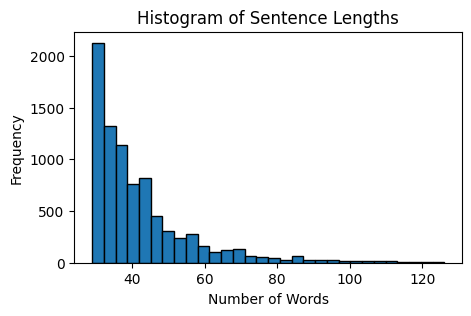

,Statistic,Value
0,Min,29.000000
1,Max,126.000000
2,Median,37.000000
3,Mode,30.000000
4,Mean,42.174694


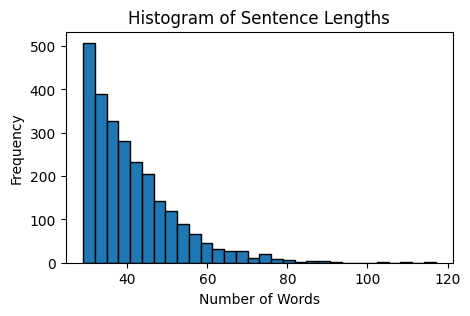

,Statistic,Value
0,Min,29.000000
1,Max,117.000000
2,Median,38.000000
3,Mode,29.000000
4,Mean,40.862745


In [ ]:
# Plot distribution and display table of passage length statistics
plot_passage_lengths(datasets['catalyst']['train'])
display_passage_stats(datasets['catalyst']['train'])
plot_passage_lengths(datasets['battery']['train'])
display_passage_stats(datasets['battery']['train'])

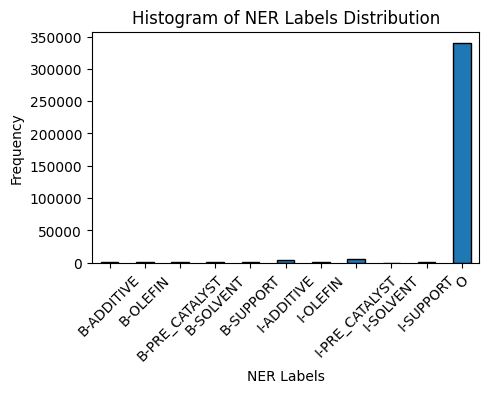

CATALYST,eval,train,val
Tag,,,
B-ADDITIVE,153,821,126
B-OLEFIN,356,1137,150
B-PRE_CATALYST,71,314,51
B-SOLVENT,131,352,50
B-SUPPORT,83,392,25
I-ADDITIVE,620,3785,669
I-OLEFIN,163,656,83
I-PRE_CATALYST,1350,6199,1041
I-SOLVENT,39,85,17


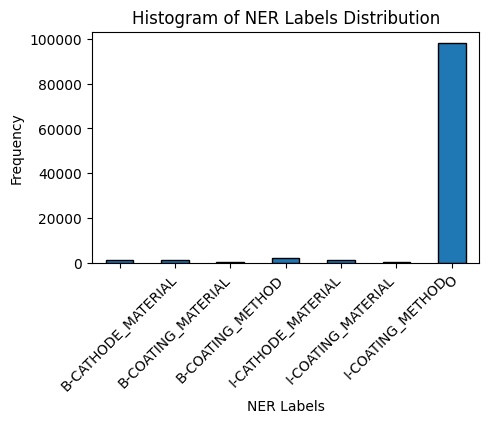

BATTERY,eval,train,val
Tag,,,
B-CATHODE_MATERIAL,402,1188,223
B-COATING_MATERIAL,359,1304,206
B-COATING_METHOD,134,352,57
I-CATHODE_MATERIAL,624,1872,362
I-COATING_MATERIAL,285,958,147
I-COATING_METHOD,91,212,34
O,28838,98314,16791


In [ ]:
# Plot distribution of label counts
plot_label_counts(datasets['catalyst']['train'])
# Generate counts for the catalyst dataset
catalyst_counts = display_label_counts(datasets['catalyst'])
# Create a DataFrame from the counts
catalyst_counts_df = pd.DataFrame(catalyst_counts, columns=['CATALYST', 'Tag', 'Count'])
# Pivot the DataFrame to have Split as the column hierarchy
catalyst_counts_pivot = catalyst_counts_df.pivot(index='Tag',
                                               columns='CATALYST',
                                               values='Count').fillna(0)
# Display the updated DataFrame
display(catalyst_counts_pivot)

print('\n')

# Plot distribution of label counts
plot_label_counts(datasets['battery']['train'])
# Generate counts for the battery dataset
battery_counts = display_label_counts(datasets['battery'])
# Create a DataFrame from the counts
battery_counts_df = pd.DataFrame(battery_counts, columns=['BATTERY', 'Tag', 'Count'])
# Pivot the DataFrame to have Split as the column hierarchy
battery_counts_pivot = battery_counts_df.pivot(index='Tag',
                                               columns='BATTERY',
                                               values='Count').fillna(0)
# Display the updated DataFrame
display(battery_counts_pivot)

In [ ]:
# Inspect Catalyst dataset
print('\n___CATALYST___')
print(f"Features:\n\t{datasets['catalyst']['val'].features.keys()}")
print(f"Example:\n\t{datasets['catalyst']['val'][113]}") # 101, 113 (19 for train)

# Inspect Catalyst labels
catalyst_label_list = sorted(list(set(tag for tags in datasets['catalyst']['val']['ner_tags'] for tag in tags)))
catalyst_label2id = create_label2id_mapping(datasets['catalyst']['val'])
catalyst_id2label = {id: label for label, id in catalyst_label2id.items()}
print(f"Catalyst labels:\n\t{catalyst_label2id}")

# Inspect Battery dataset
print('\n___BATTERY___')
print(f"Features:\n\t{datasets['battery']['val'].features.keys()}")
print(f"Example:\n\t{datasets['battery']['val'][18]}") # 18, 45 (19 for train)

# Inspect Battery labels
battery_label_list = sorted(list(set(tag for tags in datasets['battery']['val']['ner_tags'] for tag in tags)))
battery_label2id = create_label2id_mapping(datasets['battery']['val'])
battery_id2label = {id: label for label, id in battery_label2id.items()}
print(f"Battery labels:\n\t{battery_label2id}")



___CATALYST___
Features:
	dict_keys(['id', 'tokens', 'ner_tags', '__index_level_0__'])
Example:
	{'id': 7876, 'tokens': ['0', 'bar', 'ethylene', 'pressure', ',', '500', 'ml', 'n', '-', 'pentane', ',', '1', '.', '0', 'ml', 'TIBA', '(', '1', '.', '6', 'M', 'in', 'n', '-', 'hexane', ')', ',', '70', '?', 'C', ','], 'ner_tags': ['O', 'O', 'B-OLEFIN', 'O', 'O', 'O', 'O', 'B-SOLVENT', 'I-SOLVENT', 'I-SOLVENT', 'O', 'O', 'O', 'O', 'O', 'B-ADDITIVE', 'O', 'O', 'O', 'O', 'O', 'O', 'B-SOLVENT', 'I-SOLVENT', 'I-SOLVENT', 'O', 'O', 'O', 'O', 'O', 'O'], '__index_level_0__': 7876}
Catalyst labels:
	{'O': 0, 'B-ADDITIVE': 1, 'B-OLEFIN': 3, 'B-PRE_CATALYST': 5, 'B-SOLVENT': 7, 'B-SUPPORT': 9, 'I-ADDITIVE': 2, 'I-OLEFIN': 4, 'I-PRE_CATALYST': 6, 'I-SOLVENT': 8, 'I-SUPPORT': 10}

___BATTERY___
Features:
	dict_keys(['id', 'tokens', 'ner_tags', '__index_level_0__'])
Example:
	{'id': 2738, 'tokens': ['ALD', '-', 'ZnO', 'coated', 'NCM', '-', '523', 'has', 'a', 'high', 'discharge', 'capacity', 'of', '256', '

In [ ]:
# Update the NER datasets with analogous integer labels
datasets['catalyst']['train'] = datasets['catalyst']['train'].map(lambda x: add_ner_ids(x, catalyst_label2id))
datasets['catalyst']['val'] = datasets['catalyst']['val'].map(lambda x: add_ner_ids(x, catalyst_label2id))
datasets['catalyst']['eval'] = datasets['catalyst']['eval'].map(lambda x: add_ner_ids(x, catalyst_label2id))
datasets['battery']['train'] = datasets['battery']['train'].map(lambda x: add_ner_ids(x, battery_label2id))
datasets['battery']['val'] = datasets['battery']['val'].map(lambda x: add_ner_ids(x, battery_label2id))
datasets['battery']['eval'] = datasets['battery']['eval'].map(lambda x: add_ner_ids(x, battery_label2id))

Map:   0%|          | 0/8409 [00:00<?, ? examples/s]

Map:   0%|          | 0/1485 [00:00<?, ? examples/s]

Map:   0%|          | 0/2550 [00:00<?, ? examples/s]

Map:   0%|          | 0/450 [00:00<?, ? examples/s]

# 6. Modeling pipeline

## Setup pipeline

In [ ]:
# Specify constants

MAX_LEN = 256
LABEL_PAD_TOKEN_ID = -100

DENSE_SIZE = 256
DROPOUT = 0.1
WEIGHT_DECAY = 0.01

RANDOM_SEEDS = [5, 31, 121]
NUM_EPOCHS = 3

In [ ]:
# Function to run models
def run_models(checkpoint='bert-base-cased', # ['bert-base-cased', 'allenai/scibert_scivocab_cased', 'SpanBERT/spanbert-base-cased', 'dmis-lab/biobert-base-cased-v1.2']
               name_prefix='C_',
               dataset='battery', # ['battery', 'catalyst']
               train_strategy='all', # ['none', 'some', 'all']
               retrain_layers=[],
               feedforward_strategies=['last', 'concat'],
               concat_layers=[8,9,10,11],
               batch_sizes=[16,32],
               init_lrs=[2e-5,5e-5]):

    global TOKENIZER
    TOKENIZER = AutoTokenizer.from_pretrained(checkpoint)

    if checkpoint == 'bert-base-cased':
        model_name = name_prefix + 'basebert'
    elif checkpoint == 'allenai/scibert_scivocab_cased':
        model_name = name_prefix + 'scibert'
    elif checkpoint == 'SpanBERT/spanbert-base-cased':
        model_name = name_prefix + 'spanbert'
    elif checkpoint == 'dmis-lab/biobert-base-cased-v1.2':
        model_name = name_prefix + 'biobert'

    if dataset == 'battery':
        battery_train = datasets['battery']['train'].map(tokenize_and_align_labels, batched=True)
        battery_val = datasets['battery']['val'].map(tokenize_and_align_labels, batched=True)
        battery_eval = datasets['battery']['eval'].map(tokenize_and_align_labels, batched=True)
        tf_battery_train, tf_battery_val, tf_battery_eval = prepare_tf_datasets(
            battery_train, battery_val, battery_eval, TOKENIZER)
        hf_train, hf_val, hf_eval = battery_train, battery_val, battery_eval
        tf_train, tf_val, tf_eval = tf_battery_train, tf_battery_val, tf_battery_eval
        NUM_SAMPLES = len(battery_train)
        LABEL_LIST = battery_label_list
        ID2LABEL = battery_id2label
        LABEL2ID = battery_label2id
    elif dataset == 'catalyst':
        catalyst_train = datasets['catalyst']['train'].map(tokenize_and_align_labels, batched=True)
        catalyst_val = datasets['catalyst']['val'].map(tokenize_and_align_labels, batched=True)
        catalyst_eval = datasets['catalyst']['eval'].map(tokenize_and_align_labels, batched=True)
        tf_catalyst_train, tf_catalyst_val, tf_catalyst_eval = prepare_tf_datasets(
            catalyst_train, catalyst_val, catalyst_eval, TOKENIZER)
        hf_train, hf_val, hf_eval = catalyst_train, catalyst_val, catalyst_eval
        tf_train, tf_val, tf_eval = tf_catalyst_train, tf_catalyst_val, tf_catalyst_eval
        NUM_SAMPLES = len(catalyst_train)
        LABEL_LIST = catalyst_label_list
        ID2LABEL = catalyst_id2label
        LABEL2ID = catalyst_label2id

    global NUM_CLASSES
    NUM_CLASSES = len(LABEL_LIST)

    # Create a list to store all models' scores
    all_scores = []

    for ff_strategy in feedforward_strategies:

        for batch_size in batch_sizes:

            for init_lr in init_lrs:

                for i, seed in enumerate(RANDOM_SEEDS):

                    # Update the model name
                    model_replicate_name = f"{model_name}_{dataset}_{train_strategy}_{ff_strategy}_{batch_size}_{init_lr}_r{i+1}"

                    # Clean memory of prior models
                    tf.keras.backend.clear_session()

                    # Set seed for random initializations
                    tf.keras.utils.set_random_seed(seed)

                    print(f"""
                    ======================================================================
                    ======================================================================
                    \t\t{model_replicate_name}
                    ======================================================================
                    ======================================================================""")

                    # Load the BERT model
                    bert_config = BertConfig.from_pretrained(
                        checkpoint,
                        output_hidden_states=True)
                    bert_model = TFBertModel.from_pretrained(
                        checkpoint,
                        config=bert_config, from_pt=True)

                    # Specify procedure for retraining BERT layers
                    if train_strategy == 'none':
                        # Freeze all BERT layers
                        bert_model.trainable = False
                    elif train_strategy == 'all':
                        # Unfreeze all BERT layers
                        bert_model.trainable = True
                    elif train_strategy == 'some':
                        # Specify which layers to unfreeze
                        # eg. retrain all layers:  RETRAIN_LAYERS=list(range(12))
                        # eg. retrain last 4 layers:  [8,9,10,11]
                        for i, layer in enumerate(bert_model.bert.encoder.layer):
                            if i in retrain_layers:
                                layer.trainable = True
                            else:
                                layer.trainable = False

                    # Input layer
                    input_ids = tf.keras.layers.Input(
                        shape=(MAX_LEN,),
                        dtype=tf.int32,
                        name='input_ids')
                    token_type_ids = tf.keras.layers.Input(
                        shape=(MAX_LEN,),
                        dtype=tf.int32,
                        name='token_type_ids')
                    attention_mask = tf.keras.layers.Input(
                        shape=(MAX_LEN,),
                        dtype=tf.int32,
                        name='attention_mask')
                    bert_inputs = {
                        'input_ids': input_ids,
                        'token_type_ids': token_type_ids,
                        'attention_mask': attention_mask}

                    # BERT outputs
                    bert_outputs = bert_model(bert_inputs)

                    # Specify architecture for classification head
                    if ff_strategy == 'last':
                        # Directly use last hidden layer
                        bert_output = bert_outputs['hidden_states'][11]
                        hidden_layer = tf.keras.layers.Dense(
                            DENSE_SIZE, activation='relu',
                            name='hidden_layer')(bert_output)
                    elif ff_strategy == 'concat':
                        """# Concatenate specified layers and feed directly into a dense layer
                        selected_layers = [bert_outputs['hidden_states'][i] for i in concat_layers]
                        bert_output = tf.keras.layers.Concatenate(
                            axis=-1,name='concat_layer')(selected_layers)
                        hidden_layer = tf.keras.layers.Dense(
                            DENSE_SIZE,
                            activation='relu',
                            name='hidden_layer')(bert_output)"""
                        # Concatenate specified layers and feed into 1 BiLSTM then a dense layer
                        selected_layers = [bert_outputs['hidden_states'][i] for i in concat_layers]
                        bert_output = tf.keras.layers.Concatenate(
                            axis=-1, name='concat_layer')(selected_layers)
                        bilstm_layer = tf.keras.layers.Bidirectional(
                            tf.keras.layers.LSTM(768, return_sequences=True),
                            name='bilstm_layer')(bert_output)
                        hidden_layer = tf.keras.layers.Dense(
                            DENSE_SIZE,
                            activation='relu',
                            name='hidden_layer')(bilstm_layer)
                        """# Concatenate specified layers and feed into 2 BiLSTM then a dense layer
                        selected_layers = [bert_outputs['hidden_states'][i] for i in concat_layers]
                        bert_output = tf.keras.layers.Concatenate(
                            axis=-1, name='concat_layer')(selected_layers)
                        bilstm_layer1 = tf.keras.layers.Bidirectional(
                            tf.keras.layers.LSTM(768, return_sequences=True),
                            name='bilstm1_layer')(bert_output)
                        bilstm_layer2 = tf.keras.layers.Bidirectional(
                            tf.keras.layers.LSTM(768, return_sequences=True),
                            name='bilstm2_layer')(bilstm_layer1)
                        hidden_layer = tf.keras.layers.Dense(
                            DENSE_SIZE,
                            activation='relu',
                            name='hidden_layer')(bilstm_layer2)"""

                    # Add a dropout layer
                    dropout_layer = tf.keras.layers.Dropout(
                        DROPOUT,
                        name='dropout_layer')(hidden_layer)

                    # Output layer for classification
                    # NOTE: specify activation for the final output layer (predictions will be probabilities not logits)
                    output_layer = tf.keras.layers.Dense(
                        NUM_CLASSES,
                        activation='softmax',
                        name='labels')(dropout_layer)

                    # Define losses and their weights
                    losses = {
                        "labels": hf_ner_loss}
                    lossWeights = {
                        "labels": 1.0}

                    # Build and compile the model
                    model = tf.keras.Model(
                        inputs=bert_inputs,
                        outputs=output_layer,
                        name=model_replicate_name)

                    # Specify the optimizer
                    optimizer, _ = create_optimizer(
                        init_lr=init_lr,
                        num_train_steps=(NUM_SAMPLES // batch_size) * NUM_EPOCHS,
                        weight_decay_rate=WEIGHT_DECAY,
                        num_warmup_steps=0.1*((NUM_SAMPLES // batch_size) * NUM_EPOCHS))

                    # Compile the model with the defined losses and optimizer
                    model.compile(
                        optimizer=optimizer,
                        metrics=[custom_acc_orig_tokens, custom_acc_orig_non_other_tokens],
                        loss=losses)

                    # Display the model architecture
                    """tf.keras.utils.plot_model(
                        model,
                        to_file=f'{model_replicate_name}.png',
                        show_shapes=False,
                        show_layer_names=True,
                        dpi=90)
                    display(Image(filename=f'{model_replicate_name}.png'))"""

                    # Show the model summary
                    """model.summary()"""

                    # Define a custom callback for seqeval metrics
                    metric_callback = KerasMetricCallback(
                        metric_fn=lambda p: compute_metrics(p, LABEL_LIST),
                        eval_dataset=tf_val)

                    # Train and evaluate the model
                    history = model.fit(
                        tf_train,
                        validation_data=tf_val,
                        epochs=NUM_EPOCHS,
                        batch_size=batch_size,
                        callbacks=[metric_callback])

                    # Plot model metrics as subplots
                    plot_metrics(history)

                    # Predict labels from datasets
                    train_predictions = save_predictions(
                        model, tf_train, hf_train, TOKENIZER, ID2LABEL,
                        model_replicate_name+'_train_predictions.json', upload_choice=True)
                    val_predictions = save_predictions(
                        model, tf_val, hf_val, TOKENIZER, ID2LABEL,
                        model_replicate_name+'_val_predictions.json', upload_choice=True)
                    eval_predictions = save_predictions(
                        model, tf_eval, hf_eval, TOKENIZER, ID2LABEL,
                        model_replicate_name+'_eval_predictions.json', upload_choice=True)

                    # Store predictions as dictionaries
                    """passage_predictions = {
                        'train': train_predictions,
                        'val': val_predictions,
                        'eval': eval_predictions}"""

                    # Convert predictions from list of dicts to dict of lists
                    """train_pred_dict = convert_predictions_to_dict(train_predictions)
                    val_pred_dict = convert_predictions_to_dict(val_predictions)"""
                    eval_pred_dict = convert_predictions_to_dict(eval_predictions)

                    # Compute MCC score
                    mcc_score_train = compute_MCC.compute_MCC_jsonl(
                        hf_train, train_predictions, id_col='id')
                    mcc_score_val = compute_MCC.compute_MCC_jsonl(
                        hf_val, val_predictions, id_col='id')
                    mcc_score_eval = compute_MCC.compute_MCC_jsonl(
                        hf_eval, eval_predictions, id_col='id')

                    # Compute Seqeval scores
                    seqeval_scores_train = compute_seqeval.compute_seqeval_jsonl(
                        hf_train, train_predictions, id_col='id')
                    seqeval_scores_val = compute_seqeval.compute_seqeval_jsonl(
                        hf_val, val_predictions, id_col='id')
                    seqeval_scores_eval = compute_seqeval.compute_seqeval_jsonl(
                        hf_eval, eval_predictions, id_col='id')

                    # Display final evaluation metrics
                    print("\nFinal evaluation metrics for train set")
                    scores_train = display_metrics_details(mcc_score_train, seqeval_scores_train, show=False)
                    print("\nFinal evaluation metrics for validation set")
                    scores_val = display_metrics_details(mcc_score_val, seqeval_scores_val, show=False)
                    print("\nFinal evaluation metrics for evaluation set")
                    scores_eval = display_metrics_details(mcc_score_eval, seqeval_scores_eval, show=True)

                    # Store scores as dataframes
                    scores = {
                        'train': scores_train,
                        'val': scores_val,
                        'eval': scores_eval}

                    # Save the evaluation metrics
                    save_metrics_details(
                        scores_train, model_replicate_name+'_train_scores', upload_choice=False)
                    save_metrics_details(
                        scores_val, model_replicate_name+'_val_scores', upload_choice=False)
                    save_metrics_details(
                        scores_eval, model_replicate_name+'_eval_scores', upload_choice=False)

                    # Generate confusion matrix for the evaluation split
                    plot_confusion_matrix(hf_eval, eval_pred_dict, LABEL_LIST)

                    # Inspect passages with mismatched tokens for the evaluation split
                    display_mismatched_passages(hf_eval, eval_pred_dict, N=5)

                    # Append the model data to all_models
                    model_data = {
                        'model_prefix': model_name,
                        'dataset': dataset,
                        'train_strategy': train_strategy,
                        'ff_strategy': ff_strategy,
                        'batch_size': batch_size,
                        'init_lr': init_lr,
                        'replicate': i+1,
                        'scores': scores}
                    all_scores.append(model_data)

    # Save all_scores to local workspace
    with open(f"{model_name}_{dataset}_{train_strategy}_scores.pkl", 'wb') as f:
        pickle.dump(all_scores, f)

    # Upload all_Scores file to GitHub
    save_pickle(all_scores, f"{model_name}_{dataset}_{train_strategy}_scores", upload_choice=True)

    return all_scores

## SciBERT

### battery_feature-based

In [ ]:
# Battery dataset -- feature-based appraoch w/ concatenation of last 4 hidden layers (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models1 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='B_',
    dataset='battery',
    train_strategy='none', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['concat'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

Map:   0%|          | 0/2550 [00:00<?, ? examples/s]

Map:   0%|          | 0/450 [00:00<?, ? examples/s]

Map:   0%|          | 0/750 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/datasets/arrow_dataset.py:410: FutureWarning: The output of `to_tf_dataset` will change when a passing single element list for `labels` or `columns` in the next datasets version. To return a tuple structure rather than dict, pass a single string.
Old behaviour: columns=['a'], labels=['labels'] -> (tf.Tensor, tf.Tensor)  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor)  
New behaviour: columns=['a'],labels=['labels'] -> ({'a': tf.Tensor}, {'labels': tf.Tensor})  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor) 
  warnings.warn(



                    		B_scibert_battery_none_concat_16_2e-05_r1


pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.seq_relationship.weight', 'cls.predictions.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filemfgliqa0.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - ETA: 0s - loss: 0.5119 - custom_acc_orig_tokens: 0.8527 - custom_acc_orig_non_other_tokens: 0.0514

### battery_fine-tune(1-layer)

In [ ]:
# Battery dataset -- fine-tune appraoch w/ last hidden layer (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models2 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='B_',
    dataset='battery',
    train_strategy='all', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['last'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:

### catalyst_fine-tune(1-layer)

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

Map:   0%|          | 0/8409 [00:00<?, ? examples/s]

Map:   0%|          | 0/1485 [00:00<?, ? examples/s]

Map:   0%|          | 0/2474 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/datasets/arrow_dataset.py:410: FutureWarning: The output of `to_tf_dataset` will change when a passing single element list for `labels` or `columns` in the next datasets version. To return a tuple structure rather than dict, pass a single string.
Old behaviour: columns=['a'], labels=['labels'] -> (tf.Tensor, tf.Tensor)  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor)  
New behaviour: columns=['a'],labels=['labels'] -> ({'a': tf.Tensor}, {'labels': tf.Tensor})  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor) 
  warnings.warn(



                    		B_scibert_catalyst_none_concat_16_2e-05_r1


pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2603 - custom_acc_orig_tokens: 0.9504 - custom_acc_orig_non_other_tokens: 0.1332

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 145s 191ms/step - loss: 0.2603 - custom_acc_orig_tokens: 0.9504 - custom_acc_orig_non_other_tokens: 0.1332 - val_loss: 0.0766 - val_custom_acc_orig_tokens: 0.9756 - val_custom_acc_orig_non_other_tokens: 0.1590 - precision: 0.9730 - recall: 0.9855 - f1: 0.9792 - accuracy: 0.9745
Epoch 2/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0715 - custom_acc_orig_tokens: 0.9771 - custom_acc_orig_non_other_tokens: 0.3286 - val_loss: 0.0528 - val_custom_acc_orig_tokens: 0.9826 - val_custom_acc_orig_non_other_tokens: 0.3254 - precision: 0.9812 - recall: 0.9872 - f1: 0.9842 - accuracy: 0.9817
Epoch 3/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0545 - custom_acc_orig_tokens: 0.9819 - custom_acc_orig_non_other_tokens: 0.4088 - val_loss: 0.0468 - val_custom_acc_orig_tokens: 0.9844 - val_custom_acc_orig_non_other_tokens: 0.3848 - precision: 0.9834 - recall: 0.9879 - f1: 0.9856 - accuracy: 0.9835


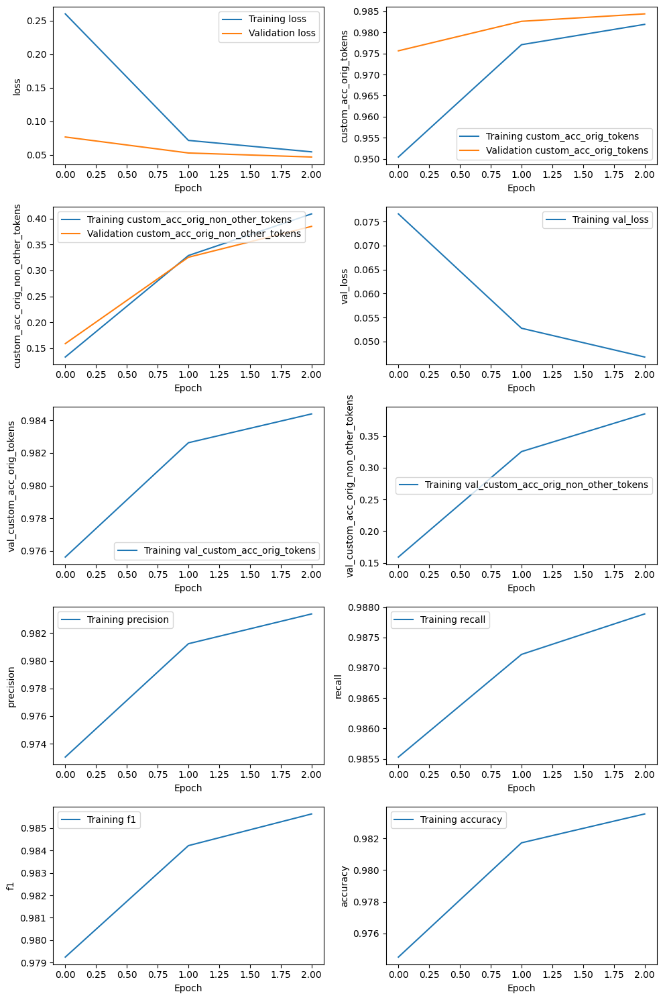

526/526 [==============================] - 54s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r1_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.315,0.333,0.324,153,,
OLEFIN,0.553,0.570,0.562,356,,
PRE_CATALYST,0.370,0.479,0.417,71,,
SOLVENT,0.939,0.237,0.378,131,,
SUPPORT,0.500,0.072,0.126,83,,
OVERALL,0.488,0.409,0.445,,0.983,0.688


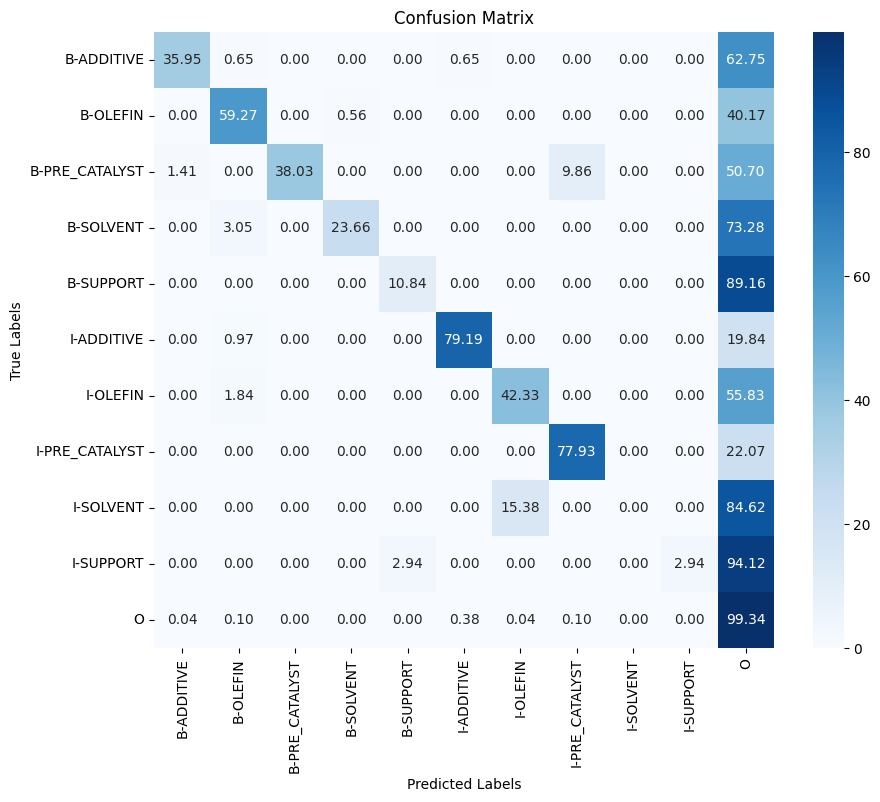

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.3223 - custom_acc_orig_tokens: 0.9163 - custom_acc_orig_non_other_tokens: 0.1331

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 128s 192ms/step - loss: 0.3223 - custom_acc_orig_tokens: 0.9163 - custom_acc_orig_non_other_tokens: 0.1331 - val_loss: 0.0815 - val_custom_acc_orig_tokens: 0.9749 - val_custom_acc_orig_non_other_tokens: 0.1372 - precision: 0.9723 - recall: 0.9854 - f1: 0.9788 - accuracy: 0.9737
Epoch 2/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0741 - custom_acc_orig_tokens: 0.9766 - custom_acc_orig_non_other_tokens: 0.3215 - val_loss: 0.0566 - val_custom_acc_orig_tokens: 0.9824 - val_custom_acc_orig_non_other_tokens: 0.3046 - precision: 0.9804 - recall: 0.9877 - f1: 0.9840 - accuracy: 0.9815
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0565 - custom_acc_orig_tokens: 0.9812 - custom_acc_orig_non_other_tokens: 0.4050 - val_loss: 0.0488 - val_custom_acc_orig_tokens: 0.9846 - val_custom_acc_orig_non_other_tokens: 0.3830 - precision: 0.9836 - recall: 0.9879 - f1: 0.9857 - accuracy: 0.9837


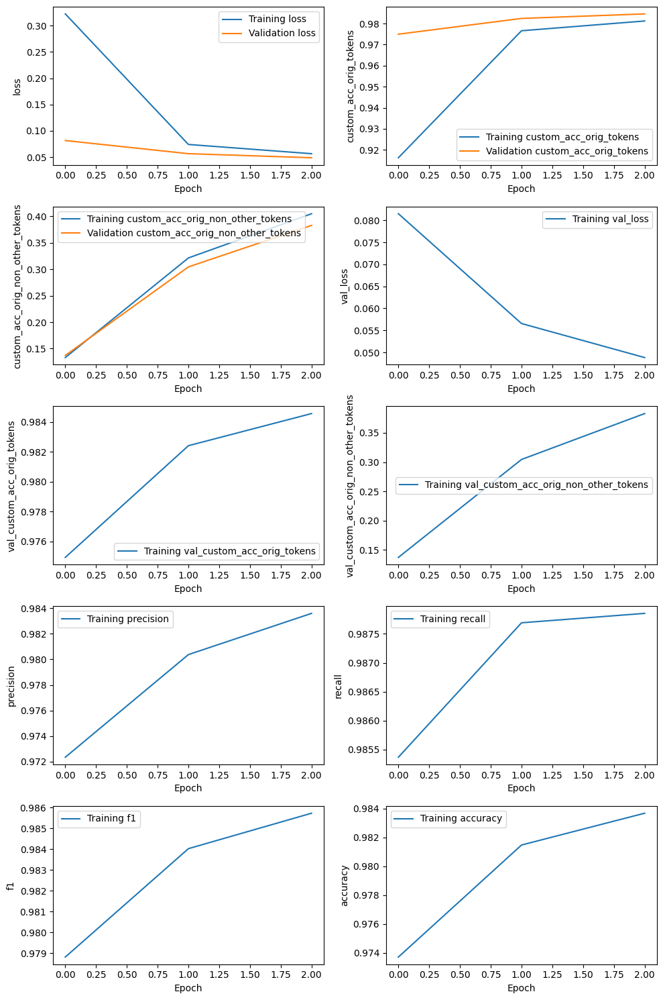

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r2_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.243,0.288,0.263,153,,
OLEFIN,0.566,0.593,0.579,356,,
PRE_CATALYST,0.330,0.423,0.370,71,,
SOLVENT,1.000,0.336,0.503,131,,
SUPPORT,0.375,0.036,0.066,83,,
OVERALL,0.476,0.418,0.445,,0.983,0.682


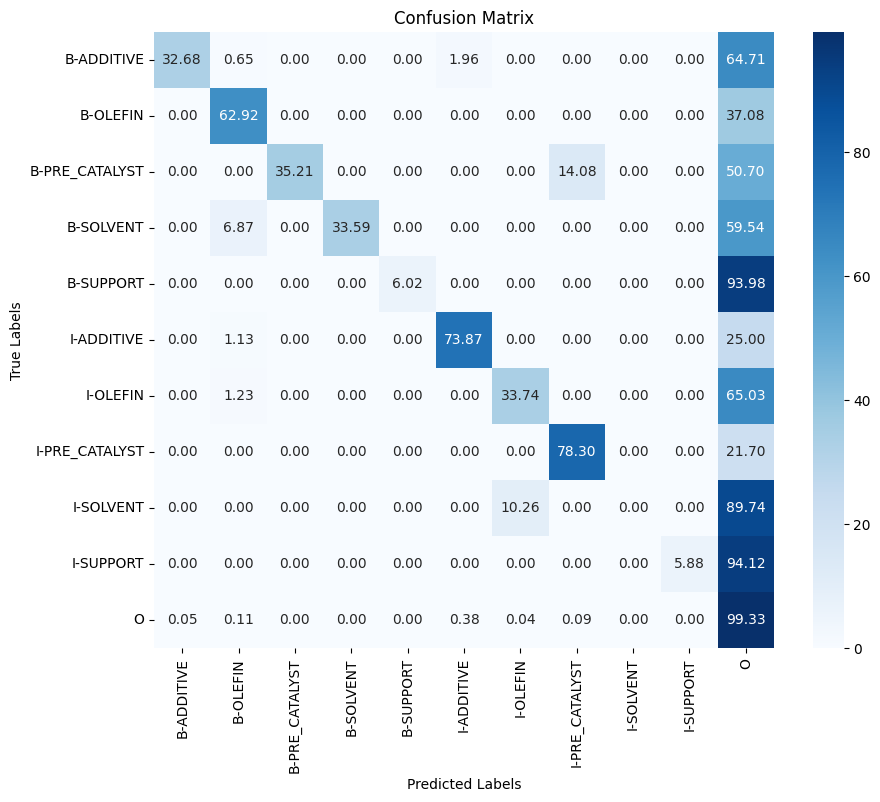

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.3470 - custom_acc_orig_tokens: 0.9069 - custom_acc_orig_non_other_tokens: 0.1157

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 129s 192ms/step - loss: 0.3470 - custom_acc_orig_tokens: 0.9069 - custom_acc_orig_non_other_tokens: 0.1157 - val_loss: 0.0763 - val_custom_acc_orig_tokens: 0.9760 - val_custom_acc_orig_non_other_tokens: 0.1669 - precision: 0.9732 - recall: 0.9852 - f1: 0.9791 - accuracy: 0.9748
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0752 - custom_acc_orig_tokens: 0.9762 - custom_acc_orig_non_other_tokens: 0.3072 - val_loss: 0.0556 - val_custom_acc_orig_tokens: 0.9817 - val_custom_acc_orig_non_other_tokens: 0.3016 - precision: 0.9799 - recall: 0.9867 - f1: 0.9833 - accuracy: 0.9807
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0580 - custom_acc_orig_tokens: 0.9808 - custom_acc_orig_non_other_tokens: 0.3890 - val_loss: 0.0493 - val_custom_acc_orig_tokens: 0.9836 - val_custom_acc_orig_non_other_tokens: 0.3659 - precision: 0.9827 - recall: 0.9871 - f1: 0.9849 - accuracy: 0.9827


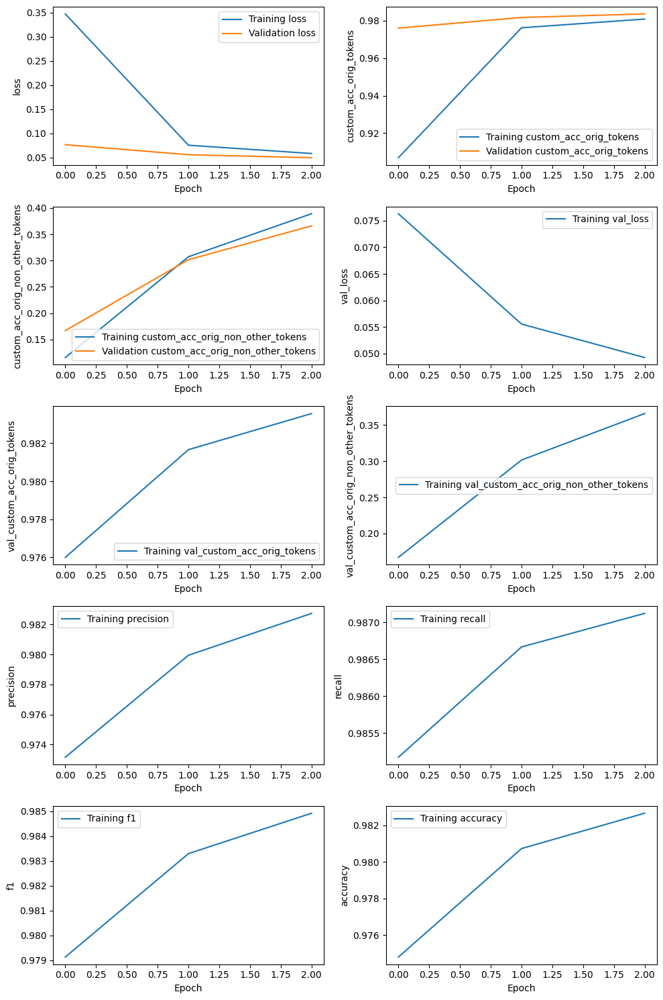

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_2e-05_r3_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.239,0.248,0.244,153,,
OLEFIN,0.530,0.528,0.529,356,,
PRE_CATALYST,0.375,0.465,0.415,71,,
SOLVENT,1.000,0.313,0.477,131,,
SUPPORT,0.250,0.036,0.063,83,,
OVERALL,0.463,0.382,0.418,,0.983,0.679


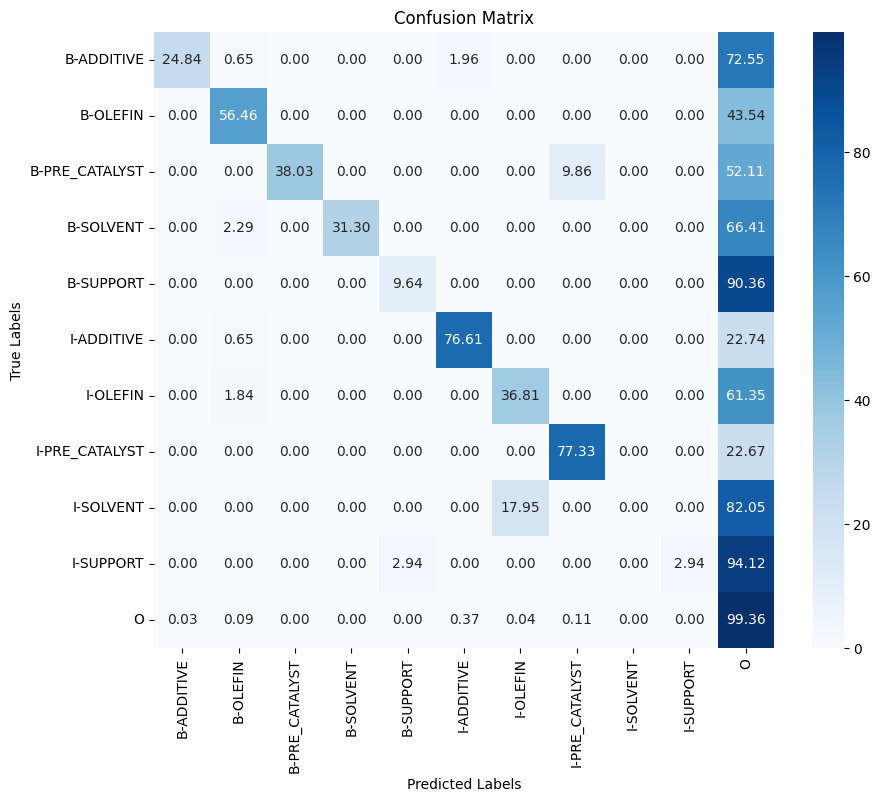

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 128s 191ms/step - loss: 0.1917 - custom_acc_orig_tokens: 0.9592 - custom_acc_orig_non_other_tokens: 0.2123 - val_loss: 0.0723 - val_custom_acc_orig_tokens: 0.9768 - val_custom_acc_orig_non_other_tokens: 0.2132 - precision: 0.9745 - recall: 0.9872 - f1: 0.9808 - accuracy: 0.9757
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0525 - custom_acc_orig_tokens: 0.9815 - custom_acc_orig_non_other_tokens: 0.4611 - val_loss: 0.0506 - val_custom_acc_orig_tokens: 0.9834 - val_custom_acc_orig_non_other_tokens: 0.3557 - precision: 0.9817 - recall: 0.9890 - f1: 0.9853 - accuracy: 0.9825
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0378 - custom_acc_orig_tokens: 0.9865 - custom_acc_orig_non_other_tokens: 0.5585 - val_loss: 0.0346 - val_custom_acc_orig_tokens: 0.9868 - val_custom_acc_orig_non_other_tokens: 0.5354 - precision: 0.9855 - recall: 0.9900 - f1: 0.9877 - accuracy: 0.9861


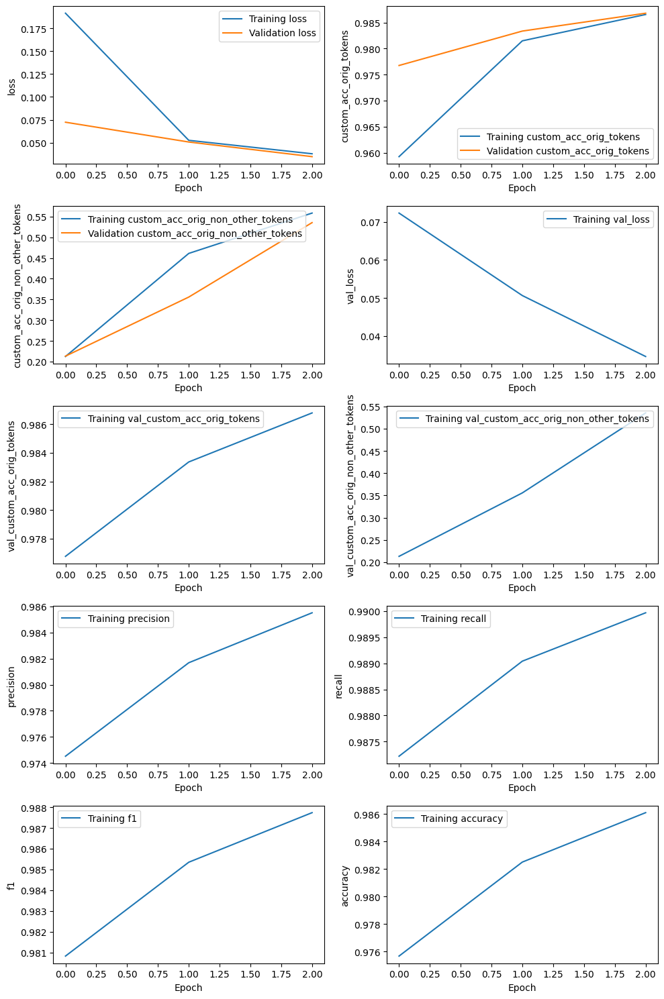

526/526 [==============================] - 55s 87ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r1_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.347,0.562,0.429,153,,
OLEFIN,0.600,0.781,0.679,356,,
PRE_CATALYST,0.500,0.634,0.559,71,,
SOLVENT,0.886,0.534,0.667,131,,
SUPPORT,0.623,0.398,0.485,83,,
OVERALL,0.549,0.645,0.593,,0.986,0.751


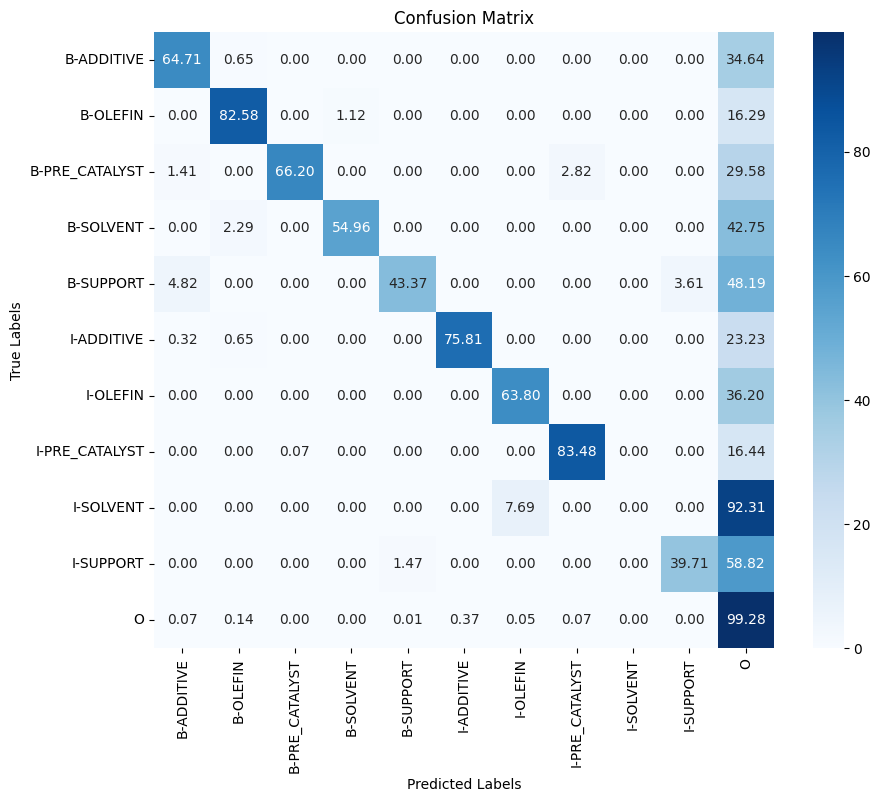

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 128s 189ms/step - loss: 0.2323 - custom_acc_orig_tokens: 0.9375 - custom_acc_orig_non_other_tokens: 0.2135 - val_loss: 0.0815 - val_custom_acc_orig_tokens: 0.9754 - val_custom_acc_orig_non_other_tokens: 0.1783 - precision: 0.9730 - recall: 0.9871 - f1: 0.9800 - accuracy: 0.9742
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0540 - custom_acc_orig_tokens: 0.9812 - custom_acc_orig_non_other_tokens: 0.4558 - val_loss: 0.0608 - val_custom_acc_orig_tokens: 0.9810 - val_custom_acc_orig_non_other_tokens: 0.3147 - precision: 0.9790 - recall: 0.9891 - f1: 0.9840 - accuracy: 0.9800
Epoch 3/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0393 - custom_acc_orig_tokens: 0.9859 - custom_acc_orig_non_other_tokens: 0.5500 - val_loss: 0.0361 - val_custom_acc_orig_tokens: 0.9867 - val_custom_acc_orig_non_other_tokens: 0.5334 - precision: 0.9855 - recall: 0.9896 - f1: 0.9876 - accuracy: 0.9860


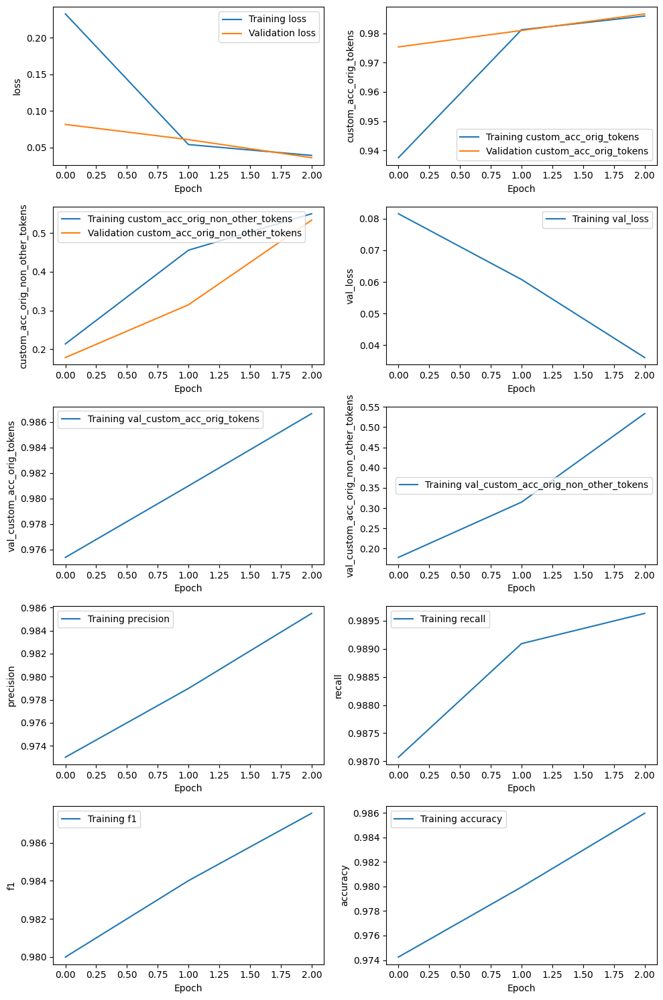

526/526 [==============================] - 54s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r2_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.348,0.516,0.416,153,,
OLEFIN,0.591,0.795,0.678,356,,
PRE_CATALYST,0.584,0.634,0.608,71,,
SOLVENT,0.899,0.542,0.676,131,,
SUPPORT,0.714,0.422,0.530,83,,
OVERALL,0.563,0.646,0.602,,0.985,0.747


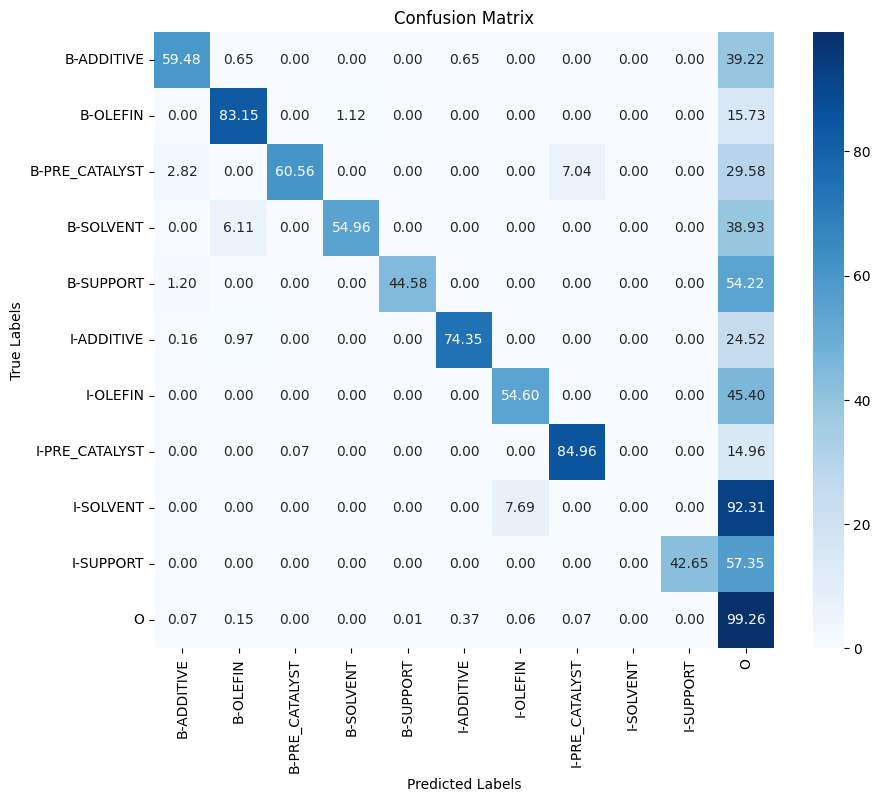

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.2475 - custom_acc_orig_tokens: 0.9315 - custom_acc_orig_non_other_tokens: 0.1986 - val_loss: 0.0719 - val_custom_acc_orig_tokens: 0.9773 - val_custom_acc_orig_non_other_tokens: 0.2045 - precision: 0.9750 - recall: 0.9872 - f1: 0.9811 - accuracy: 0.9763
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0544 - custom_acc_orig_tokens: 0.9808 - custom_acc_orig_non_other_tokens: 0.4398 - val_loss: 0.0554 - val_custom_acc_orig_tokens: 0.9819 - val_custom_acc_orig_non_other_tokens: 0.3182 - precision: 0.9799 - recall: 0.9891 - f1: 0.9845 - accuracy: 0.9810
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0402 - custom_acc_orig_tokens: 0.9858 - custom_acc_orig_non_other_tokens: 0.5494 - val_loss: 0.0365 - val_custom_acc_orig_tokens: 0.9865 - val_custom_acc_orig_non_other_tokens: 0.5026 - precision: 0.9852 - recall: 0.9894 - f1: 0.9873 - accuracy: 0.9858


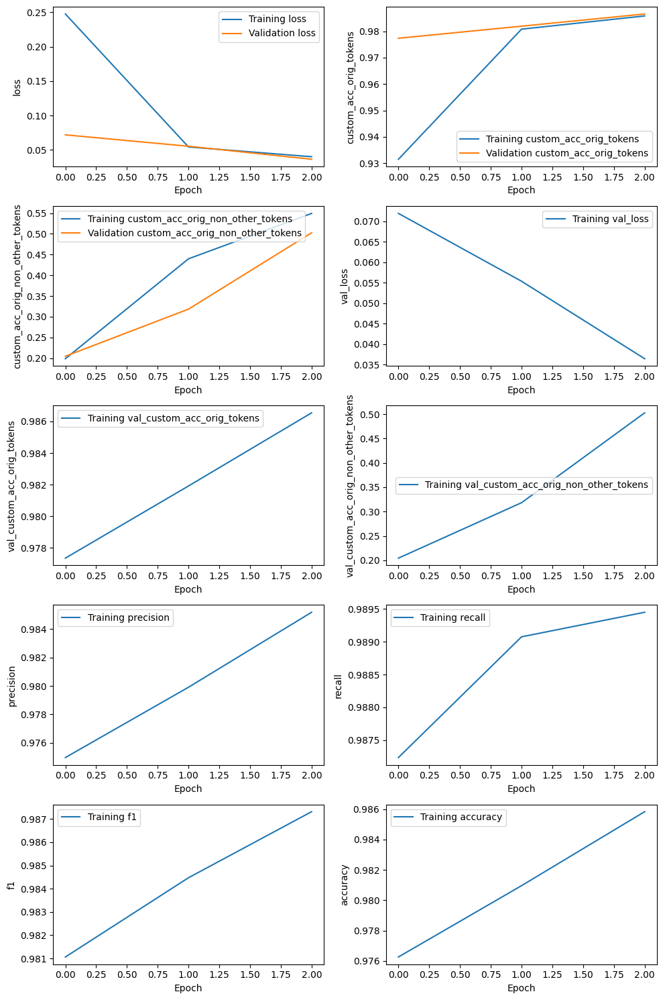

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_5e-05_r3_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.392,0.569,0.464,153,,
OLEFIN,0.593,0.781,0.674,356,,
PRE_CATALYST,0.551,0.606,0.577,71,,
SOLVENT,0.871,0.565,0.685,131,,
SUPPORT,0.673,0.446,0.536,83,,
OVERALL,0.571,0.654,0.610,,0.986,0.753


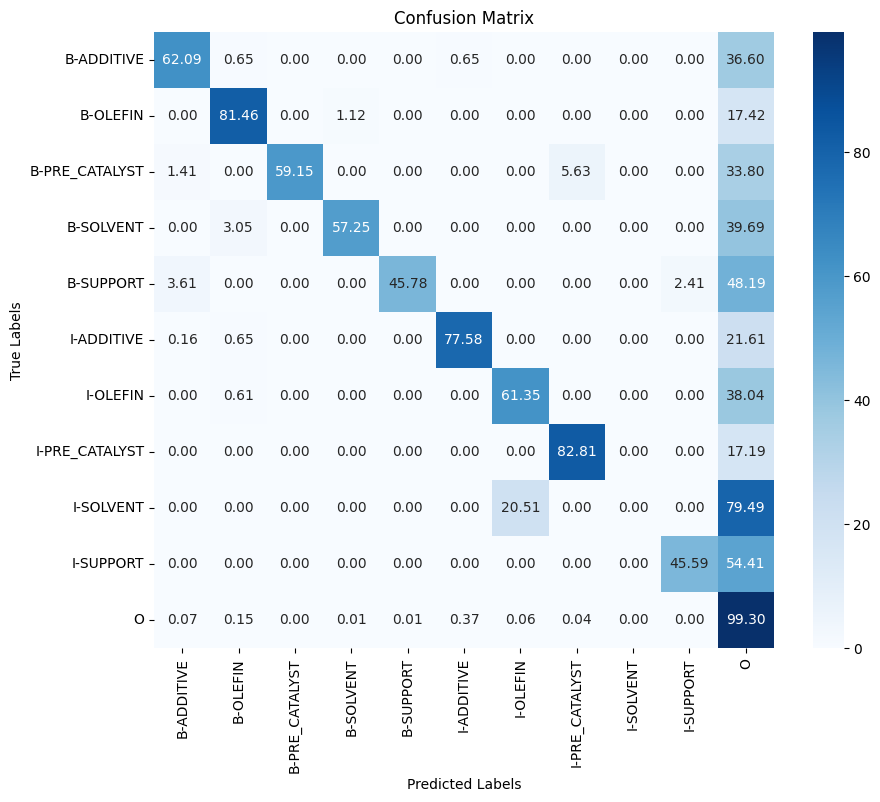

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 128s 192ms/step - loss: 0.1691 - custom_acc_orig_tokens: 0.9623 - custom_acc_orig_non_other_tokens: 0.2445 - val_loss: 0.0718 - val_custom_acc_orig_tokens: 0.9770 - val_custom_acc_orig_non_other_tokens: 0.2547 - precision: 0.9749 - recall: 0.9875 - f1: 0.9811 - accuracy: 0.9759
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0480 - custom_acc_orig_tokens: 0.9825 - custom_acc_orig_non_other_tokens: 0.5151 - val_loss: 0.0506 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.3933 - precision: 0.9814 - recall: 0.9894 - f1: 0.9854 - accuracy: 0.9824
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0340 - custom_acc_orig_tokens: 0.9874 - custom_acc_orig_non_other_tokens: 0.6028 - val_loss: 0.0321 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.5731 - precision: 0.9865 - recall: 0.9908 - f1: 0.9886 - accuracy: 0.9871


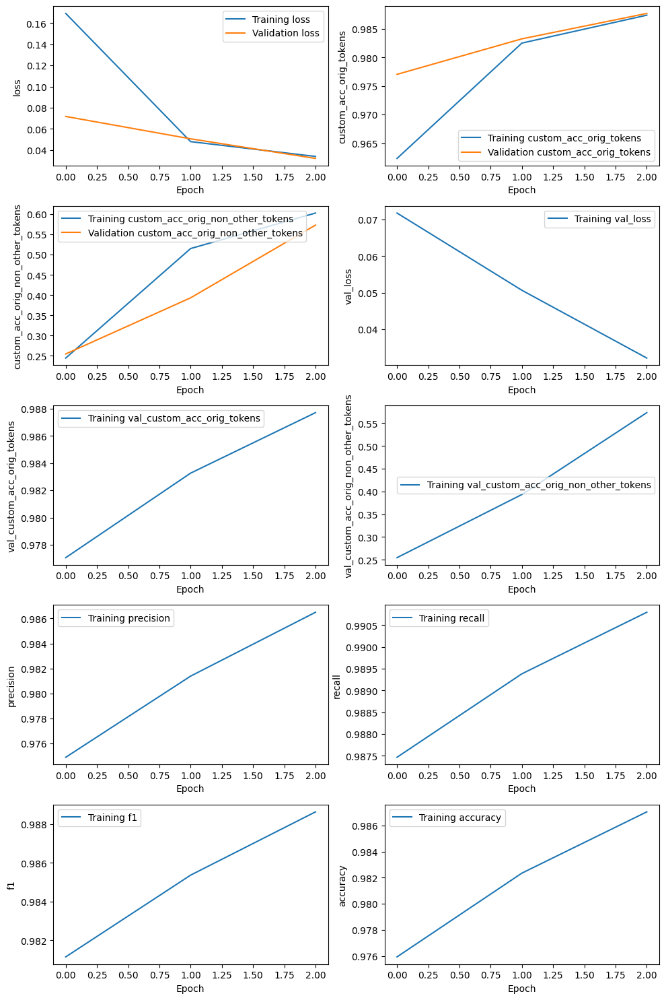

526/526 [==============================] - 54s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r1_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.358,0.608,0.450,153,,
OLEFIN,0.588,0.787,0.673,356,,
PRE_CATALYST,0.545,0.676,0.604,71,,
SOLVENT,0.835,0.580,0.685,131,,
SUPPORT,0.687,0.554,0.613,83,,
OVERALL,0.553,0.684,0.611,,0.986,0.758


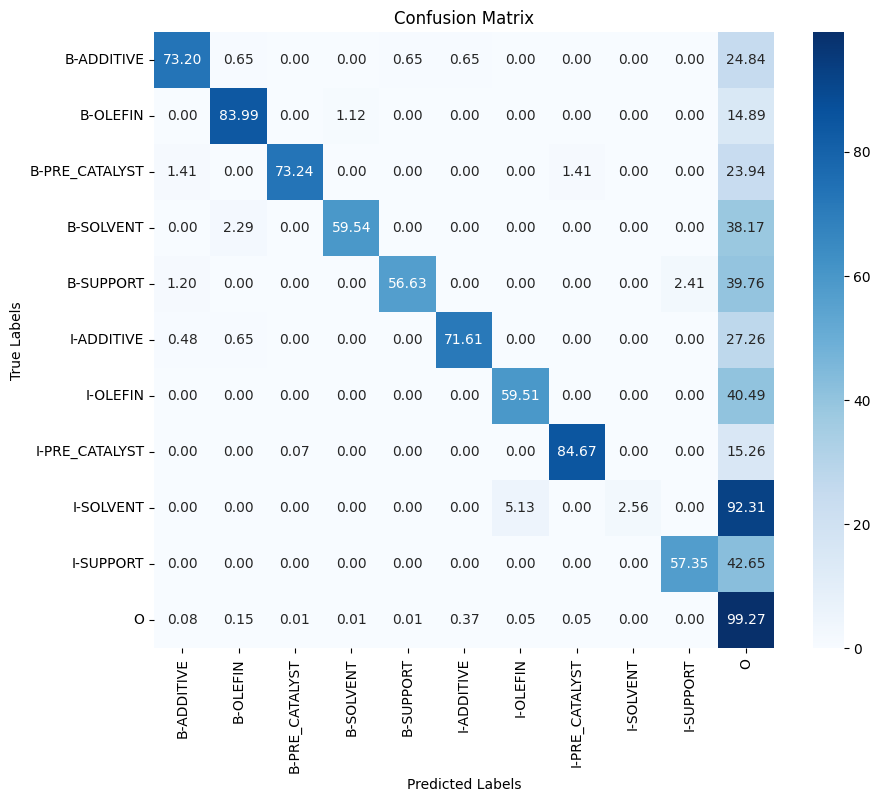

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 130s 191ms/step - loss: 0.2019 - custom_acc_orig_tokens: 0.9446 - custom_acc_orig_non_other_tokens: 0.2488 - val_loss: 0.0791 - val_custom_acc_orig_tokens: 0.9765 - val_custom_acc_orig_non_other_tokens: 0.2209 - precision: 0.9742 - recall: 0.9876 - f1: 0.9809 - accuracy: 0.9754
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0495 - custom_acc_orig_tokens: 0.9822 - custom_acc_orig_non_other_tokens: 0.5137 - val_loss: 0.0592 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.3791 - precision: 0.9793 - recall: 0.9893 - f1: 0.9843 - accuracy: 0.9803
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0351 - custom_acc_orig_tokens: 0.9868 - custom_acc_orig_non_other_tokens: 0.5919 - val_loss: 0.0330 - val_custom_acc_orig_tokens: 0.9876 - val_custom_acc_orig_non_other_tokens: 0.5702 - precision: 0.9865 - recall: 0.9903 - f1: 0.9884 - accuracy: 0.9869


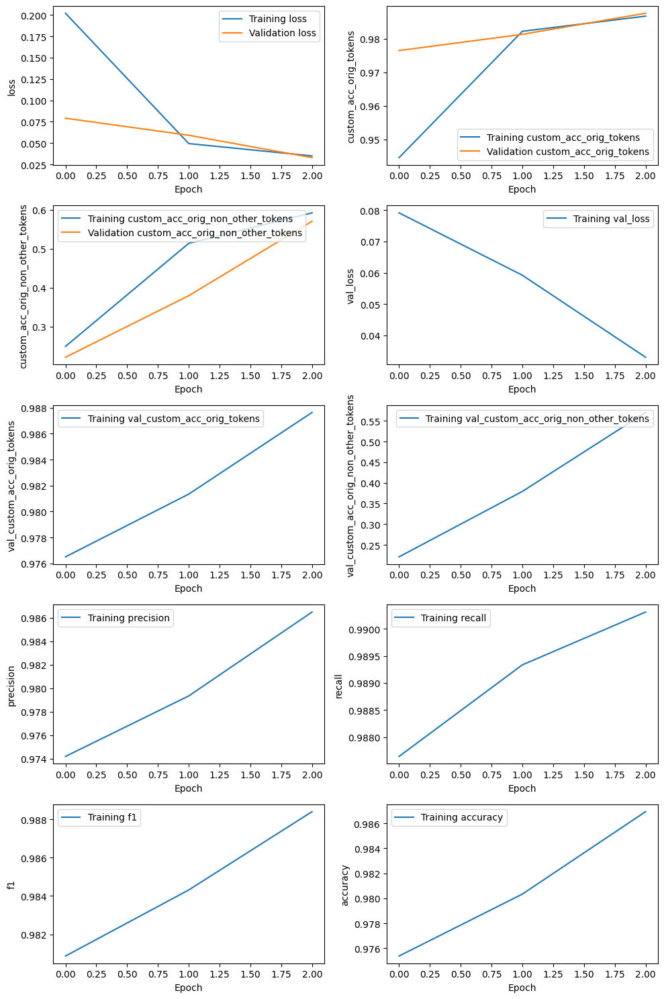

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r2_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.357,0.556,0.435,153,,
OLEFIN,0.593,0.815,0.686,356,,
PRE_CATALYST,0.573,0.718,0.637,71,,
SOLVENT,0.809,0.580,0.676,131,,
SUPPORT,0.616,0.542,0.577,83,,
OVERALL,0.556,0.689,0.616,,0.986,0.766


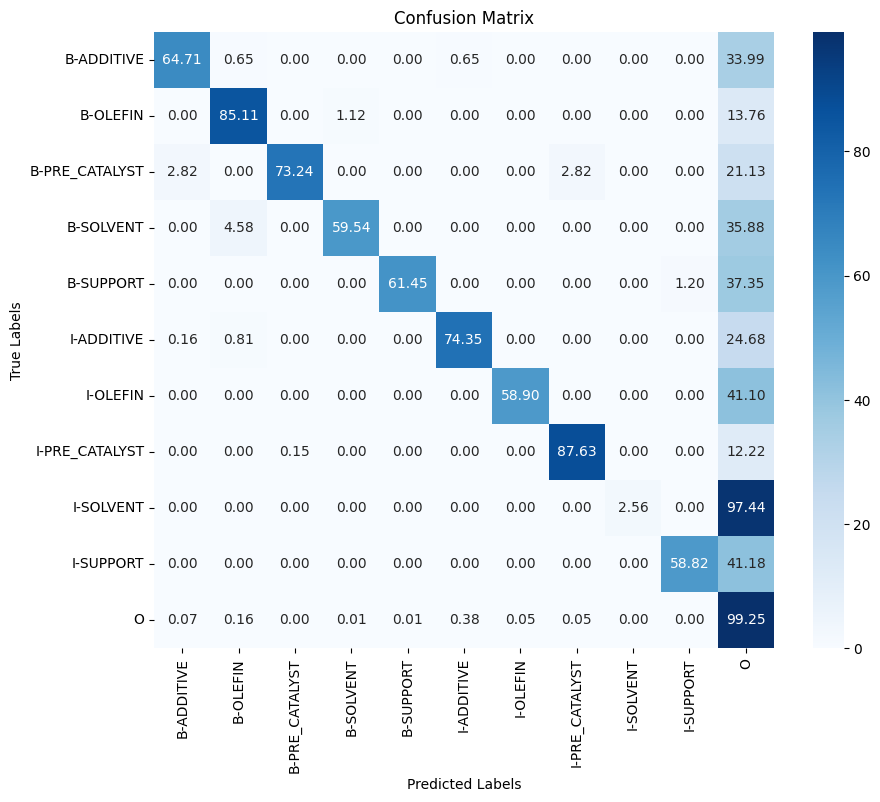

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.2133 - custom_acc_orig_tokens: 0.9400 - custom_acc_orig_non_other_tokens: 0.2342 - val_loss: 0.0767 - val_custom_acc_orig_tokens: 0.9760 - val_custom_acc_orig_non_other_tokens: 0.2282 - precision: 0.9738 - recall: 0.9876 - f1: 0.9806 - accuracy: 0.9749
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0495 - custom_acc_orig_tokens: 0.9824 - custom_acc_orig_non_other_tokens: 0.5031 - val_loss: 0.0512 - val_custom_acc_orig_tokens: 0.9831 - val_custom_acc_orig_non_other_tokens: 0.3912 - precision: 0.9811 - recall: 0.9896 - f1: 0.9853 - accuracy: 0.9821
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0357 - custom_acc_orig_tokens: 0.9868 - custom_acc_orig_non_other_tokens: 0.5947 - val_loss: 0.0331 - val_custom_acc_orig_tokens: 0.9874 - val_custom_acc_orig_non_other_tokens: 0.5684 - precision: 0.9863 - recall: 0.9903 - f1: 0.9883 - accuracy: 0.9868


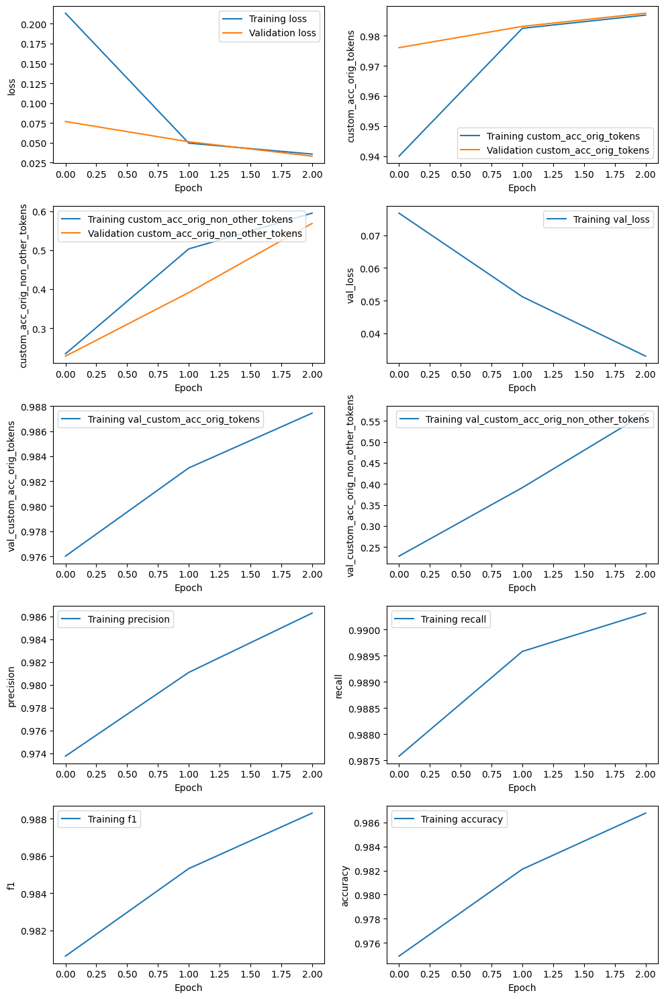

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_16_8e-05_r3_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.389,0.608,0.474,153,,
OLEFIN,0.581,0.798,0.672,356,,
PRE_CATALYST,0.739,0.718,0.729,71,,
SOLVENT,0.835,0.618,0.711,131,,
SUPPORT,0.662,0.566,0.610,83,,
OVERALL,0.576,0.700,0.632,,0.986,0.756


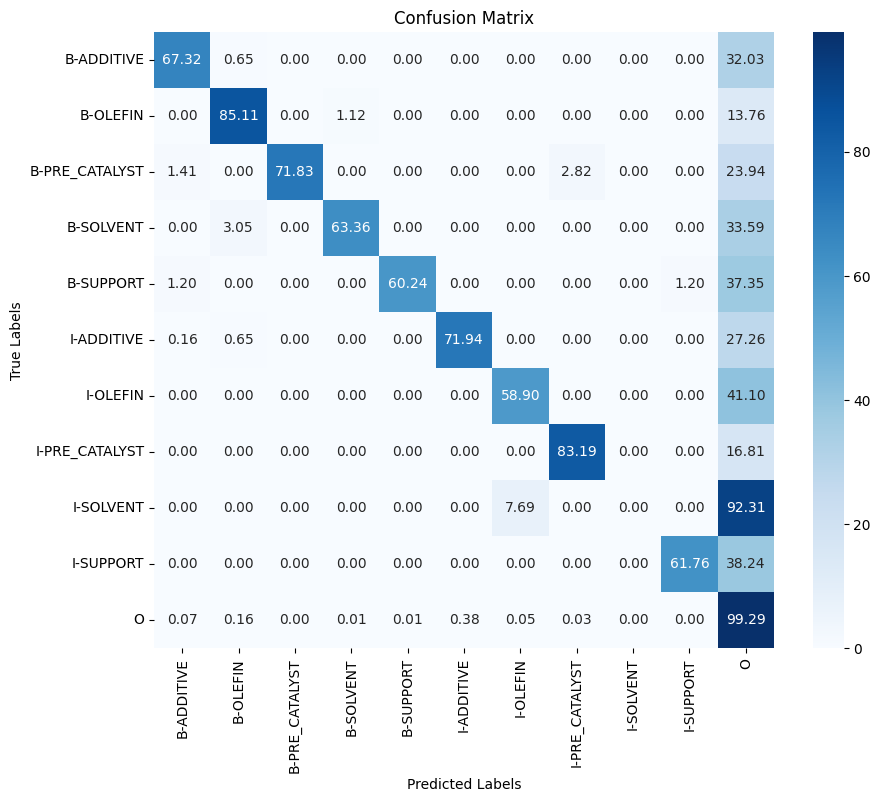

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2200 - custom_acc_orig_tokens: 0.9555 - custom_acc_orig_non_other_tokens: 0.1401

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 127s 191ms/step - loss: 0.2200 - custom_acc_orig_tokens: 0.9555 - custom_acc_orig_non_other_tokens: 0.1401 - val_loss: 0.0703 - val_custom_acc_orig_tokens: 0.9788 - val_custom_acc_orig_non_other_tokens: 0.2230 - precision: 0.9767 - recall: 0.9850 - f1: 0.9808 - accuracy: 0.9778
Epoch 2/3
526/526 [==============================] - 72s 138ms/step - loss: 0.0811 - custom_acc_orig_tokens: 0.9753 - custom_acc_orig_non_other_tokens: 0.2752 - val_loss: 0.0663 - val_custom_acc_orig_tokens: 0.9798 - val_custom_acc_orig_non_other_tokens: 0.2511 - precision: 0.9784 - recall: 0.9844 - f1: 0.9814 - accuracy: 0.9788
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0790 - custom_acc_orig_tokens: 0.9762 - custom_acc_orig_non_other_tokens: 0.2933 - val_loss: 0.0663 - val_custom_acc_orig_tokens: 0.9798 - val_custom_acc_orig_non_other_tokens: 0.2511 - precision: 0.9784 - recall: 0.9844 - f1: 0.9814 - accuracy: 0.9788


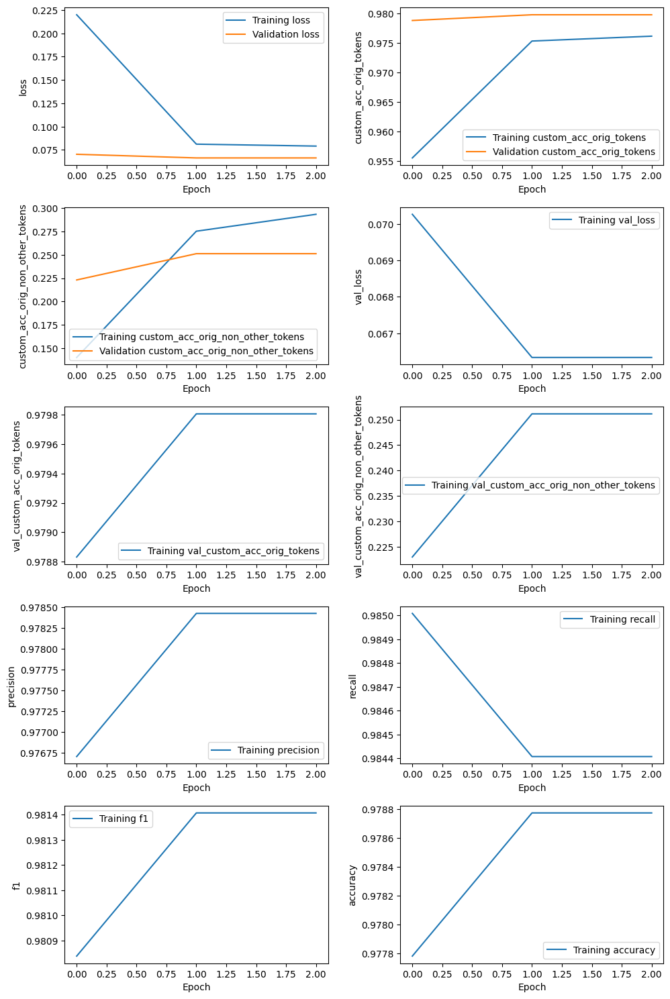

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.165,0.150,0.158,153,,
OLEFIN,0.667,0.146,0.240,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.219,0.094,0.132,,0.978,0.563


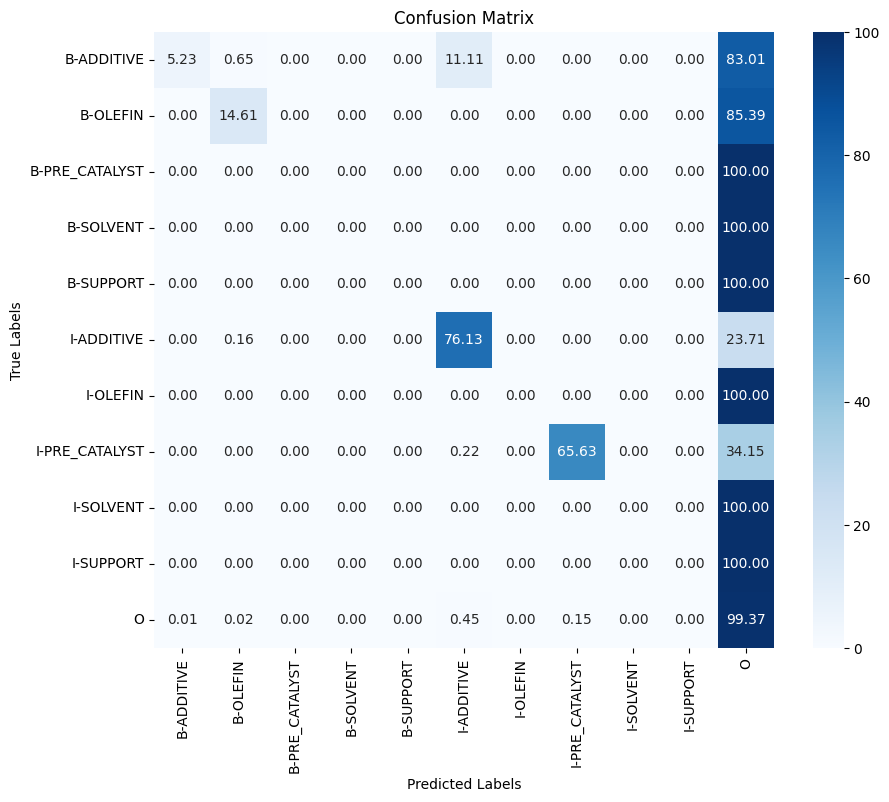

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2657 - custom_acc_orig_tokens: 0.9309 - custom_acc_orig_non_other_tokens: 0.1379

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 127s 190ms/step - loss: 0.2657 - custom_acc_orig_tokens: 0.9309 - custom_acc_orig_non_other_tokens: 0.1379 - val_loss: 0.0740 - val_custom_acc_orig_tokens: 0.9782 - val_custom_acc_orig_non_other_tokens: 0.2033 - precision: 0.9758 - recall: 0.9848 - f1: 0.9803 - accuracy: 0.9772
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0846 - custom_acc_orig_tokens: 0.9751 - custom_acc_orig_non_other_tokens: 0.2747 - val_loss: 0.0687 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2519 - precision: 0.9784 - recall: 0.9842 - f1: 0.9813 - accuracy: 0.9789
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0823 - custom_acc_orig_tokens: 0.9760 - custom_acc_orig_non_other_tokens: 0.2933 - val_loss: 0.0687 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2519 - precision: 0.9784 - recall: 0.9842 - f1: 0.9813 - accuracy: 0.9789


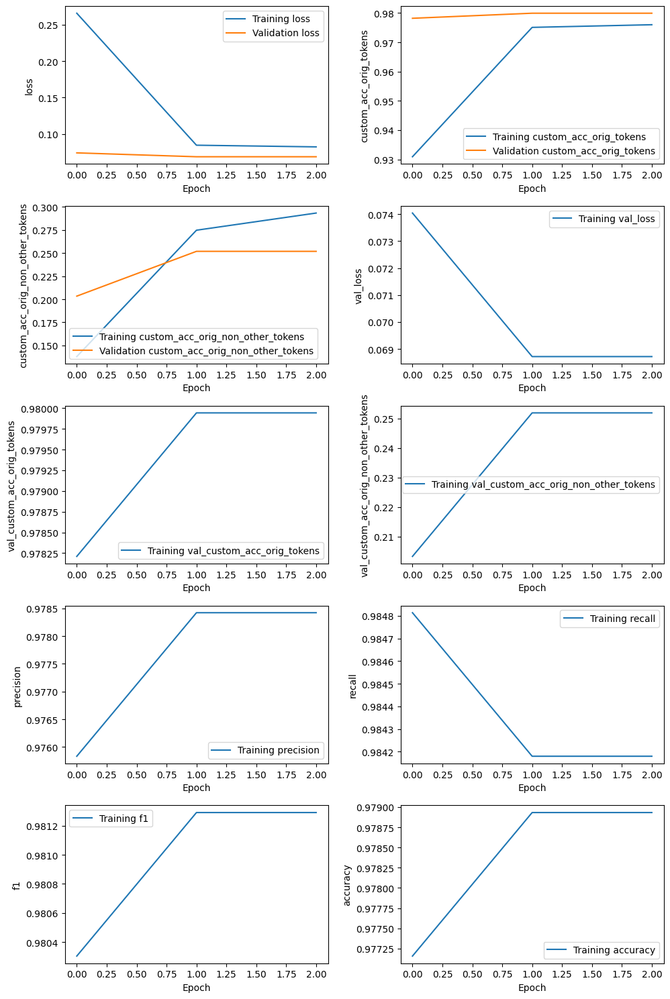

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 86ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.127,0.124,0.125,153,,
OLEFIN,0.683,0.157,0.256,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.208,0.094,0.130,,0.978,0.555


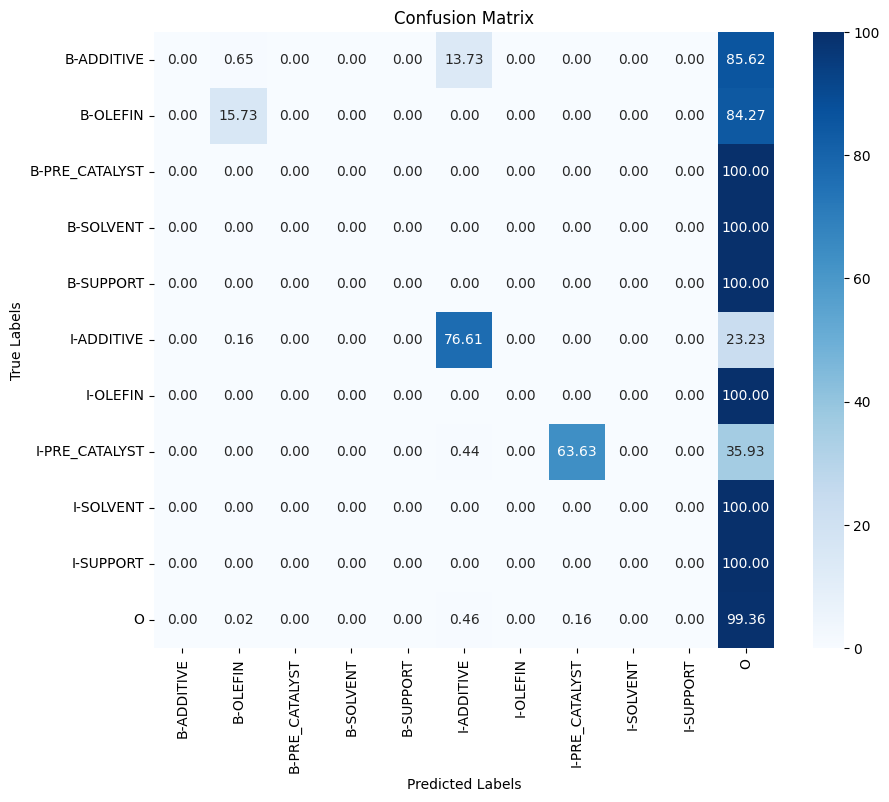

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2842 - custom_acc_orig_tokens: 0.9239 - custom_acc_orig_non_other_tokens: 0.1172

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 128s 191ms/step - loss: 0.2842 - custom_acc_orig_tokens: 0.9239 - custom_acc_orig_non_other_tokens: 0.1172 - val_loss: 0.0743 - val_custom_acc_orig_tokens: 0.9780 - val_custom_acc_orig_non_other_tokens: 0.2089 - precision: 0.9758 - recall: 0.9846 - f1: 0.9802 - accuracy: 0.9769
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0866 - custom_acc_orig_tokens: 0.9741 - custom_acc_orig_non_other_tokens: 0.2577 - val_loss: 0.0703 - val_custom_acc_orig_tokens: 0.9787 - val_custom_acc_orig_non_other_tokens: 0.2372 - precision: 0.9772 - recall: 0.9837 - f1: 0.9805 - accuracy: 0.9776
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0848 - custom_acc_orig_tokens: 0.9750 - custom_acc_orig_non_other_tokens: 0.2816 - val_loss: 0.0703 - val_custom_acc_orig_tokens: 0.9787 - val_custom_acc_orig_non_other_tokens: 0.2372 - precision: 0.9772 - recall: 0.9837 - f1: 0.9805 - accuracy: 0.9776


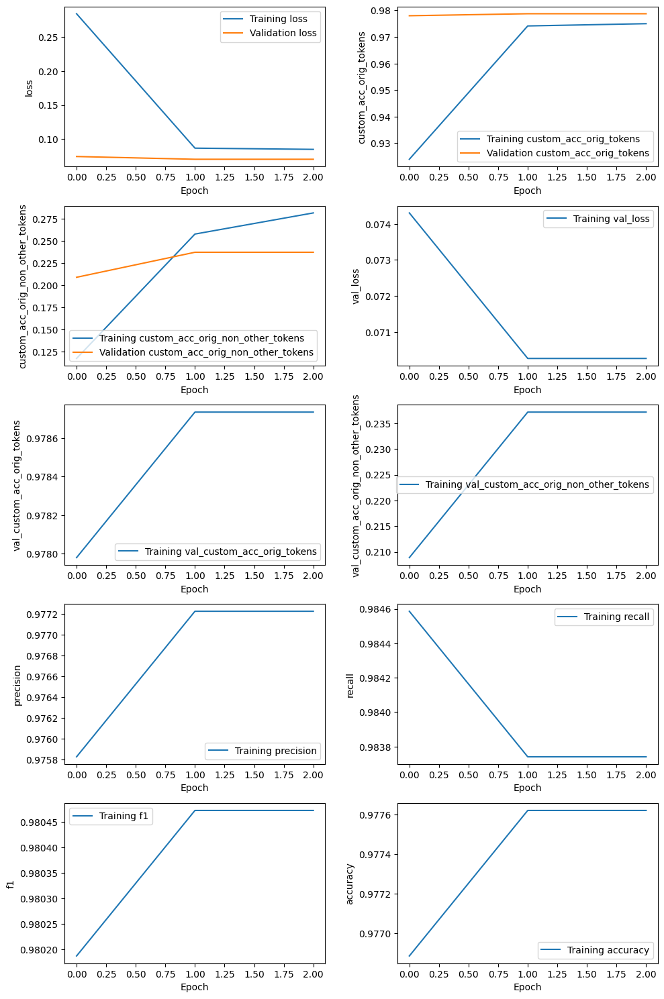

526/526 [==============================] - 54s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_2e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.150,0.150,0.150,153,,
OLEFIN,0.727,0.135,0.227,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.208,0.089,0.125,,0.977,0.528


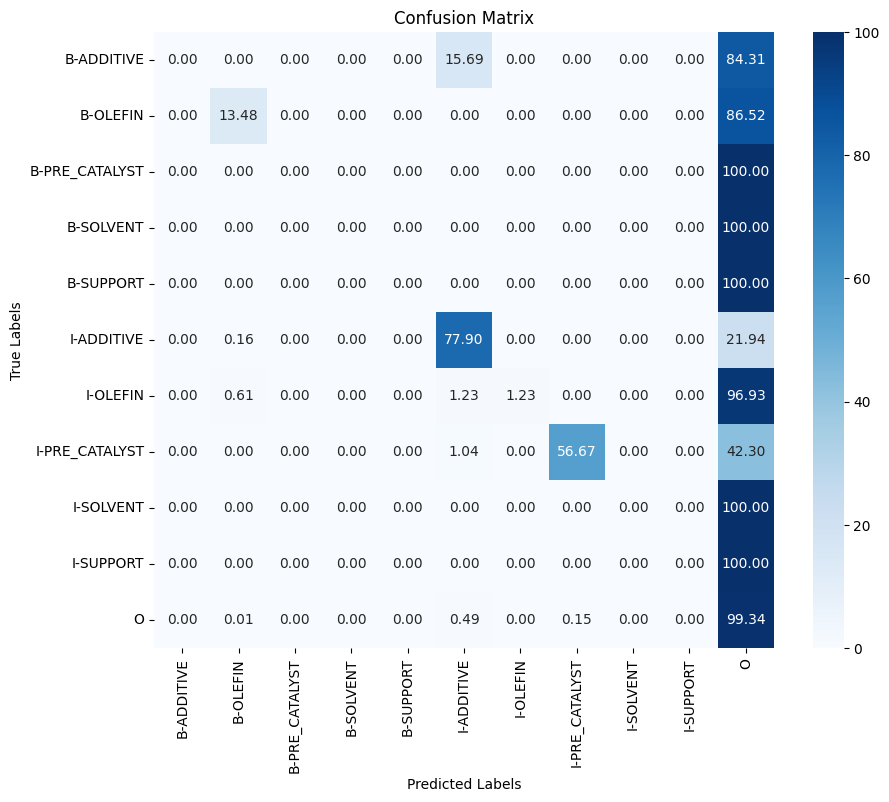

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.1638 - custom_acc_orig_tokens: 0.9633 - custom_acc_orig_non_other_tokens: 0.2235 - val_loss: 0.0616 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2455 - precision: 0.9777 - recall: 0.9874 - f1: 0.9825 - accuracy: 0.9789
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0554 - custom_acc_orig_tokens: 0.9808 - custom_acc_orig_non_other_tokens: 0.4087 - val_loss: 0.0495 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.3755 - precision: 0.9826 - recall: 0.9864 - f1: 0.9845 - accuracy: 0.9824
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0526 - custom_acc_orig_tokens: 0.9821 - custom_acc_orig_non_other_tokens: 0.4366 - val_loss: 0.0495 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.3755 - precision: 0.9826 - recall: 0.9864 - f1: 0.9845 - accuracy: 0.9824


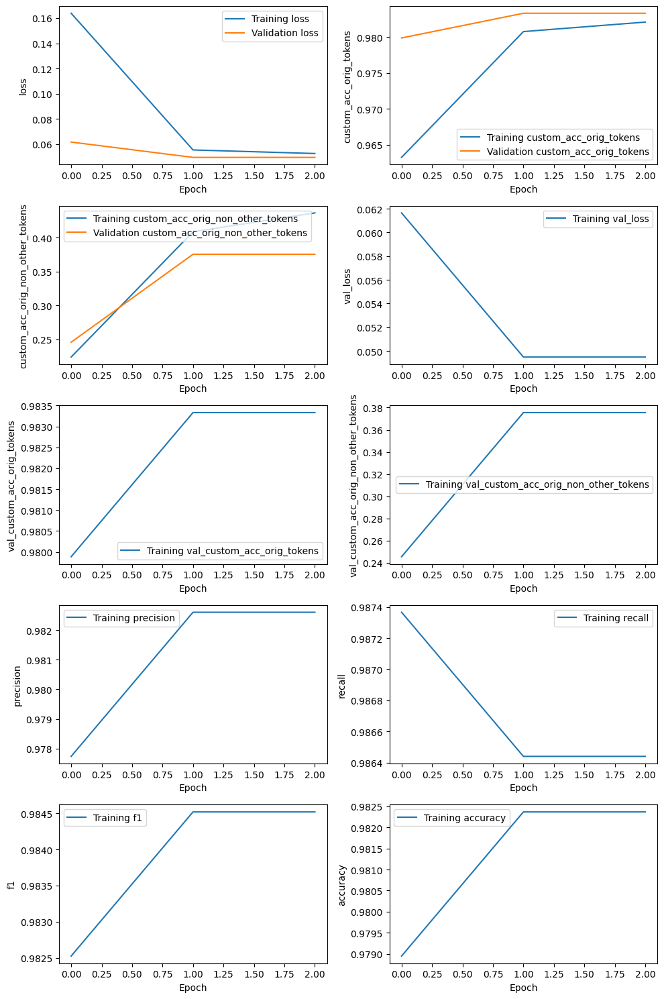

526/526 [==============================] - 54s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r1_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.357,0.399,0.377,153,,
OLEFIN,0.657,0.399,0.497,356,,
PRE_CATALYST,0.286,0.451,0.350,71,,
SOLVENT,1.000,0.084,0.155,131,,
SUPPORT,0.167,0.012,0.022,83,,
OVERALL,0.479,0.311,0.377,,0.981,0.655


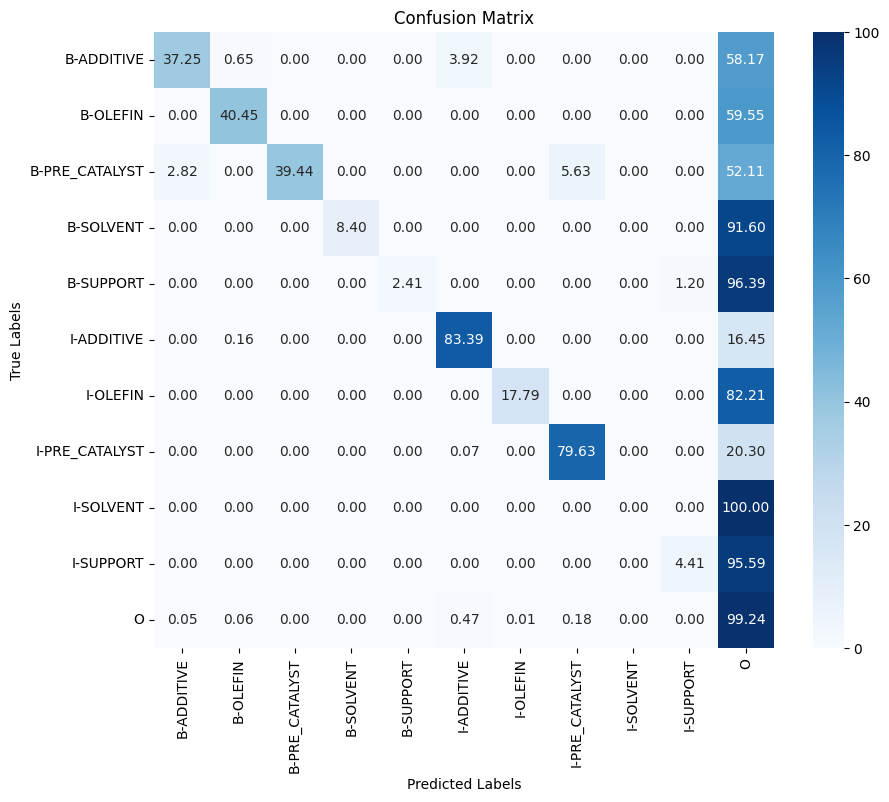

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.1944 - custom_acc_orig_tokens: 0.9475 - custom_acc_orig_non_other_tokens: 0.2212 - val_loss: 0.0718 - val_custom_acc_orig_tokens: 0.9775 - val_custom_acc_orig_non_other_tokens: 0.1914 - precision: 0.9752 - recall: 0.9868 - f1: 0.9810 - accuracy: 0.9765
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0578 - custom_acc_orig_tokens: 0.9803 - custom_acc_orig_non_other_tokens: 0.3957 - val_loss: 0.0504 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.3648 - precision: 0.9824 - recall: 0.9862 - f1: 0.9843 - accuracy: 0.9824
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0544 - custom_acc_orig_tokens: 0.9817 - custom_acc_orig_non_other_tokens: 0.4259 - val_loss: 0.0504 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.3648 - precision: 0.9824 - recall: 0.9862 - f1: 0.9843 - accuracy: 0.9824


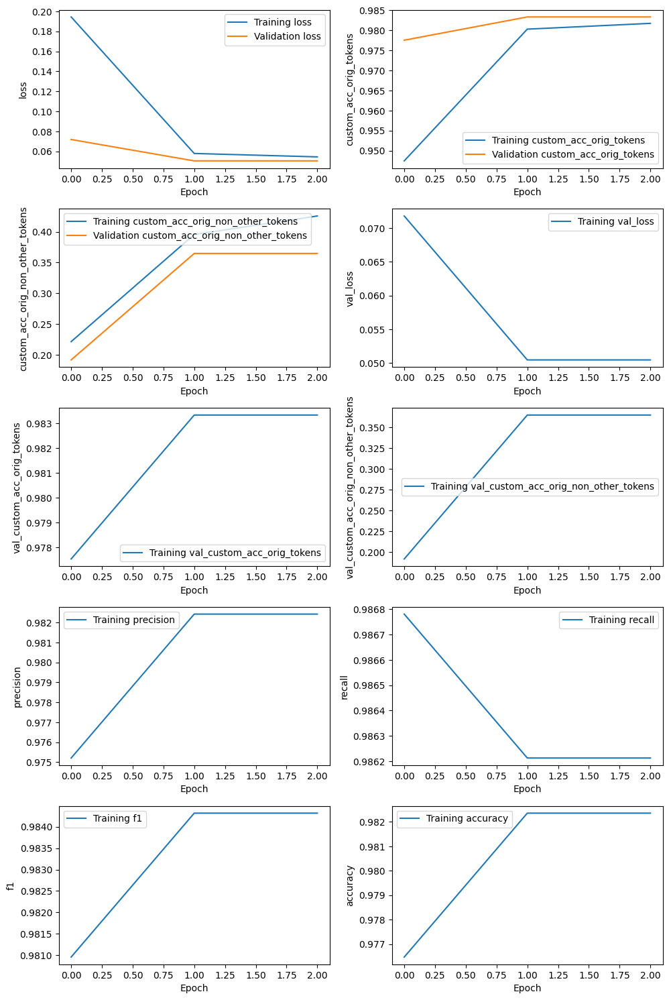

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r2_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.278,0.294,0.286,153,,
OLEFIN,0.602,0.390,0.474,356,,
PRE_CATALYST,0.278,0.423,0.335,71,,
SOLVENT,1.000,0.267,0.422,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.462,0.314,0.374,,0.982,0.659


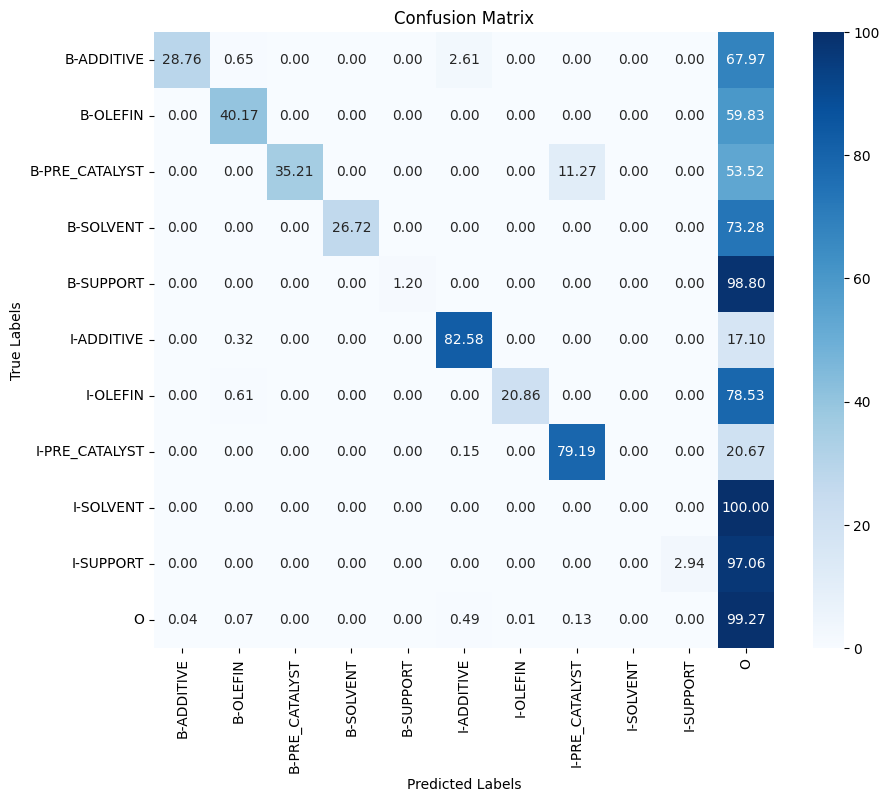

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 130s 191ms/step - loss: 0.2047 - custom_acc_orig_tokens: 0.9431 - custom_acc_orig_non_other_tokens: 0.2071 - val_loss: 0.0647 - val_custom_acc_orig_tokens: 0.9792 - val_custom_acc_orig_non_other_tokens: 0.2290 - precision: 0.9769 - recall: 0.9871 - f1: 0.9820 - accuracy: 0.9783
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0581 - custom_acc_orig_tokens: 0.9800 - custom_acc_orig_non_other_tokens: 0.3876 - val_loss: 0.0519 - val_custom_acc_orig_tokens: 0.9825 - val_custom_acc_orig_non_other_tokens: 0.3502 - precision: 0.9821 - recall: 0.9857 - f1: 0.9839 - accuracy: 0.9816
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0556 - custom_acc_orig_tokens: 0.9811 - custom_acc_orig_non_other_tokens: 0.4168 - val_loss: 0.0519 - val_custom_acc_orig_tokens: 0.9825 - val_custom_acc_orig_non_other_tokens: 0.3502 - precision: 0.9821 - recall: 0.9857 - f1: 0.9839 - accuracy: 0.9816


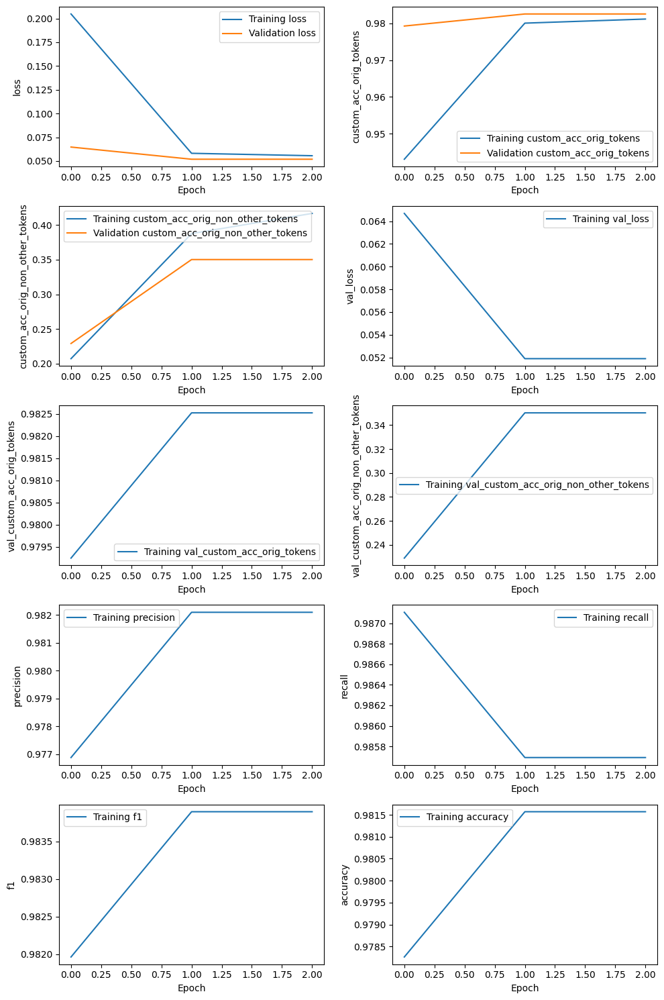

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_5e-05_r3_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.331,0.333,0.332,153,,
OLEFIN,0.612,0.284,0.388,356,,
PRE_CATALYST,0.307,0.437,0.360,71,,
SOLVENT,1.000,0.282,0.440,131,,
SUPPORT,0.429,0.036,0.067,83,,
OVERALL,0.481,0.281,0.355,,0.981,0.647


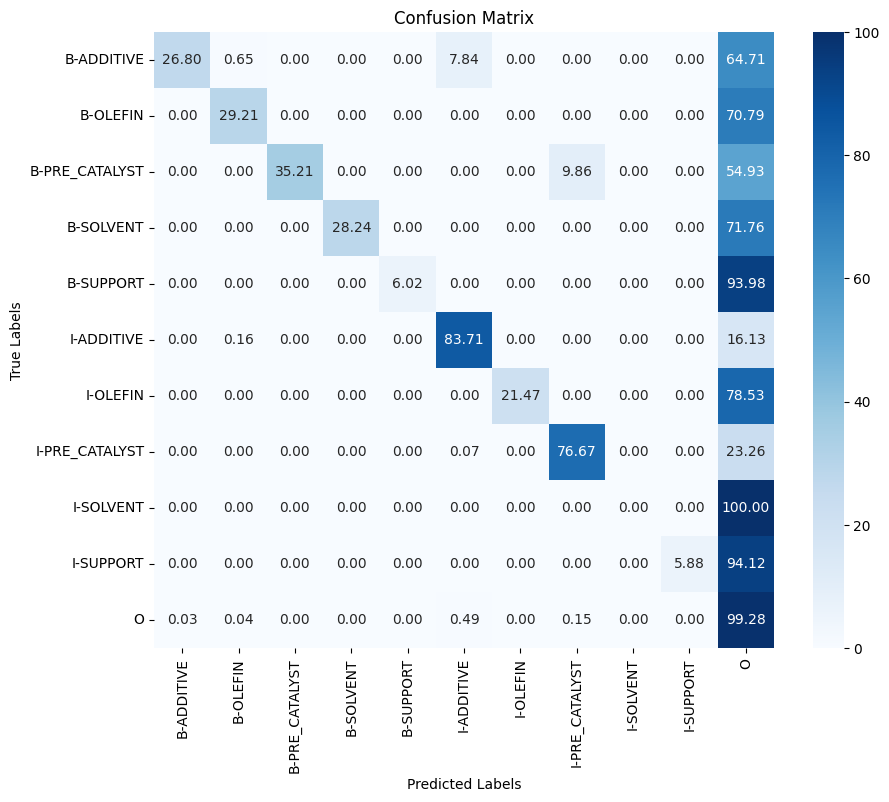

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 129s 195ms/step - loss: 0.1461 - custom_acc_orig_tokens: 0.9656 - custom_acc_orig_non_other_tokens: 0.2560 - val_loss: 0.0586 - val_custom_acc_orig_tokens: 0.9808 - val_custom_acc_orig_non_other_tokens: 0.2717 - precision: 0.9787 - recall: 0.9879 - f1: 0.9833 - accuracy: 0.9798
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0485 - custom_acc_orig_tokens: 0.9825 - custom_acc_orig_non_other_tokens: 0.4761 - val_loss: 0.0455 - val_custom_acc_orig_tokens: 0.9842 - val_custom_acc_orig_non_other_tokens: 0.4346 - precision: 0.9834 - recall: 0.9872 - f1: 0.9853 - accuracy: 0.9833
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0452 - custom_acc_orig_tokens: 0.9841 - custom_acc_orig_non_other_tokens: 0.5220 - val_loss: 0.0455 - val_custom_acc_orig_tokens: 0.9842 - val_custom_acc_orig_non_other_tokens: 0.4346 - precision: 0.9834 - recall: 0.9872 - f1: 0.9853 - accuracy: 0.9833


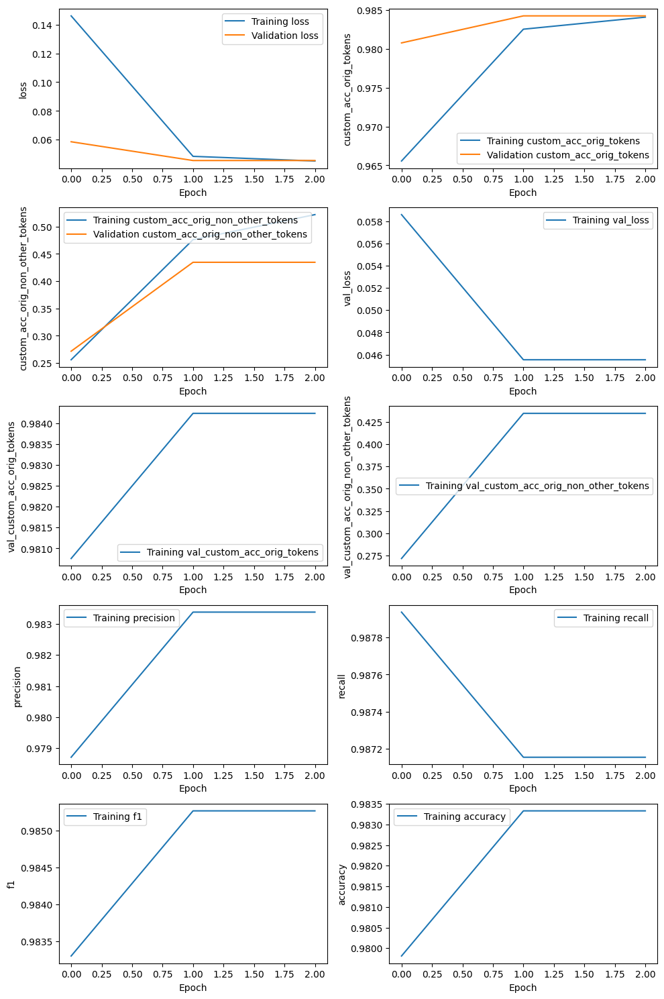

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r1_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.420,0.516,0.463,153,,
OLEFIN,0.638,0.506,0.564,356,,
PRE_CATALYST,0.327,0.521,0.402,71,,
SOLVENT,0.953,0.313,0.471,131,,
SUPPORT,0.536,0.181,0.270,83,,
OVERALL,0.538,0.443,0.486,,0.983,0.689


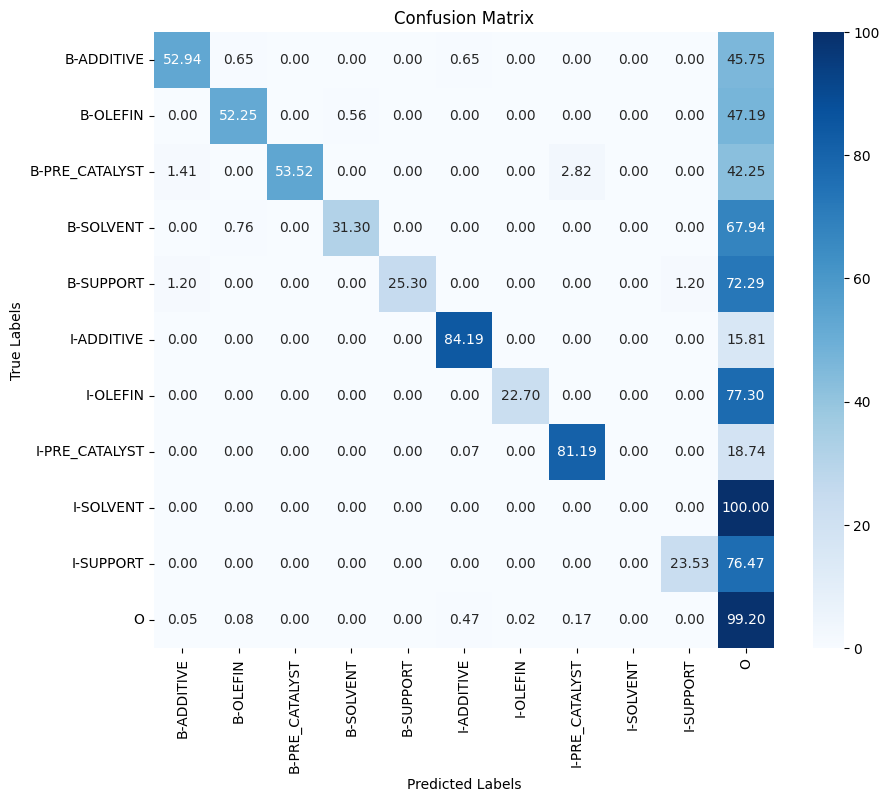

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 189ms/step - loss: 0.1707 - custom_acc_orig_tokens: 0.9526 - custom_acc_orig_non_other_tokens: 0.2568 - val_loss: 0.0670 - val_custom_acc_orig_tokens: 0.9784 - val_custom_acc_orig_non_other_tokens: 0.2258 - precision: 0.9762 - recall: 0.9878 - f1: 0.9820 - accuracy: 0.9773
Epoch 2/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0503 - custom_acc_orig_tokens: 0.9820 - custom_acc_orig_non_other_tokens: 0.4567 - val_loss: 0.0456 - val_custom_acc_orig_tokens: 0.9843 - val_custom_acc_orig_non_other_tokens: 0.4358 - precision: 0.9836 - recall: 0.9869 - f1: 0.9852 - accuracy: 0.9834
Epoch 3/3
526/526 [==============================] - 73s 138ms/step - loss: 0.0466 - custom_acc_orig_tokens: 0.9836 - custom_acc_orig_non_other_tokens: 0.4949 - val_loss: 0.0456 - val_custom_acc_orig_tokens: 0.9843 - val_custom_acc_orig_non_other_tokens: 0.4358 - precision: 0.9836 - recall: 0.9869 - f1: 0.9852 - accuracy: 0.9834


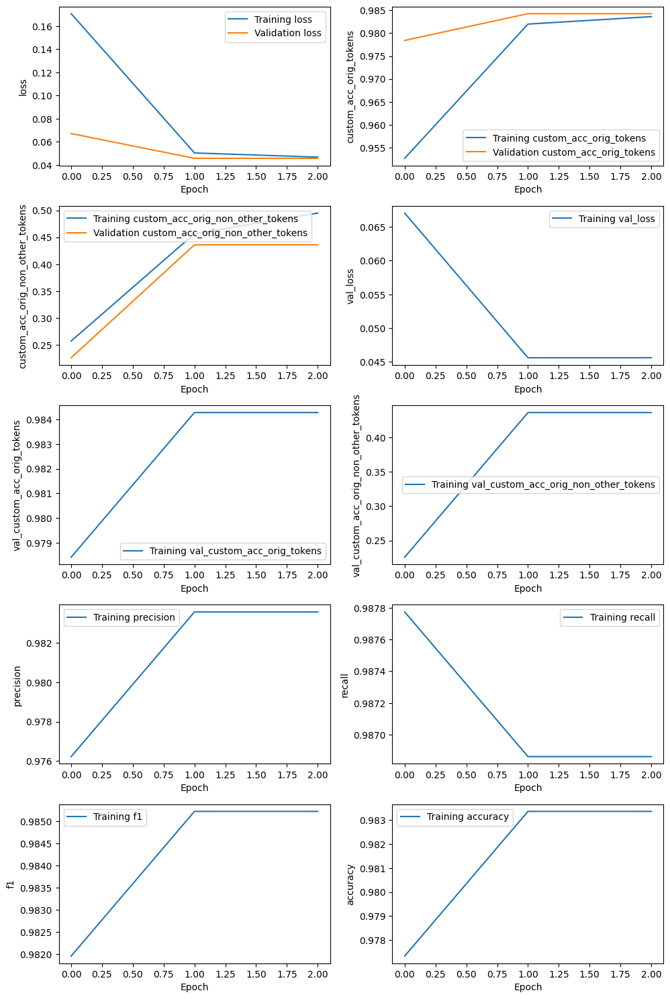

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r2_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.356,0.418,0.384,153,,
OLEFIN,0.621,0.455,0.525,356,,
PRE_CATALYST,0.371,0.549,0.443,71,,
SOLVENT,0.959,0.359,0.522,131,,
SUPPORT,0.417,0.060,0.105,83,,
OVERALL,0.522,0.399,0.453,,0.982,0.683


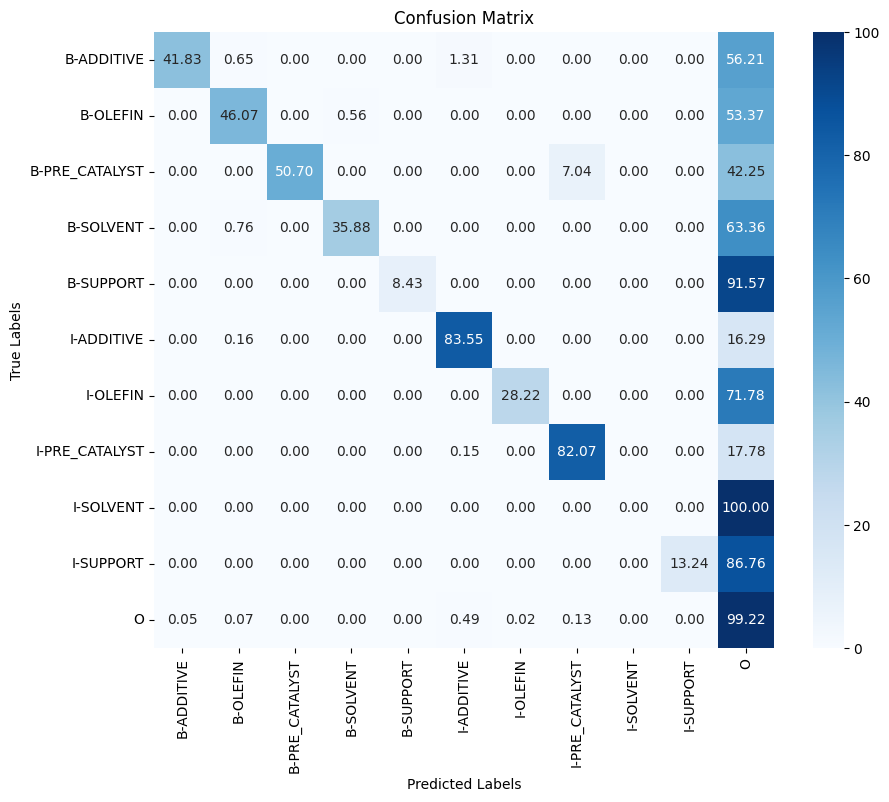

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.1779 - custom_acc_orig_tokens: 0.9496 - custom_acc_orig_non_other_tokens: 0.2461 - val_loss: 0.0627 - val_custom_acc_orig_tokens: 0.9800 - val_custom_acc_orig_non_other_tokens: 0.2635 - precision: 0.9778 - recall: 0.9880 - f1: 0.9829 - accuracy: 0.9790
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0503 - custom_acc_orig_tokens: 0.9819 - custom_acc_orig_non_other_tokens: 0.4527 - val_loss: 0.0468 - val_custom_acc_orig_tokens: 0.9839 - val_custom_acc_orig_non_other_tokens: 0.4139 - precision: 0.9835 - recall: 0.9867 - f1: 0.9851 - accuracy: 0.9830
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0476 - custom_acc_orig_tokens: 0.9832 - custom_acc_orig_non_other_tokens: 0.4952 - val_loss: 0.0468 - val_custom_acc_orig_tokens: 0.9839 - val_custom_acc_orig_non_other_tokens: 0.4139 - precision: 0.9835 - recall: 0.9867 - f1: 0.9851 - accuracy: 0.9830


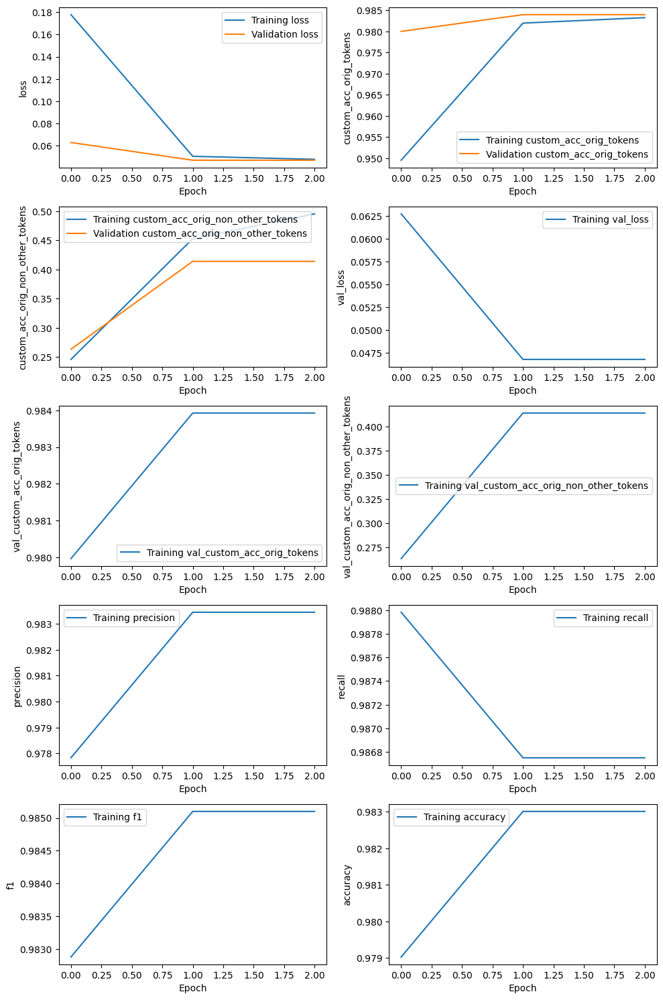

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 86ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_32_8e-05_r3_eval_predictions.json in the repository.

Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.403,0.464,0.432,153,,
OLEFIN,0.632,0.438,0.517,356,,
PRE_CATALYST,0.380,0.577,0.458,71,,
SOLVENT,0.982,0.412,0.581,131,,
SUPPORT,0.444,0.145,0.218,83,,
OVERALL,0.545,0.421,0.475,,0.983,0.687


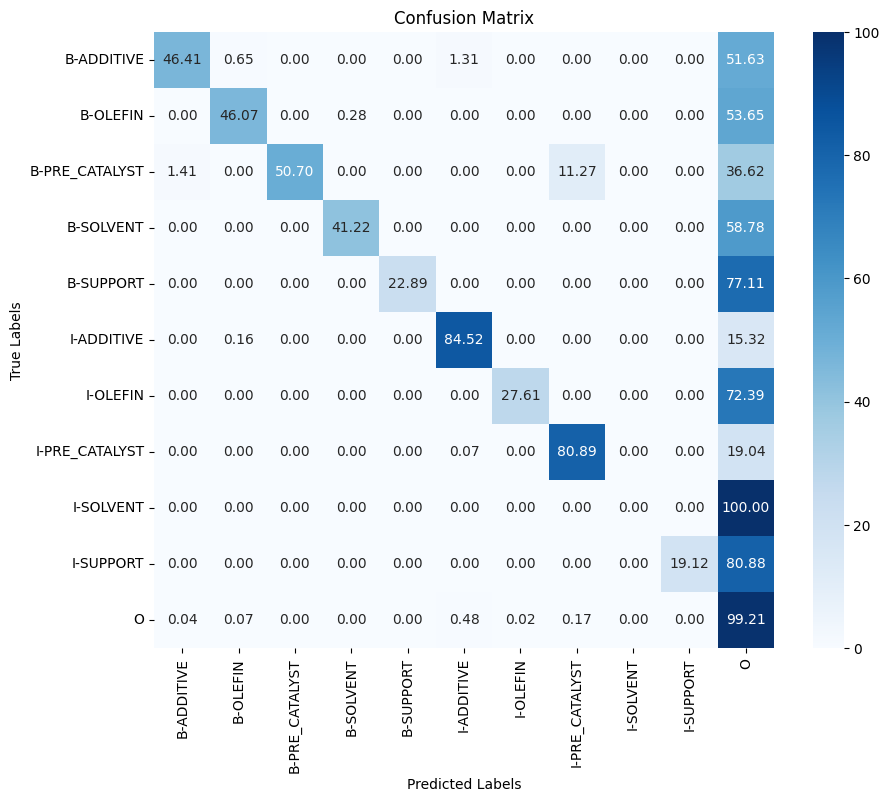

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2022 - custom_acc_orig_tokens: 0.9581 - custom_acc_orig_non_other_tokens: 0.1125

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 127s 190ms/step - loss: 0.2022 - custom_acc_orig_tokens: 0.9581 - custom_acc_orig_non_other_tokens: 0.1125 - val_loss: 0.0892 - val_custom_acc_orig_tokens: 0.9770 - val_custom_acc_orig_non_other_tokens: 0.1837 - precision: 0.9749 - recall: 0.9838 - f1: 0.9793 - accuracy: 0.9758
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1133 - custom_acc_orig_tokens: 0.9702 - custom_acc_orig_non_other_tokens: 0.1826 - val_loss: 0.0892 - val_custom_acc_orig_tokens: 0.9770 - val_custom_acc_orig_non_other_tokens: 0.1837 - precision: 0.9749 - recall: 0.9838 - f1: 0.9793 - accuracy: 0.9758
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1136 - custom_acc_orig_tokens: 0.9702 - custom_acc_orig_non_other_tokens: 0.1820 - val_loss: 0.0892 - val_custom_acc_orig_tokens: 0.9770 - val_custom_acc_orig_non_other_tokens: 0.1837 - precision: 0.9749 - recall: 0.9838 - f1: 0.9793 - accuracy: 0.9758


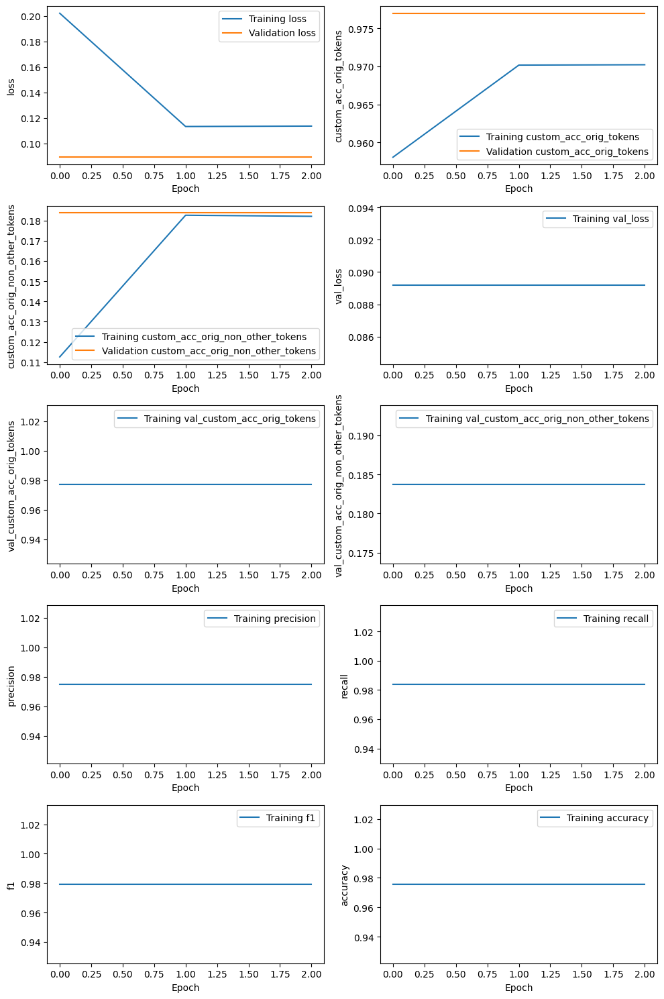

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.056,0.046,0.051,153,,
OLEFIN,0.000,0.000,0.000,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.025,0.009,0.013,,0.974,0.403


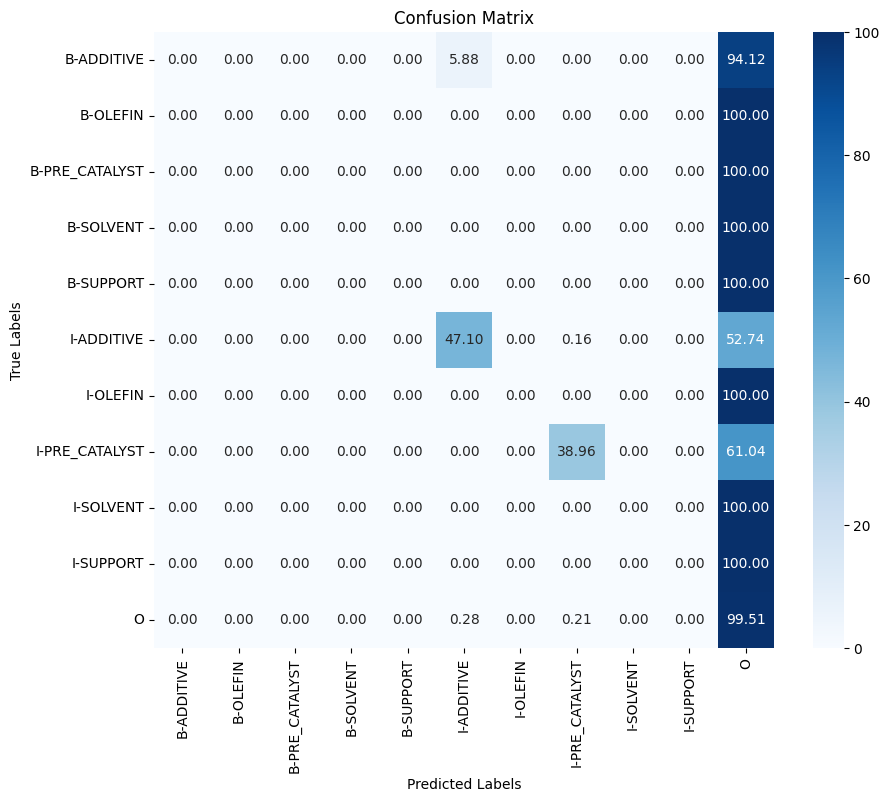

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2369 - custom_acc_orig_tokens: 0.9399 - custom_acc_orig_non_other_tokens: 0.1058

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 130s 196ms/step - loss: 0.2369 - custom_acc_orig_tokens: 0.9399 - custom_acc_orig_non_other_tokens: 0.1058 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9760 - val_custom_acc_orig_non_other_tokens: 0.1618 - precision: 0.9741 - recall: 0.9833 - f1: 0.9787 - accuracy: 0.9748
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1181 - custom_acc_orig_tokens: 0.9693 - custom_acc_orig_non_other_tokens: 0.1630 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9760 - val_custom_acc_orig_non_other_tokens: 0.1618 - precision: 0.9741 - recall: 0.9833 - f1: 0.9787 - accuracy: 0.9748
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1179 - custom_acc_orig_tokens: 0.9694 - custom_acc_orig_non_other_tokens: 0.1645 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9760 - val_custom_acc_orig_non_other_tokens: 0.1618 - precision: 0.9741 - recall: 0.9833 - f1: 0.9787 - accuracy: 0.9748


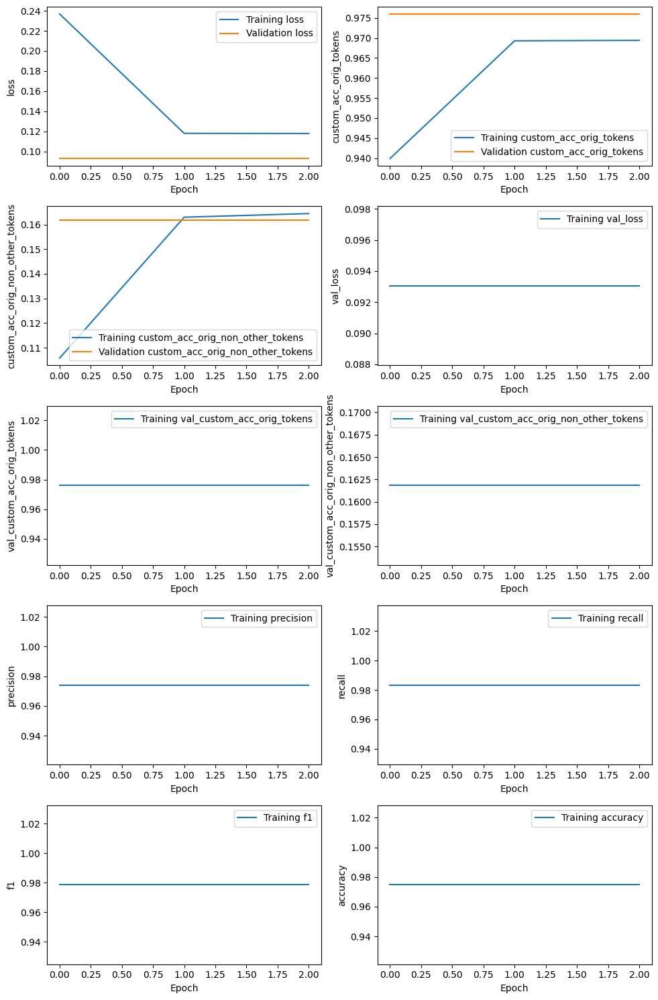

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.014,0.013,0.014,153,,
OLEFIN,0.000,0.000,0.000,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.007,0.003,0.004,,0.974,0.386


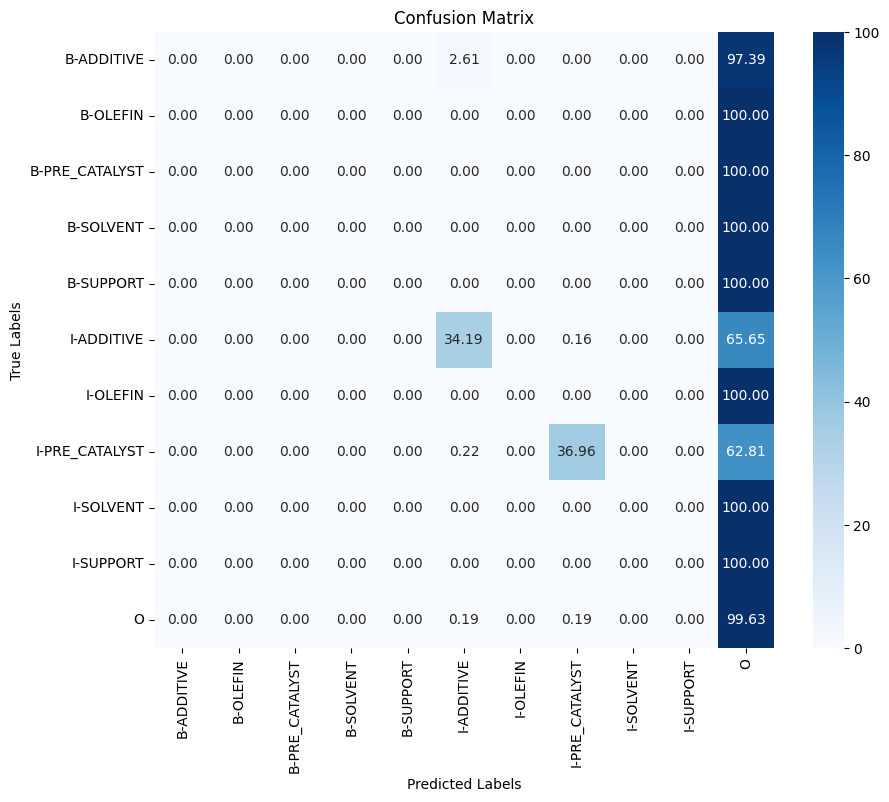

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.2512 - custom_acc_orig_tokens: 0.9341 - custom_acc_orig_non_other_tokens: 0.0712

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 127s 190ms/step - loss: 0.2512 - custom_acc_orig_tokens: 0.9341 - custom_acc_orig_non_other_tokens: 0.0712 - val_loss: 0.0965 - val_custom_acc_orig_tokens: 0.9740 - val_custom_acc_orig_non_other_tokens: 0.1246 - precision: 0.9716 - recall: 0.9844 - f1: 0.9780 - accuracy: 0.9727
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1219 - custom_acc_orig_tokens: 0.9673 - custom_acc_orig_non_other_tokens: 0.1174 - val_loss: 0.0965 - val_custom_acc_orig_tokens: 0.9740 - val_custom_acc_orig_non_other_tokens: 0.1246 - precision: 0.9716 - recall: 0.9844 - f1: 0.9780 - accuracy: 0.9727
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.1221 - custom_acc_orig_tokens: 0.9672 - custom_acc_orig_non_other_tokens: 0.1200 - val_loss: 0.0965 - val_custom_acc_orig_tokens: 0.9740 - val_custom_acc_orig_non_other_tokens: 0.1246 - precision: 0.9716 - recall: 0.9844 - f1: 0.9780 - accuracy: 0.9727


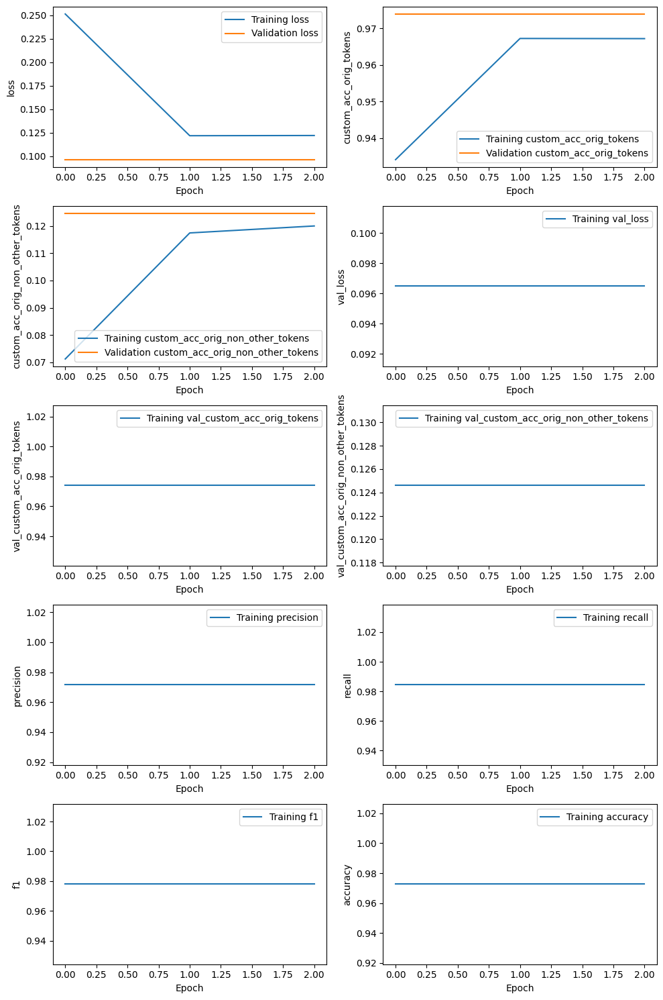

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 84ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_2e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.054,0.046,0.050,153,,
OLEFIN,0.000,0.000,0.000,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.032,0.009,0.014,,0.973,0.336


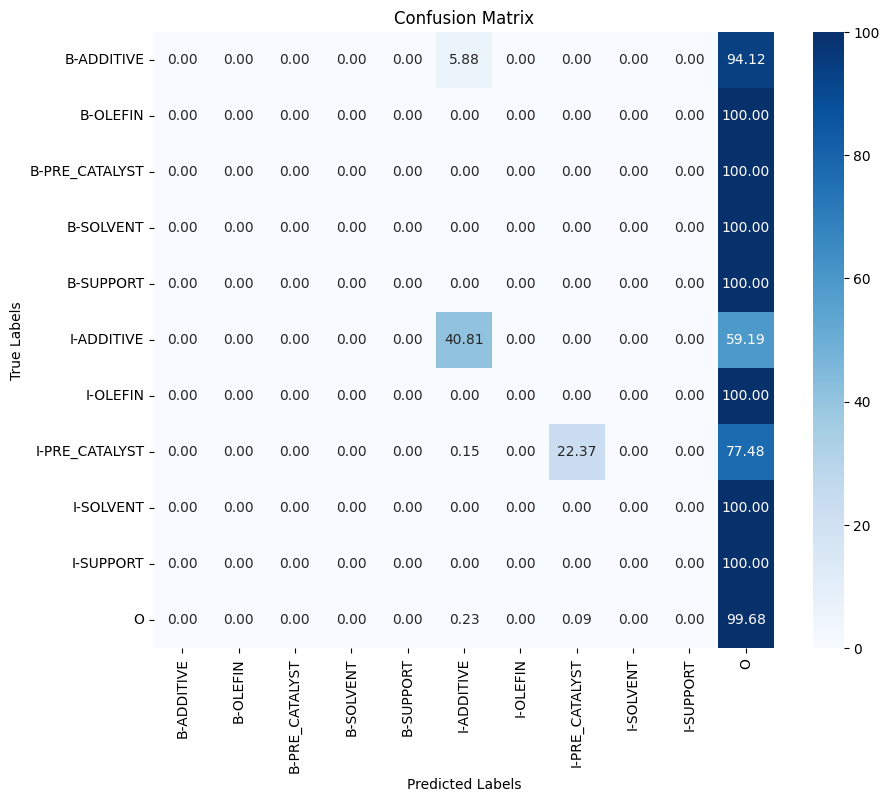

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 128s 190ms/step - loss: 0.1548 - custom_acc_orig_tokens: 0.9643 - custom_acc_orig_non_other_tokens: 0.1851 - val_loss: 0.0672 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2581 - precision: 0.9794 - recall: 0.9841 - f1: 0.9817 - accuracy: 0.9788
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0821 - custom_acc_orig_tokens: 0.9753 - custom_acc_orig_non_other_tokens: 0.2713 - val_loss: 0.0672 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2581 - precision: 0.9794 - recall: 0.9841 - f1: 0.9817 - accuracy: 0.9788
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0823 - custom_acc_orig_tokens: 0.9752 - custom_acc_orig_non_other_tokens: 0.2686 - val_loss: 0.0672 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.2581 - precision: 0.9794 - recall: 0.9841 - f1: 0.9817 - accuracy: 0.9788


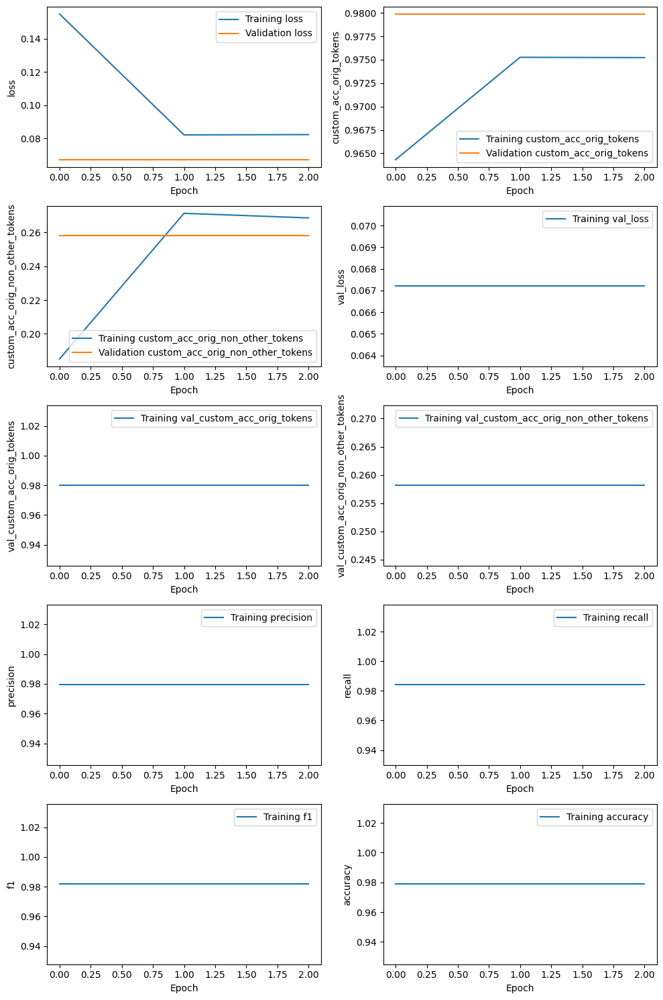

526/526 [==============================] - 54s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.045,0.033,0.038,153,,
OLEFIN,0.726,0.253,0.375,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.254,0.120,0.163,,0.978,0.555


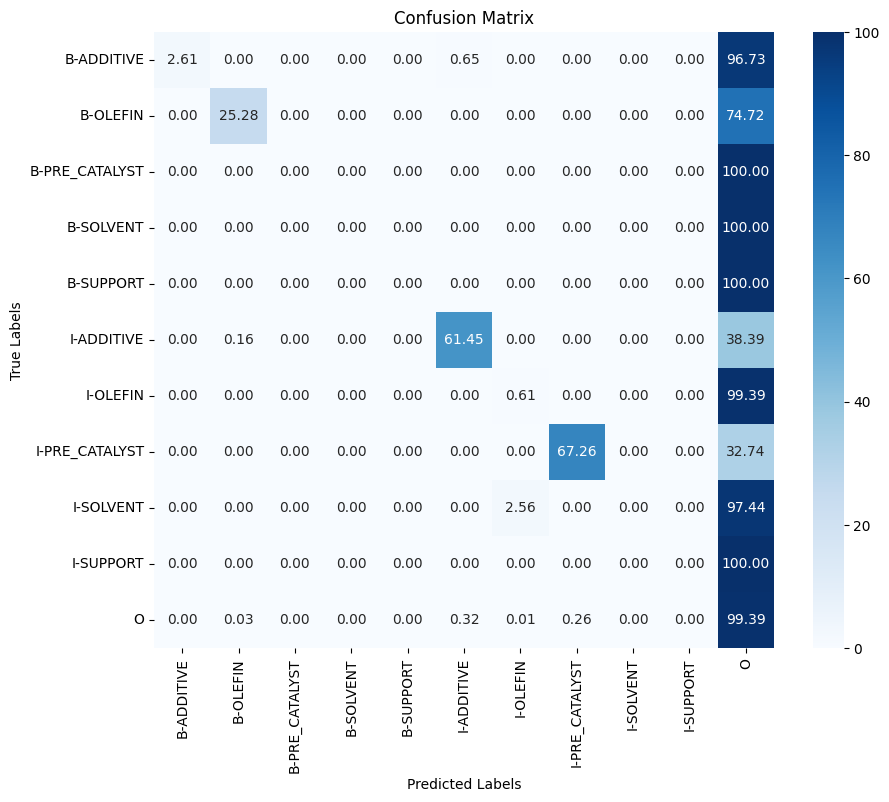

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 126s 189ms/step - loss: 0.1785 - custom_acc_orig_tokens: 0.9527 - custom_acc_orig_non_other_tokens: 0.1883 - val_loss: 0.0697 - val_custom_acc_orig_tokens: 0.9796 - val_custom_acc_orig_non_other_tokens: 0.2435 - precision: 0.9787 - recall: 0.9834 - f1: 0.9810 - accuracy: 0.9785
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0860 - custom_acc_orig_tokens: 0.9749 - custom_acc_orig_non_other_tokens: 0.2682 - val_loss: 0.0697 - val_custom_acc_orig_tokens: 0.9796 - val_custom_acc_orig_non_other_tokens: 0.2435 - precision: 0.9787 - recall: 0.9834 - f1: 0.9810 - accuracy: 0.9785
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0857 - custom_acc_orig_tokens: 0.9751 - custom_acc_orig_non_other_tokens: 0.2683 - val_loss: 0.0697 - val_custom_acc_orig_tokens: 0.9796 - val_custom_acc_orig_non_other_tokens: 0.2435 - precision: 0.9787 - recall: 0.9834 - f1: 0.9810 - accuracy: 0.9785


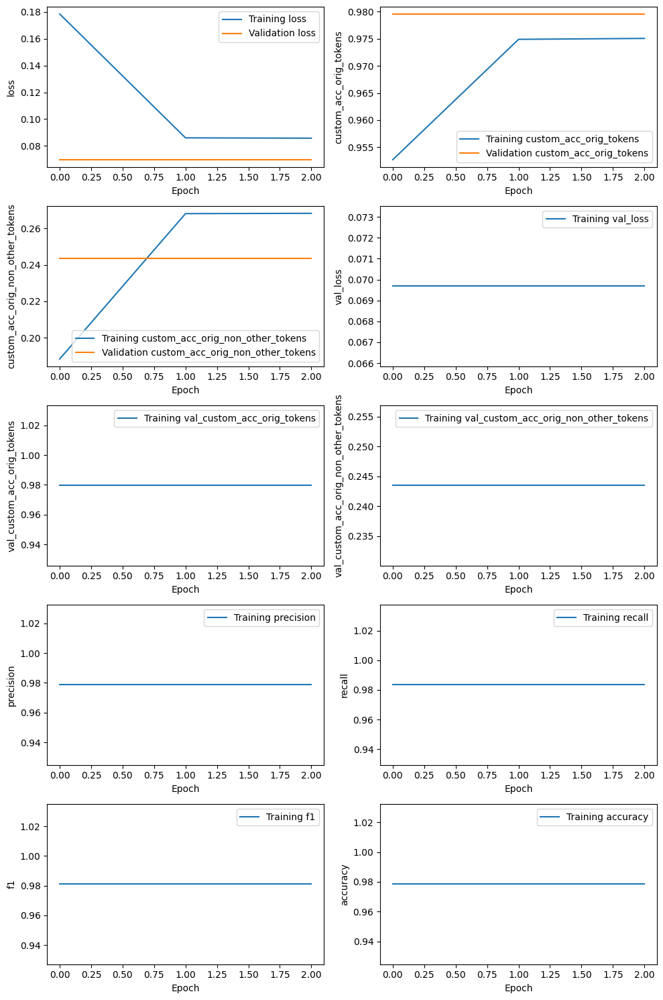

526/526 [==============================] - 55s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
Updated data/interim/B_scibert_catalyst_none_concat_64_5e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.007,0.007,0.007,153,,
OLEFIN,0.762,0.135,0.229,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.136,0.062,0.085,,0.978,0.541


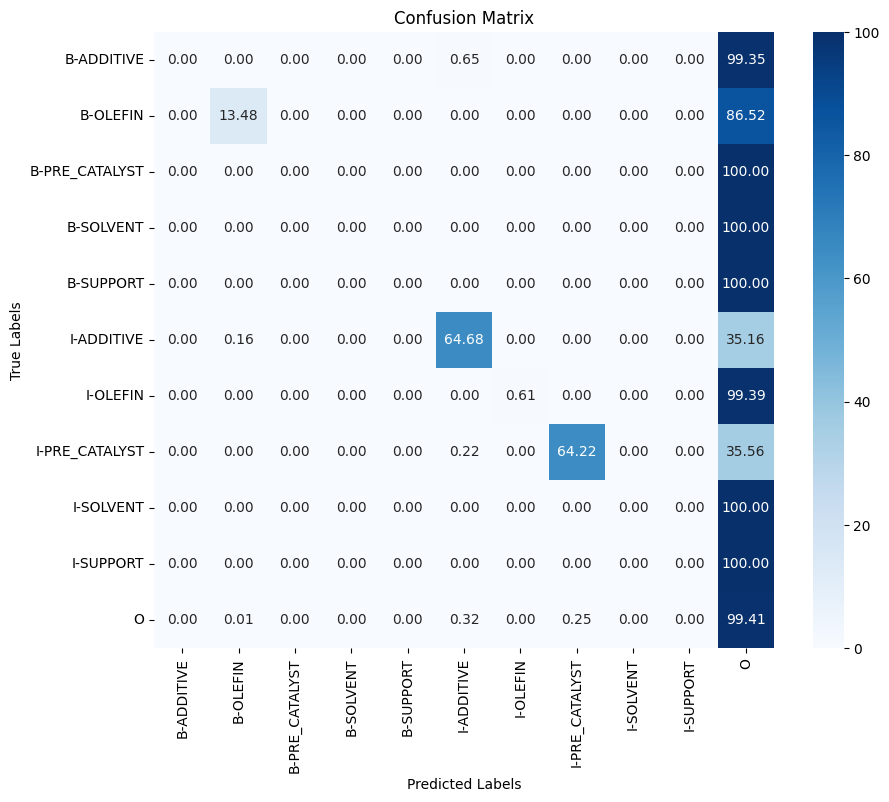

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - ETA: 0s - loss: 0.1868 - custom_acc_orig_tokens: 0.9490 - custom_acc_orig_non_other_tokens: 0.1654

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


526/526 [==============================] - 127s 190ms/step - loss: 0.1868 - custom_acc_orig_tokens: 0.9490 - custom_acc_orig_non_other_tokens: 0.1654 - val_loss: 0.0716 - val_custom_acc_orig_tokens: 0.9783 - val_custom_acc_orig_non_other_tokens: 0.2249 - precision: 0.9772 - recall: 0.9834 - f1: 0.9803 - accuracy: 0.9772
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0881 - custom_acc_orig_tokens: 0.9742 - custom_acc_orig_non_other_tokens: 0.2466 - val_loss: 0.0716 - val_custom_acc_orig_tokens: 0.9783 - val_custom_acc_orig_non_other_tokens: 0.2249 - precision: 0.9772 - recall: 0.9834 - f1: 0.9803 - accuracy: 0.9772
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0884 - custom_acc_orig_tokens: 0.9741 - custom_acc_orig_non_other_tokens: 0.2491 - val_loss: 0.0716 - val_custom_acc_orig_tokens: 0.9783 - val_custom_acc_orig_non_other_tokens: 0.2249 - precision: 0.9772 - recall: 0.9834 - f1: 0.9803 - accuracy: 0.9772


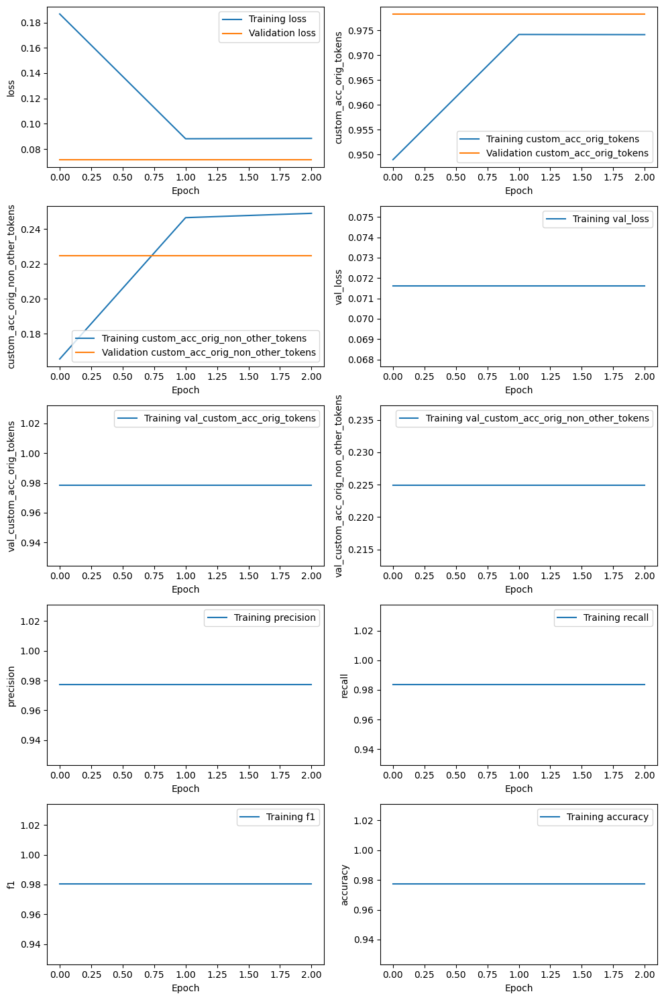

526/526 [==============================] - 54s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_5e-05_r3_eval_predictions.json in the reposit

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.049,0.039,0.044,153,,
OLEFIN,1.000,0.011,0.022,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.035,0.013,0.019,,0.976,0.506


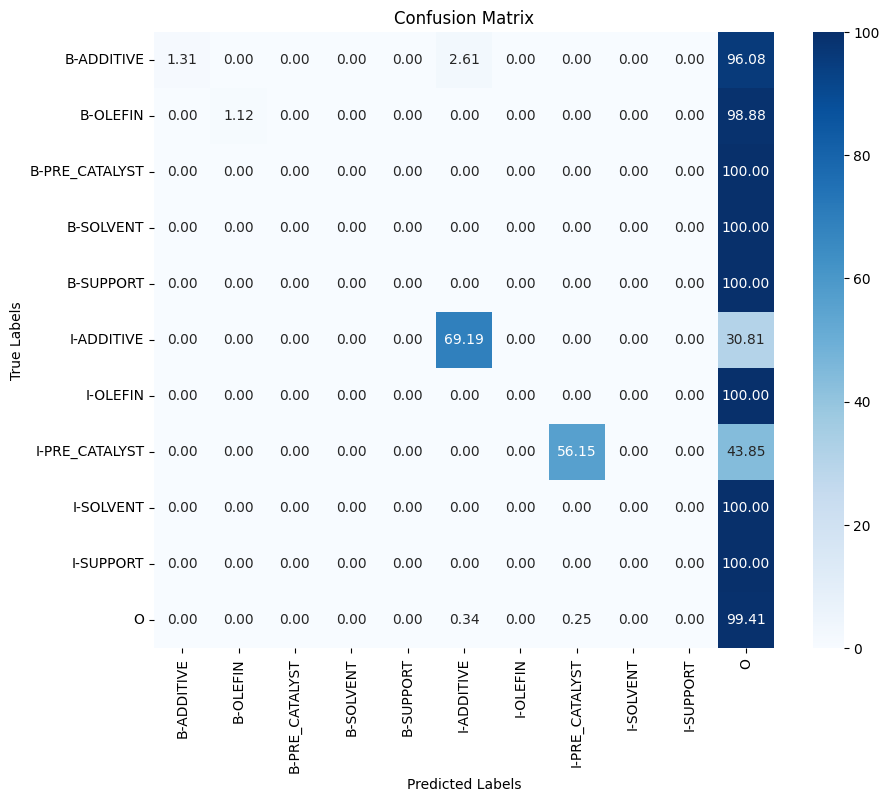

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 131s 191ms/step - loss: 0.1380 - custom_acc_orig_tokens: 0.9661 - custom_acc_orig_non_other_tokens: 0.2167 - val_loss: 0.0594 - val_custom_acc_orig_tokens: 0.9809 - val_custom_acc_orig_non_other_tokens: 0.3009 - precision: 0.9809 - recall: 0.9846 - f1: 0.9828 - accuracy: 0.9799
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0710 - custom_acc_orig_tokens: 0.9769 - custom_acc_orig_non_other_tokens: 0.3223 - val_loss: 0.0594 - val_custom_acc_orig_tokens: 0.9809 - val_custom_acc_orig_non_other_tokens: 0.3009 - precision: 0.9809 - recall: 0.9846 - f1: 0.9828 - accuracy: 0.9799
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0711 - custom_acc_orig_tokens: 0.9771 - custom_acc_orig_non_other_tokens: 0.3136 - val_loss: 0.0594 - val_custom_acc_orig_tokens: 0.9809 - val_custom_acc_orig_non_other_tokens: 0.3009 - precision: 0.9809 - recall: 0.9846 - f1: 0.9828 - accuracy: 0.9799


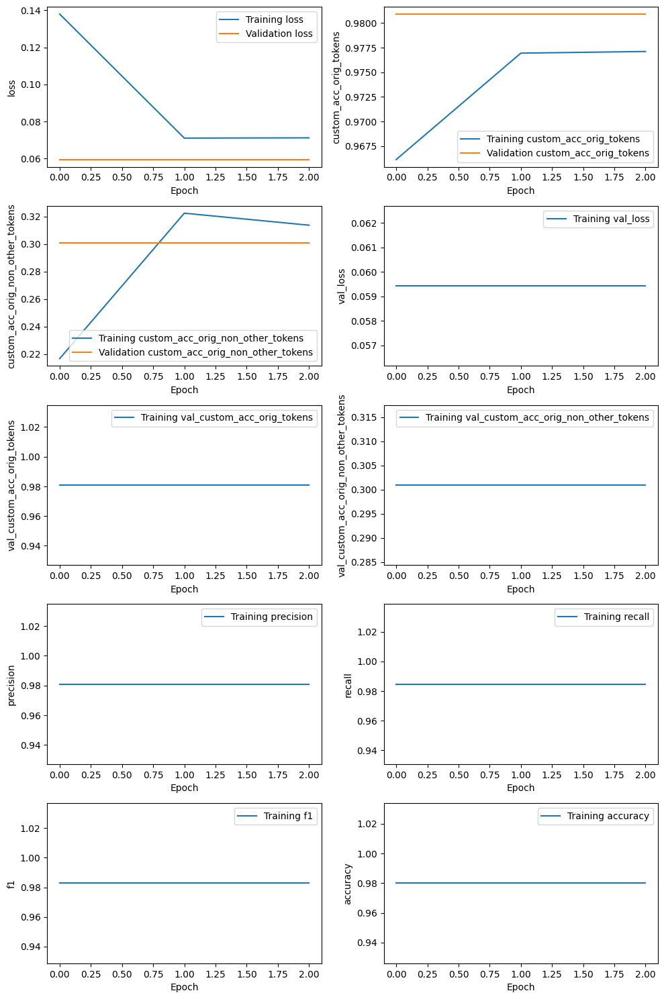

526/526 [==============================] - 54s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 8s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r1_eval_predictions.json in the reposit

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.080,0.059,0.068,153,,
OLEFIN,0.561,0.388,0.458,356,,
PRE_CATALYST,0.007,0.014,0.009,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.291,0.186,0.227,,0.979,0.593


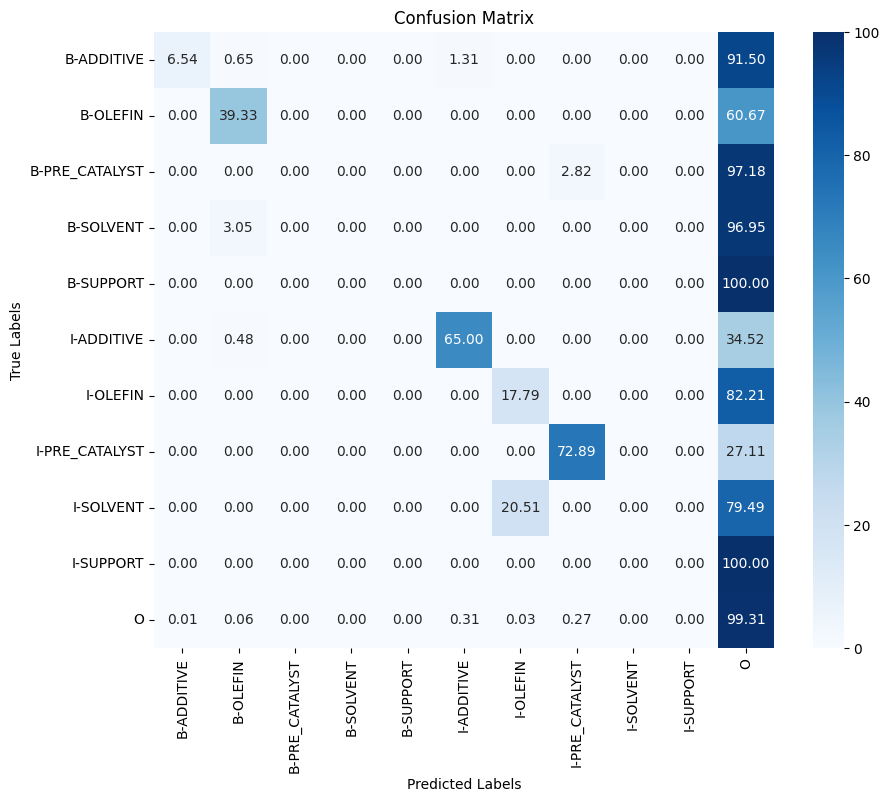

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 127s 190ms/step - loss: 0.1582 - custom_acc_orig_tokens: 0.9567 - custom_acc_orig_non_other_tokens: 0.2106 - val_loss: 0.0619 - val_custom_acc_orig_tokens: 0.9807 - val_custom_acc_orig_non_other_tokens: 0.2893 - precision: 0.9808 - recall: 0.9842 - f1: 0.9825 - accuracy: 0.9797
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0743 - custom_acc_orig_tokens: 0.9764 - custom_acc_orig_non_other_tokens: 0.3027 - val_loss: 0.0619 - val_custom_acc_orig_tokens: 0.9807 - val_custom_acc_orig_non_other_tokens: 0.2893 - precision: 0.9808 - recall: 0.9842 - f1: 0.9825 - accuracy: 0.9797
Epoch 3/3
526/526 [==============================] - 72s 136ms/step - loss: 0.0740 - custom_acc_orig_tokens: 0.9767 - custom_acc_orig_non_other_tokens: 0.3008 - val_loss: 0.0619 - val_custom_acc_orig_tokens: 0.9807 - val_custom_acc_orig_non_other_tokens: 0.2893 - precision: 0.9808 - recall: 0.9842 - f1: 0.9825 - accuracy: 0.9797


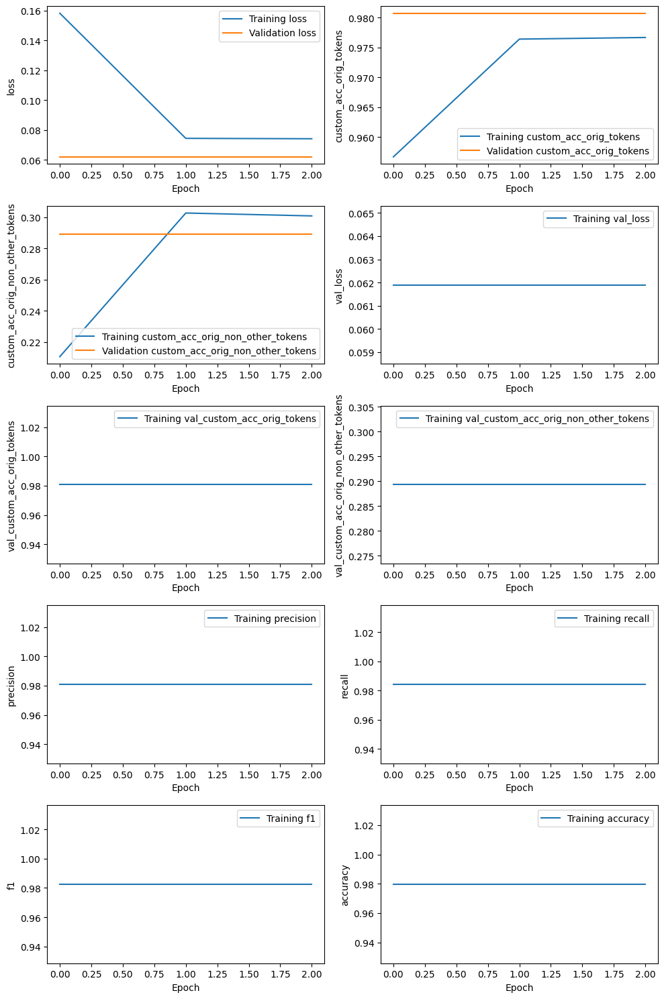

526/526 [==============================] - 54s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 8s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r2_eval_predictions.json in the reposit

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.042,0.039,0.040,153,,
OLEFIN,0.589,0.317,0.412,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.242,0.150,0.185,,0.979,0.580


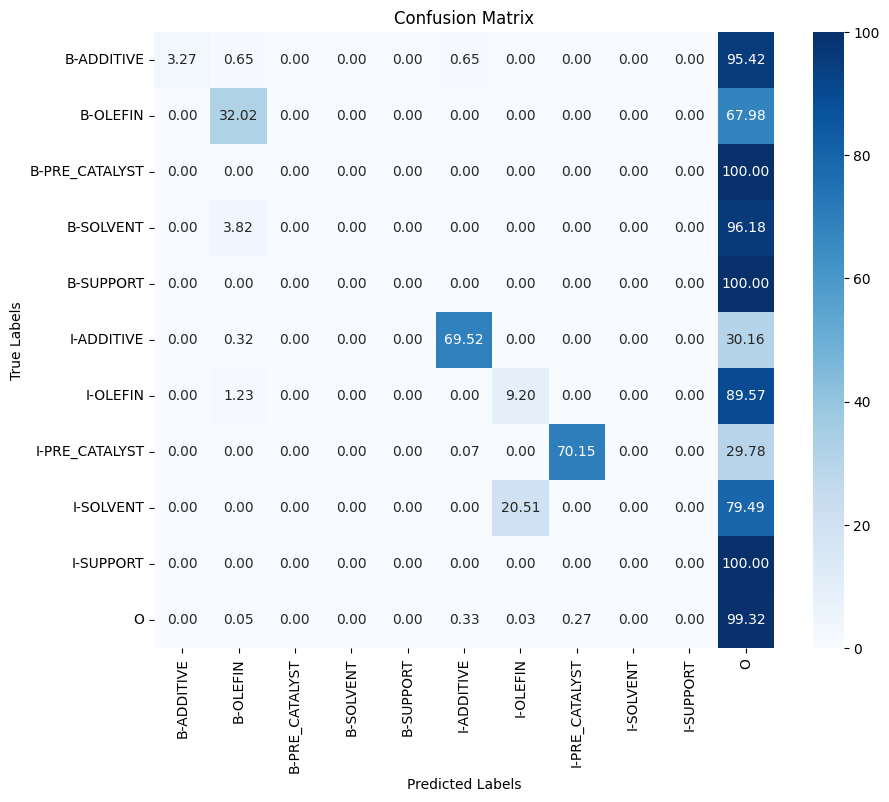

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.decoder.bias', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.decoder.weight', 'cls.predictions.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.transform.dense.bias', 'cls.seq_relationship.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_fileqcech6ou.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 132s 191ms/step - loss: 0.1636 - custom_acc_orig_tokens: 0.9540 - custom_acc_orig_non_other_tokens: 0.1945 - val_loss: 0.0622 - val_custom_acc_orig_tokens: 0.9800 - val_custom_acc_orig_non_other_tokens: 0.2624 - precision: 0.9796 - recall: 0.9841 - f1: 0.9818 - accuracy: 0.9790
Epoch 2/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0754 - custom_acc_orig_tokens: 0.9761 - custom_acc_orig_non_other_tokens: 0.2800 - val_loss: 0.0622 - val_custom_acc_orig_tokens: 0.9800 - val_custom_acc_orig_non_other_tokens: 0.2624 - precision: 0.9796 - recall: 0.9841 - f1: 0.9818 - accuracy: 0.9790
Epoch 3/3
526/526 [==============================] - 72s 137ms/step - loss: 0.0758 - custom_acc_orig_tokens: 0.9760 - custom_acc_orig_non_other_tokens: 0.2865 - val_loss: 0.0622 - val_custom_acc_orig_tokens: 0.9800 - val_custom_acc_orig_non_other_tokens: 0.2624 - precision: 0.9796 - recall: 0.9841 - f1: 0.9818 - accuracy: 0.9790


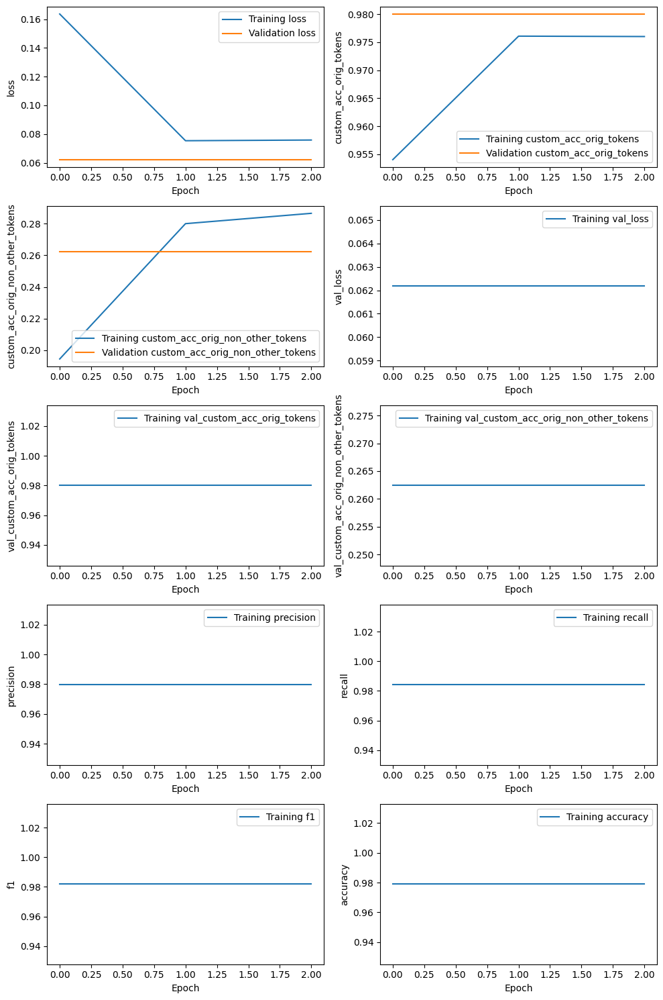

526/526 [==============================] - 54s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 8s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 13s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_none_concat_64_8e-05_r3_eval_predictions.json in the reposit

/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.056,0.046,0.050,153,,
OLEFIN,0.593,0.205,0.305,356,,
PRE_CATALYST,0.000,0.000,0.000,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.197,0.101,0.133,,0.978,0.561


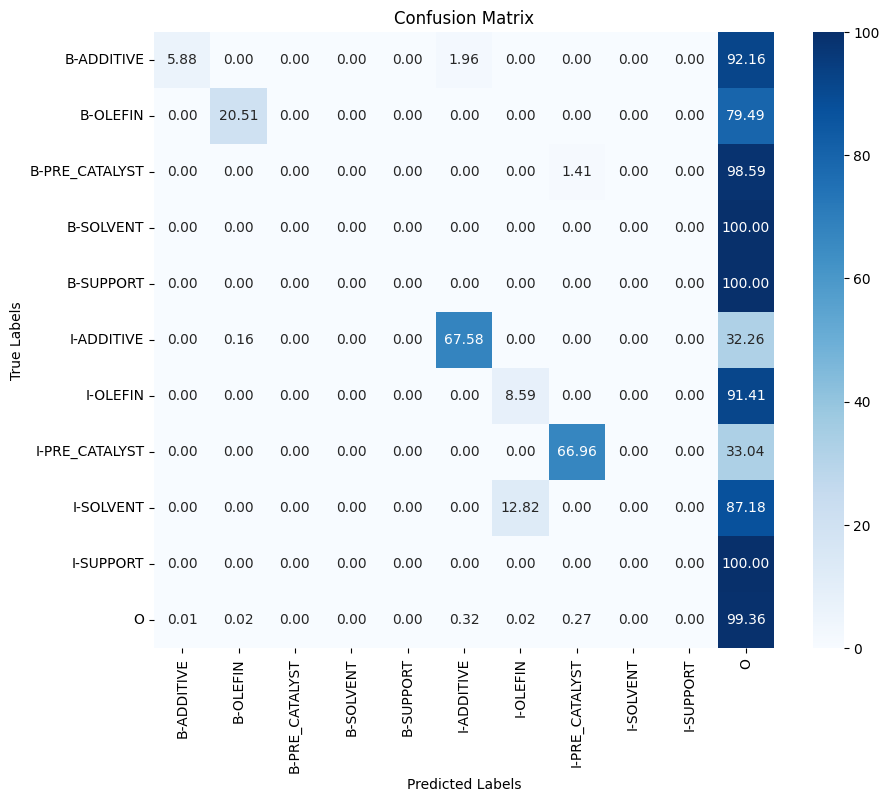

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

In [ ]:
# Catalyst dataset -- feature-based appraoch w/ concatenation of last 4 hidden layers (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models3 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='B_',
    dataset='catalyst',
    train_strategy='none', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['concat'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:  14443s/27replicates = 8.9mins/replicate

### catalyst_feature-based

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

Map:   0%|          | 0/8409 [00:00<?, ? examples/s]

Map:   0%|          | 0/1485 [00:00<?, ? examples/s]

Map:   0%|          | 0/2474 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/datasets/arrow_dataset.py:410: FutureWarning: The output of `to_tf_dataset` will change when a passing single element list for `labels` or `columns` in the next datasets version. To return a tuple structure rather than dict, pass a single string.
Old behaviour: columns=['a'], labels=['labels'] -> (tf.Tensor, tf.Tensor)  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor)  
New behaviour: columns=['a'],labels=['labels'] -> ({'a': tf.Tensor}, {'labels': tf.Tensor})  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor) 
  warnings.warn(



                    		B_scibert_catalyst_all_last_16_2e-05_r1


pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 197s 278ms/step - loss: 0.2881 - custom_acc_orig_tokens: 0.9177 - custom_acc_orig_non_other_tokens: 0.2497 - val_loss: 0.0733 - val_custom_acc_orig_tokens: 0.9799 - val_custom_acc_orig_non_other_tokens: 0.3096 - precision: 0.9773 - recall: 0.9879 - f1: 0.9826 - accuracy: 0.9791
Epoch 2/3
526/526 [==============================] - 119s 226ms/step - loss: 0.0482 - custom_acc_orig_tokens: 0.9826 - custom_acc_orig_non_other_tokens: 0.5446 - val_loss: 0.0397 - val_custom_acc_orig_tokens: 0.9859 - val_custom_acc_orig_non_other_tokens: 0.5180 - precision: 0.9841 - recall: 0.9901 - f1: 0.9871 - accuracy: 0.9850
Epoch 3/3
526/526 [==============================] - 119s 226ms/step - loss: 0.0287 - custom_acc_orig_tokens: 0.9891 - custom_acc_orig_non_other_tokens: 0.6436 - val_loss: 0.0263 - val_custom_acc_orig_tokens: 0.9897 - val_custom_acc_orig_non_other_tokens: 0.6424 - precision: 0.9885 - recall: 0.9896 - f1: 0.9891 - accuracy: 0.9891


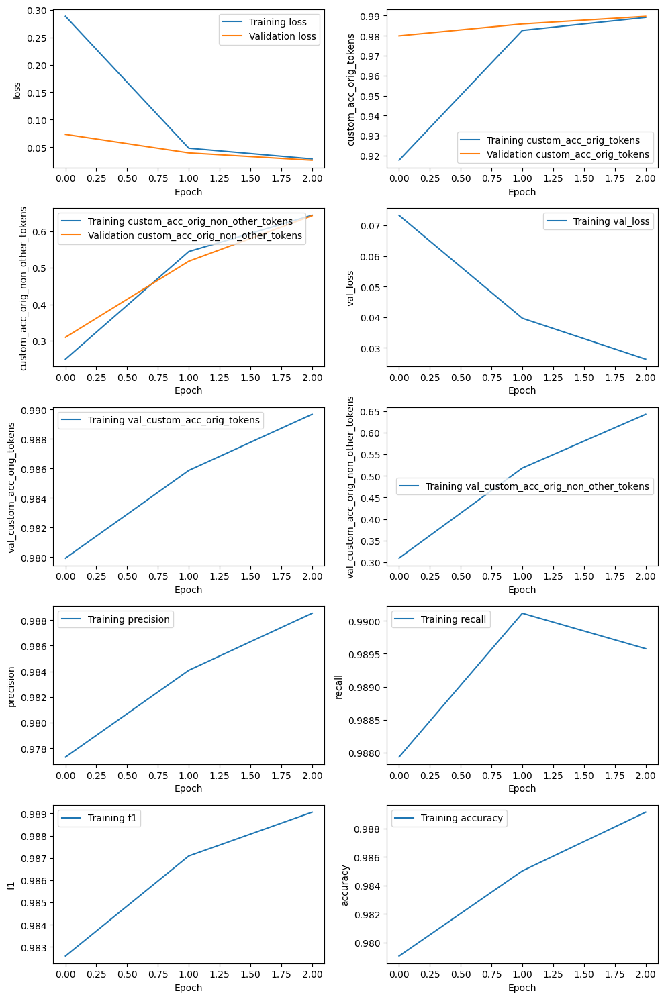

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 11s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.357,0.660,0.463,153,,
OLEFIN,0.582,0.919,0.712,356,,
PRE_CATALYST,0.598,0.732,0.658,71,,
SOLVENT,0.812,0.695,0.749,131,,
SUPPORT,0.627,0.831,0.715,83,,
OVERALL,0.555,0.806,0.657,,0.986,0.773


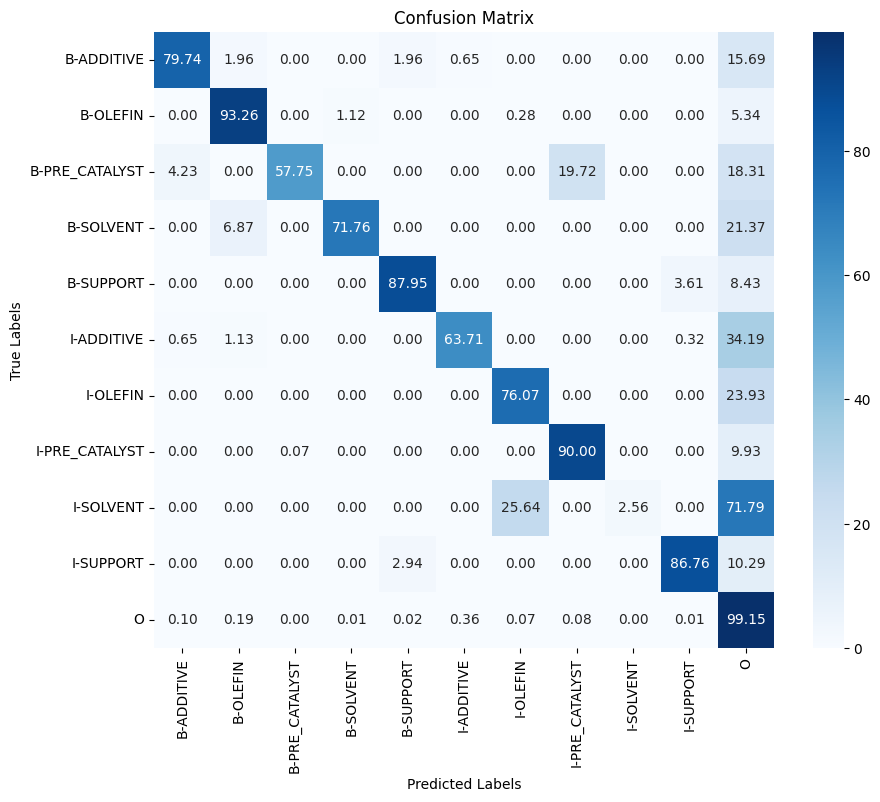

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 183s 277ms/step - loss: 0.2654 - custom_acc_orig_tokens: 0.9204 - custom_acc_orig_non_other_tokens: 0.2536 - val_loss: 0.0860 - val_custom_acc_orig_tokens: 0.9768 - val_custom_acc_orig_non_other_tokens: 0.2869 - precision: 0.9741 - recall: 0.9883 - f1: 0.9811 - accuracy: 0.9757
Epoch 2/3
526/526 [==============================] - 119s 227ms/step - loss: 0.0456 - custom_acc_orig_tokens: 0.9833 - custom_acc_orig_non_other_tokens: 0.5539 - val_loss: 0.0322 - val_custom_acc_orig_tokens: 0.9880 - val_custom_acc_orig_non_other_tokens: 0.5811 - precision: 0.9867 - recall: 0.9905 - f1: 0.9886 - accuracy: 0.9871
Epoch 3/3
526/526 [==============================] - 120s 227ms/step - loss: 0.0276 - custom_acc_orig_tokens: 0.9893 - custom_acc_orig_non_other_tokens: 0.6560 - val_loss: 0.0242 - val_custom_acc_orig_tokens: 0.9901 - val_custom_acc_orig_non_other_tokens: 0.6569 - precision: 0.9893 - recall: 0.9900 - f1: 0.9897 - accuracy: 0.9894


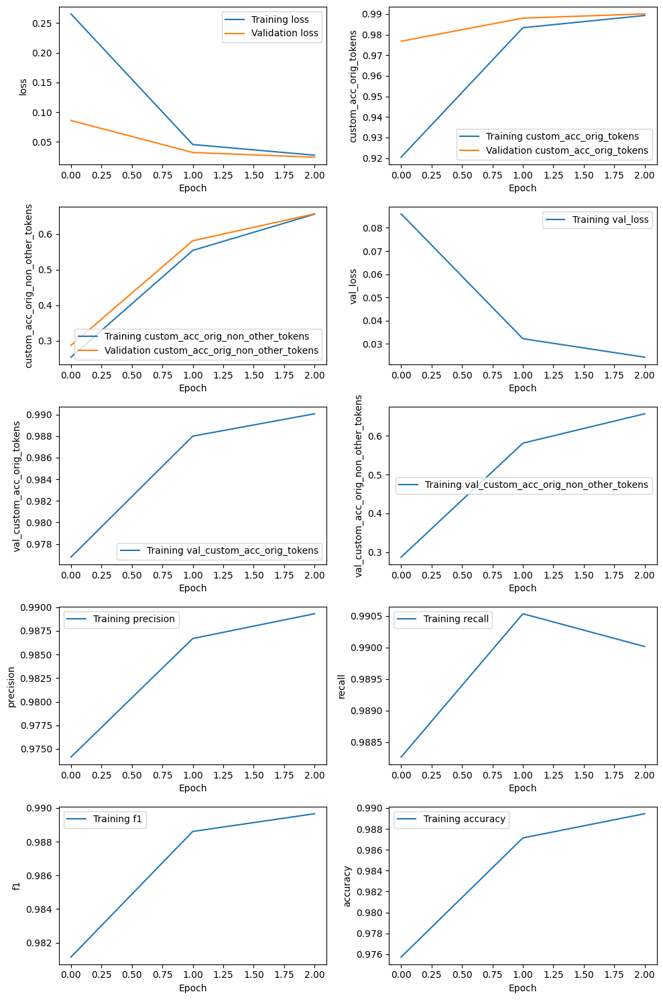

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.452,0.647,0.532,153,,
OLEFIN,0.563,0.817,0.667,356,,
PRE_CATALYST,0.602,0.831,0.698,71,,
SOLVENT,0.744,0.756,0.750,131,,
SUPPORT,0.627,0.831,0.715,83,,
OVERALL,0.573,0.777,0.660,,0.986,0.762


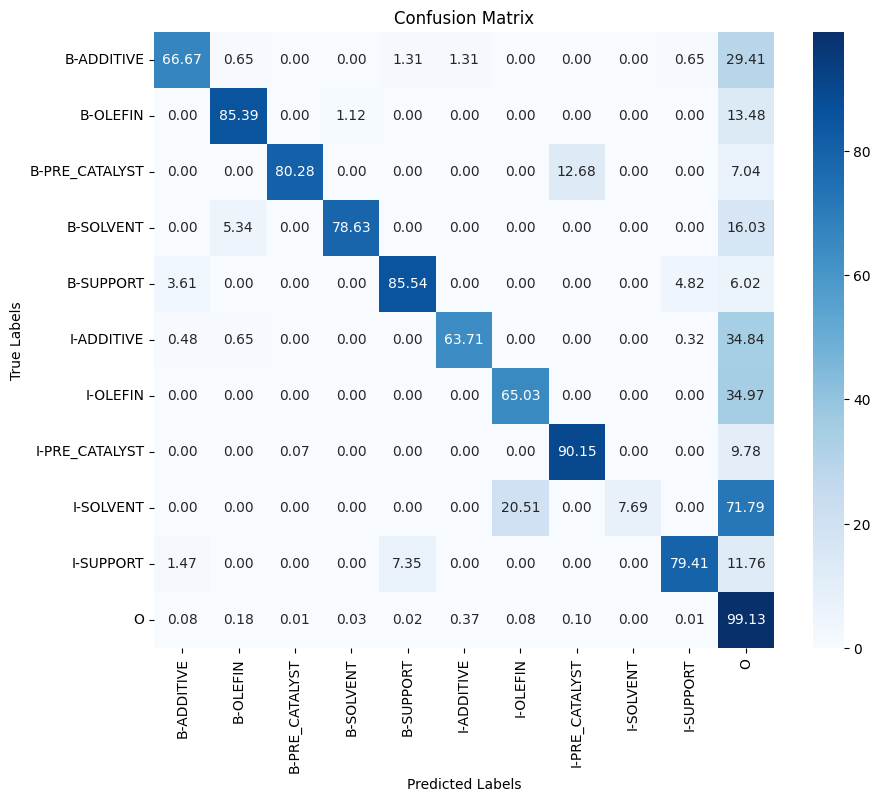

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 183s 278ms/step - loss: 0.2403 - custom_acc_orig_tokens: 0.9261 - custom_acc_orig_non_other_tokens: 0.2642 - val_loss: 0.0864 - val_custom_acc_orig_tokens: 0.9765 - val_custom_acc_orig_non_other_tokens: 0.3114 - precision: 0.9741 - recall: 0.9885 - f1: 0.9812 - accuracy: 0.9755
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0462 - custom_acc_orig_tokens: 0.9831 - custom_acc_orig_non_other_tokens: 0.5458 - val_loss: 0.0342 - val_custom_acc_orig_tokens: 0.9873 - val_custom_acc_orig_non_other_tokens: 0.5861 - precision: 0.9858 - recall: 0.9906 - f1: 0.9882 - accuracy: 0.9864
Epoch 3/3
526/526 [==============================] - 120s 227ms/step - loss: 0.0275 - custom_acc_orig_tokens: 0.9893 - custom_acc_orig_non_other_tokens: 0.6409 - val_loss: 0.0265 - val_custom_acc_orig_tokens: 0.9901 - val_custom_acc_orig_non_other_tokens: 0.6763 - precision: 0.9892 - recall: 0.9910 - f1: 0.9901 - accuracy: 0.9894


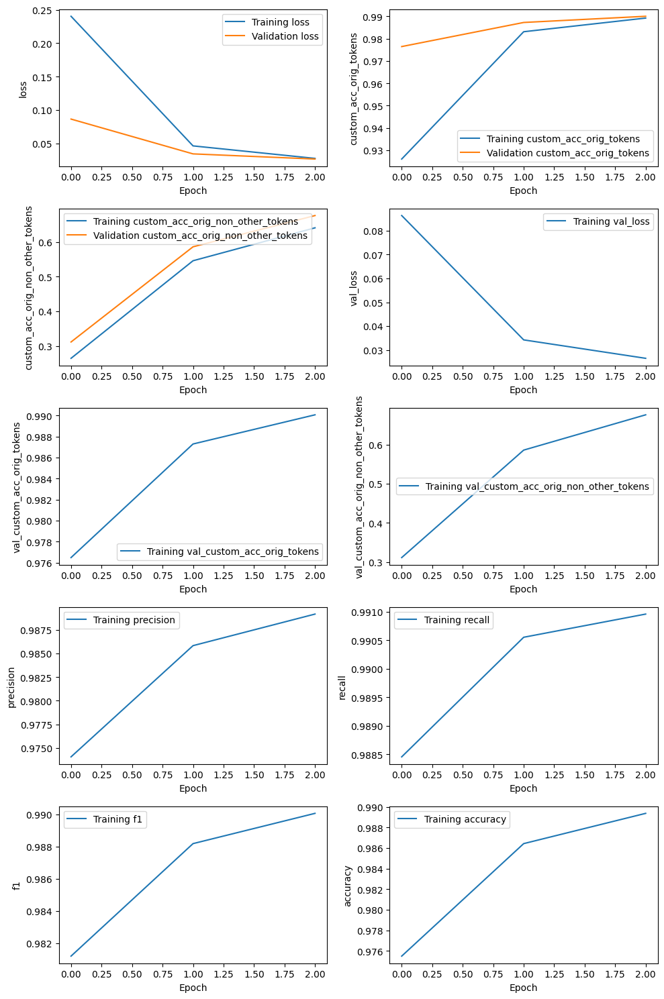

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 11s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_2e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.429,0.647,0.516,153,,
OLEFIN,0.582,0.888,0.703,356,,
PRE_CATALYST,0.670,0.859,0.753,71,,
SOLVENT,0.802,0.679,0.736,131,,
SUPPORT,0.634,0.855,0.728,83,,
OVERALL,0.585,0.801,0.676,,0.987,0.783


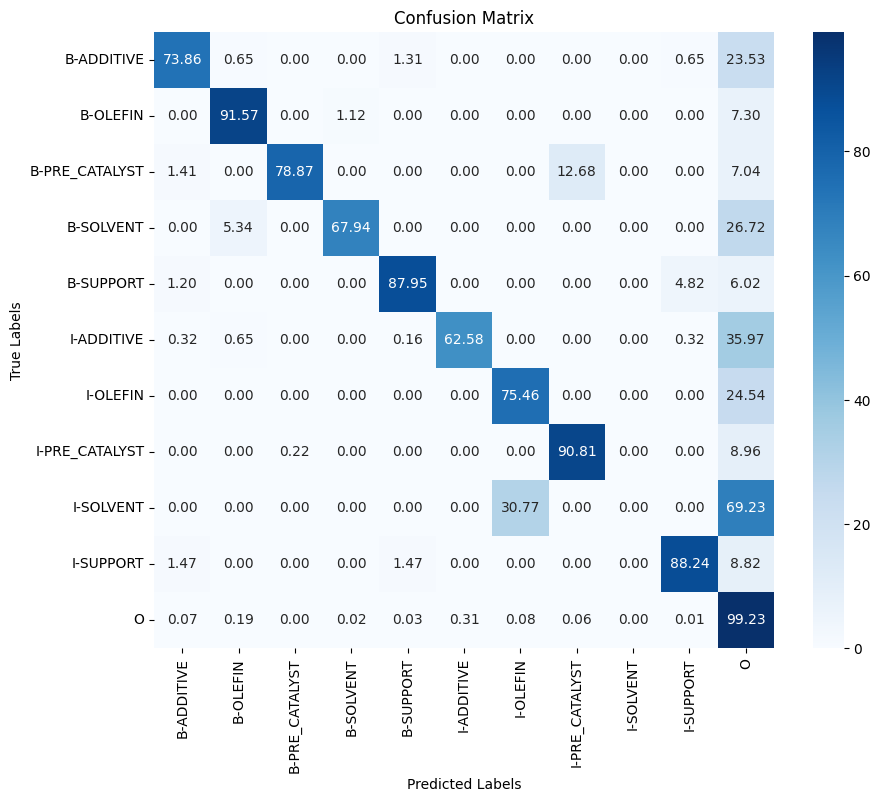

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 183s 278ms/step - loss: 0.2198 - custom_acc_orig_tokens: 0.9386 - custom_acc_orig_non_other_tokens: 0.3220 - val_loss: 0.0932 - val_custom_acc_orig_tokens: 0.9783 - val_custom_acc_orig_non_other_tokens: 0.4046 - precision: 0.9760 - recall: 0.9861 - f1: 0.9810 - accuracy: 0.9775
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0419 - custom_acc_orig_tokens: 0.9848 - custom_acc_orig_non_other_tokens: 0.6268 - val_loss: 0.0359 - val_custom_acc_orig_tokens: 0.9872 - val_custom_acc_orig_non_other_tokens: 0.5880 - precision: 0.9858 - recall: 0.9904 - f1: 0.9881 - accuracy: 0.9863
Epoch 3/3
526/526 [==============================] - 120s 227ms/step - loss: 0.0223 - custom_acc_orig_tokens: 0.9913 - custom_acc_orig_non_other_tokens: 0.7191 - val_loss: 0.0230 - val_custom_acc_orig_tokens: 0.9913 - val_custom_acc_orig_non_other_tokens: 0.7069 - precision: 0.9908 - recall: 0.9908 - f1: 0.9908 - accuracy: 0.9907


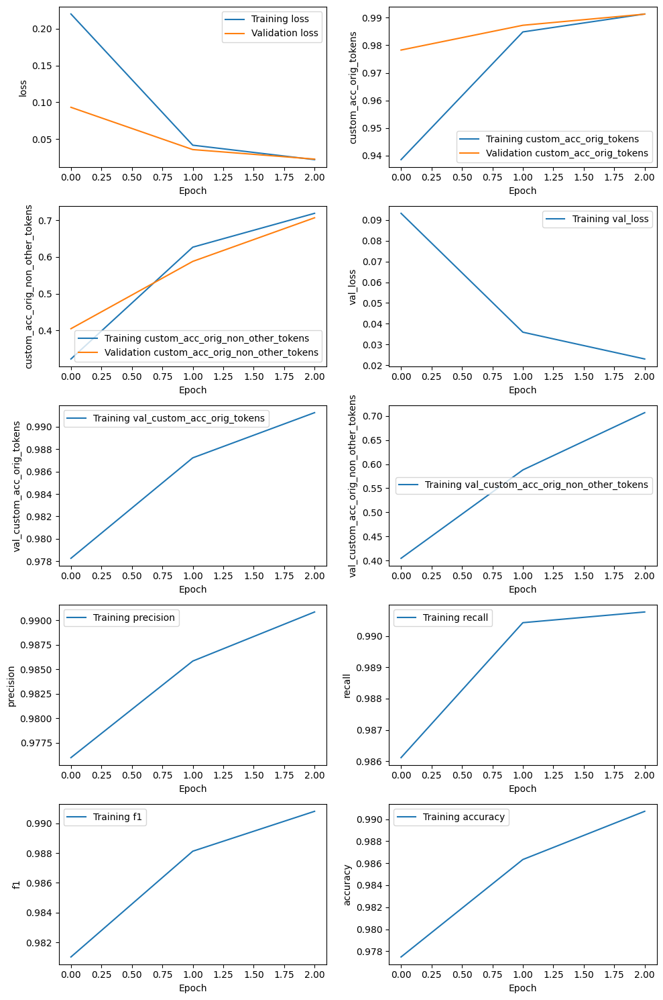

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 11s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.387,0.686,0.495,153,,
OLEFIN,0.599,0.885,0.714,356,,
PRE_CATALYST,0.550,0.859,0.670,71,,
SOLVENT,0.770,0.718,0.743,131,,
SUPPORT,0.682,0.880,0.768,83,,
OVERALL,0.570,0.816,0.671,,0.987,0.790


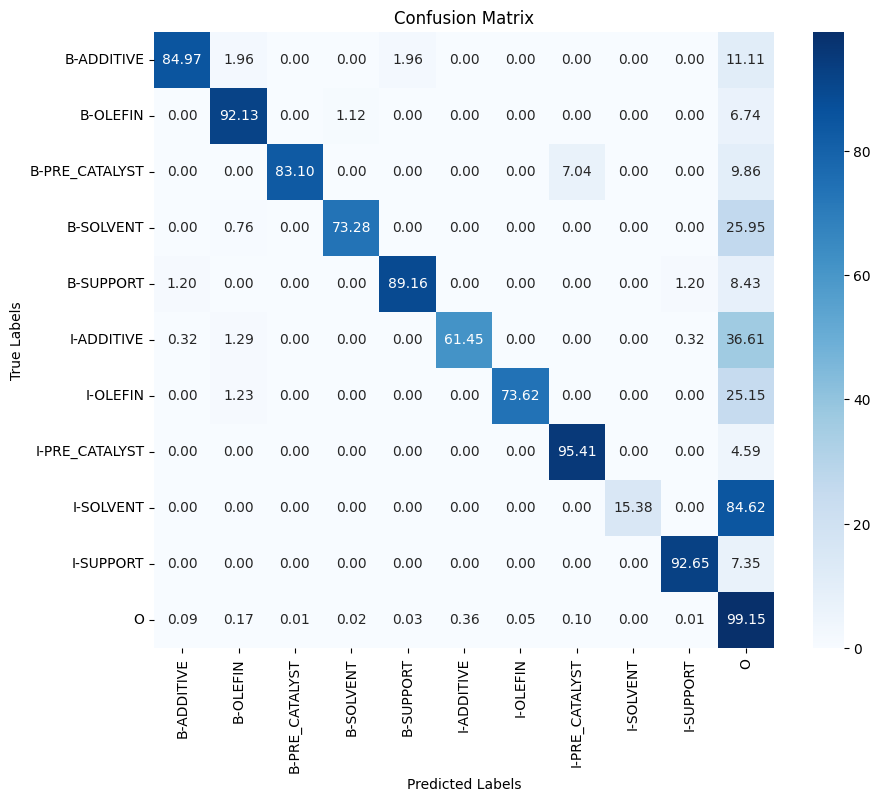

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 183s 277ms/step - loss: 0.2088 - custom_acc_orig_tokens: 0.9385 - custom_acc_orig_non_other_tokens: 0.3091 - val_loss: 0.0702 - val_custom_acc_orig_tokens: 0.9808 - val_custom_acc_orig_non_other_tokens: 0.4414 - precision: 0.9789 - recall: 0.9881 - f1: 0.9835 - accuracy: 0.9801
Epoch 2/3
526/526 [==============================] - 120s 227ms/step - loss: 0.0404 - custom_acc_orig_tokens: 0.9849 - custom_acc_orig_non_other_tokens: 0.6254 - val_loss: 0.0385 - val_custom_acc_orig_tokens: 0.9879 - val_custom_acc_orig_non_other_tokens: 0.6251 - precision: 0.9865 - recall: 0.9907 - f1: 0.9886 - accuracy: 0.9870
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0215 - custom_acc_orig_tokens: 0.9913 - custom_acc_orig_non_other_tokens: 0.7209 - val_loss: 0.0264 - val_custom_acc_orig_tokens: 0.9899 - val_custom_acc_orig_non_other_tokens: 0.6931 - precision: 0.9900 - recall: 0.9891 - f1: 0.9896 - accuracy: 0.9892


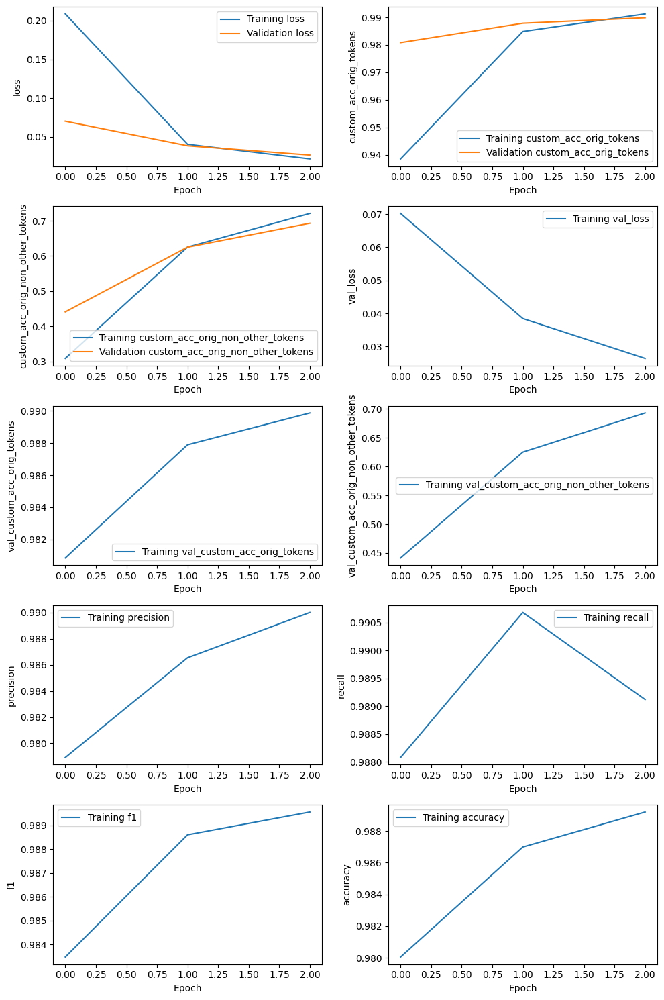

526/526 [==============================] - 48s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.493,0.719,0.585,153,,
OLEFIN,0.595,0.803,0.683,356,,
PRE_CATALYST,0.646,0.873,0.743,71,,
SOLVENT,0.754,0.794,0.773,131,,
SUPPORT,0.664,0.880,0.756,83,,
OVERALL,0.606,0.800,0.689,,0.987,0.778


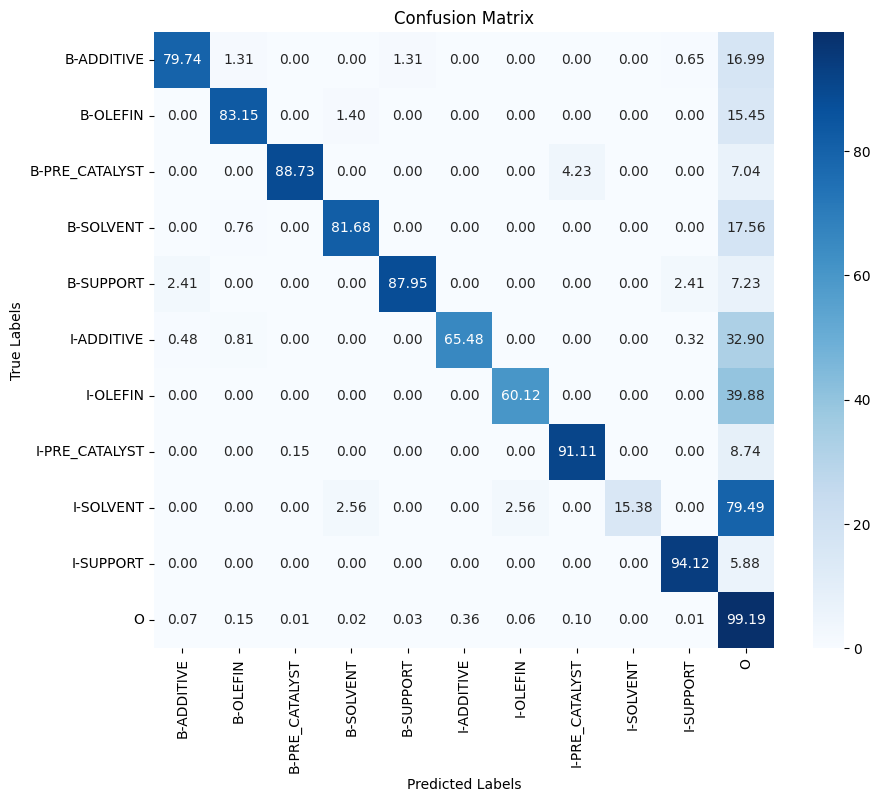

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 277ms/step - loss: 0.1893 - custom_acc_orig_tokens: 0.9425 - custom_acc_orig_non_other_tokens: 0.3347 - val_loss: 0.0667 - val_custom_acc_orig_tokens: 0.9802 - val_custom_acc_orig_non_other_tokens: 0.4600 - precision: 0.9779 - recall: 0.9893 - f1: 0.9836 - accuracy: 0.9791
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0393 - custom_acc_orig_tokens: 0.9851 - custom_acc_orig_non_other_tokens: 0.6301 - val_loss: 0.0302 - val_custom_acc_orig_tokens: 0.9892 - val_custom_acc_orig_non_other_tokens: 0.6118 - precision: 0.9882 - recall: 0.9909 - f1: 0.9896 - accuracy: 0.9884
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0210 - custom_acc_orig_tokens: 0.9915 - custom_acc_orig_non_other_tokens: 0.7158 - val_loss: 0.0240 - val_custom_acc_orig_tokens: 0.9901 - val_custom_acc_orig_non_other_tokens: 0.6785 - precision: 0.9898 - recall: 0.9906 - f1: 0.9902 - accuracy: 0.9895


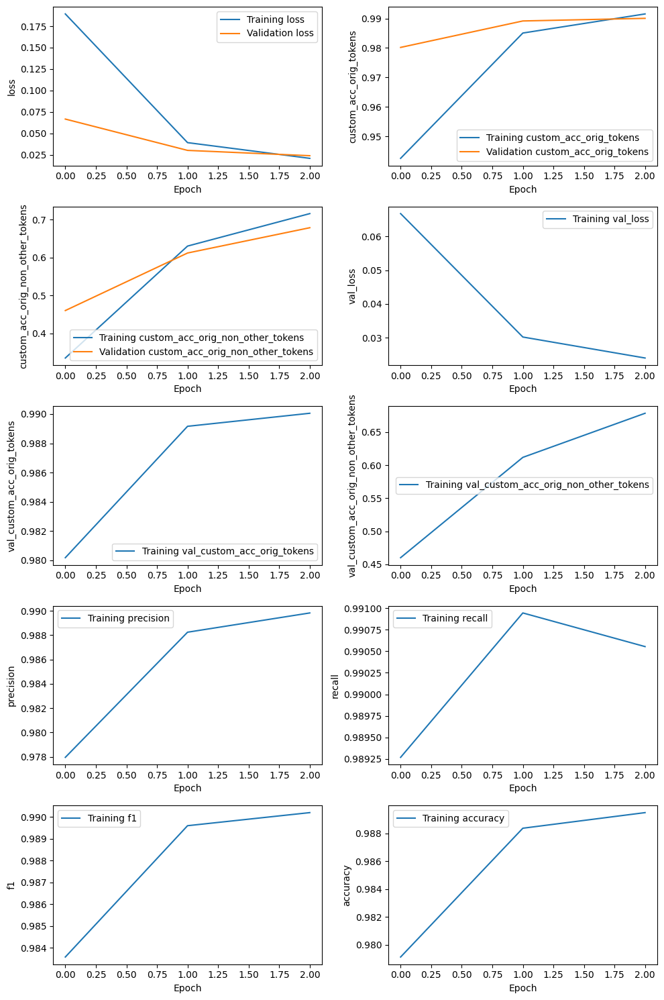

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 11s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_5e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.434,0.693,0.534,153,,
OLEFIN,0.575,0.874,0.693,356,,
PRE_CATALYST,0.646,0.873,0.743,71,,
SOLVENT,0.842,0.733,0.784,131,,
SUPPORT,0.685,0.892,0.775,83,,
OVERALL,0.588,0.817,0.684,,0.986,0.780


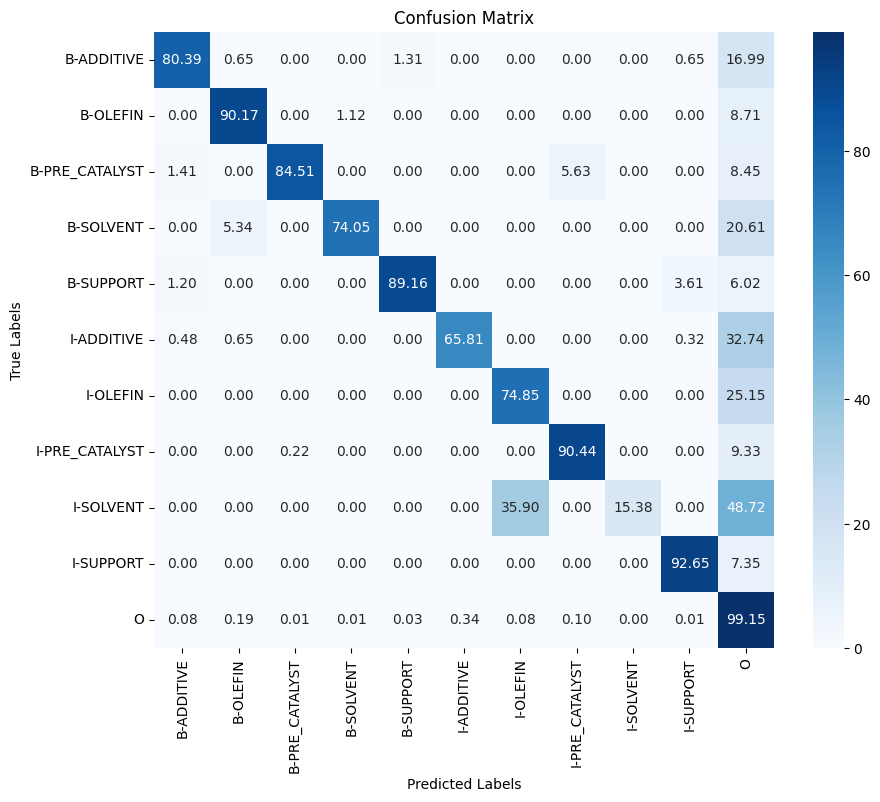

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 278ms/step - loss: 0.1973 - custom_acc_orig_tokens: 0.9452 - custom_acc_orig_non_other_tokens: 0.3382 - val_loss: 0.0933 - val_custom_acc_orig_tokens: 0.9781 - val_custom_acc_orig_non_other_tokens: 0.4256 - precision: 0.9762 - recall: 0.9852 - f1: 0.9807 - accuracy: 0.9771
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0448 - custom_acc_orig_tokens: 0.9839 - custom_acc_orig_non_other_tokens: 0.6284 - val_loss: 0.0308 - val_custom_acc_orig_tokens: 0.9883 - val_custom_acc_orig_non_other_tokens: 0.6369 - precision: 0.9871 - recall: 0.9905 - f1: 0.9888 - accuracy: 0.9874
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0207 - custom_acc_orig_tokens: 0.9915 - custom_acc_orig_non_other_tokens: 0.7261 - val_loss: 0.0249 - val_custom_acc_orig_tokens: 0.9901 - val_custom_acc_orig_non_other_tokens: 0.6789 - precision: 0.9899 - recall: 0.9898 - f1: 0.9899 - accuracy: 0.9894


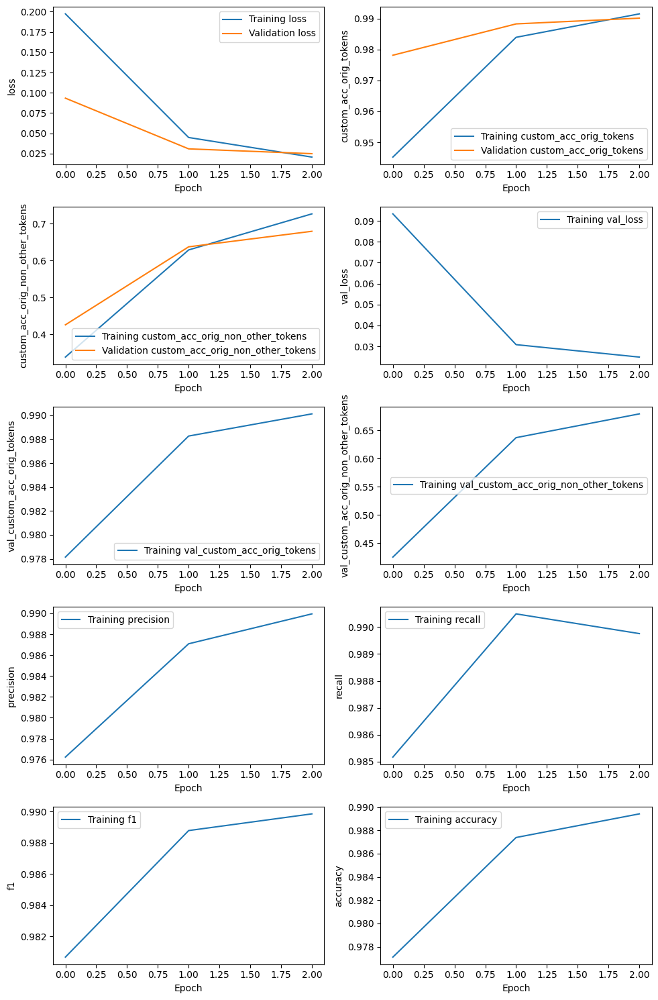

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.529,0.771,0.628,153,,
OLEFIN,0.582,0.840,0.687,356,,
PRE_CATALYST,0.641,0.831,0.724,71,,
SOLVENT,0.745,0.779,0.761,131,,
SUPPORT,0.712,0.892,0.791,83,,
OVERALL,0.609,0.821,0.700,,0.987,0.783


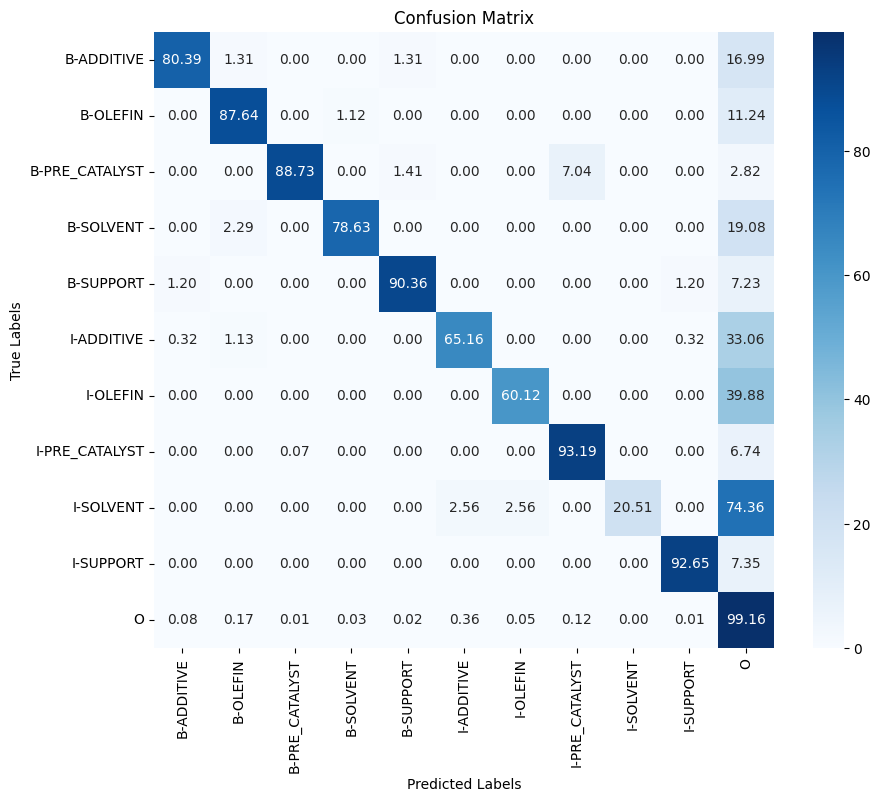

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 278ms/step - loss: 0.1821 - custom_acc_orig_tokens: 0.9464 - custom_acc_orig_non_other_tokens: 0.3447 - val_loss: 0.1276 - val_custom_acc_orig_tokens: 0.9737 - val_custom_acc_orig_non_other_tokens: 0.3251 - precision: 0.9720 - recall: 0.9884 - f1: 0.9801 - accuracy: 0.9726
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0434 - custom_acc_orig_tokens: 0.9838 - custom_acc_orig_non_other_tokens: 0.6320 - val_loss: 0.0345 - val_custom_acc_orig_tokens: 0.9872 - val_custom_acc_orig_non_other_tokens: 0.5966 - precision: 0.9859 - recall: 0.9900 - f1: 0.9880 - accuracy: 0.9863
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0219 - custom_acc_orig_tokens: 0.9911 - custom_acc_orig_non_other_tokens: 0.7258 - val_loss: 0.0233 - val_custom_acc_orig_tokens: 0.9902 - val_custom_acc_orig_non_other_tokens: 0.6702 - precision: 0.9905 - recall: 0.9905 - f1: 0.9905 - accuracy: 0.9896


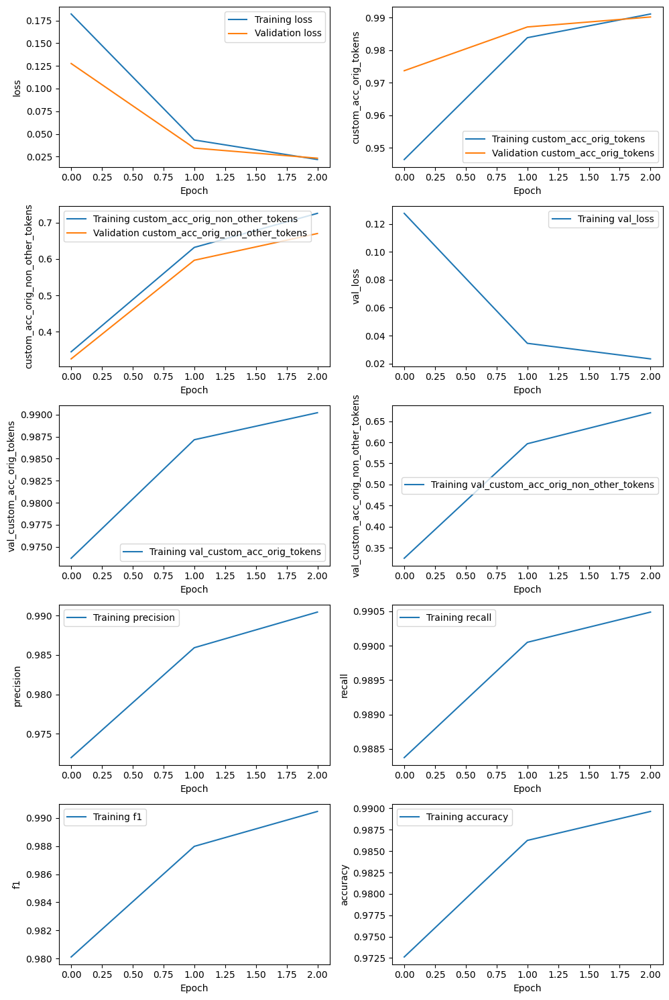

526/526 [==============================] - 47s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 11s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.406,0.660,0.502,153,,
OLEFIN,0.591,0.795,0.678,356,,
PRE_CATALYST,0.649,0.859,0.739,71,,
SOLVENT,0.811,0.756,0.783,131,,
SUPPORT,0.709,0.880,0.785,83,,
OVERALL,0.589,0.777,0.670,,0.986,0.762


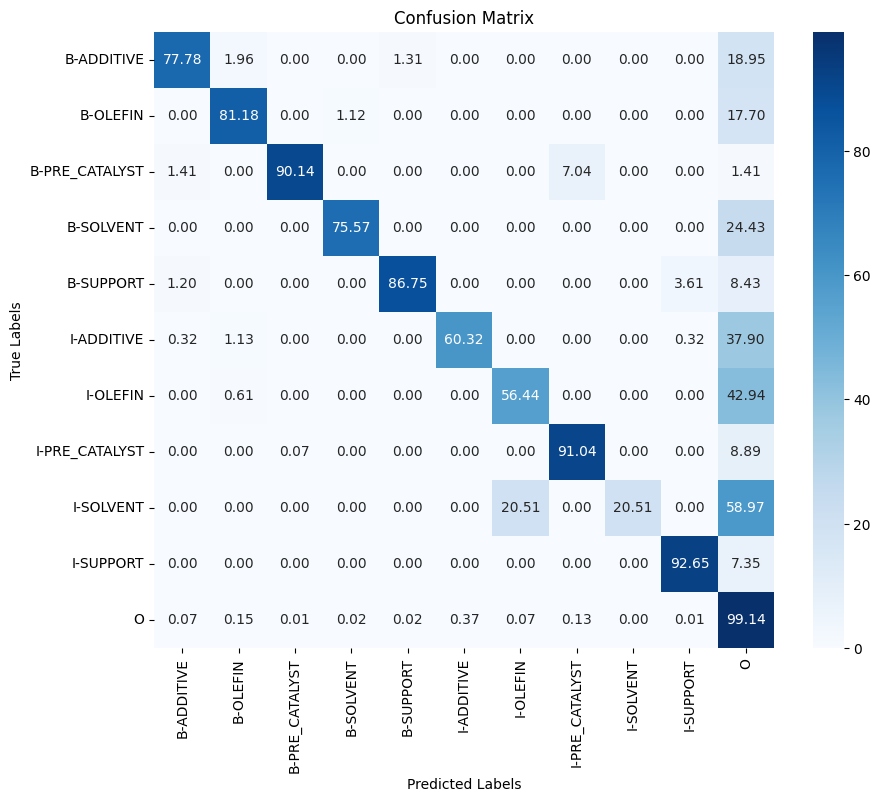

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 184s 277ms/step - loss: 0.1739 - custom_acc_orig_tokens: 0.9482 - custom_acc_orig_non_other_tokens: 0.3425 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9820 - val_custom_acc_orig_non_other_tokens: 0.5446 - precision: 0.9805 - recall: 0.9891 - f1: 0.9848 - accuracy: 0.9811
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0409 - custom_acc_orig_tokens: 0.9840 - custom_acc_orig_non_other_tokens: 0.6302 - val_loss: 0.0306 - val_custom_acc_orig_tokens: 0.9888 - val_custom_acc_orig_non_other_tokens: 0.6374 - precision: 0.9879 - recall: 0.9900 - f1: 0.9890 - accuracy: 0.9879
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0200 - custom_acc_orig_tokens: 0.9918 - custom_acc_orig_non_other_tokens: 0.7404 - val_loss: 0.0241 - val_custom_acc_orig_tokens: 0.9910 - val_custom_acc_orig_non_other_tokens: 0.7043 - precision: 0.9901 - recall: 0.9911 - f1: 0.9906 - accuracy: 0.9903


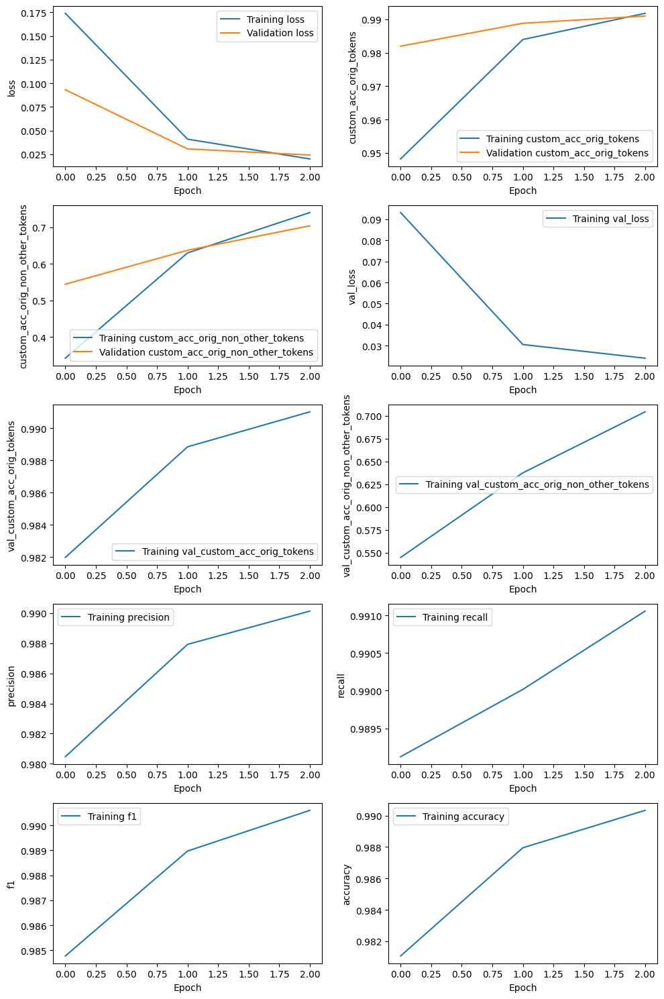

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_16_8e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.500,0.732,0.594,153,,
OLEFIN,0.581,0.803,0.675,356,,
PRE_CATALYST,0.656,0.887,0.754,71,,
SOLVENT,0.824,0.748,0.784,131,,
SUPPORT,0.695,0.880,0.777,83,,
OVERALL,0.610,0.796,0.691,,0.987,0.790


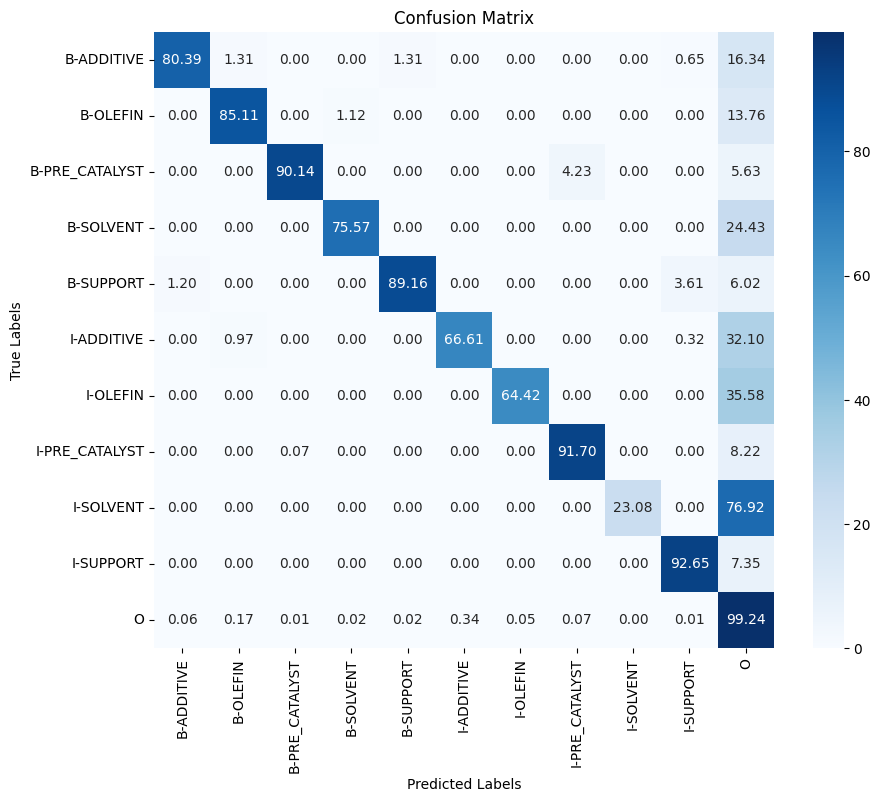

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 184s 278ms/step - loss: 0.2352 - custom_acc_orig_tokens: 0.9336 - custom_acc_orig_non_other_tokens: 0.2623 - val_loss: 0.0680 - val_custom_acc_orig_tokens: 0.9826 - val_custom_acc_orig_non_other_tokens: 0.2956 - precision: 0.9803 - recall: 0.9883 - f1: 0.9843 - accuracy: 0.9817
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0503 - custom_acc_orig_tokens: 0.9826 - custom_acc_orig_non_other_tokens: 0.4834 - val_loss: 0.0422 - val_custom_acc_orig_tokens: 0.9859 - val_custom_acc_orig_non_other_tokens: 0.4993 - precision: 0.9849 - recall: 0.9876 - f1: 0.9862 - accuracy: 0.9851
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0454 - custom_acc_orig_tokens: 0.9840 - custom_acc_orig_non_other_tokens: 0.5067 - val_loss: 0.0422 - val_custom_acc_orig_tokens: 0.9859 - val_custom_acc_orig_non_other_tokens: 0.4993 - precision: 0.9849 - recall: 0.9876 - f1: 0.9862 - accuracy: 0.9851


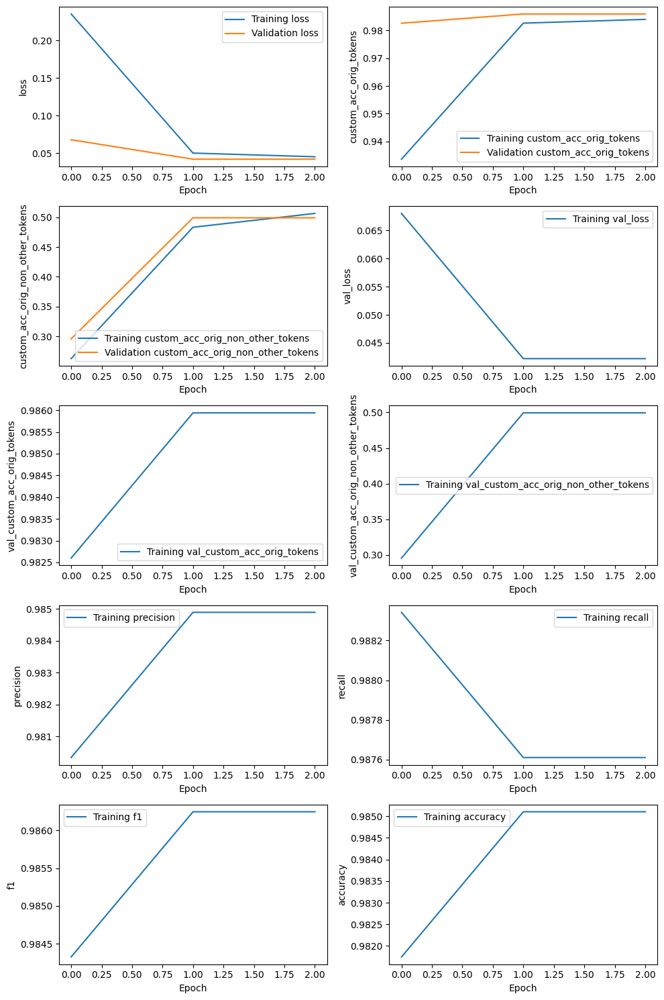

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.333,0.484,0.395,153,,
OLEFIN,0.590,0.674,0.629,356,,
PRE_CATALYST,0.317,0.563,0.406,71,,
SOLVENT,0.981,0.389,0.557,131,,
SUPPORT,0.414,0.289,0.340,83,,
OVERALL,0.496,0.540,0.517,,0.983,0.718


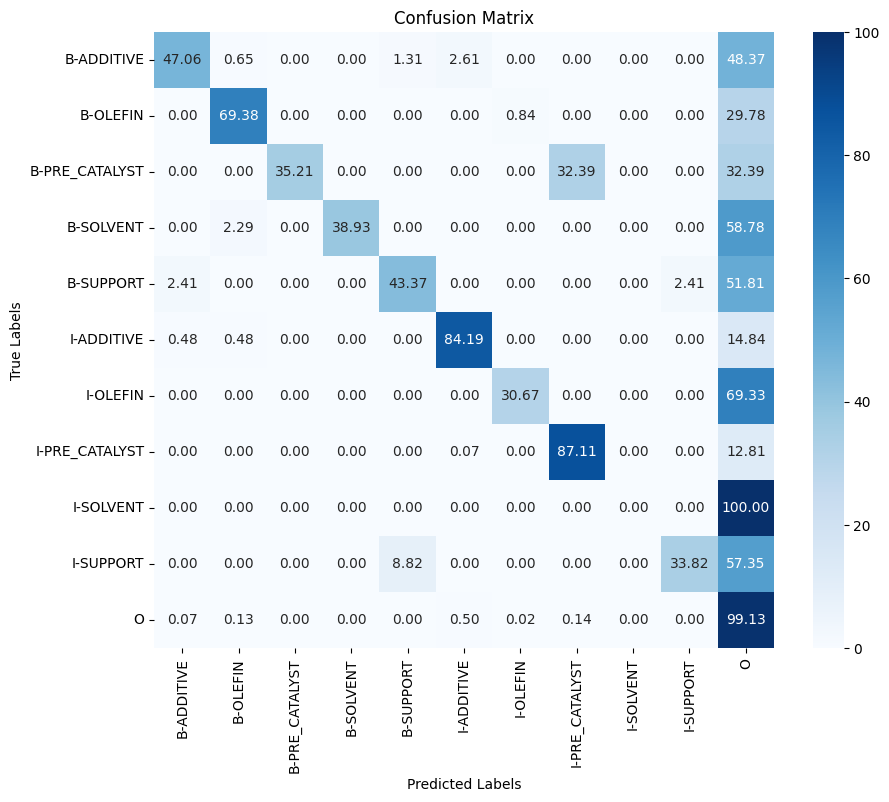

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 278ms/step - loss: 0.2171 - custom_acc_orig_tokens: 0.9356 - custom_acc_orig_non_other_tokens: 0.2735 - val_loss: 0.0641 - val_custom_acc_orig_tokens: 0.9812 - val_custom_acc_orig_non_other_tokens: 0.2879 - precision: 0.9789 - recall: 0.9889 - f1: 0.9838 - accuracy: 0.9803
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0468 - custom_acc_orig_tokens: 0.9830 - custom_acc_orig_non_other_tokens: 0.4985 - val_loss: 0.0387 - val_custom_acc_orig_tokens: 0.9861 - val_custom_acc_orig_non_other_tokens: 0.5300 - precision: 0.9853 - recall: 0.9887 - f1: 0.9870 - accuracy: 0.9852
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0424 - custom_acc_orig_tokens: 0.9845 - custom_acc_orig_non_other_tokens: 0.5254 - val_loss: 0.0387 - val_custom_acc_orig_tokens: 0.9861 - val_custom_acc_orig_non_other_tokens: 0.5300 - precision: 0.9853 - recall: 0.9887 - f1: 0.9870 - accuracy: 0.9852


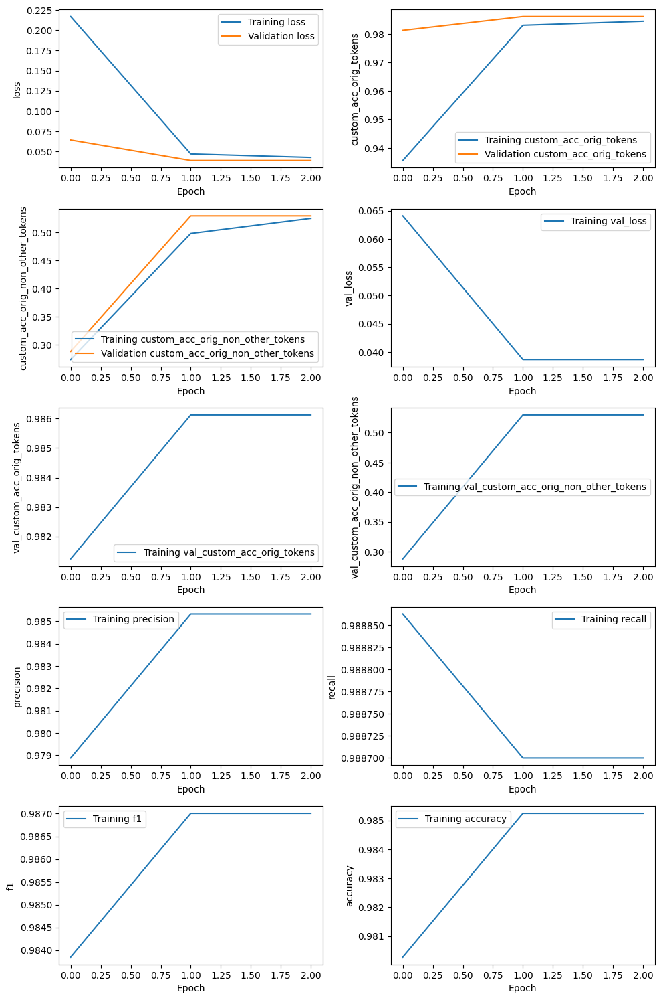

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 11s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.429,0.614,0.505,153,,
OLEFIN,0.623,0.635,0.629,356,,
PRE_CATALYST,0.473,0.732,0.575,71,,
SOLVENT,0.980,0.374,0.541,131,,
SUPPORT,0.236,0.157,0.188,83,,
OVERALL,0.545,0.547,0.546,,0.984,0.719


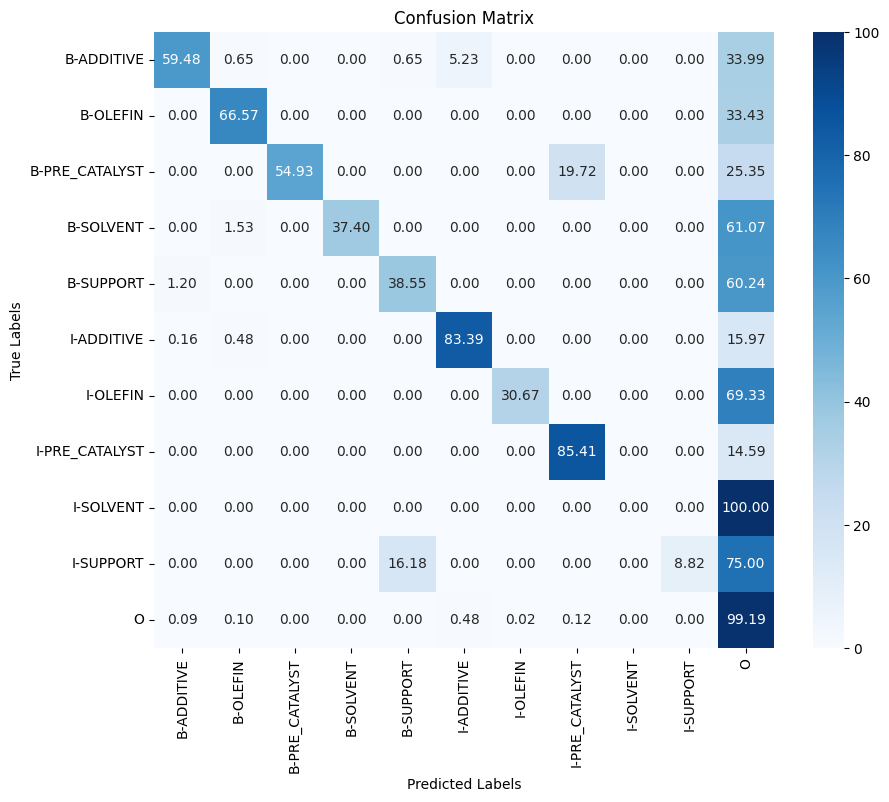

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 278ms/step - loss: 0.1981 - custom_acc_orig_tokens: 0.9400 - custom_acc_orig_non_other_tokens: 0.2838 - val_loss: 0.0626 - val_custom_acc_orig_tokens: 0.9821 - val_custom_acc_orig_non_other_tokens: 0.3196 - precision: 0.9798 - recall: 0.9888 - f1: 0.9843 - accuracy: 0.9812
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0461 - custom_acc_orig_tokens: 0.9838 - custom_acc_orig_non_other_tokens: 0.5070 - val_loss: 0.0388 - val_custom_acc_orig_tokens: 0.9863 - val_custom_acc_orig_non_other_tokens: 0.5475 - precision: 0.9854 - recall: 0.9876 - f1: 0.9865 - accuracy: 0.9854
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0416 - custom_acc_orig_tokens: 0.9855 - custom_acc_orig_non_other_tokens: 0.5486 - val_loss: 0.0388 - val_custom_acc_orig_tokens: 0.9863 - val_custom_acc_orig_non_other_tokens: 0.5475 - precision: 0.9854 - recall: 0.9876 - f1: 0.9865 - accuracy: 0.9854


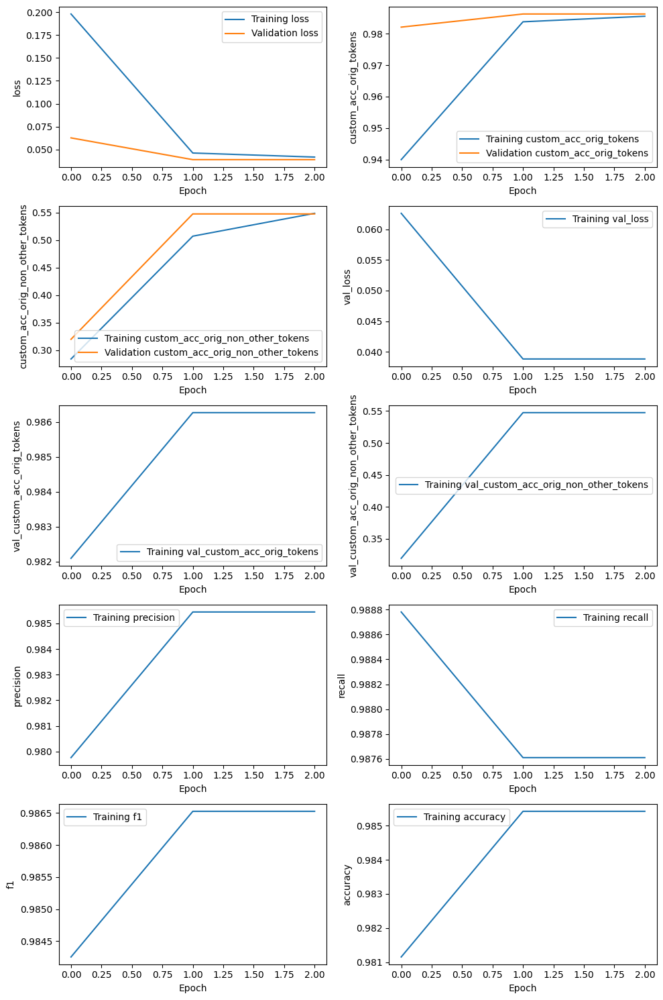

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 73ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 11s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_2e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.344,0.542,0.421,153,,
OLEFIN,0.600,0.711,0.650,356,,
PRE_CATALYST,0.436,0.718,0.543,71,,
SOLVENT,0.964,0.412,0.578,131,,
SUPPORT,0.388,0.313,0.347,83,,
OVERALL,0.517,0.588,0.550,,0.984,0.731


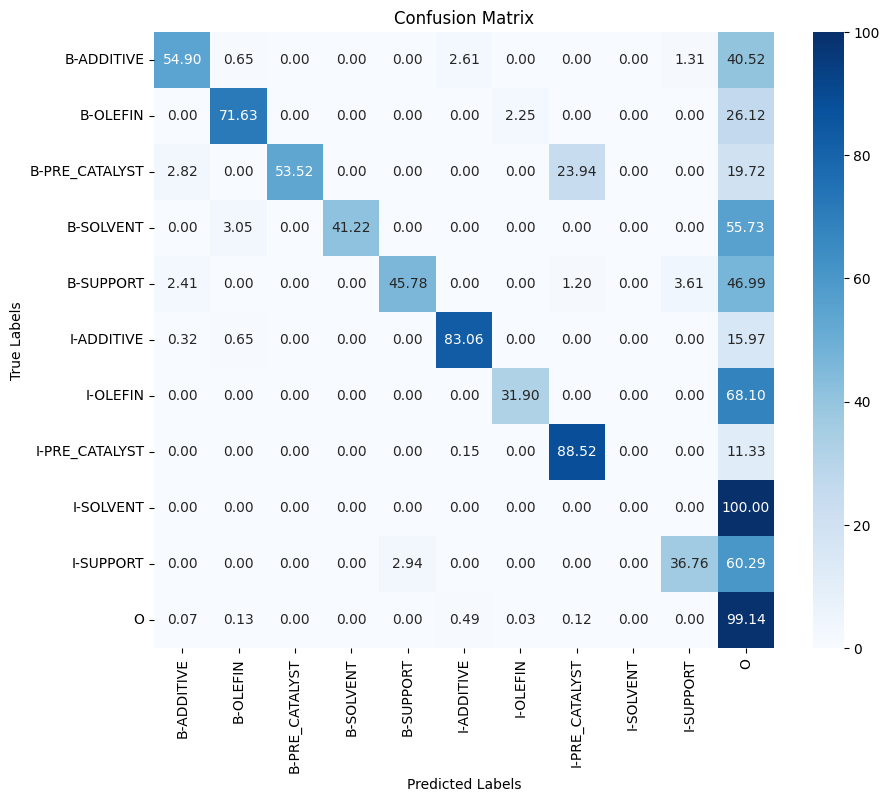

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 278ms/step - loss: 0.1838 - custom_acc_orig_tokens: 0.9480 - custom_acc_orig_non_other_tokens: 0.3423 - val_loss: 0.0500 - val_custom_acc_orig_tokens: 0.9852 - val_custom_acc_orig_non_other_tokens: 0.5206 - precision: 0.9834 - recall: 0.9896 - f1: 0.9865 - accuracy: 0.9844
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0355 - custom_acc_orig_tokens: 0.9864 - custom_acc_orig_non_other_tokens: 0.6289 - val_loss: 0.0344 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.6182 - precision: 0.9863 - recall: 0.9890 - f1: 0.9877 - accuracy: 0.9868
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0303 - custom_acc_orig_tokens: 0.9887 - custom_acc_orig_non_other_tokens: 0.6721 - val_loss: 0.0344 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.6182 - precision: 0.9863 - recall: 0.9890 - f1: 0.9877 - accuracy: 0.9868


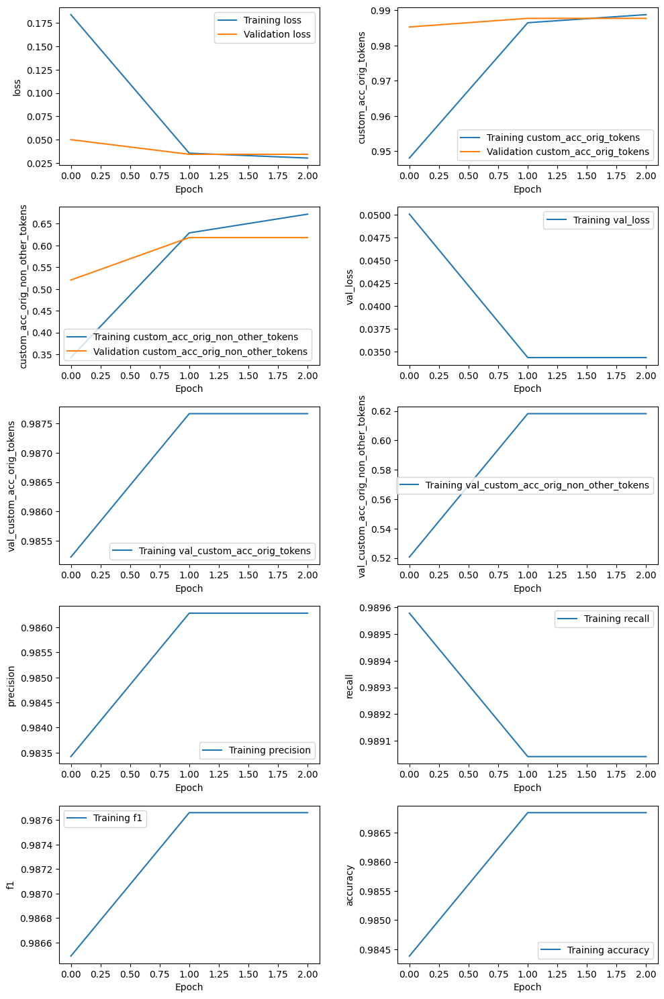

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.383,0.634,0.478,153,,
OLEFIN,0.595,0.750,0.663,356,,
PRE_CATALYST,0.546,0.746,0.631,71,,
SOLVENT,0.765,0.672,0.715,131,,
SUPPORT,0.649,0.867,0.742,83,,
OVERALL,0.563,0.727,0.634,,0.985,0.754


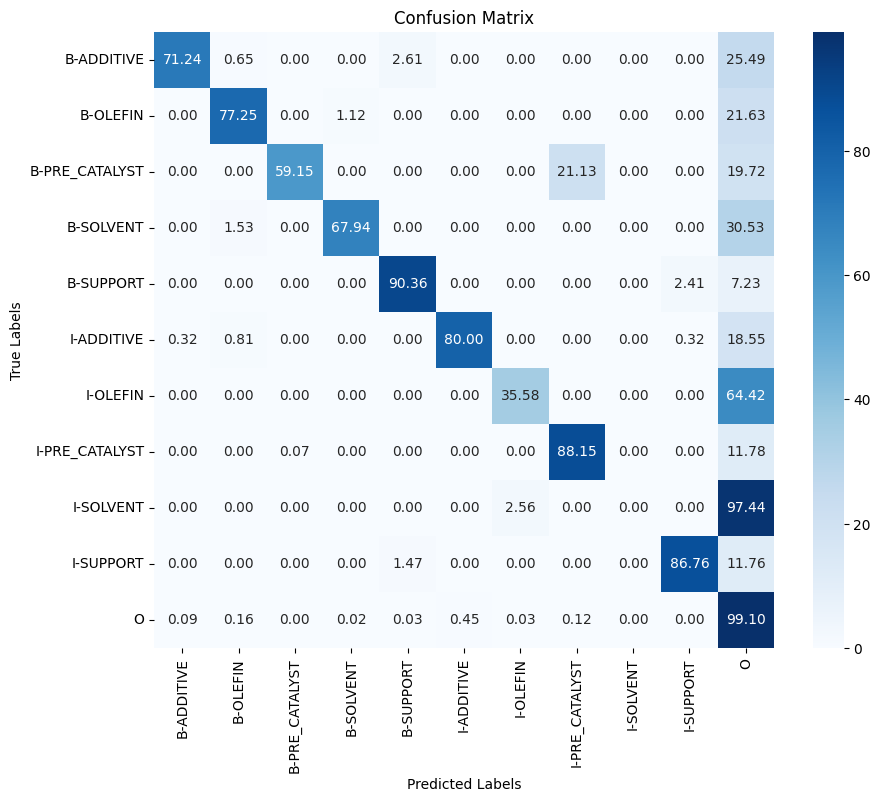

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 279ms/step - loss: 0.1713 - custom_acc_orig_tokens: 0.9494 - custom_acc_orig_non_other_tokens: 0.3402 - val_loss: 0.0504 - val_custom_acc_orig_tokens: 0.9831 - val_custom_acc_orig_non_other_tokens: 0.4824 - precision: 0.9812 - recall: 0.9894 - f1: 0.9853 - accuracy: 0.9824
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0360 - custom_acc_orig_tokens: 0.9857 - custom_acc_orig_non_other_tokens: 0.6166 - val_loss: 0.0330 - val_custom_acc_orig_tokens: 0.9875 - val_custom_acc_orig_non_other_tokens: 0.6230 - precision: 0.9864 - recall: 0.9898 - f1: 0.9881 - accuracy: 0.9866
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0312 - custom_acc_orig_tokens: 0.9876 - custom_acc_orig_non_other_tokens: 0.6711 - val_loss: 0.0330 - val_custom_acc_orig_tokens: 0.9875 - val_custom_acc_orig_non_other_tokens: 0.6230 - precision: 0.9864 - recall: 0.9898 - f1: 0.9881 - accuracy: 0.9866


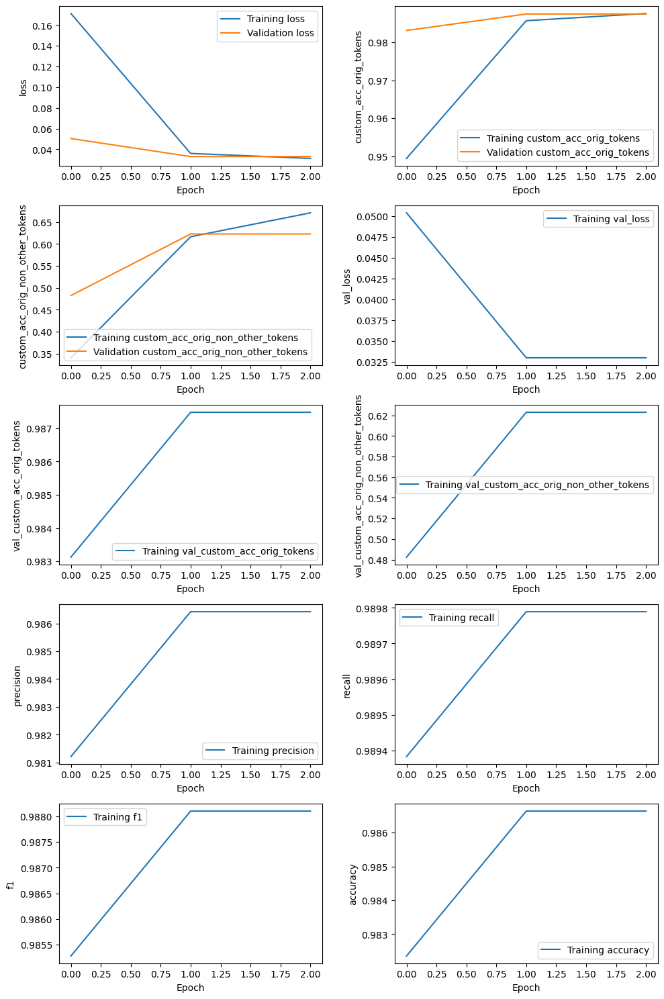

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.443,0.732,0.552,153,,
OLEFIN,0.607,0.663,0.634,356,,
PRE_CATALYST,0.526,0.704,0.602,71,,
SOLVENT,0.718,0.679,0.698,131,,
SUPPORT,0.640,0.771,0.699,83,,
OVERALL,0.573,0.694,0.628,,0.985,0.750


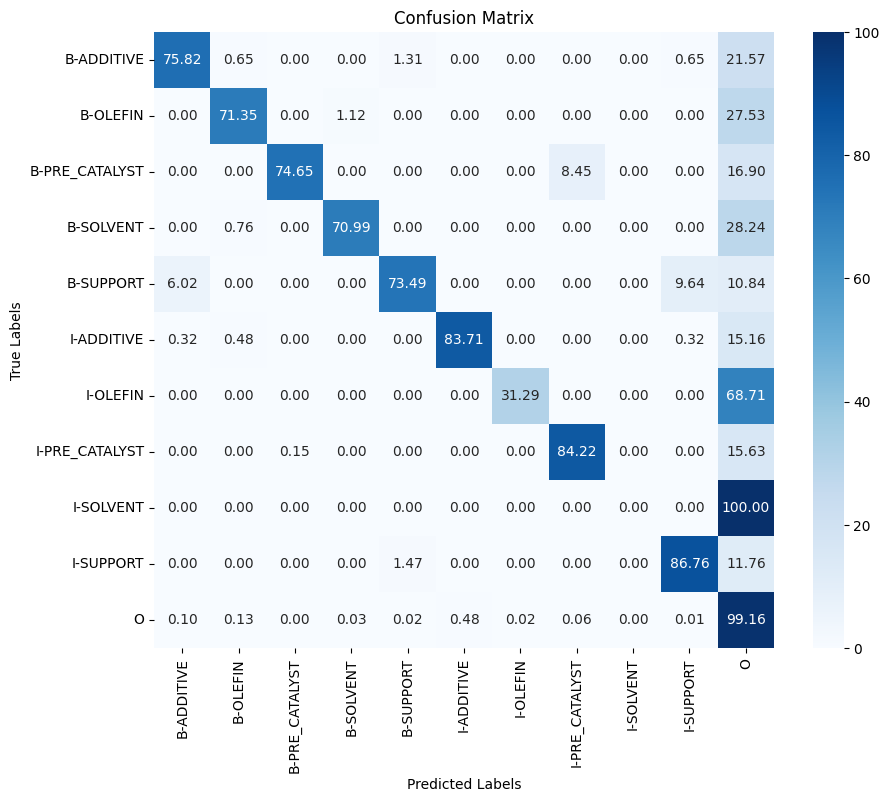

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 278ms/step - loss: 0.1578 - custom_acc_orig_tokens: 0.9525 - custom_acc_orig_non_other_tokens: 0.3677 - val_loss: 0.0511 - val_custom_acc_orig_tokens: 0.9842 - val_custom_acc_orig_non_other_tokens: 0.5251 - precision: 0.9824 - recall: 0.9892 - f1: 0.9858 - accuracy: 0.9834
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0350 - custom_acc_orig_tokens: 0.9857 - custom_acc_orig_non_other_tokens: 0.6310 - val_loss: 0.0340 - val_custom_acc_orig_tokens: 0.9881 - val_custom_acc_orig_non_other_tokens: 0.6645 - precision: 0.9873 - recall: 0.9894 - f1: 0.9884 - accuracy: 0.9873
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0298 - custom_acc_orig_tokens: 0.9883 - custom_acc_orig_non_other_tokens: 0.6843 - val_loss: 0.0340 - val_custom_acc_orig_tokens: 0.9881 - val_custom_acc_orig_non_other_tokens: 0.6645 - precision: 0.9873 - recall: 0.9894 - f1: 0.9884 - accuracy: 0.9873


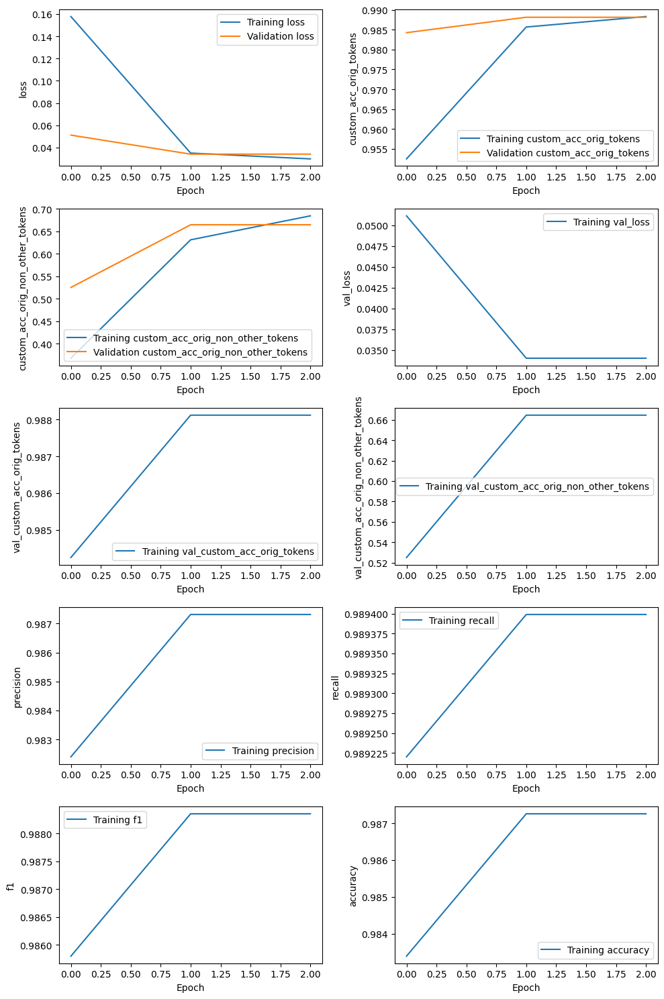

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_5e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.417,0.706,0.524,153,,
OLEFIN,0.556,0.652,0.600,356,,
PRE_CATALYST,0.576,0.803,0.671,71,,
SOLVENT,0.835,0.733,0.780,131,,
SUPPORT,0.634,0.855,0.728,83,,
OVERALL,0.563,0.710,0.628,,0.985,0.754


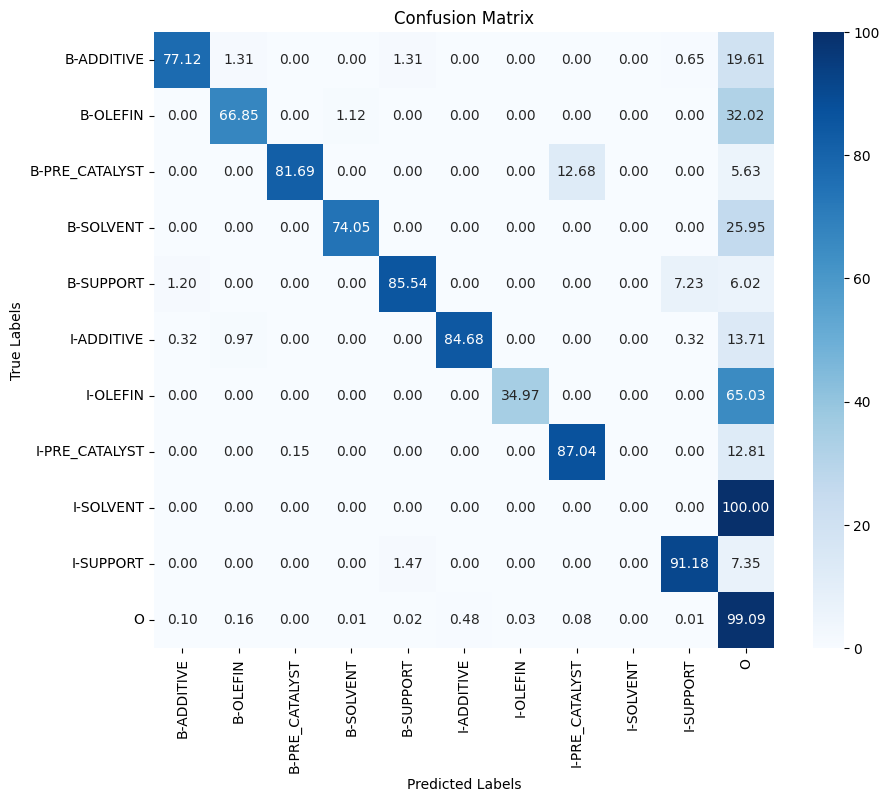

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 280ms/step - loss: 0.1713 - custom_acc_orig_tokens: 0.9523 - custom_acc_orig_non_other_tokens: 0.3457 - val_loss: 0.0625 - val_custom_acc_orig_tokens: 0.9792 - val_custom_acc_orig_non_other_tokens: 0.4165 - precision: 0.9769 - recall: 0.9895 - f1: 0.9832 - accuracy: 0.9783
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0351 - custom_acc_orig_tokens: 0.9860 - custom_acc_orig_non_other_tokens: 0.6548 - val_loss: 0.0335 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.6329 - precision: 0.9866 - recall: 0.9890 - f1: 0.9878 - accuracy: 0.9868
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0289 - custom_acc_orig_tokens: 0.9890 - custom_acc_orig_non_other_tokens: 0.7156 - val_loss: 0.0335 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.6329 - precision: 0.9866 - recall: 0.9890 - f1: 0.9878 - accuracy: 0.9868


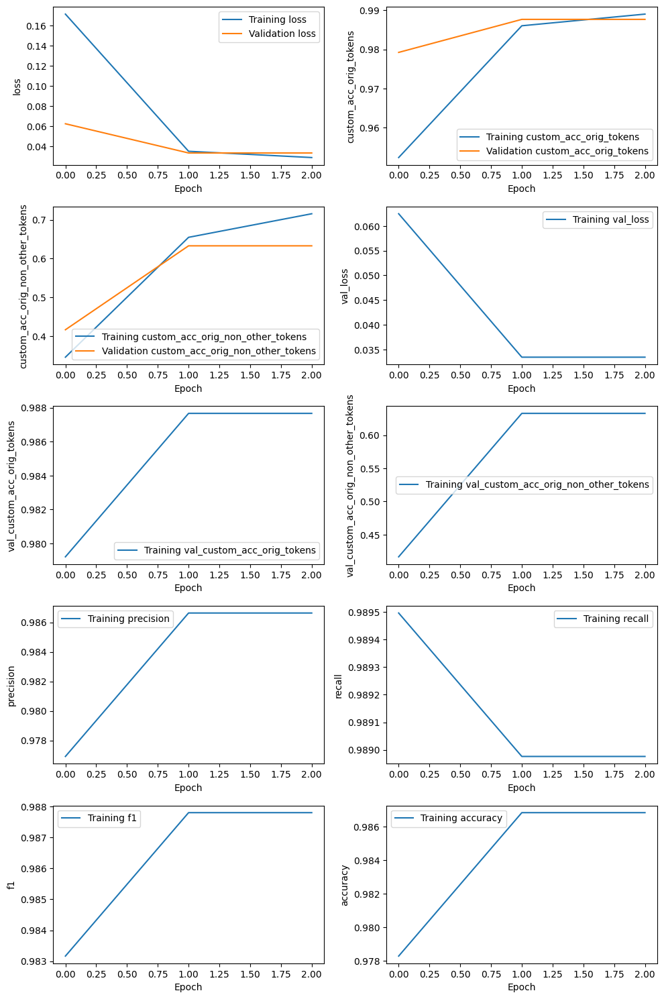

526/526 [==============================] - 47s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.485,0.758,0.592,153,,
OLEFIN,0.552,0.699,0.617,356,,
PRE_CATALYST,0.600,0.761,0.671,71,,
SOLVENT,0.787,0.733,0.759,131,,
SUPPORT,0.682,0.880,0.768,83,,
OVERALL,0.583,0.741,0.652,,0.986,0.775


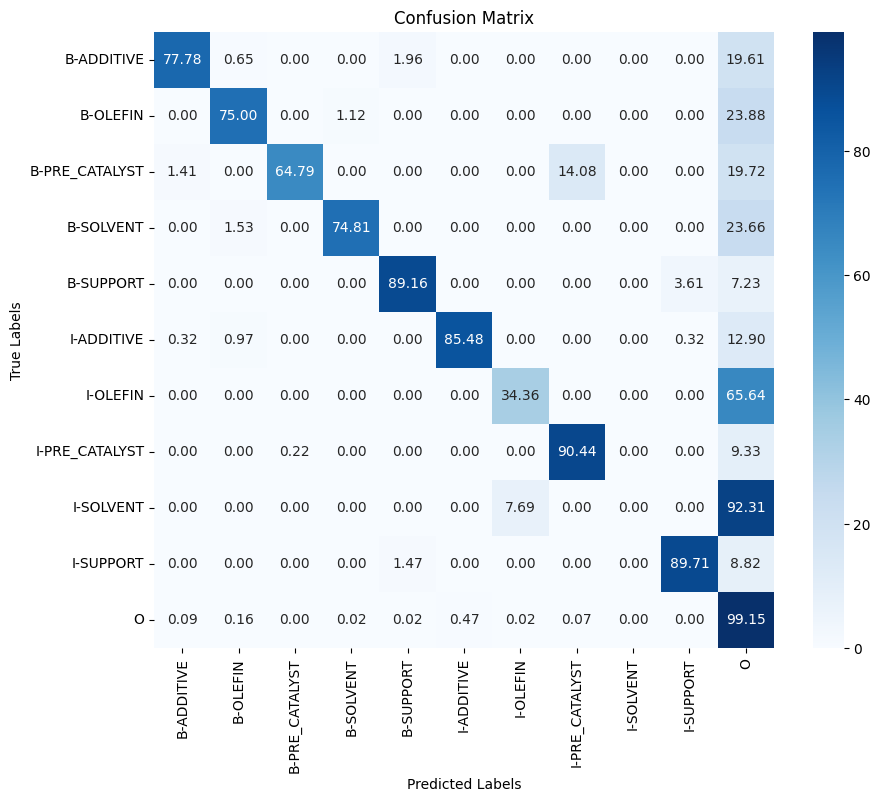

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 281ms/step - loss: 0.1574 - custom_acc_orig_tokens: 0.9541 - custom_acc_orig_non_other_tokens: 0.3571 - val_loss: 0.0469 - val_custom_acc_orig_tokens: 0.9857 - val_custom_acc_orig_non_other_tokens: 0.5483 - precision: 0.9839 - recall: 0.9900 - f1: 0.9869 - accuracy: 0.9850
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0322 - custom_acc_orig_tokens: 0.9871 - custom_acc_orig_non_other_tokens: 0.6465 - val_loss: 0.0322 - val_custom_acc_orig_tokens: 0.9884 - val_custom_acc_orig_non_other_tokens: 0.6392 - precision: 0.9876 - recall: 0.9899 - f1: 0.9887 - accuracy: 0.9876
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0264 - custom_acc_orig_tokens: 0.9895 - custom_acc_orig_non_other_tokens: 0.6931 - val_loss: 0.0322 - val_custom_acc_orig_tokens: 0.9884 - val_custom_acc_orig_non_other_tokens: 0.6392 - precision: 0.9876 - recall: 0.9899 - f1: 0.9887 - accuracy: 0.9876


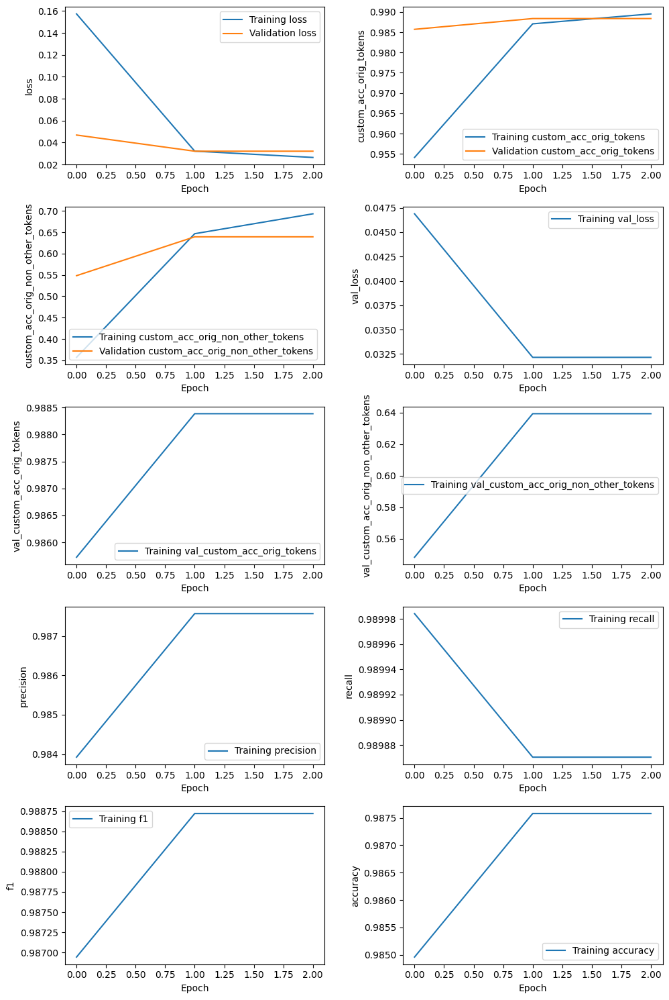

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.429,0.732,0.541,153,,
OLEFIN,0.638,0.669,0.653,356,,
PRE_CATALYST,0.544,0.789,0.644,71,,
SOLVENT,0.731,0.664,0.696,131,,
SUPPORT,0.638,0.807,0.713,83,,
OVERALL,0.583,0.705,0.638,,0.986,0.766


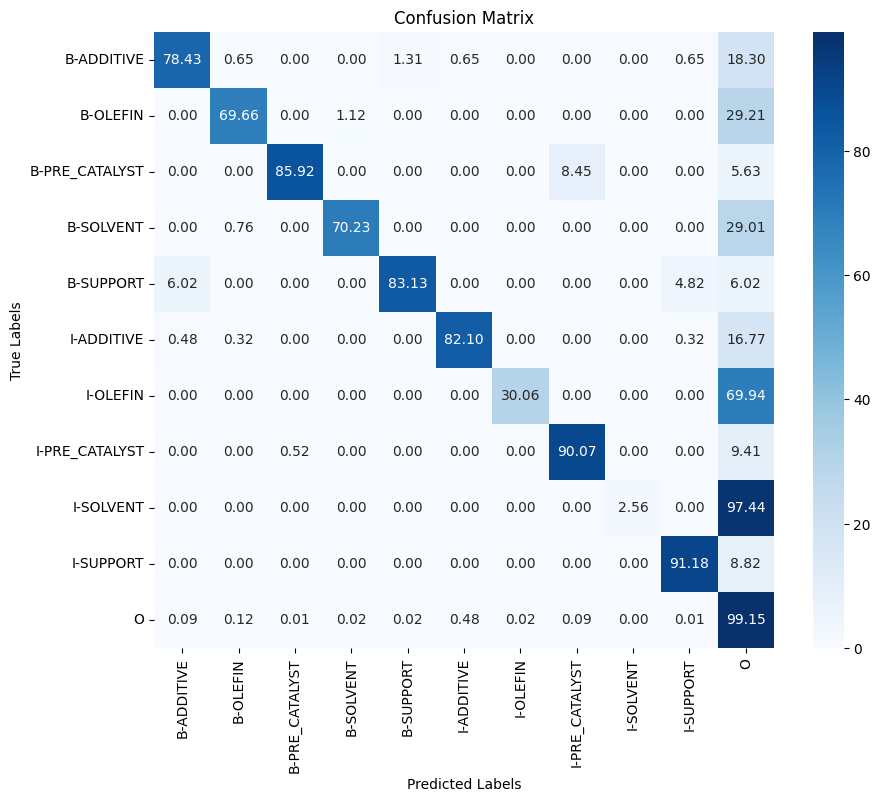

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 279ms/step - loss: 0.1479 - custom_acc_orig_tokens: 0.9563 - custom_acc_orig_non_other_tokens: 0.3748 - val_loss: 0.0525 - val_custom_acc_orig_tokens: 0.9833 - val_custom_acc_orig_non_other_tokens: 0.5272 - precision: 0.9818 - recall: 0.9886 - f1: 0.9852 - accuracy: 0.9825
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0326 - custom_acc_orig_tokens: 0.9869 - custom_acc_orig_non_other_tokens: 0.6604 - val_loss: 0.0353 - val_custom_acc_orig_tokens: 0.9870 - val_custom_acc_orig_non_other_tokens: 0.6652 - precision: 0.9865 - recall: 0.9883 - f1: 0.9874 - accuracy: 0.9862
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0271 - custom_acc_orig_tokens: 0.9891 - custom_acc_orig_non_other_tokens: 0.7222 - val_loss: 0.0353 - val_custom_acc_orig_tokens: 0.9870 - val_custom_acc_orig_non_other_tokens: 0.6652 - precision: 0.9865 - recall: 0.9883 - f1: 0.9874 - accuracy: 0.9862


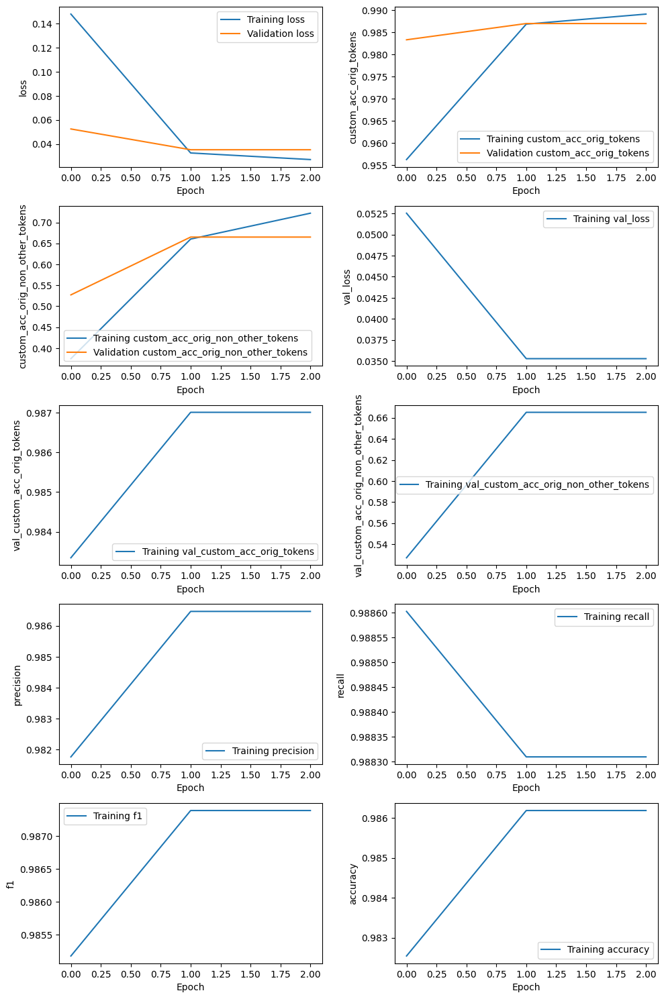

526/526 [==============================] - 49s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_32_8e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.433,0.765,0.553,153,,
OLEFIN,0.605,0.674,0.637,356,,
PRE_CATALYST,0.491,0.732,0.588,71,,
SOLVENT,0.787,0.733,0.759,131,,
SUPPORT,0.632,0.867,0.731,83,,
OVERALL,0.572,0.727,0.640,,0.985,0.760


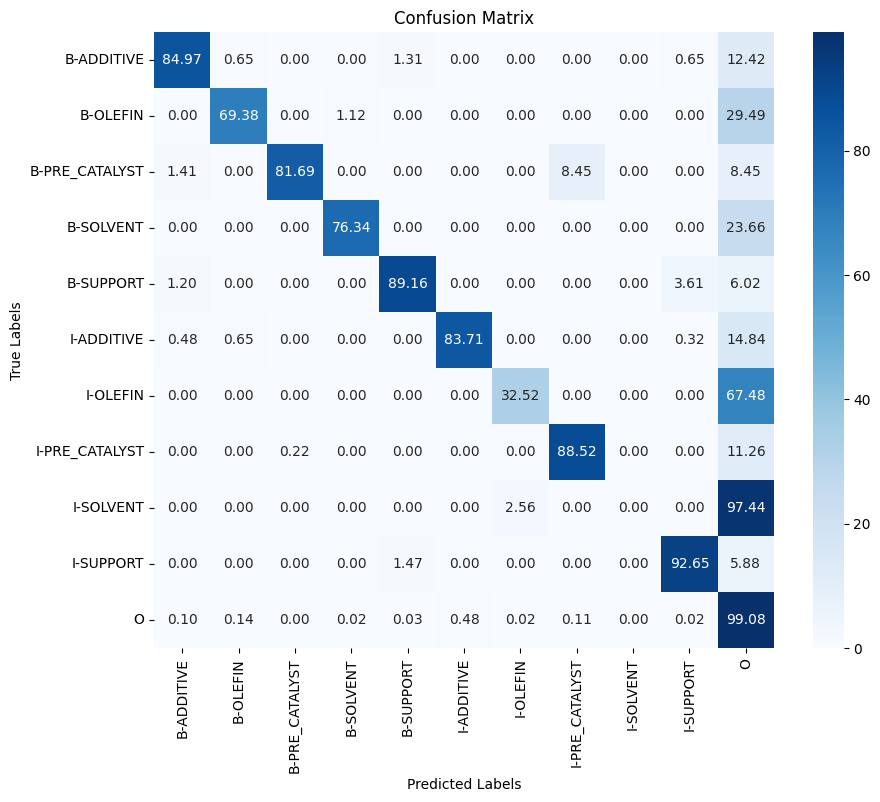

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 187s 280ms/step - loss: 0.2045 - custom_acc_orig_tokens: 0.9433 - custom_acc_orig_non_other_tokens: 0.2341 - val_loss: 0.0602 - val_custom_acc_orig_tokens: 0.9812 - val_custom_acc_orig_non_other_tokens: 0.3542 - precision: 0.9813 - recall: 0.9839 - f1: 0.9826 - accuracy: 0.9802
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0748 - custom_acc_orig_tokens: 0.9769 - custom_acc_orig_non_other_tokens: 0.3525 - val_loss: 0.0602 - val_custom_acc_orig_tokens: 0.9812 - val_custom_acc_orig_non_other_tokens: 0.3542 - precision: 0.9813 - recall: 0.9839 - f1: 0.9826 - accuracy: 0.9802
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0756 - custom_acc_orig_tokens: 0.9770 - custom_acc_orig_non_other_tokens: 0.3499 - val_loss: 0.0602 - val_custom_acc_orig_tokens: 0.9812 - val_custom_acc_orig_non_other_tokens: 0.3542 - precision: 0.9813 - recall: 0.9839 - f1: 0.9826 - accuracy: 0.9802


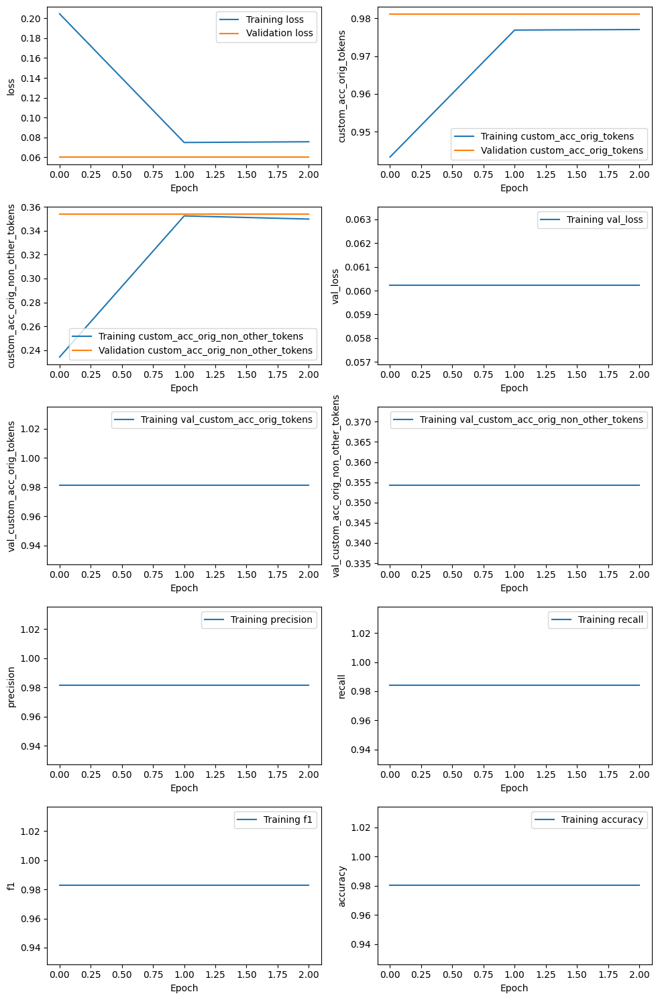

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.086,0.085,0.085,153,,
OLEFIN,0.516,0.632,0.568,356,,
PRE_CATALYST,0.154,0.324,0.209,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.333,0.036,0.065,83,,
OVERALL,0.354,0.332,0.343,,0.979,0.626


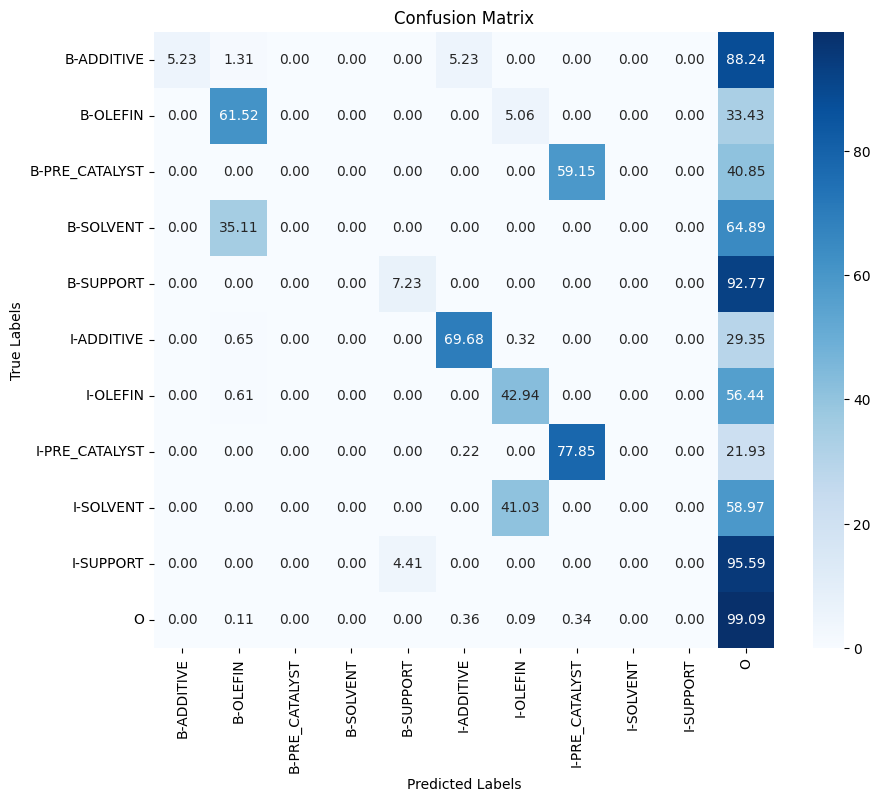

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 187s 280ms/step - loss: 0.1903 - custom_acc_orig_tokens: 0.9451 - custom_acc_orig_non_other_tokens: 0.2301 - val_loss: 0.0581 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.3430 - precision: 0.9817 - recall: 0.9835 - f1: 0.9826 - accuracy: 0.9803
Epoch 2/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0719 - custom_acc_orig_tokens: 0.9776 - custom_acc_orig_non_other_tokens: 0.3479 - val_loss: 0.0581 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.3430 - precision: 0.9817 - recall: 0.9835 - f1: 0.9826 - accuracy: 0.9803
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0721 - custom_acc_orig_tokens: 0.9775 - custom_acc_orig_non_other_tokens: 0.3469 - val_loss: 0.0581 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.3430 - precision: 0.9817 - recall: 0.9835 - f1: 0.9826 - accuracy: 0.9803


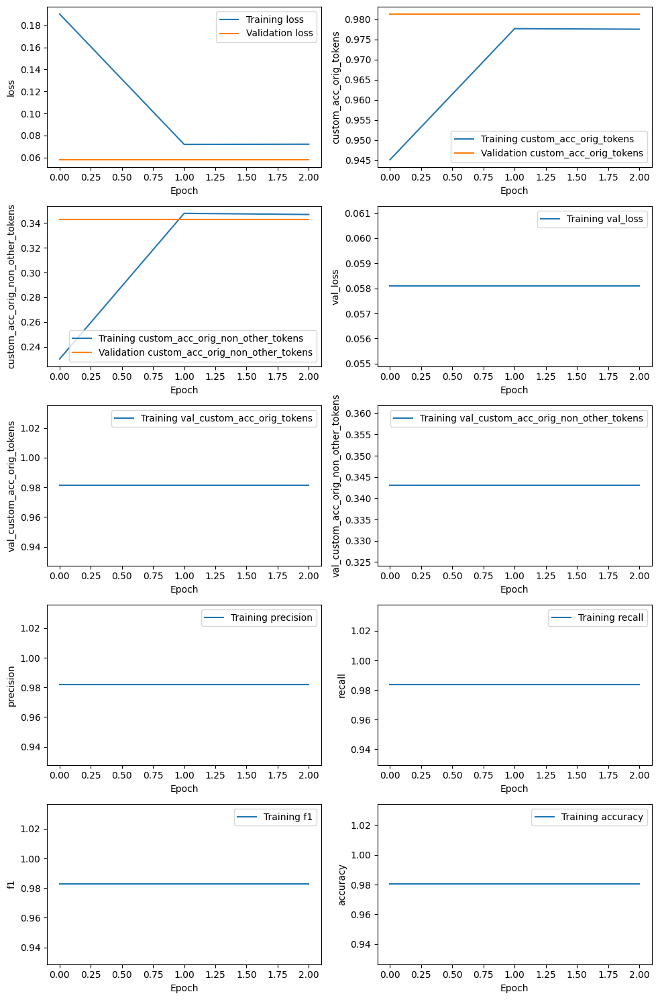

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.235,0.229,0.232,153,,
OLEFIN,0.490,0.553,0.520,356,,
PRE_CATALYST,0.285,0.521,0.368,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.395,0.339,0.365,,0.979,0.627


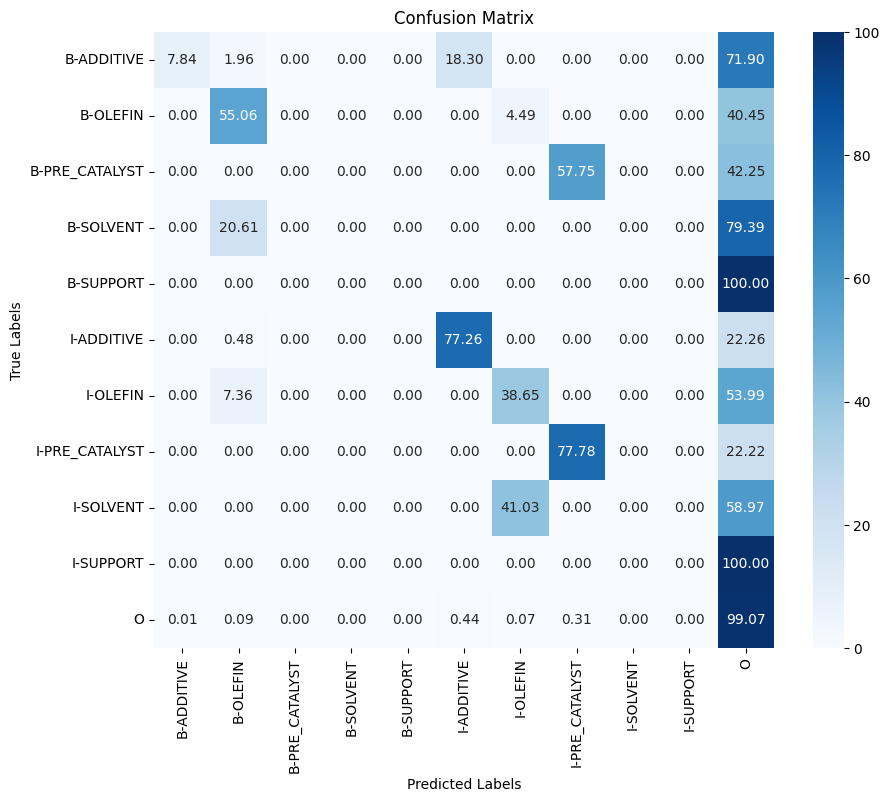

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 279ms/step - loss: 0.1795 - custom_acc_orig_tokens: 0.9474 - custom_acc_orig_non_other_tokens: 0.2419 - val_loss: 0.0542 - val_custom_acc_orig_tokens: 0.9818 - val_custom_acc_orig_non_other_tokens: 0.3639 - precision: 0.9819 - recall: 0.9840 - f1: 0.9829 - accuracy: 0.9808
Epoch 2/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0698 - custom_acc_orig_tokens: 0.9778 - custom_acc_orig_non_other_tokens: 0.3583 - val_loss: 0.0542 - val_custom_acc_orig_tokens: 0.9818 - val_custom_acc_orig_non_other_tokens: 0.3639 - precision: 0.9819 - recall: 0.9840 - f1: 0.9829 - accuracy: 0.9808
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0704 - custom_acc_orig_tokens: 0.9777 - custom_acc_orig_non_other_tokens: 0.3651 - val_loss: 0.0542 - val_custom_acc_orig_tokens: 0.9818 - val_custom_acc_orig_non_other_tokens: 0.3639 - precision: 0.9819 - recall: 0.9840 - f1: 0.9829 - accuracy: 0.9808


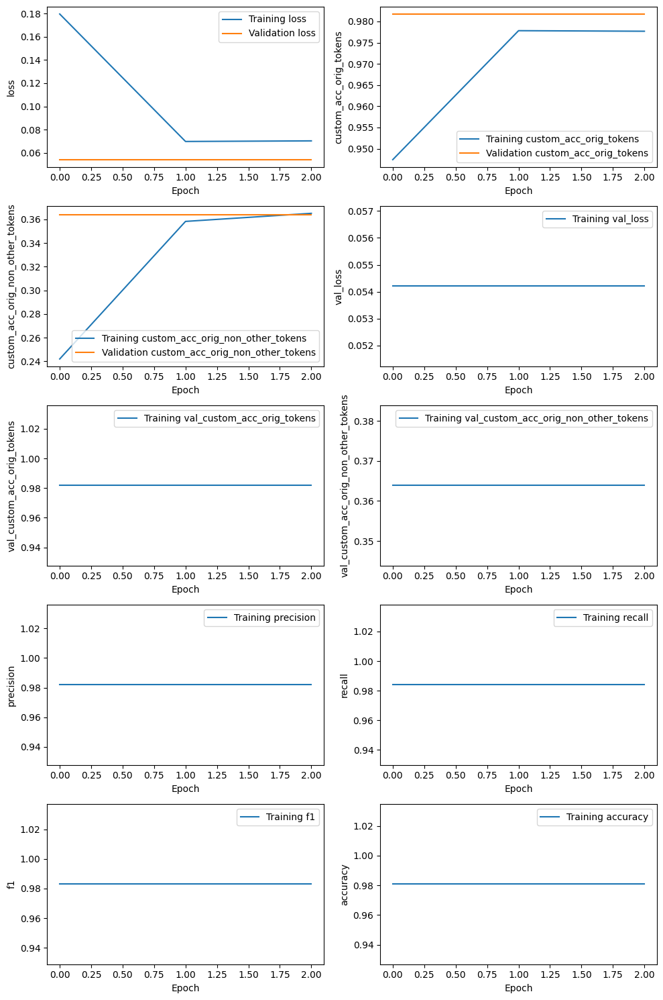

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_2e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.047,0.046,0.047,153,,
OLEFIN,0.510,0.618,0.559,356,,
PRE_CATALYST,0.279,0.549,0.370,71,,
SOLVENT,0.000,0.000,0.000,131,,
SUPPORT,0.000,0.000,0.000,83,,
OVERALL,0.368,0.335,0.351,,0.979,0.626


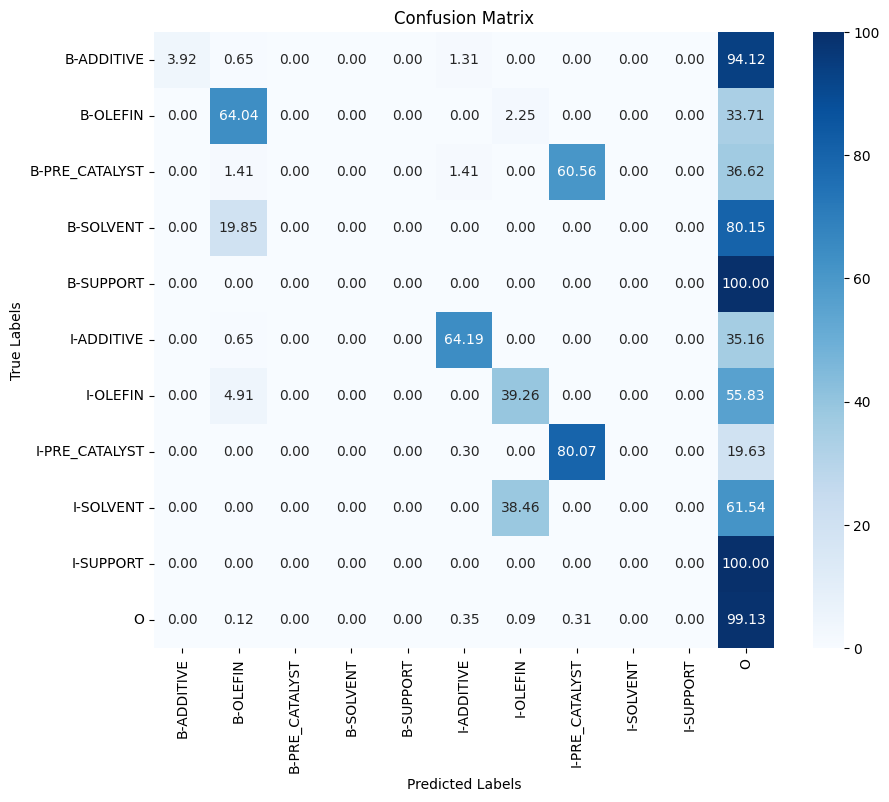

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 187s 282ms/step - loss: 0.1647 - custom_acc_orig_tokens: 0.9542 - custom_acc_orig_non_other_tokens: 0.2905 - val_loss: 0.0474 - val_custom_acc_orig_tokens: 0.9835 - val_custom_acc_orig_non_other_tokens: 0.4854 - precision: 0.9835 - recall: 0.9855 - f1: 0.9845 - accuracy: 0.9827
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0563 - custom_acc_orig_tokens: 0.9804 - custom_acc_orig_non_other_tokens: 0.4548 - val_loss: 0.0474 - val_custom_acc_orig_tokens: 0.9835 - val_custom_acc_orig_non_other_tokens: 0.4854 - precision: 0.9835 - recall: 0.9855 - f1: 0.9845 - accuracy: 0.9827
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0566 - custom_acc_orig_tokens: 0.9803 - custom_acc_orig_non_other_tokens: 0.4420 - val_loss: 0.0474 - val_custom_acc_orig_tokens: 0.9835 - val_custom_acc_orig_non_other_tokens: 0.4854 - precision: 0.9835 - recall: 0.9855 - f1: 0.9845 - accuracy: 0.9827


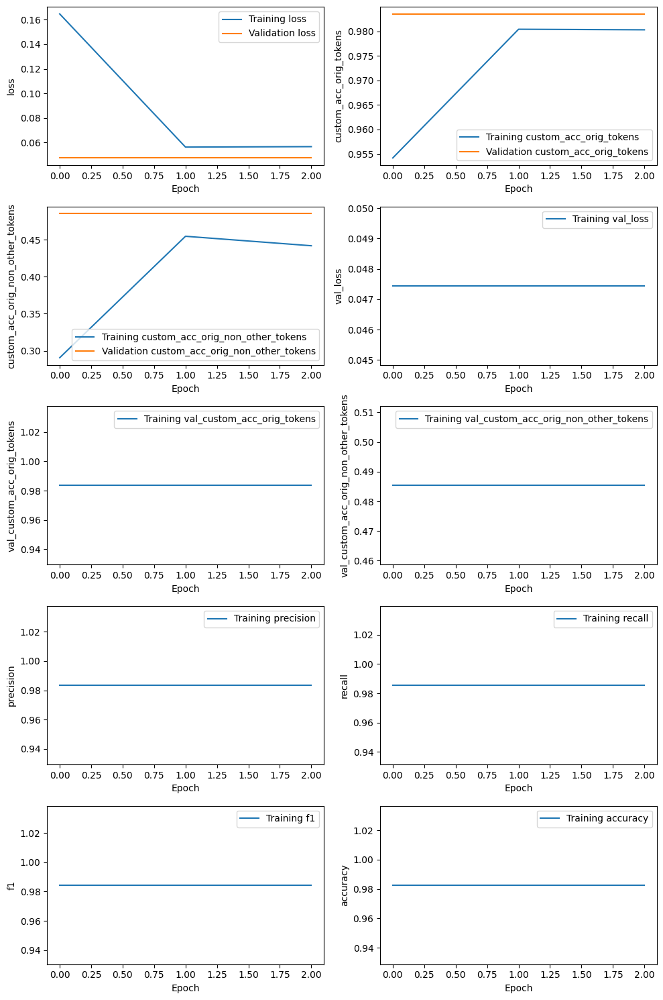

526/526 [==============================] - 48s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.101,0.150,0.121,153,,
OLEFIN,0.536,0.831,0.652,356,,
PRE_CATALYST,0.369,0.535,0.437,71,,
SOLVENT,1.000,0.290,0.450,131,,
SUPPORT,0.333,0.157,0.213,83,,
OVERALL,0.425,0.514,0.465,,0.980,0.647


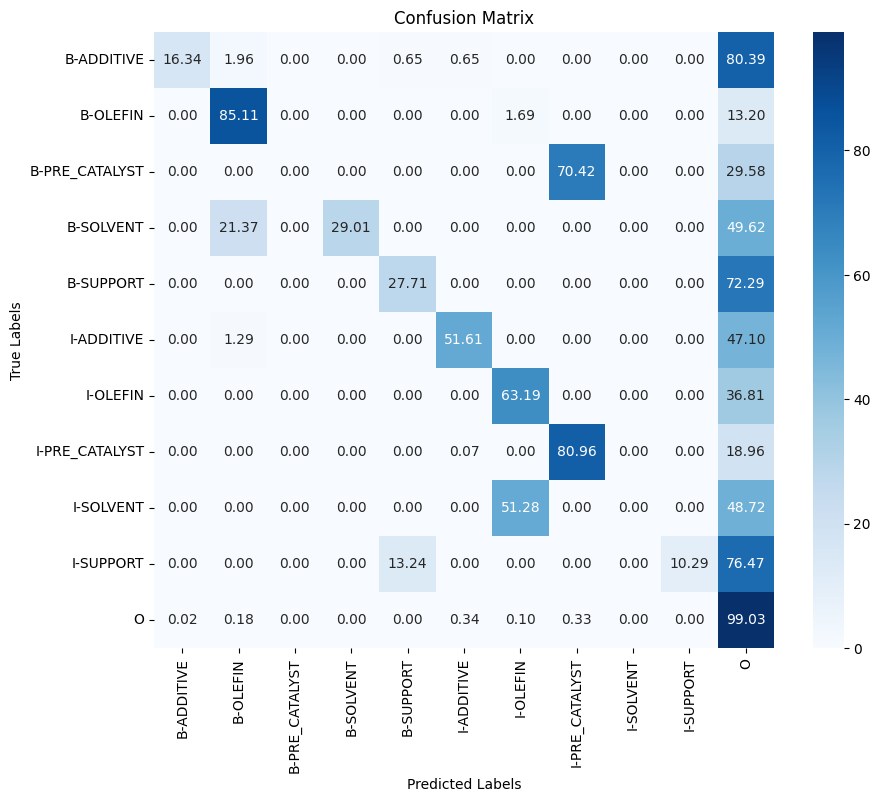

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 282ms/step - loss: 0.1533 - custom_acc_orig_tokens: 0.9560 - custom_acc_orig_non_other_tokens: 0.3045 - val_loss: 0.0449 - val_custom_acc_orig_tokens: 0.9841 - val_custom_acc_orig_non_other_tokens: 0.4972 - precision: 0.9850 - recall: 0.9854 - f1: 0.9852 - accuracy: 0.9833
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0538 - custom_acc_orig_tokens: 0.9810 - custom_acc_orig_non_other_tokens: 0.4622 - val_loss: 0.0449 - val_custom_acc_orig_tokens: 0.9841 - val_custom_acc_orig_non_other_tokens: 0.4972 - precision: 0.9850 - recall: 0.9854 - f1: 0.9852 - accuracy: 0.9833
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0542 - custom_acc_orig_tokens: 0.9808 - custom_acc_orig_non_other_tokens: 0.4560 - val_loss: 0.0449 - val_custom_acc_orig_tokens: 0.9841 - val_custom_acc_orig_non_other_tokens: 0.4972 - precision: 0.9850 - recall: 0.9854 - f1: 0.9852 - accuracy: 0.9833


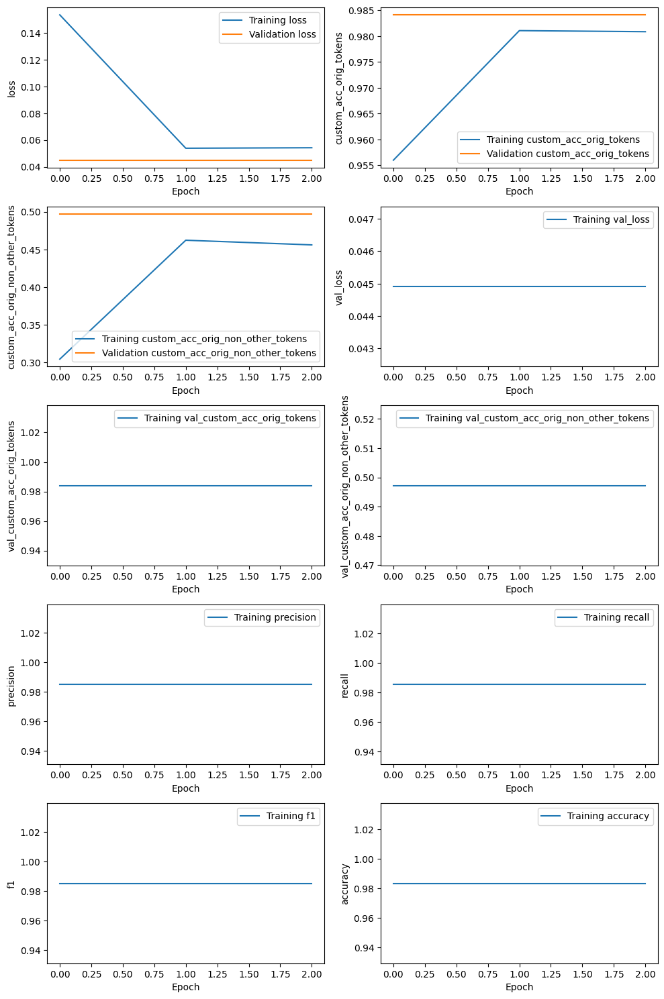

526/526 [==============================] - 49s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.291,0.359,0.322,153,,
OLEFIN,0.513,0.798,0.624,356,,
PRE_CATALYST,0.326,0.620,0.427,71,,
SOLVENT,1.000,0.099,0.181,131,,
SUPPORT,0.286,0.096,0.144,83,,
OVERALL,0.440,0.509,0.472,,0.980,0.670


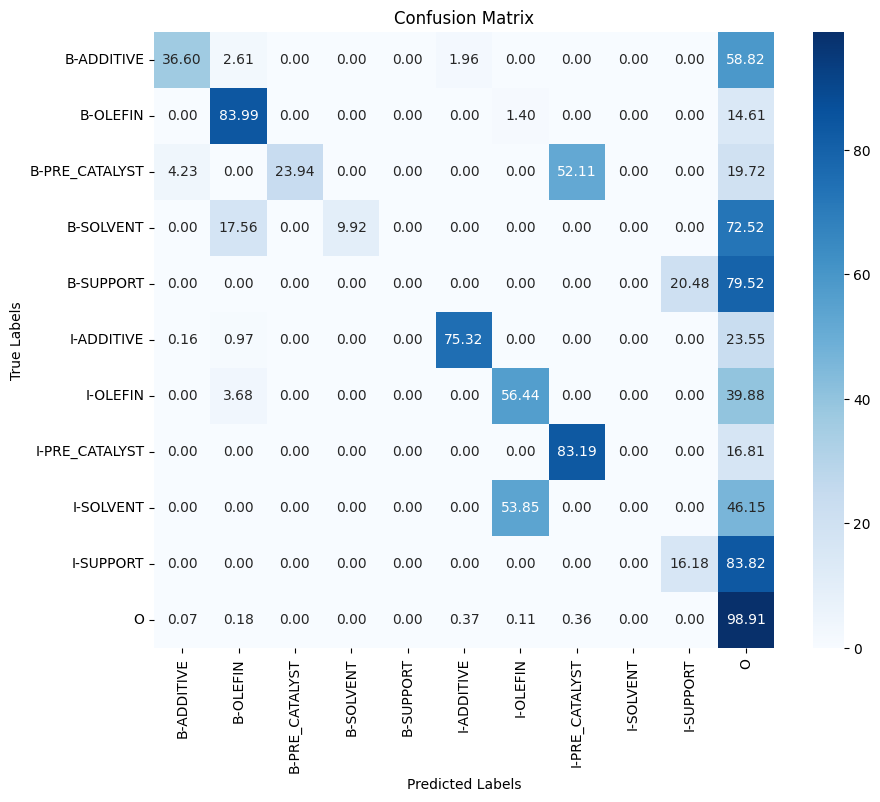

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 187s 280ms/step - loss: 0.1403 - custom_acc_orig_tokens: 0.9588 - custom_acc_orig_non_other_tokens: 0.3411 - val_loss: 0.0411 - val_custom_acc_orig_tokens: 0.9848 - val_custom_acc_orig_non_other_tokens: 0.5438 - precision: 0.9853 - recall: 0.9864 - f1: 0.9859 - accuracy: 0.9842
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0490 - custom_acc_orig_tokens: 0.9820 - custom_acc_orig_non_other_tokens: 0.5107 - val_loss: 0.0411 - val_custom_acc_orig_tokens: 0.9848 - val_custom_acc_orig_non_other_tokens: 0.5438 - precision: 0.9853 - recall: 0.9864 - f1: 0.9859 - accuracy: 0.9842
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0494 - custom_acc_orig_tokens: 0.9820 - custom_acc_orig_non_other_tokens: 0.5000 - val_loss: 0.0411 - val_custom_acc_orig_tokens: 0.9848 - val_custom_acc_orig_non_other_tokens: 0.5438 - precision: 0.9853 - recall: 0.9864 - f1: 0.9859 - accuracy: 0.9842


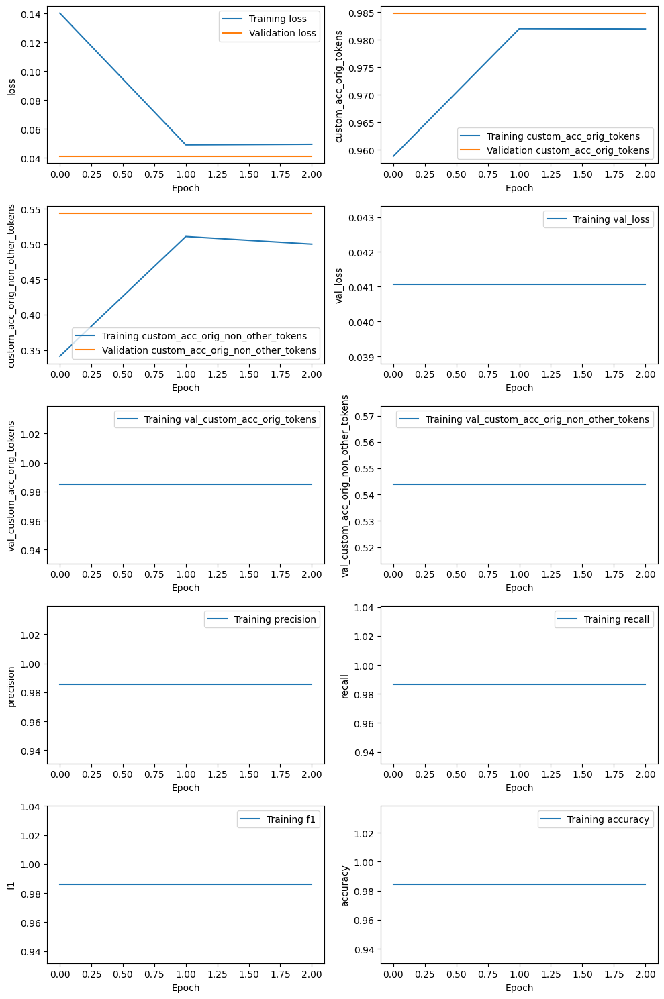

526/526 [==============================] - 51s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_5e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.194,0.340,0.247,153,,
OLEFIN,0.556,0.888,0.684,356,,
PRE_CATALYST,0.427,0.704,0.532,71,,
SOLVENT,0.940,0.359,0.519,131,,
SUPPORT,0.444,0.289,0.350,83,,
OVERALL,0.463,0.616,0.528,,0.981,0.690


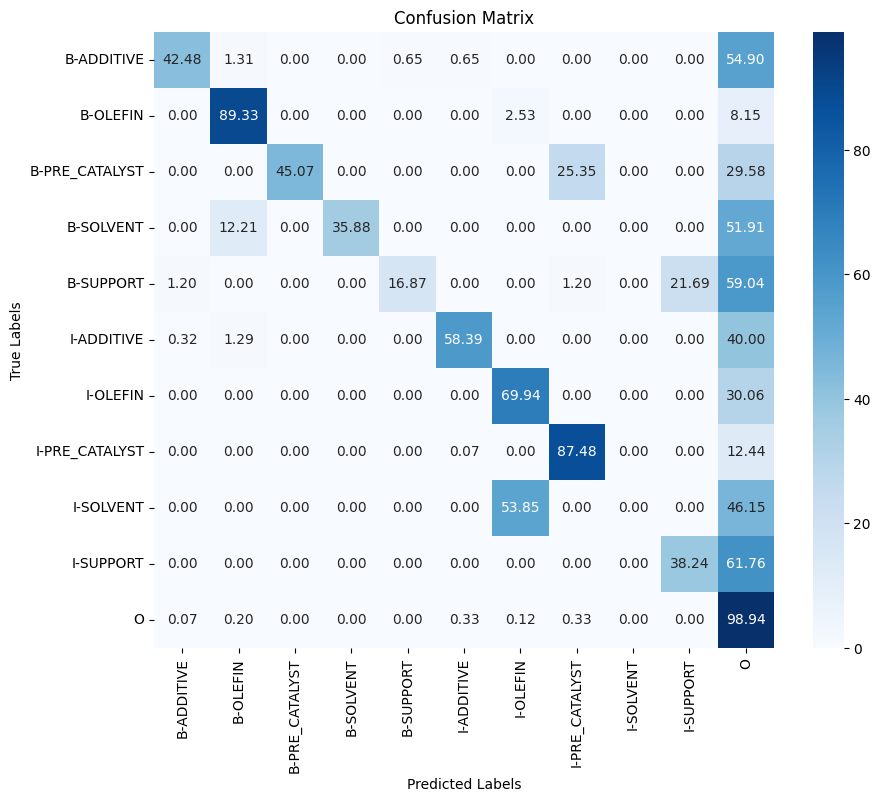

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 279ms/step - loss: 0.1478 - custom_acc_orig_tokens: 0.9582 - custom_acc_orig_non_other_tokens: 0.3280 - val_loss: 0.0415 - val_custom_acc_orig_tokens: 0.9837 - val_custom_acc_orig_non_other_tokens: 0.5378 - precision: 0.9839 - recall: 0.9857 - f1: 0.9848 - accuracy: 0.9830
Epoch 2/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0482 - custom_acc_orig_tokens: 0.9818 - custom_acc_orig_non_other_tokens: 0.5240 - val_loss: 0.0415 - val_custom_acc_orig_tokens: 0.9837 - val_custom_acc_orig_non_other_tokens: 0.5378 - precision: 0.9839 - recall: 0.9857 - f1: 0.9848 - accuracy: 0.9830
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0483 - custom_acc_orig_tokens: 0.9818 - custom_acc_orig_non_other_tokens: 0.5103 - val_loss: 0.0415 - val_custom_acc_orig_tokens: 0.9837 - val_custom_acc_orig_non_other_tokens: 0.5378 - precision: 0.9839 - recall: 0.9857 - f1: 0.9848 - accuracy: 0.9830


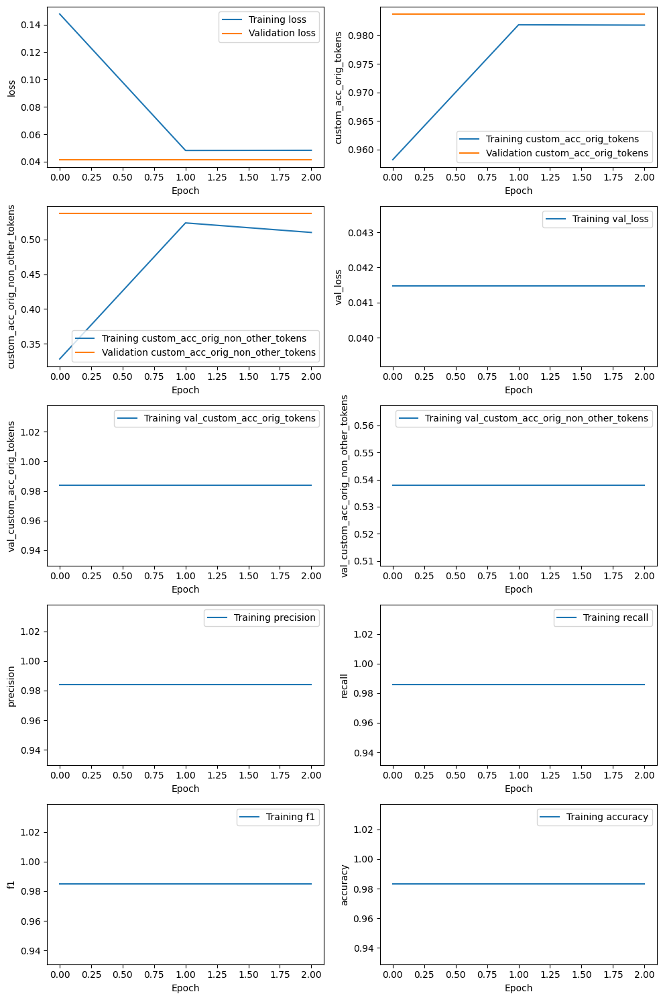

526/526 [==============================] - 51s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r1_train_predictions.json in the repository.
93/93 [==============================] - 7s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r1_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.195,0.346,0.249,153,,
OLEFIN,0.533,0.851,0.655,356,,
PRE_CATALYST,0.430,0.732,0.542,71,,
SOLVENT,0.934,0.435,0.594,131,,
SUPPORT,0.444,0.386,0.413,83,,
OVERALL,0.454,0.626,0.526,,0.980,0.660


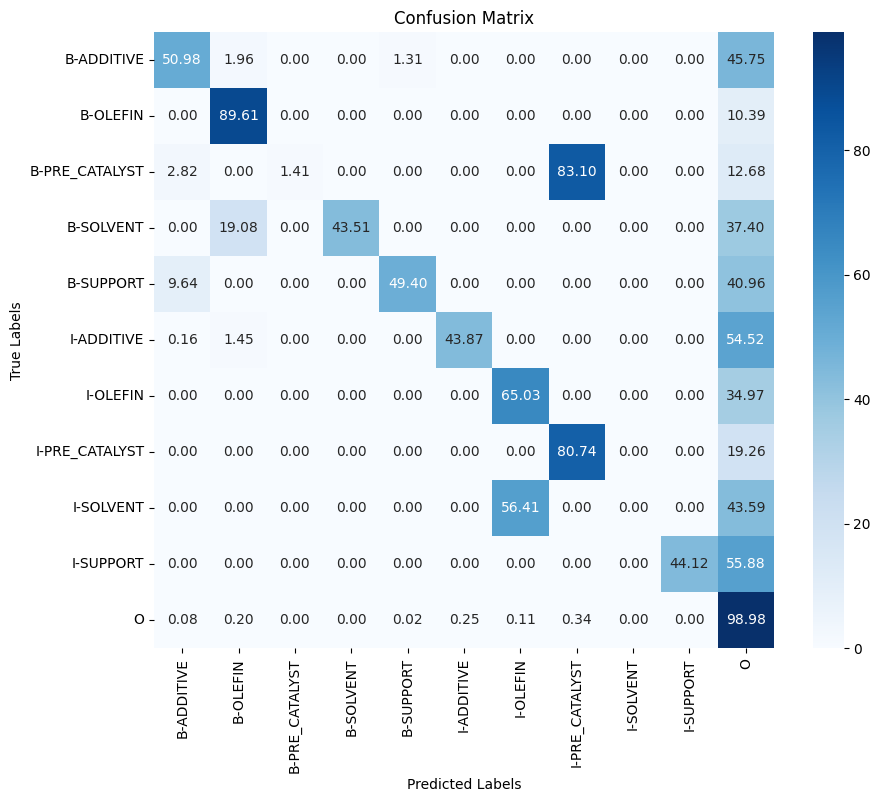

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 185s 279ms/step - loss: 0.1388 - custom_acc_orig_tokens: 0.9592 - custom_acc_orig_non_other_tokens: 0.3280 - val_loss: 0.0408 - val_custom_acc_orig_tokens: 0.9856 - val_custom_acc_orig_non_other_tokens: 0.5474 - precision: 0.9862 - recall: 0.9872 - f1: 0.9867 - accuracy: 0.9849
Epoch 2/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0482 - custom_acc_orig_tokens: 0.9821 - custom_acc_orig_non_other_tokens: 0.5014 - val_loss: 0.0408 - val_custom_acc_orig_tokens: 0.9856 - val_custom_acc_orig_non_other_tokens: 0.5474 - precision: 0.9862 - recall: 0.9872 - f1: 0.9867 - accuracy: 0.9849
Epoch 3/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0486 - custom_acc_orig_tokens: 0.9818 - custom_acc_orig_non_other_tokens: 0.4944 - val_loss: 0.0408 - val_custom_acc_orig_tokens: 0.9856 - val_custom_acc_orig_non_other_tokens: 0.5474 - precision: 0.9862 - recall: 0.9872 - f1: 0.9867 - accuracy: 0.9849


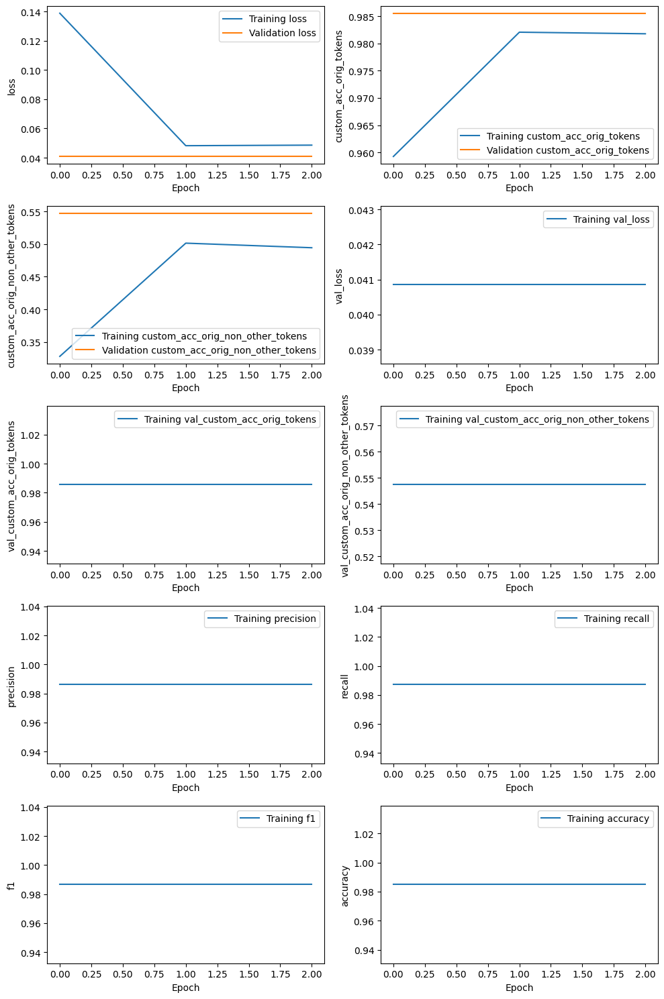

526/526 [==============================] - 50s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r2_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r2_val_predictions.json in the repository.
155/155 [==============================] - 12s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.235,0.373,0.288,153,,
OLEFIN,0.535,0.837,0.653,356,,
PRE_CATALYST,0.386,0.718,0.502,71,,
SOLVENT,0.911,0.389,0.545,131,,
SUPPORT,0.469,0.277,0.348,83,,
OVERALL,0.463,0.605,0.524,,0.981,0.662


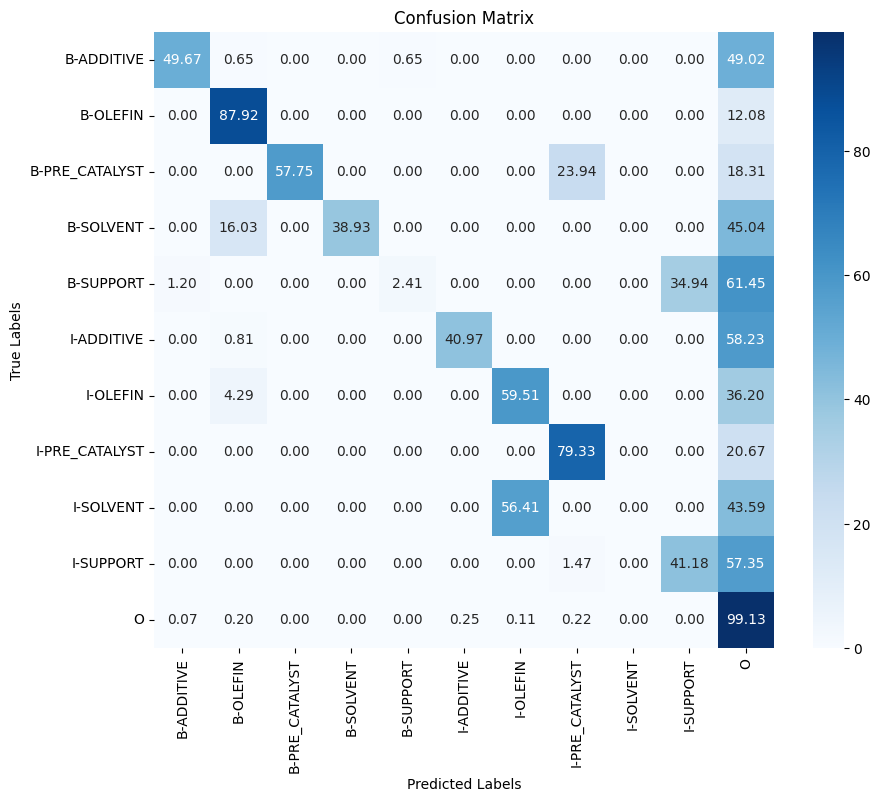

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filefem2akw2.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


526/526 [==============================] - 186s 278ms/step - loss: 0.1293 - custom_acc_orig_tokens: 0.9617 - custom_acc_orig_non_other_tokens: 0.3602 - val_loss: 0.0373 - val_custom_acc_orig_tokens: 0.9858 - val_custom_acc_orig_non_other_tokens: 0.5824 - precision: 0.9858 - recall: 0.9866 - f1: 0.9862 - accuracy: 0.9852
Epoch 2/3
526/526 [==============================] - 120s 228ms/step - loss: 0.0439 - custom_acc_orig_tokens: 0.9837 - custom_acc_orig_non_other_tokens: 0.5436 - val_loss: 0.0373 - val_custom_acc_orig_tokens: 0.9858 - val_custom_acc_orig_non_other_tokens: 0.5824 - precision: 0.9858 - recall: 0.9866 - f1: 0.9862 - accuracy: 0.9852
Epoch 3/3
526/526 [==============================] - 120s 229ms/step - loss: 0.0439 - custom_acc_orig_tokens: 0.9836 - custom_acc_orig_non_other_tokens: 0.5438 - val_loss: 0.0373 - val_custom_acc_orig_tokens: 0.9858 - val_custom_acc_orig_non_other_tokens: 0.5824 - precision: 0.9858 - recall: 0.9866 - f1: 0.9862 - accuracy: 0.9852


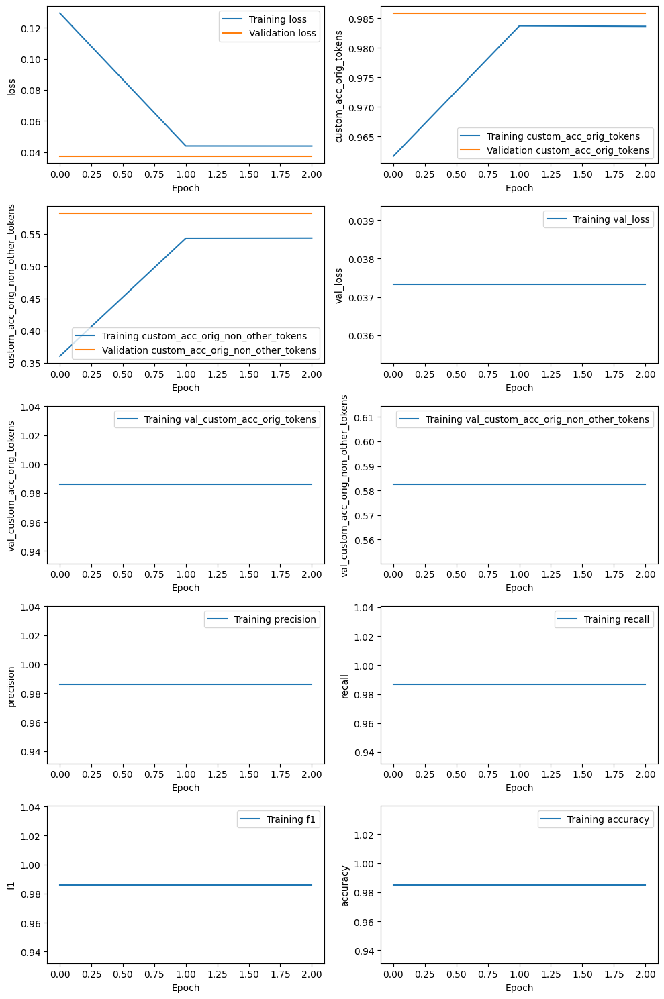

526/526 [==============================] - 50s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r3_train_predictions.json in the repository.
93/93 [==============================] - 7s 74ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r3_val_predictions.json in the repository.
155/155 [==============================] - 12s 75ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/B_scibert_catalyst_all_last_64_8e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
ADDITIVE,0.219,0.418,0.288,153,,
OLEFIN,0.537,0.874,0.665,356,,
PRE_CATALYST,0.456,0.732,0.562,71,,
SOLVENT,0.870,0.511,0.644,131,,
SUPPORT,0.532,0.506,0.519,83,,
OVERALL,0.470,0.675,0.554,,0.981,0.690


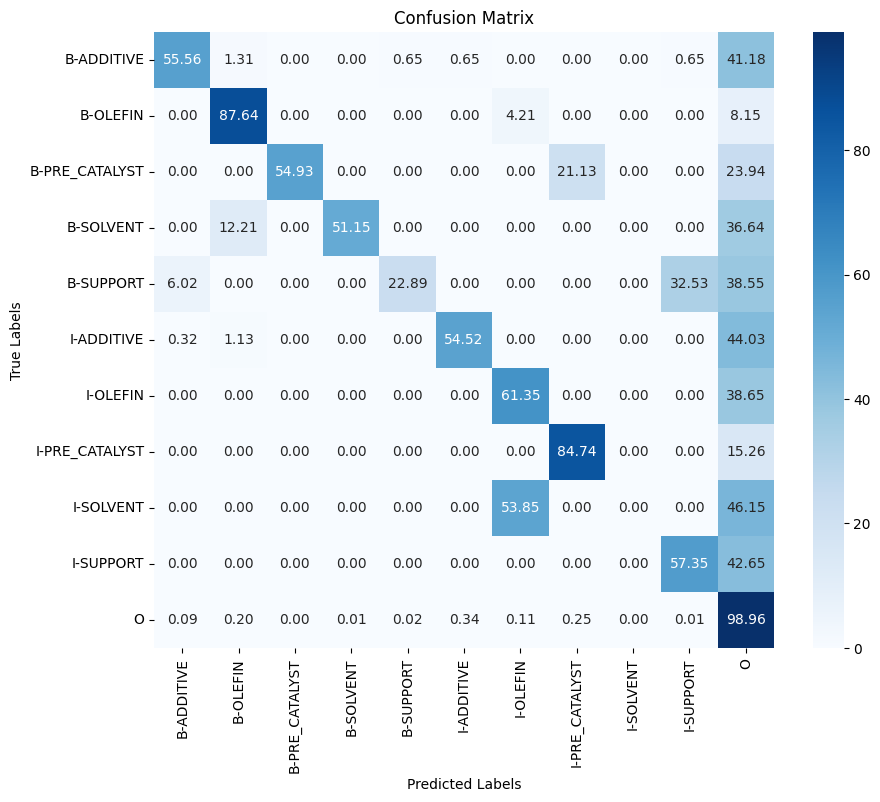

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['2', 'Hz', ')', ',', '0', '.', '66', '(', 's', ',', '3H', ')', ',', '0', '.', '64', '(', 's', ',', '3H', ')', ',', '0', '.', '58', '(', 's', ',', '3H', ')', ',', '0', '.', '57', '(', 's', ',']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['and', 'BA', '?', 'to', 'BG', '?', 'except', 'substitute', 'BOMATPB', 'for', 'BOMATPBmix', '.', 'Preferred', 'monomers', 'include', 'the', 'C2', '-', '20', '?', '-', 'olefins', 'especially', 'ethylene', ',', 'propylene', ',', 'isobutylene', ',', '1', '-', 'butene', ',', '1', '-', 'pentene', ',', '1', '-', 'hexene', ',

In [ ]:
# Catalyst dataset -- fine-tune appraoch w/ last hidden layer (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models4 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='B_',
    dataset='catalyst',
    train_strategy='all', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['last'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:  18282s/27replicates = 11.3mins/replicate

### battery_fine-tune(4-layer)

config.json:   0%|          | 0.00/385 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/222k [00:00<?, ?B/s]

Map:   0%|          | 0/2550 [00:00<?, ? examples/s]

Map:   0%|          | 0/450 [00:00<?, ? examples/s]

Map:   0%|          | 0/750 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/datasets/arrow_dataset.py:410: FutureWarning: The output of `to_tf_dataset` will change when a passing single element list for `labels` or `columns` in the next datasets version. To return a tuple structure rather than dict, pass a single string.
Old behaviour: columns=['a'], labels=['labels'] -> (tf.Tensor, tf.Tensor)  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor)  
New behaviour: columns=['a'],labels=['labels'] -> ({'a': tf.Tensor}, {'labels': tf.Tensor})  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor) 
  warnings.warn(



                    		C_scibert_battery_all_concat_16_2e-05_r1


pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 130s 447ms/step - loss: 0.3902 - custom_acc_orig_tokens: 0.8849 - custom_acc_orig_non_other_tokens: 0.1907 - val_loss: 0.0942 - val_custom_acc_orig_tokens: 0.9734 - val_custom_acc_orig_non_other_tokens: 0.6238 - precision: 0.9683 - recall: 0.9716 - f1: 0.9700 - accuracy: 0.9726
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0796 - custom_acc_orig_tokens: 0.9752 - custom_acc_orig_non_other_tokens: 0.6676 - val_loss: 0.0568 - val_custom_acc_orig_tokens: 0.9804 - val_custom_acc_orig_non_other_tokens: 0.7261 - precision: 0.9765 - recall: 0.9801 - f1: 0.9783 - accuracy: 0.9798
Epoch 3/3
160/160 [==============================] - 41s 259ms/step - loss: 0.0529 - custom_acc_orig_tokens: 0.9831 - custom_acc_orig_non_other_tokens: 0.7914 - val_loss: 0.0509 - val_custom_acc_orig_tokens: 0.9823 - val_custom_acc_orig_non_other_tokens: 0.8312 - precision: 0.9806 - recall: 0.9802 - f1: 0.9804 - accuracy: 0.9818


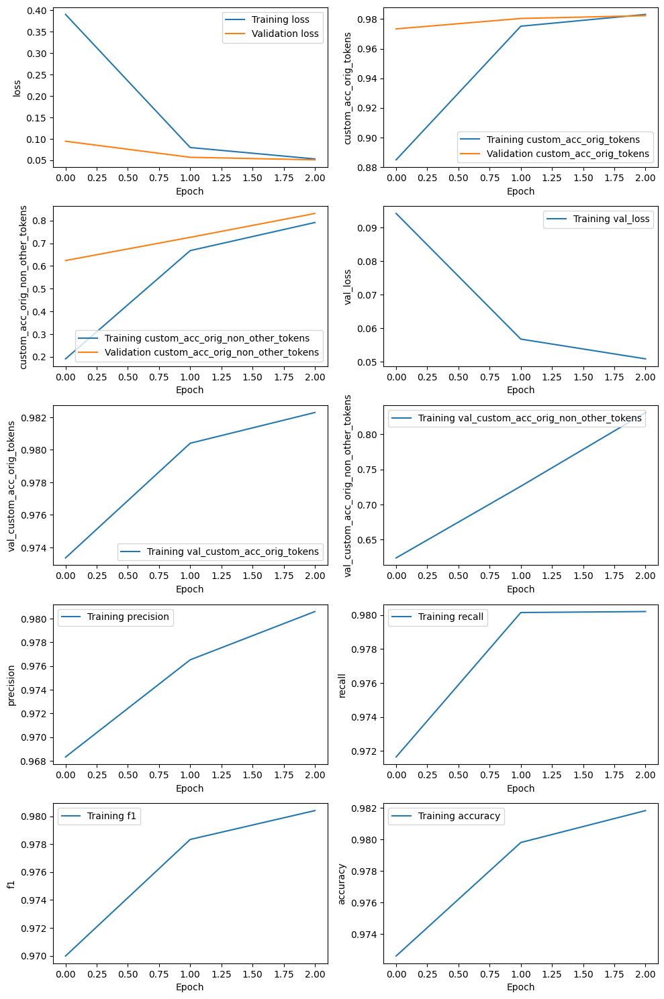

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.698,0.814,0.752,420,,
COATING_MATERIAL,0.660,0.777,0.714,359,,
COATING_METHOD,0.697,0.567,0.626,134,,
OVERALL,0.682,0.763,0.720,,0.977,0.808


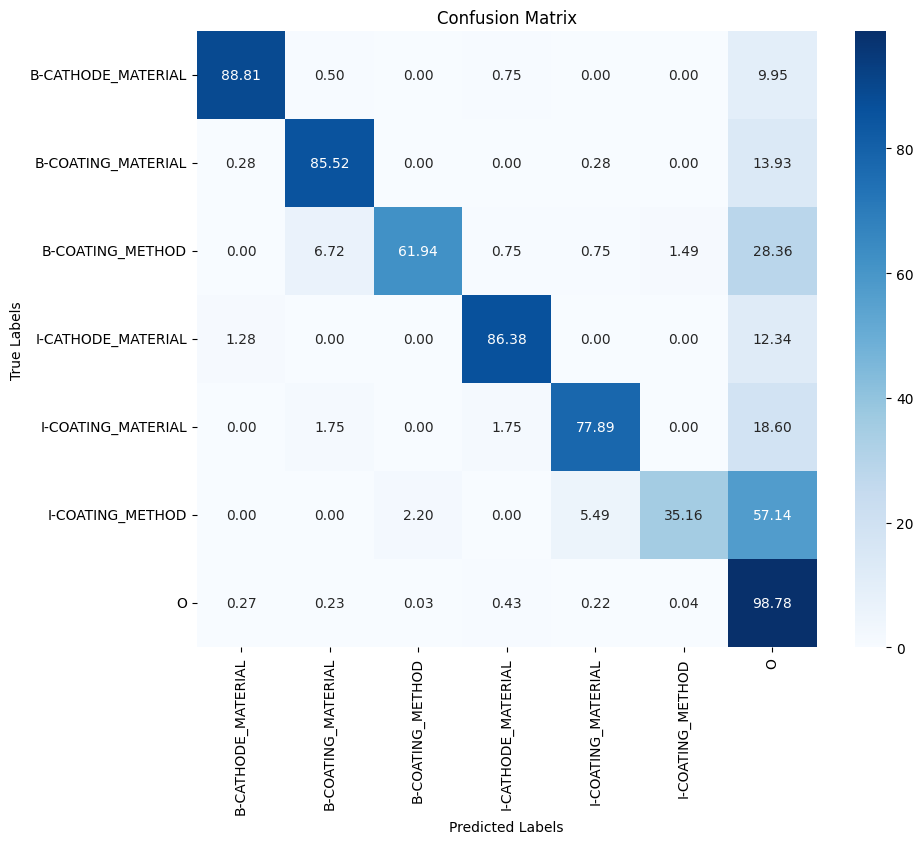

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 111s 446ms/step - loss: 0.4037 - custom_acc_orig_tokens: 0.8809 - custom_acc_orig_non_other_tokens: 0.1992 - val_loss: 0.0944 - val_custom_acc_orig_tokens: 0.9727 - val_custom_acc_orig_non_other_tokens: 0.6262 - precision: 0.9677 - recall: 0.9710 - f1: 0.9694 - accuracy: 0.9720
Epoch 2/3
160/160 [==============================] - 41s 259ms/step - loss: 0.0791 - custom_acc_orig_tokens: 0.9754 - custom_acc_orig_non_other_tokens: 0.6735 - val_loss: 0.0580 - val_custom_acc_orig_tokens: 0.9814 - val_custom_acc_orig_non_other_tokens: 0.7669 - precision: 0.9779 - recall: 0.9813 - f1: 0.9796 - accuracy: 0.9809
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0524 - custom_acc_orig_tokens: 0.9830 - custom_acc_orig_non_other_tokens: 0.7939 - val_loss: 0.0528 - val_custom_acc_orig_tokens: 0.9827 - val_custom_acc_orig_non_other_tokens: 0.8231 - precision: 0.9808 - recall: 0.9813 - f1: 0.9811 - accuracy: 0.9822


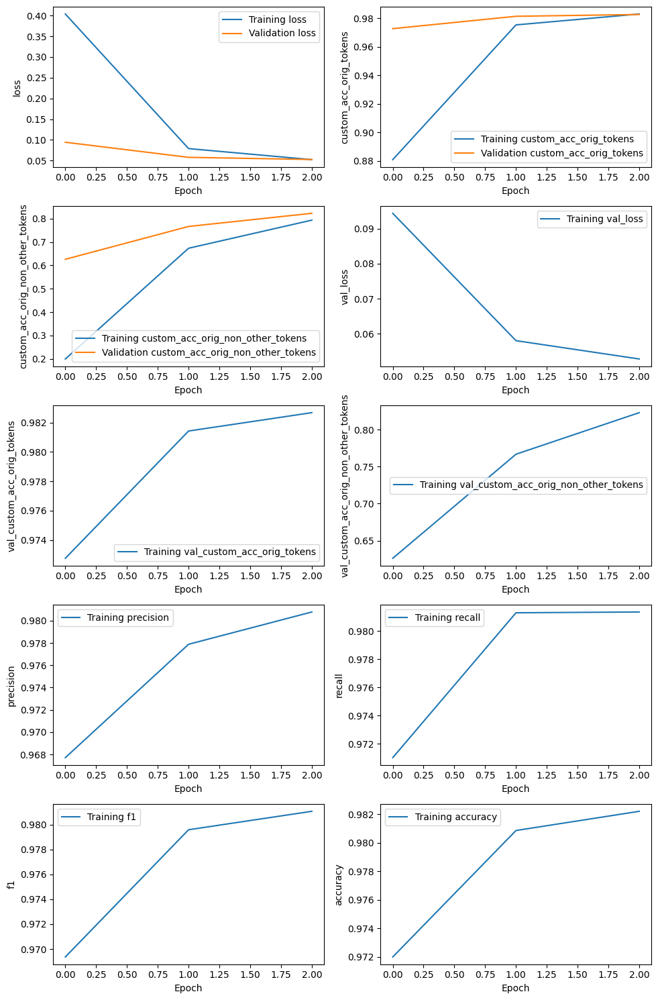

160/160 [==============================] - 23s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.713,0.800,0.754,420,,
COATING_MATERIAL,0.664,0.780,0.717,359,,
COATING_METHOD,0.694,0.560,0.620,134,,
OVERALL,0.690,0.757,0.722,,0.977,0.803


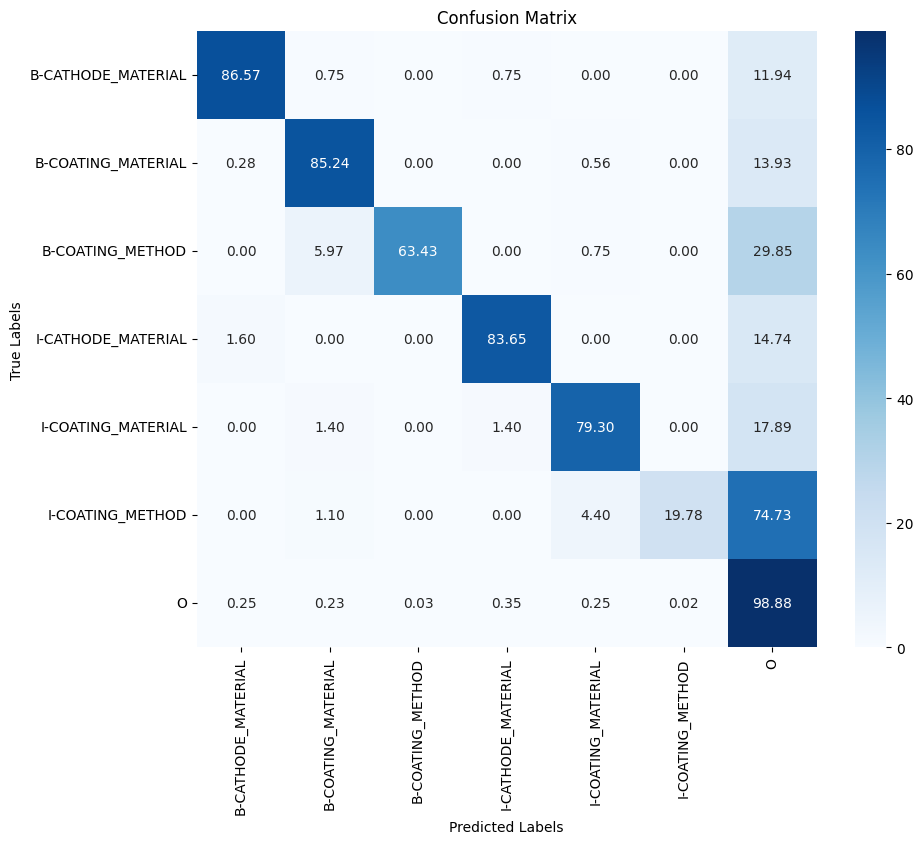

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 113s 441ms/step - loss: 0.3609 - custom_acc_orig_tokens: 0.8928 - custom_acc_orig_non_other_tokens: 0.1947 - val_loss: 0.0978 - val_custom_acc_orig_tokens: 0.9706 - val_custom_acc_orig_non_other_tokens: 0.5509 - precision: 0.9647 - recall: 0.9704 - f1: 0.9675 - accuracy: 0.9701
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0829 - custom_acc_orig_tokens: 0.9745 - custom_acc_orig_non_other_tokens: 0.6545 - val_loss: 0.0590 - val_custom_acc_orig_tokens: 0.9817 - val_custom_acc_orig_non_other_tokens: 0.7824 - precision: 0.9787 - recall: 0.9813 - f1: 0.9800 - accuracy: 0.9811
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0549 - custom_acc_orig_tokens: 0.9828 - custom_acc_orig_non_other_tokens: 0.7841 - val_loss: 0.0529 - val_custom_acc_orig_tokens: 0.9823 - val_custom_acc_orig_non_other_tokens: 0.8294 - precision: 0.9804 - recall: 0.9809 - f1: 0.9807 - accuracy: 0.9818


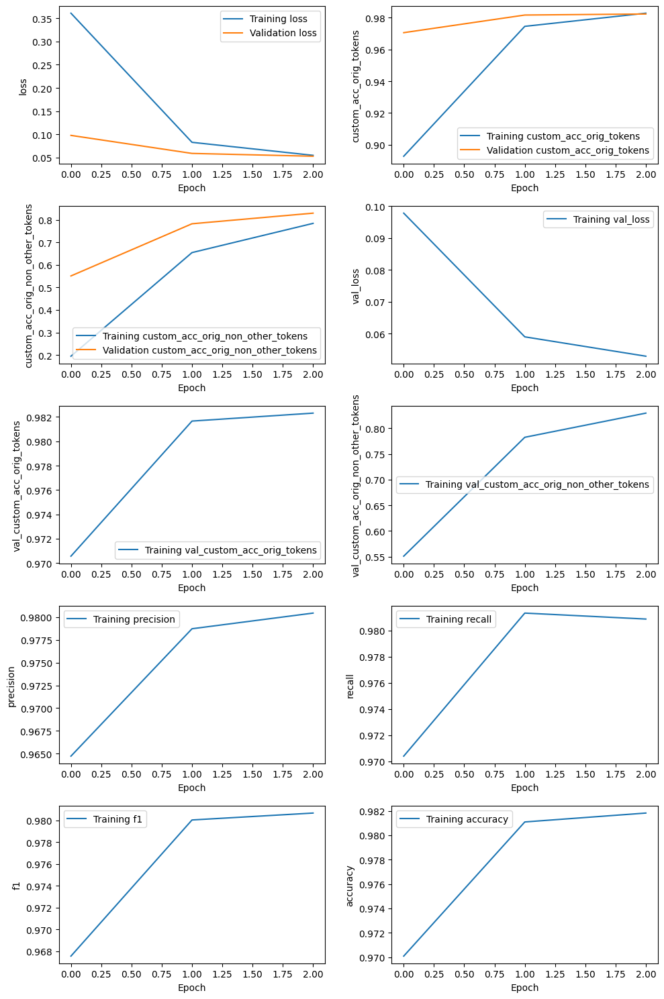

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_2e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.721,0.817,0.766,420,,
COATING_MATERIAL,0.657,0.786,0.716,359,,
COATING_METHOD,0.705,0.590,0.642,134,,
OVERALL,0.692,0.771,0.730,,0.977,0.805


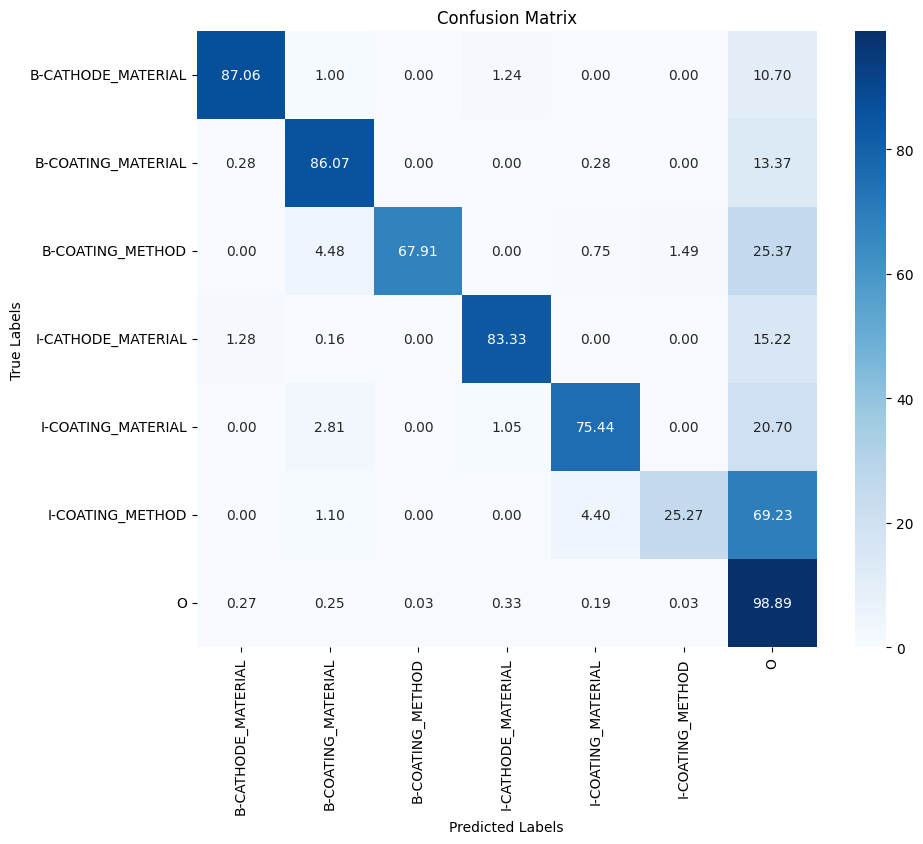

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 112s 448ms/step - loss: 0.2855 - custom_acc_orig_tokens: 0.9153 - custom_acc_orig_non_other_tokens: 0.3825 - val_loss: 0.0601 - val_custom_acc_orig_tokens: 0.9803 - val_custom_acc_orig_non_other_tokens: 0.8073 - precision: 0.9773 - recall: 0.9803 - f1: 0.9788 - accuracy: 0.9797
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0496 - custom_acc_orig_tokens: 0.9837 - custom_acc_orig_non_other_tokens: 0.8221 - val_loss: 0.0436 - val_custom_acc_orig_tokens: 0.9855 - val_custom_acc_orig_non_other_tokens: 0.8072 - precision: 0.9833 - recall: 0.9849 - f1: 0.9841 - accuracy: 0.9850
Epoch 3/3
160/160 [==============================] - 41s 259ms/step - loss: 0.0293 - custom_acc_orig_tokens: 0.9906 - custom_acc_orig_non_other_tokens: 0.9040 - val_loss: 0.0397 - val_custom_acc_orig_tokens: 0.9864 - val_custom_acc_orig_non_other_tokens: 0.8784 - precision: 0.9853 - recall: 0.9848 - f1: 0.9850 - accuracy: 0.9859


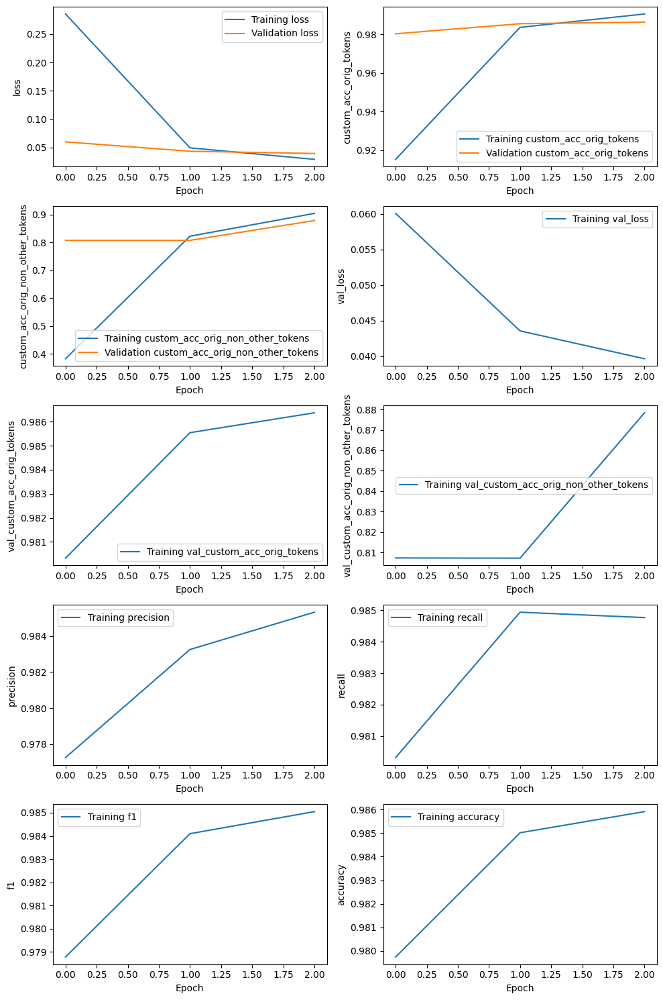

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.739,0.838,0.786,420,,
COATING_MATERIAL,0.734,0.808,0.769,359,,
COATING_METHOD,0.778,0.731,0.754,134,,
OVERALL,0.742,0.811,0.775,,0.980,0.833


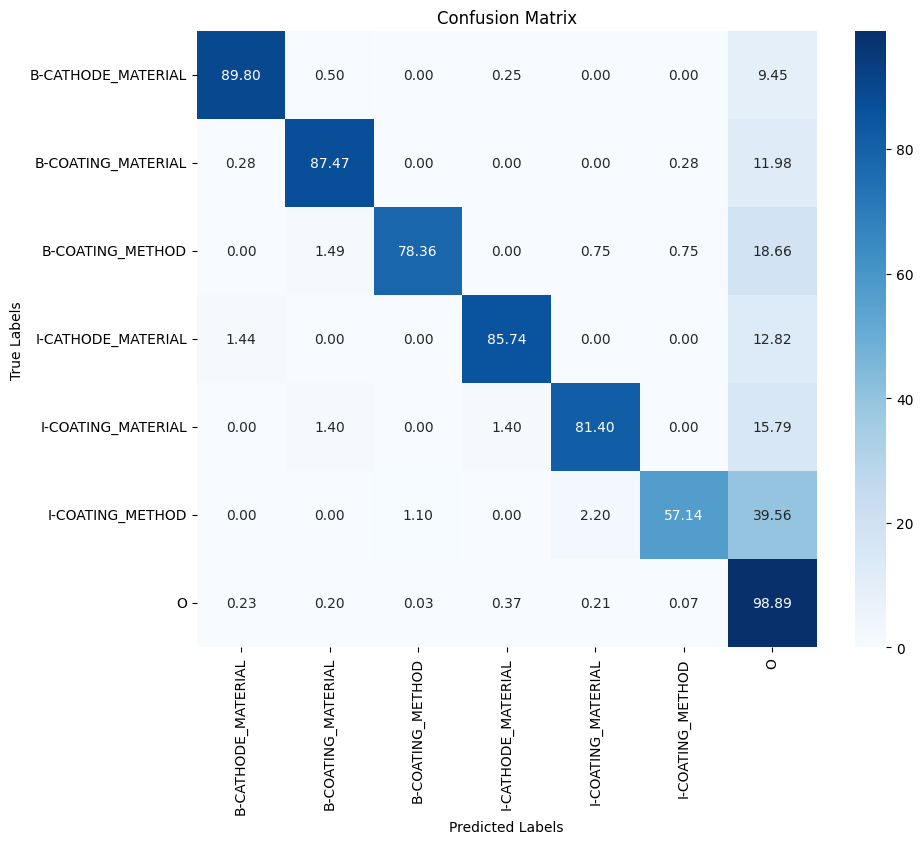

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 444ms/step - loss: 0.2960 - custom_acc_orig_tokens: 0.9124 - custom_acc_orig_non_other_tokens: 0.3778 - val_loss: 0.0663 - val_custom_acc_orig_tokens: 0.9775 - val_custom_acc_orig_non_other_tokens: 0.7448 - precision: 0.9734 - recall: 0.9781 - f1: 0.9757 - accuracy: 0.9768
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0506 - custom_acc_orig_tokens: 0.9830 - custom_acc_orig_non_other_tokens: 0.8193 - val_loss: 0.0413 - val_custom_acc_orig_tokens: 0.9864 - val_custom_acc_orig_non_other_tokens: 0.8756 - precision: 0.9853 - recall: 0.9851 - f1: 0.9852 - accuracy: 0.9860
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0315 - custom_acc_orig_tokens: 0.9895 - custom_acc_orig_non_other_tokens: 0.8967 - val_loss: 0.0402 - val_custom_acc_orig_tokens: 0.9870 - val_custom_acc_orig_non_other_tokens: 0.8851 - precision: 0.9857 - recall: 0.9855 - f1: 0.9856 - accuracy: 0.9866


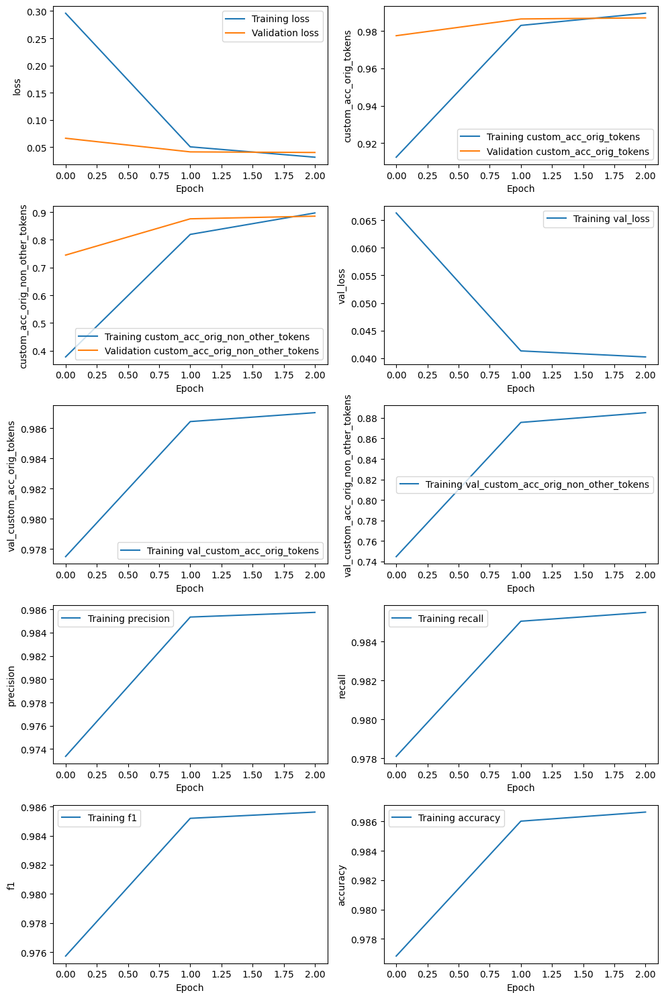

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.755,0.843,0.796,420,,
COATING_MATERIAL,0.736,0.813,0.772,359,,
COATING_METHOD,0.750,0.739,0.744,134,,
OVERALL,0.746,0.816,0.780,,0.980,0.838


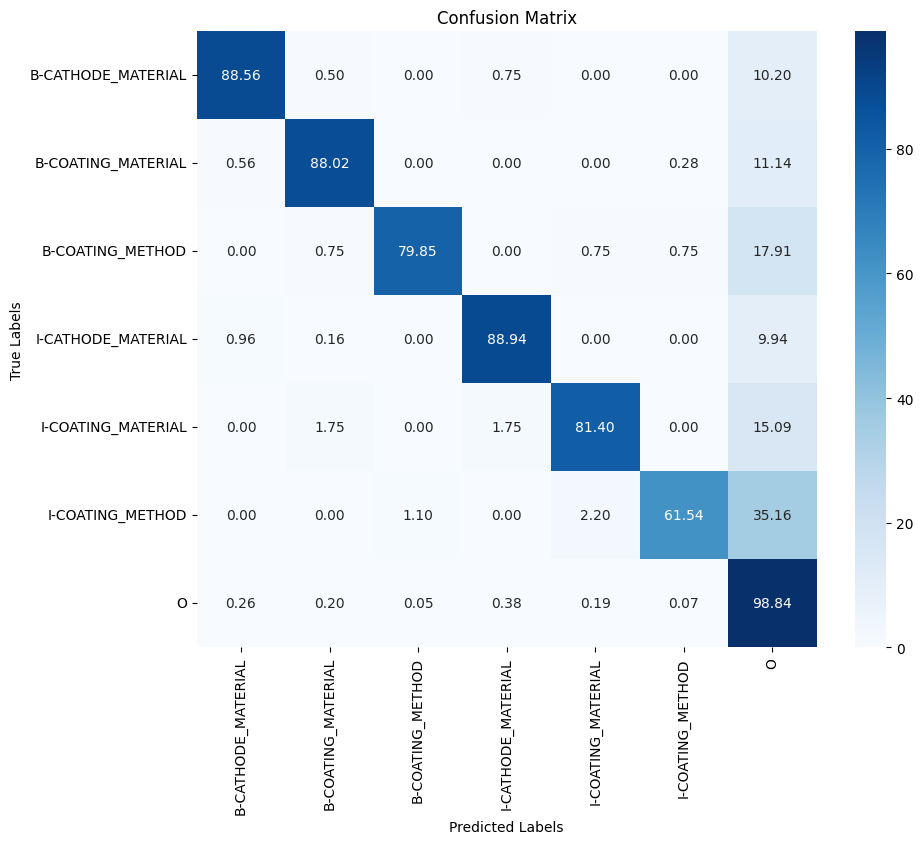

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 113s 450ms/step - loss: 0.2682 - custom_acc_orig_tokens: 0.9199 - custom_acc_orig_non_other_tokens: 0.3805 - val_loss: 0.0599 - val_custom_acc_orig_tokens: 0.9808 - val_custom_acc_orig_non_other_tokens: 0.8066 - precision: 0.9778 - recall: 0.9813 - f1: 0.9795 - accuracy: 0.9802
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0504 - custom_acc_orig_tokens: 0.9833 - custom_acc_orig_non_other_tokens: 0.8201 - val_loss: 0.0433 - val_custom_acc_orig_tokens: 0.9858 - val_custom_acc_orig_non_other_tokens: 0.8742 - precision: 0.9848 - recall: 0.9840 - f1: 0.9844 - accuracy: 0.9854
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0294 - custom_acc_orig_tokens: 0.9906 - custom_acc_orig_non_other_tokens: 0.9011 - val_loss: 0.0399 - val_custom_acc_orig_tokens: 0.9870 - val_custom_acc_orig_non_other_tokens: 0.8953 - precision: 0.9860 - recall: 0.9849 - f1: 0.9854 - accuracy: 0.9866


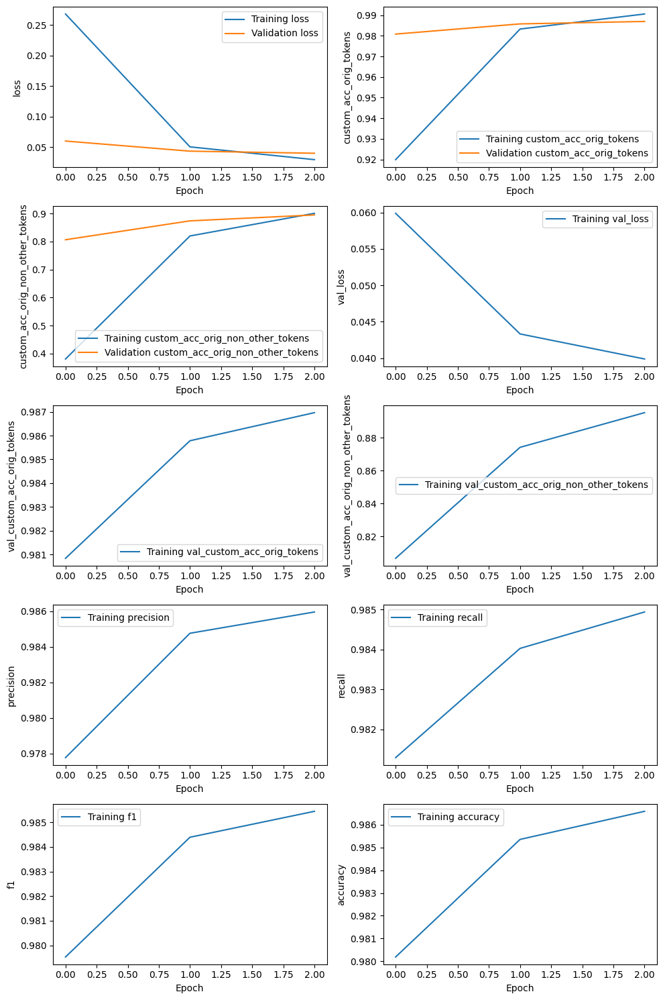

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_5e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.748,0.840,0.791,420,,
COATING_MATERIAL,0.725,0.825,0.772,359,,
COATING_METHOD,0.771,0.754,0.762,134,,
OVERALL,0.742,0.821,0.780,,0.981,0.843


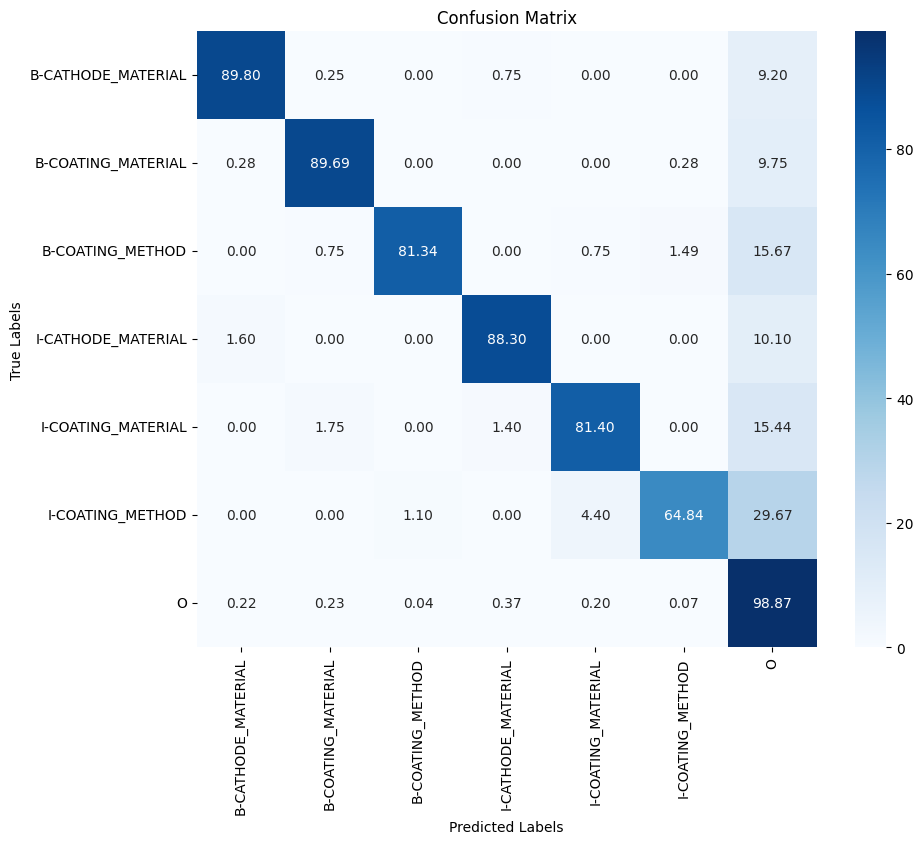

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 115s 446ms/step - loss: 0.2475 - custom_acc_orig_tokens: 0.9265 - custom_acc_orig_non_other_tokens: 0.4426 - val_loss: 0.0555 - val_custom_acc_orig_tokens: 0.9814 - val_custom_acc_orig_non_other_tokens: 0.8433 - precision: 0.9788 - recall: 0.9813 - f1: 0.9800 - accuracy: 0.9808
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0438 - custom_acc_orig_tokens: 0.9850 - custom_acc_orig_non_other_tokens: 0.8519 - val_loss: 0.0428 - val_custom_acc_orig_tokens: 0.9855 - val_custom_acc_orig_non_other_tokens: 0.8090 - precision: 0.9833 - recall: 0.9849 - f1: 0.9841 - accuracy: 0.9850
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0241 - custom_acc_orig_tokens: 0.9921 - custom_acc_orig_non_other_tokens: 0.9229 - val_loss: 0.0383 - val_custom_acc_orig_tokens: 0.9871 - val_custom_acc_orig_non_other_tokens: 0.8817 - precision: 0.9858 - recall: 0.9857 - f1: 0.9858 - accuracy: 0.9867


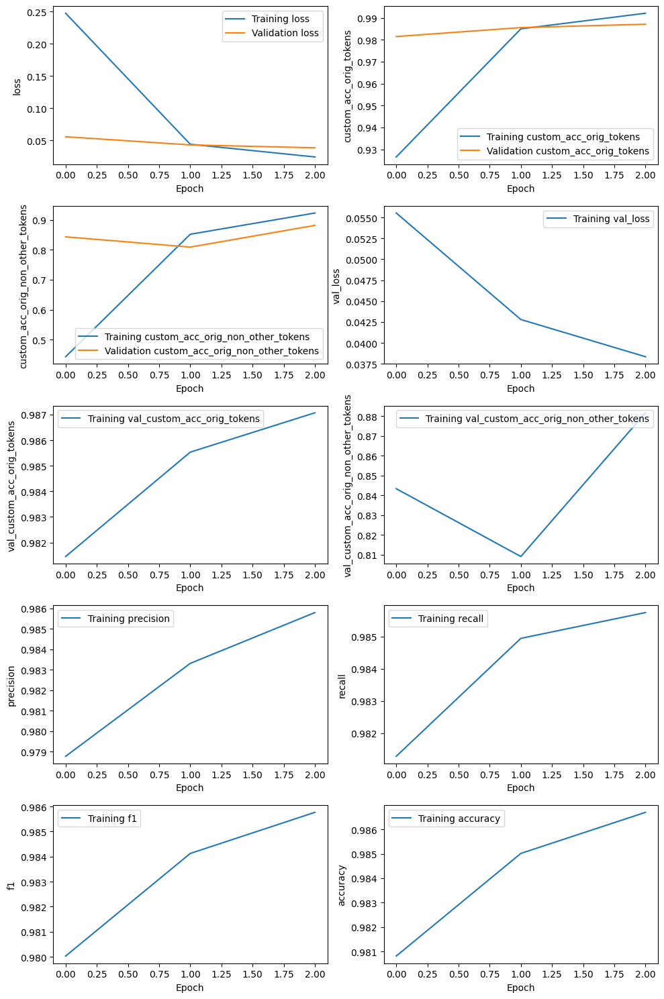

160/160 [==============================] - 23s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.765,0.845,0.803,420,,
COATING_MATERIAL,0.760,0.813,0.786,359,,
COATING_METHOD,0.760,0.731,0.745,134,,
OVERALL,0.763,0.816,0.788,,0.981,0.839


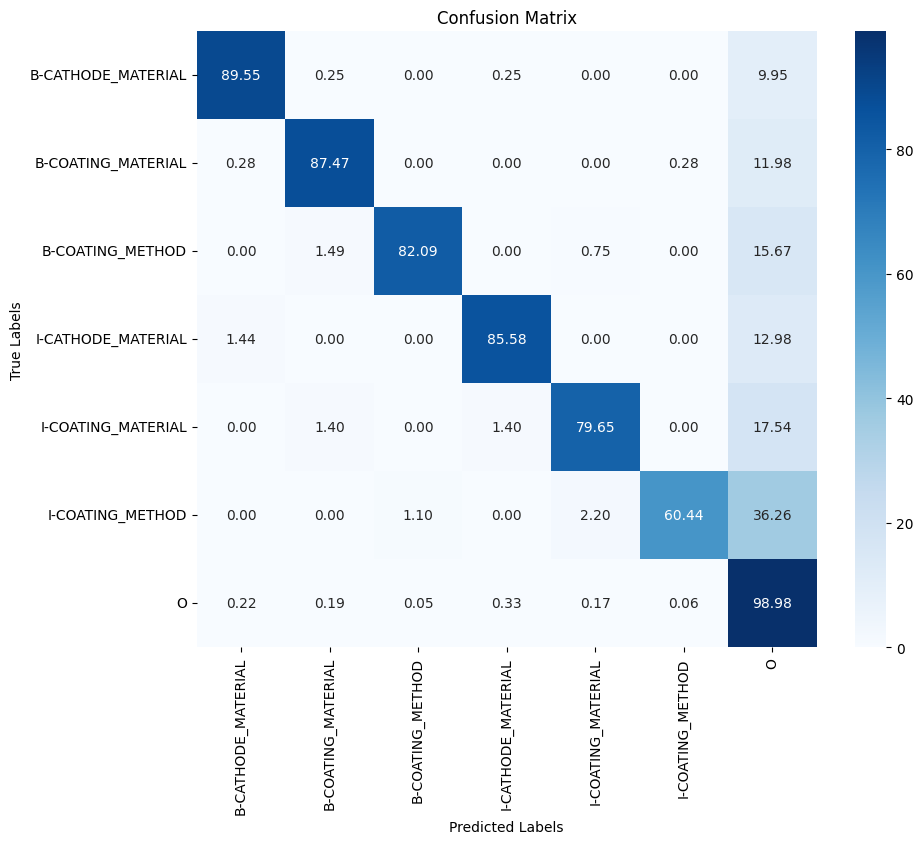

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 444ms/step - loss: 0.2595 - custom_acc_orig_tokens: 0.9226 - custom_acc_orig_non_other_tokens: 0.4343 - val_loss: 0.0608 - val_custom_acc_orig_tokens: 0.9786 - val_custom_acc_orig_non_other_tokens: 0.8248 - precision: 0.9759 - recall: 0.9796 - f1: 0.9777 - accuracy: 0.9784
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0442 - custom_acc_orig_tokens: 0.9851 - custom_acc_orig_non_other_tokens: 0.8530 - val_loss: 0.0391 - val_custom_acc_orig_tokens: 0.9870 - val_custom_acc_orig_non_other_tokens: 0.8734 - precision: 0.9860 - recall: 0.9852 - f1: 0.9856 - accuracy: 0.9866
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0246 - custom_acc_orig_tokens: 0.9920 - custom_acc_orig_non_other_tokens: 0.9214 - val_loss: 0.0382 - val_custom_acc_orig_tokens: 0.9878 - val_custom_acc_orig_non_other_tokens: 0.8820 - precision: 0.9866 - recall: 0.9865 - f1: 0.9866 - accuracy: 0.9874


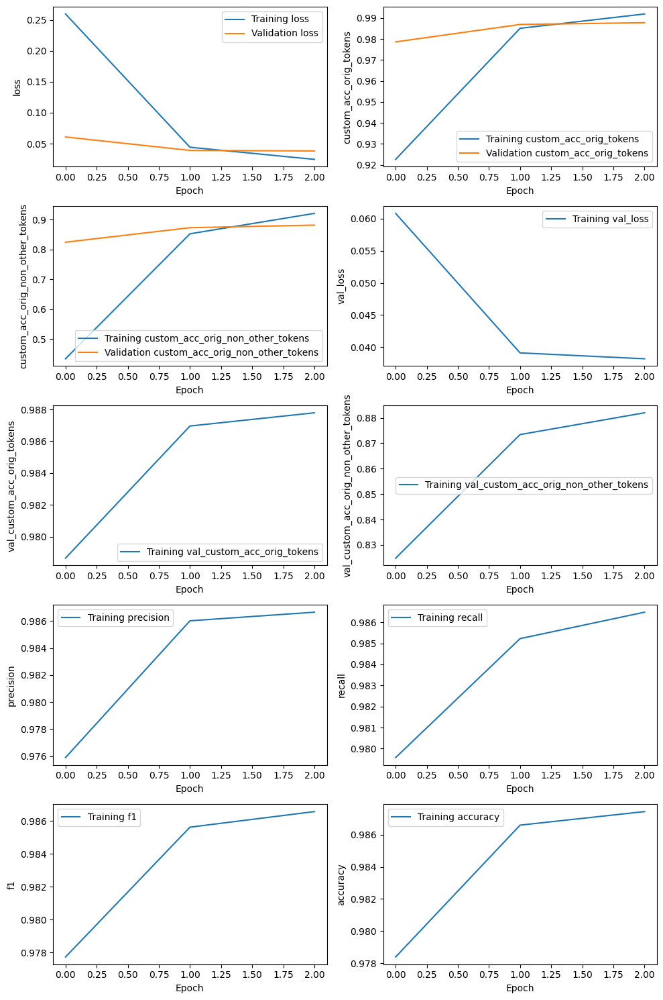

160/160 [==============================] - 23s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.783,0.824,0.803,420,,
COATING_MATERIAL,0.779,0.813,0.796,359,,
COATING_METHOD,0.769,0.746,0.758,134,,
OVERALL,0.779,0.808,0.794,,0.982,0.846


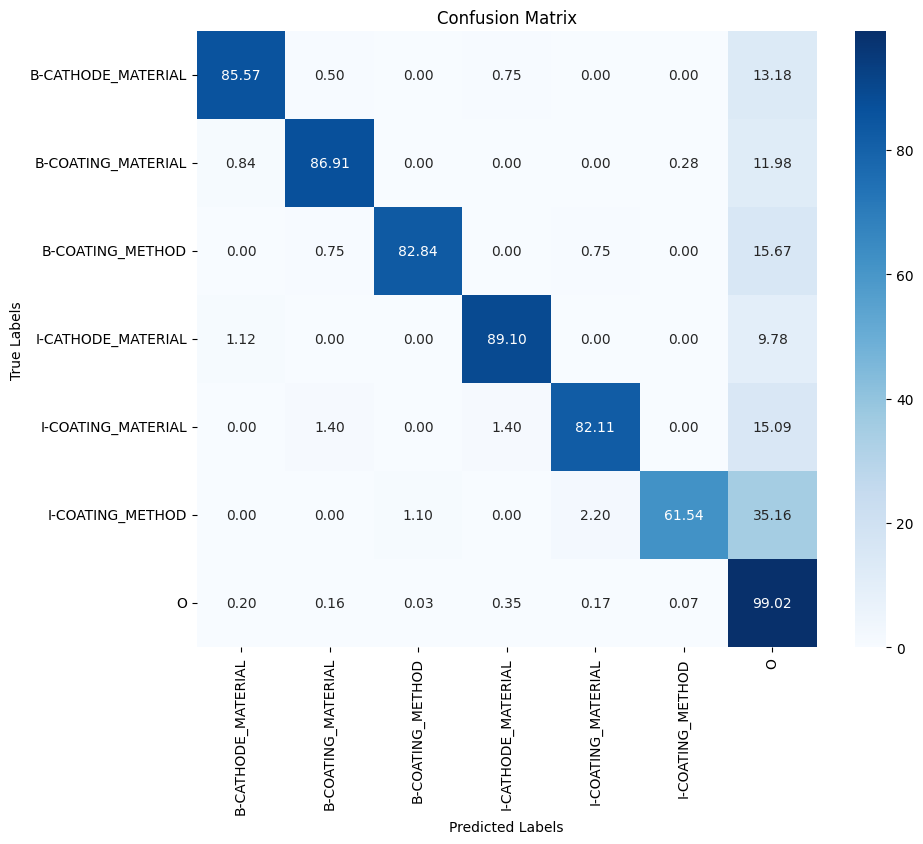

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 448ms/step - loss: 0.2335 - custom_acc_orig_tokens: 0.9299 - custom_acc_orig_non_other_tokens: 0.4572 - val_loss: 0.0555 - val_custom_acc_orig_tokens: 0.9819 - val_custom_acc_orig_non_other_tokens: 0.8545 - precision: 0.9802 - recall: 0.9817 - f1: 0.9809 - accuracy: 0.9813
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0461 - custom_acc_orig_tokens: 0.9843 - custom_acc_orig_non_other_tokens: 0.8450 - val_loss: 0.0435 - val_custom_acc_orig_tokens: 0.9849 - val_custom_acc_orig_non_other_tokens: 0.8761 - precision: 0.9853 - recall: 0.9833 - f1: 0.9843 - accuracy: 0.9844
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0250 - custom_acc_orig_tokens: 0.9917 - custom_acc_orig_non_other_tokens: 0.9184 - val_loss: 0.0359 - val_custom_acc_orig_tokens: 0.9877 - val_custom_acc_orig_non_other_tokens: 0.8940 - precision: 0.9866 - recall: 0.9861 - f1: 0.9864 - accuracy: 0.9873


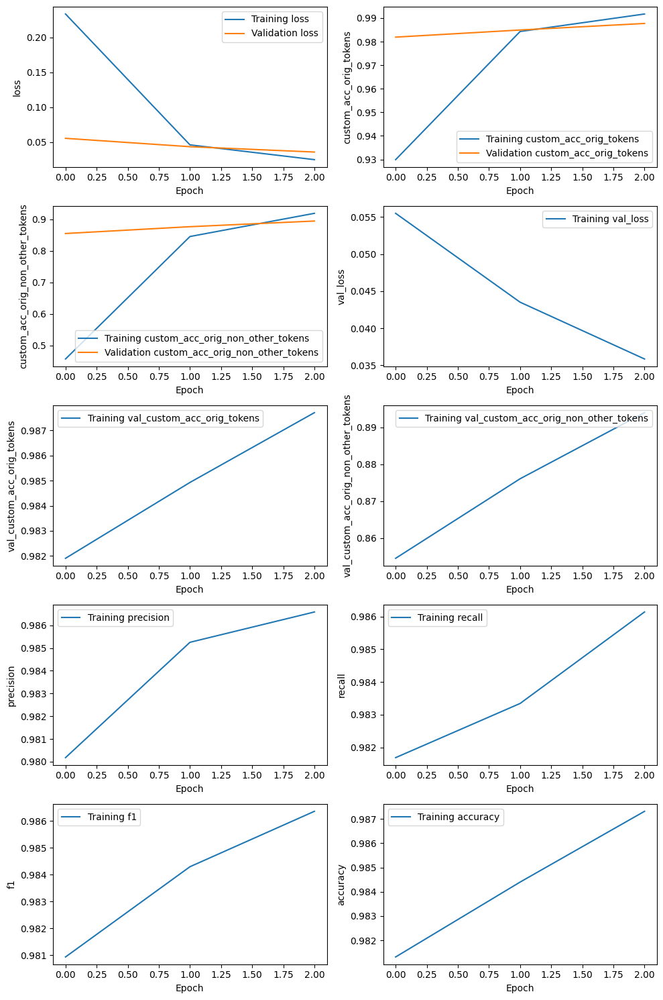

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_16_8e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.767,0.840,0.802,420,,
COATING_MATERIAL,0.725,0.808,0.764,359,,
COATING_METHOD,0.781,0.746,0.763,134,,
OVERALL,0.752,0.814,0.782,,0.981,0.842


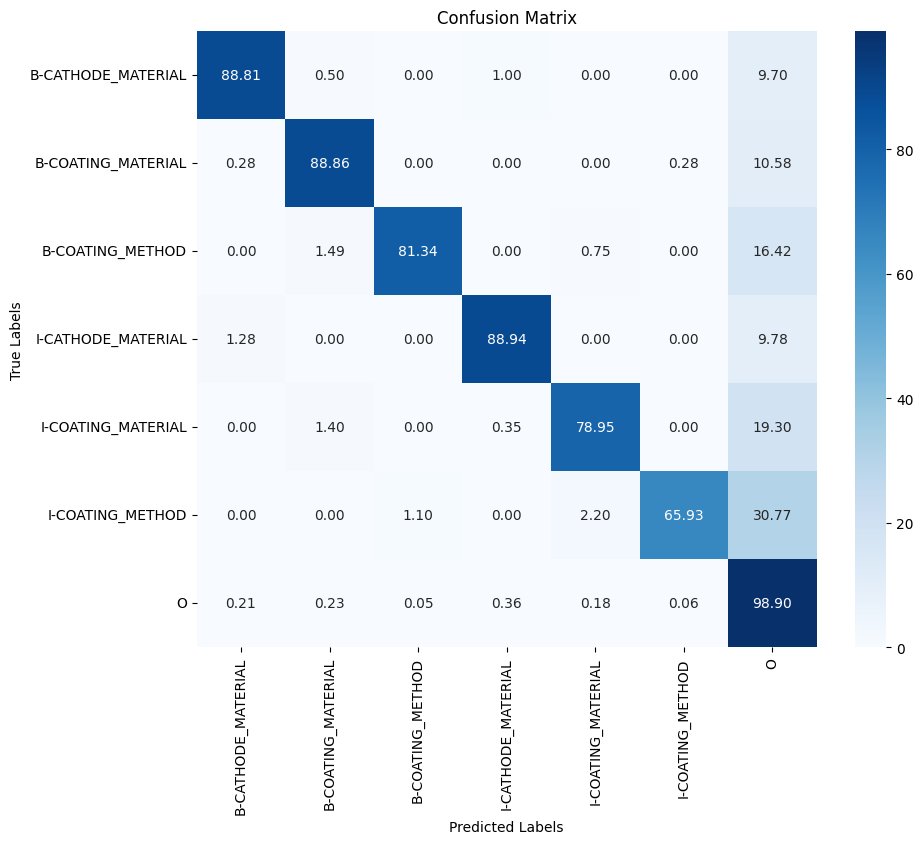

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 445ms/step - loss: 0.3359 - custom_acc_orig_tokens: 0.9032 - custom_acc_orig_non_other_tokens: 0.2009 - val_loss: 0.1016 - val_custom_acc_orig_tokens: 0.9705 - val_custom_acc_orig_non_other_tokens: 0.5419 - precision: 0.9644 - recall: 0.9710 - f1: 0.9677 - accuracy: 0.9696
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1002 - custom_acc_orig_tokens: 0.9710 - custom_acc_orig_non_other_tokens: 0.5847 - val_loss: 0.0904 - val_custom_acc_orig_tokens: 0.9749 - val_custom_acc_orig_non_other_tokens: 0.6831 - precision: 0.9710 - recall: 0.9735 - f1: 0.9723 - accuracy: 0.9742
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0955 - custom_acc_orig_tokens: 0.9726 - custom_acc_orig_non_other_tokens: 0.6148 - val_loss: 0.0904 - val_custom_acc_orig_tokens: 0.9749 - val_custom_acc_orig_non_other_tokens: 0.6831 - precision: 0.9710 - recall: 0.9735 - f1: 0.9723 - accuracy: 0.9742


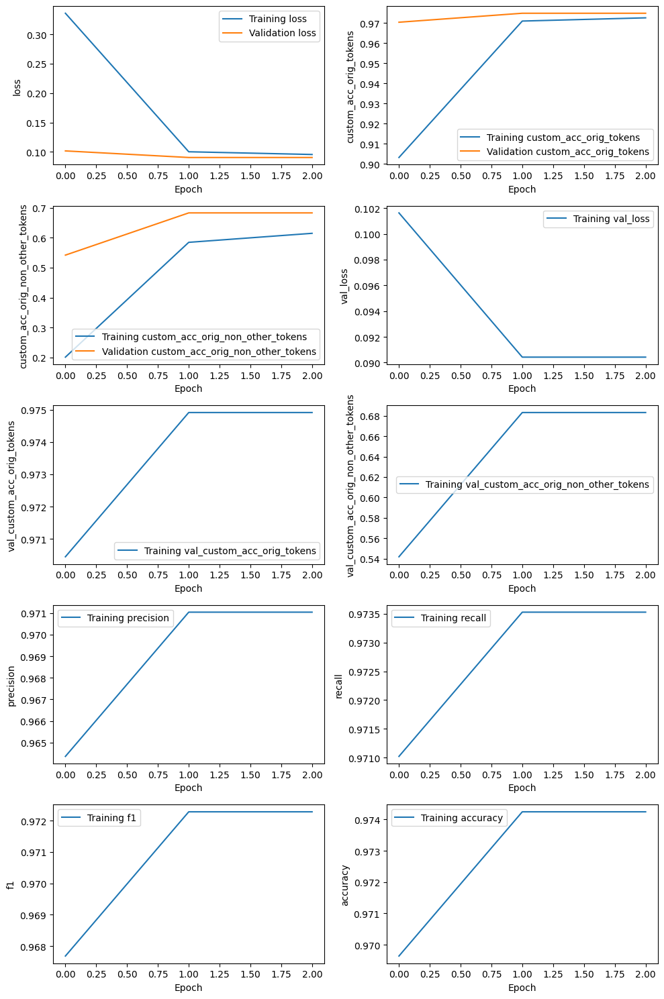

160/160 [==============================] - 27s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.638,0.698,0.667,420,,
COATING_MATERIAL,0.604,0.630,0.617,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.623,0.568,0.595,,0.968,0.705


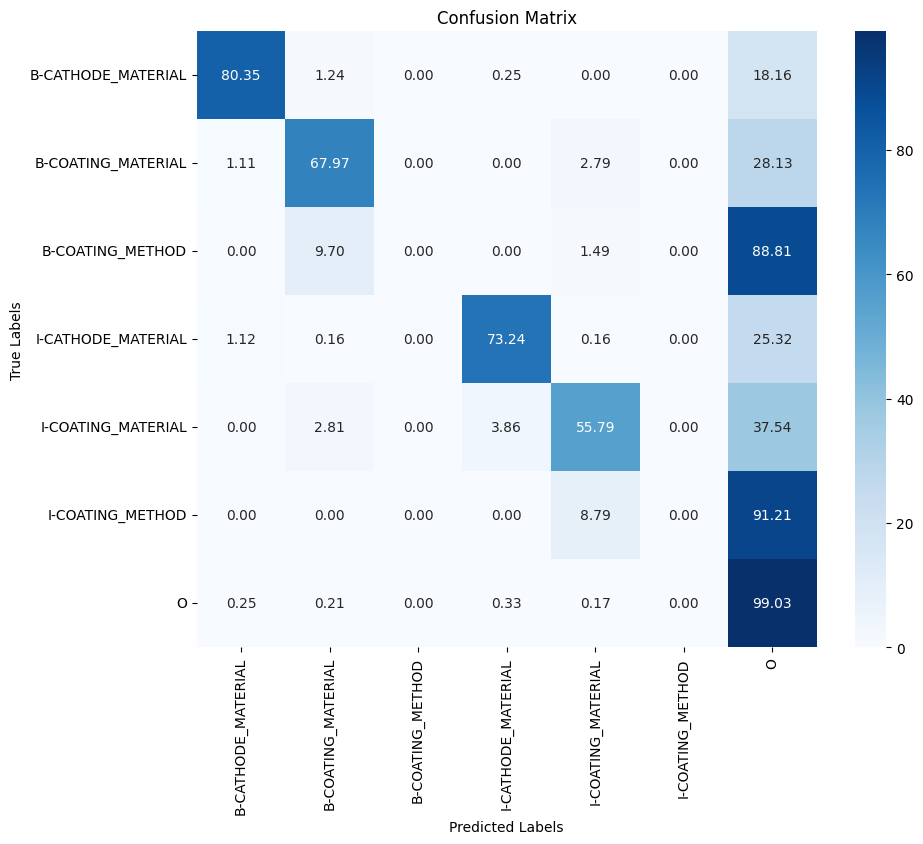

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 113s 441ms/step - loss: 0.3443 - custom_acc_orig_tokens: 0.9006 - custom_acc_orig_non_other_tokens: 0.2033 - val_loss: 0.1007 - val_custom_acc_orig_tokens: 0.9704 - val_custom_acc_orig_non_other_tokens: 0.5658 - precision: 0.9645 - recall: 0.9698 - f1: 0.9672 - accuracy: 0.9696
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0976 - custom_acc_orig_tokens: 0.9718 - custom_acc_orig_non_other_tokens: 0.6072 - val_loss: 0.0894 - val_custom_acc_orig_tokens: 0.9743 - val_custom_acc_orig_non_other_tokens: 0.7023 - precision: 0.9702 - recall: 0.9720 - f1: 0.9711 - accuracy: 0.9735
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0946 - custom_acc_orig_tokens: 0.9732 - custom_acc_orig_non_other_tokens: 0.6435 - val_loss: 0.0894 - val_custom_acc_orig_tokens: 0.9743 - val_custom_acc_orig_non_other_tokens: 0.7023 - precision: 0.9702 - recall: 0.9720 - f1: 0.9711 - accuracy: 0.9735


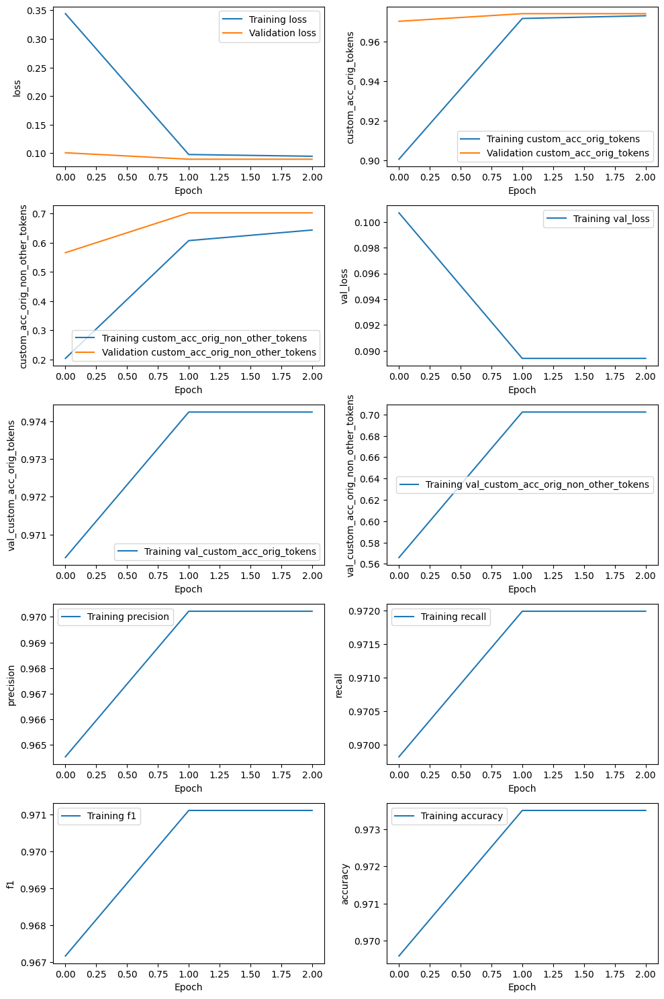

160/160 [==============================] - 23s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.652,0.729,0.688,420,,
COATING_MATERIAL,0.564,0.677,0.615,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.610,0.601,0.606,,0.968,0.714


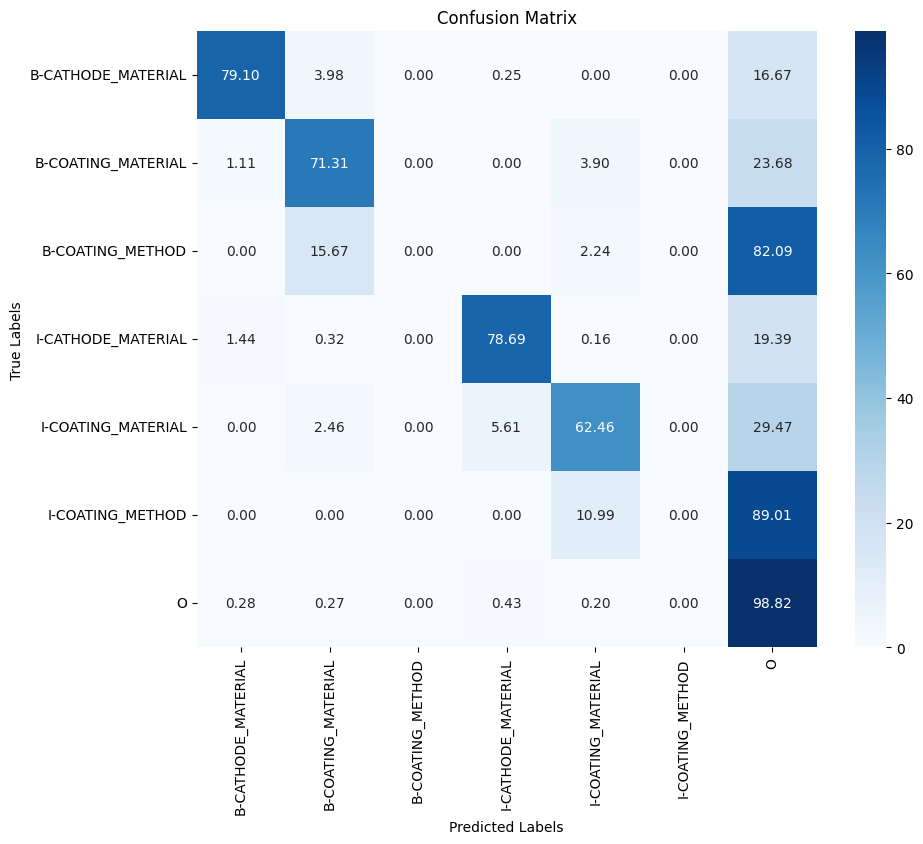

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 445ms/step - loss: 0.3139 - custom_acc_orig_tokens: 0.9081 - custom_acc_orig_non_other_tokens: 0.2026 - val_loss: 0.1053 - val_custom_acc_orig_tokens: 0.9681 - val_custom_acc_orig_non_other_tokens: 0.4864 - precision: 0.9612 - recall: 0.9689 - f1: 0.9650 - accuracy: 0.9675
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.1027 - custom_acc_orig_tokens: 0.9700 - custom_acc_orig_non_other_tokens: 0.5638 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9732 - val_custom_acc_orig_non_other_tokens: 0.6543 - precision: 0.9684 - recall: 0.9708 - f1: 0.9696 - accuracy: 0.9724
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0983 - custom_acc_orig_tokens: 0.9712 - custom_acc_orig_non_other_tokens: 0.5941 - val_loss: 0.0931 - val_custom_acc_orig_tokens: 0.9732 - val_custom_acc_orig_non_other_tokens: 0.6543 - precision: 0.9684 - recall: 0.9708 - f1: 0.9696 - accuracy: 0.9724


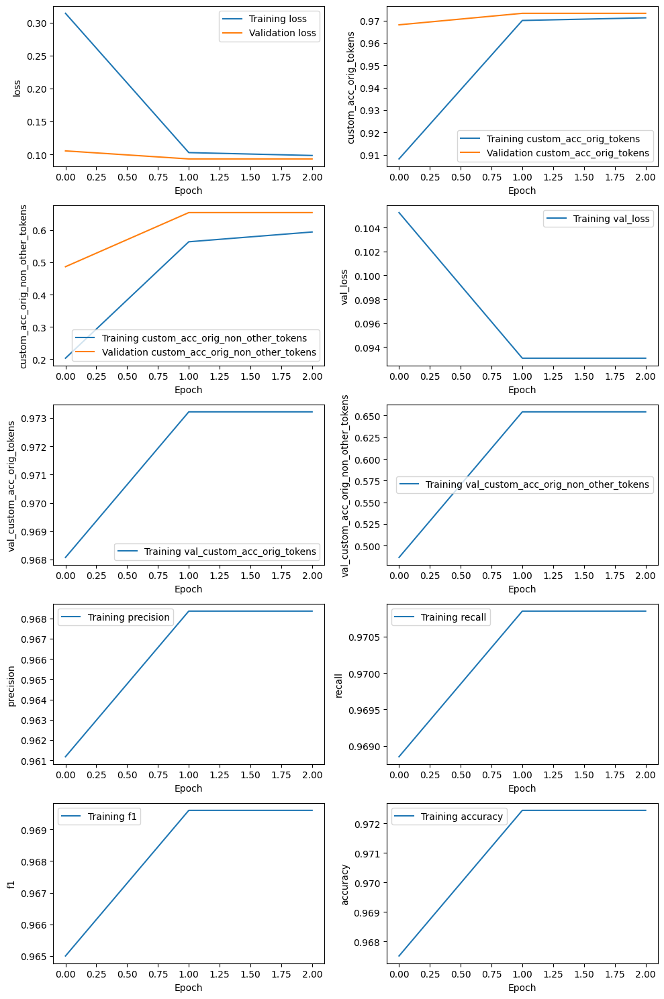

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 89ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_2e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.595,0.686,0.637,420,,
COATING_MATERIAL,0.540,0.618,0.577,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.570,0.559,0.564,,0.967,0.698


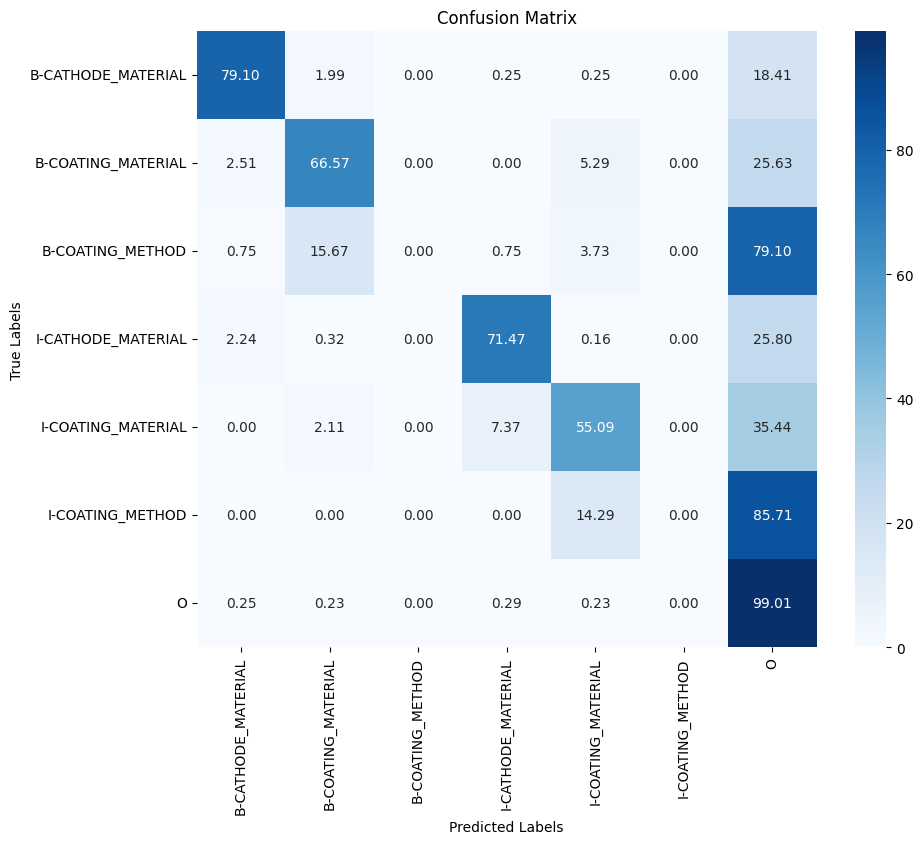

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 464ms/step - loss: 0.2434 - custom_acc_orig_tokens: 0.9290 - custom_acc_orig_non_other_tokens: 0.4059 - val_loss: 0.0590 - val_custom_acc_orig_tokens: 0.9814 - val_custom_acc_orig_non_other_tokens: 0.8040 - precision: 0.9789 - recall: 0.9805 - f1: 0.9797 - accuracy: 0.9808
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0542 - custom_acc_orig_tokens: 0.9825 - custom_acc_orig_non_other_tokens: 0.8100 - val_loss: 0.0537 - val_custom_acc_orig_tokens: 0.9816 - val_custom_acc_orig_non_other_tokens: 0.8346 - precision: 0.9799 - recall: 0.9801 - f1: 0.9800 - accuracy: 0.9810
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0497 - custom_acc_orig_tokens: 0.9839 - custom_acc_orig_non_other_tokens: 0.8293 - val_loss: 0.0537 - val_custom_acc_orig_tokens: 0.9816 - val_custom_acc_orig_non_other_tokens: 0.8346 - precision: 0.9799 - recall: 0.9801 - f1: 0.9800 - accuracy: 0.9810


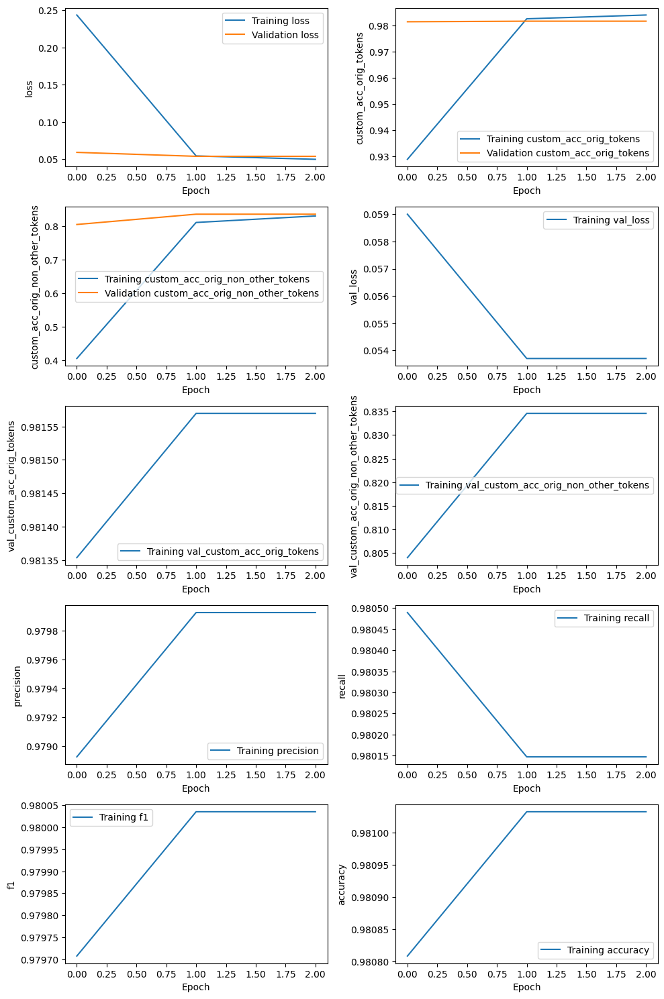

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.713,0.838,0.770,420,,
COATING_MATERIAL,0.676,0.769,0.720,359,,
COATING_METHOD,0.653,0.590,0.620,134,,
OVERALL,0.691,0.774,0.730,,0.976,0.800


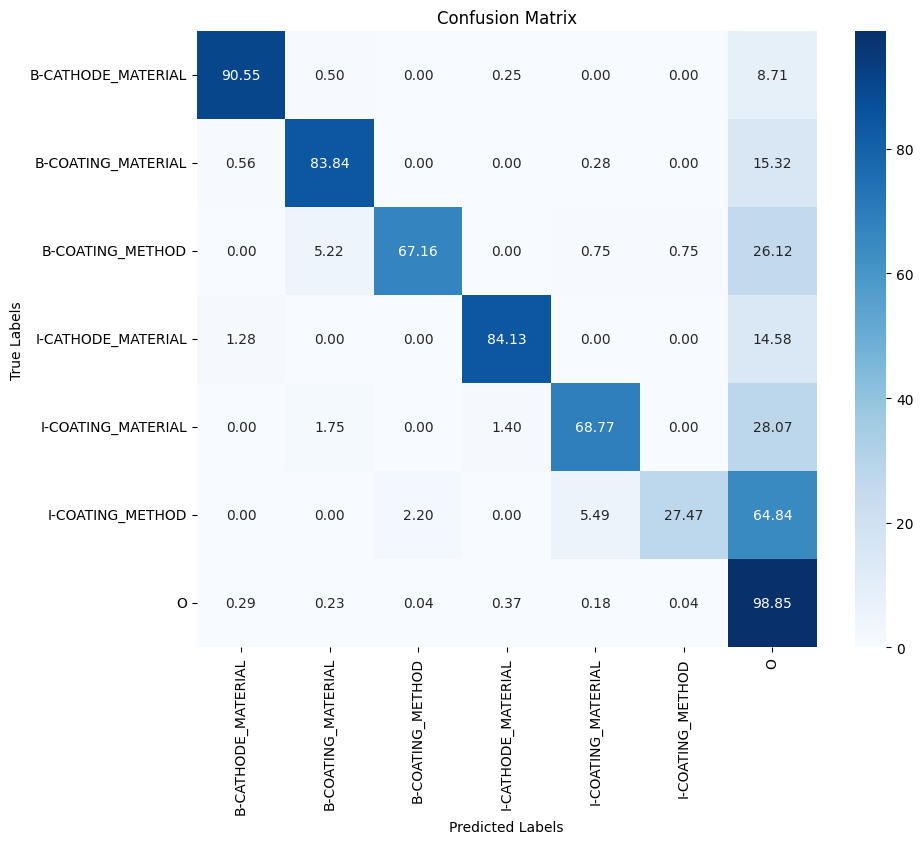

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 448ms/step - loss: 0.2578 - custom_acc_orig_tokens: 0.9245 - custom_acc_orig_non_other_tokens: 0.3862 - val_loss: 0.0636 - val_custom_acc_orig_tokens: 0.9798 - val_custom_acc_orig_non_other_tokens: 0.7804 - precision: 0.9769 - recall: 0.9788 - f1: 0.9778 - accuracy: 0.9792
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0587 - custom_acc_orig_tokens: 0.9808 - custom_acc_orig_non_other_tokens: 0.7863 - val_loss: 0.0577 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.8273 - precision: 0.9791 - recall: 0.9796 - f1: 0.9794 - accuracy: 0.9808
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0544 - custom_acc_orig_tokens: 0.9823 - custom_acc_orig_non_other_tokens: 0.8131 - val_loss: 0.0577 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.8273 - precision: 0.9791 - recall: 0.9796 - f1: 0.9794 - accuracy: 0.9808


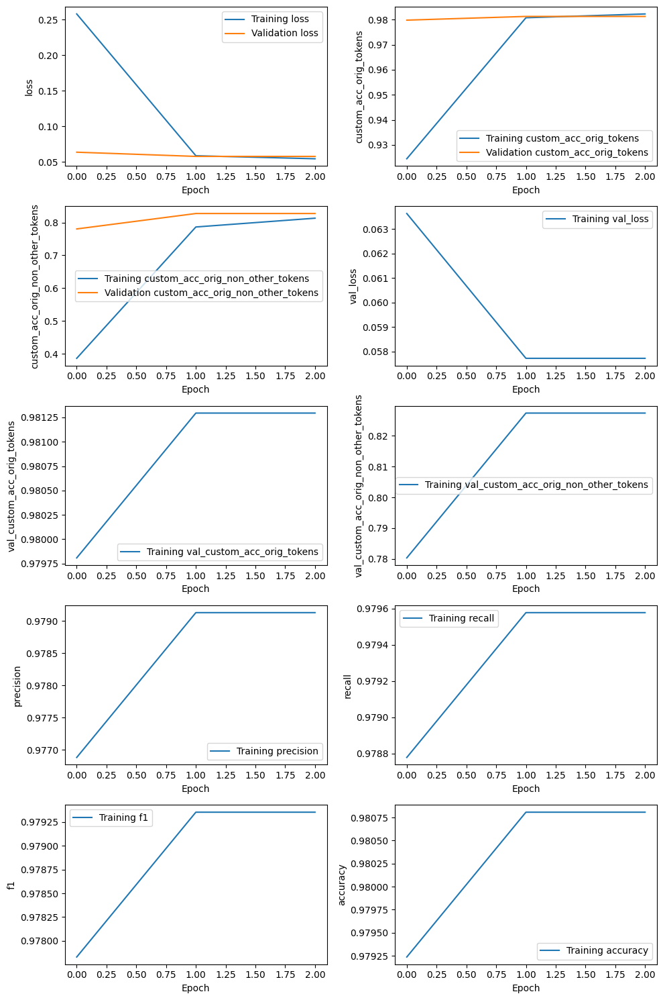

160/160 [==============================] - 27s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.678,0.807,0.737,420,,
COATING_MATERIAL,0.620,0.772,0.687,359,,
COATING_METHOD,0.807,0.530,0.640,134,,
OVERALL,0.664,0.752,0.705,,0.973,0.774


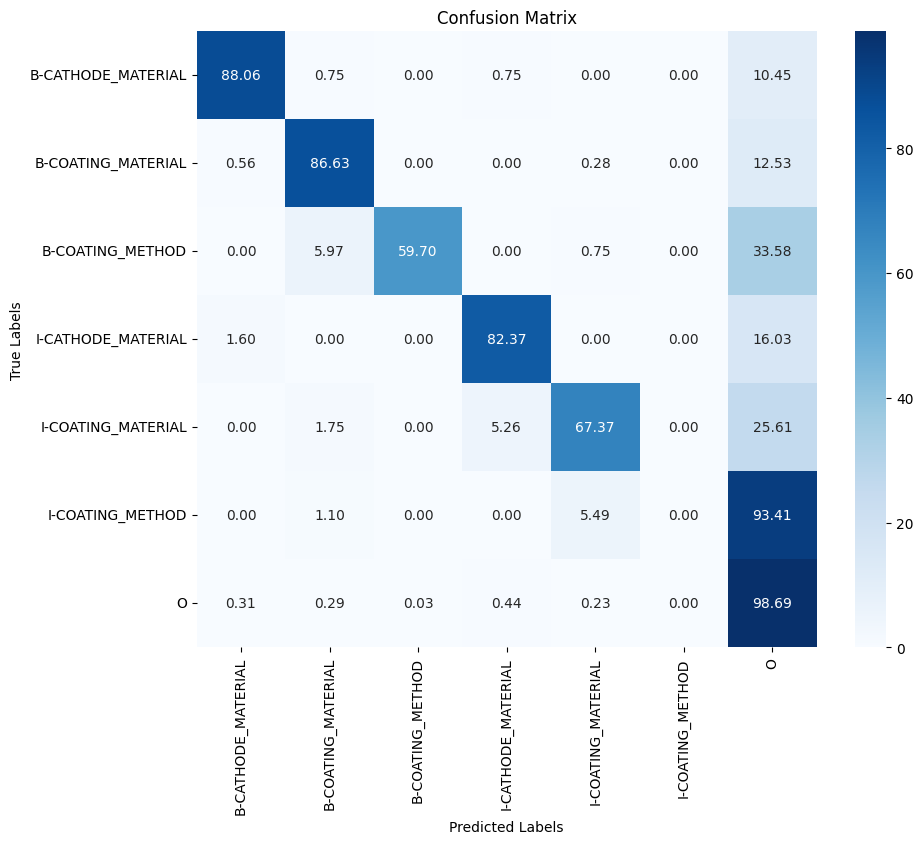

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 113s 442ms/step - loss: 0.2340 - custom_acc_orig_tokens: 0.9311 - custom_acc_orig_non_other_tokens: 0.4014 - val_loss: 0.0618 - val_custom_acc_orig_tokens: 0.9812 - val_custom_acc_orig_non_other_tokens: 0.7848 - precision: 0.9780 - recall: 0.9810 - f1: 0.9795 - accuracy: 0.9806
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0581 - custom_acc_orig_tokens: 0.9819 - custom_acc_orig_non_other_tokens: 0.7924 - val_loss: 0.0570 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.8219 - precision: 0.9794 - recall: 0.9796 - f1: 0.9795 - accuracy: 0.9808
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0534 - custom_acc_orig_tokens: 0.9833 - custom_acc_orig_non_other_tokens: 0.8199 - val_loss: 0.0570 - val_custom_acc_orig_tokens: 0.9813 - val_custom_acc_orig_non_other_tokens: 0.8219 - precision: 0.9794 - recall: 0.9796 - f1: 0.9795 - accuracy: 0.9808


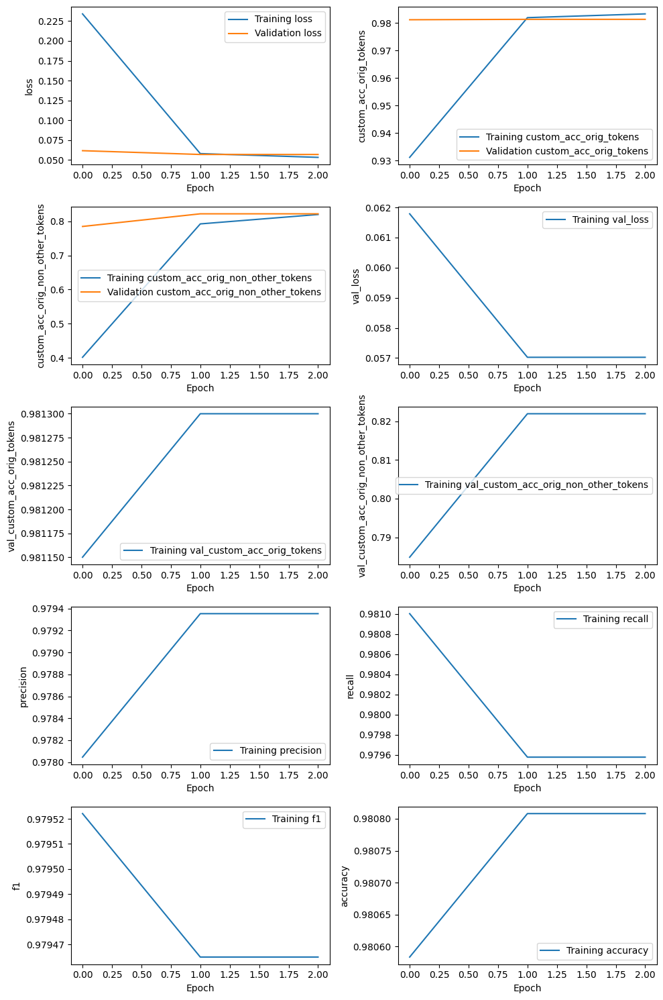

160/160 [==============================] - 24s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_5e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.690,0.833,0.755,420,,
COATING_MATERIAL,0.610,0.780,0.685,359,,
COATING_METHOD,0.768,0.545,0.638,134,,
OVERALL,0.663,0.770,0.712,,0.974,0.782


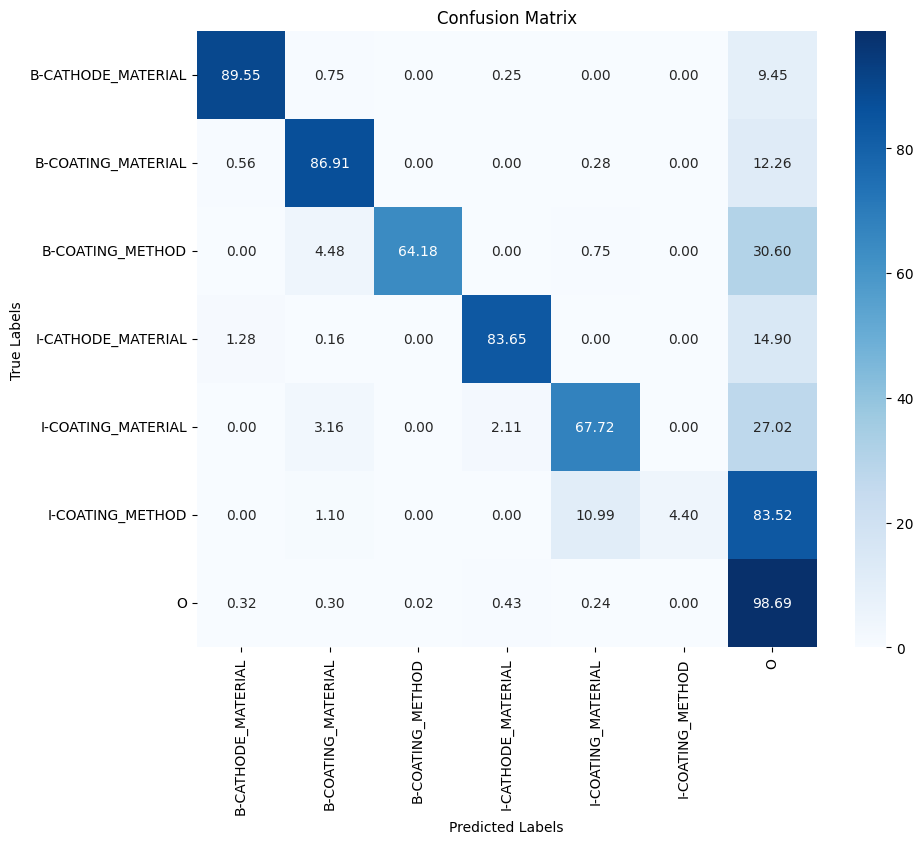

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 452ms/step - loss: 0.2110 - custom_acc_orig_tokens: 0.9378 - custom_acc_orig_non_other_tokens: 0.4857 - val_loss: 0.0527 - val_custom_acc_orig_tokens: 0.9832 - val_custom_acc_orig_non_other_tokens: 0.8421 - precision: 0.9814 - recall: 0.9825 - f1: 0.9820 - accuracy: 0.9827
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0442 - custom_acc_orig_tokens: 0.9849 - custom_acc_orig_non_other_tokens: 0.8546 - val_loss: 0.0483 - val_custom_acc_orig_tokens: 0.9832 - val_custom_acc_orig_non_other_tokens: 0.8651 - precision: 0.9821 - recall: 0.9807 - f1: 0.9814 - accuracy: 0.9827
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0397 - custom_acc_orig_tokens: 0.9868 - custom_acc_orig_non_other_tokens: 0.8832 - val_loss: 0.0483 - val_custom_acc_orig_tokens: 0.9832 - val_custom_acc_orig_non_other_tokens: 0.8651 - precision: 0.9821 - recall: 0.9807 - f1: 0.9814 - accuracy: 0.9827


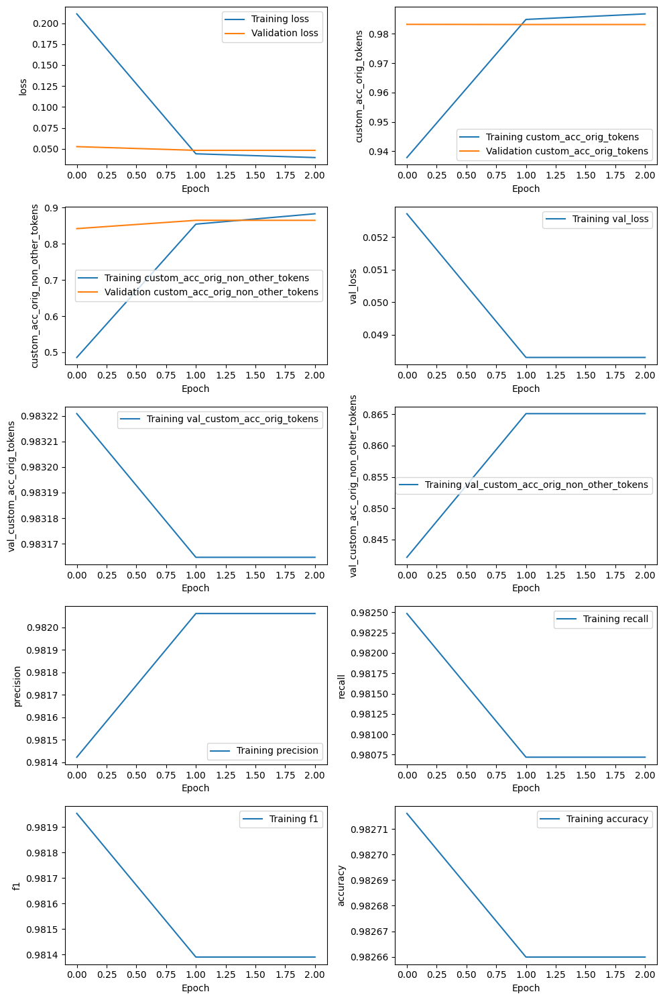

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.717,0.840,0.774,420,,
COATING_MATERIAL,0.663,0.794,0.722,359,,
COATING_METHOD,0.683,0.709,0.696,134,,
OVERALL,0.691,0.803,0.743,,0.978,0.817


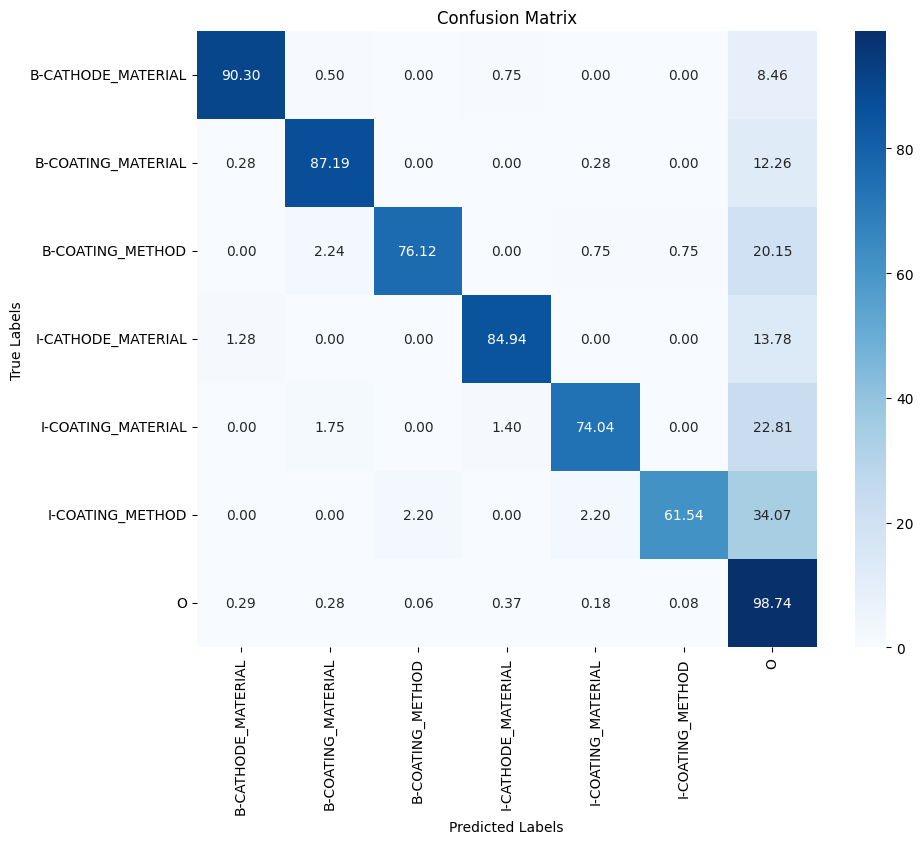

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 115s 447ms/step - loss: 0.2343 - custom_acc_orig_tokens: 0.9327 - custom_acc_orig_non_other_tokens: 0.4278 - val_loss: 0.0558 - val_custom_acc_orig_tokens: 0.9815 - val_custom_acc_orig_non_other_tokens: 0.8226 - precision: 0.9795 - recall: 0.9811 - f1: 0.9803 - accuracy: 0.9810
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0506 - custom_acc_orig_tokens: 0.9830 - custom_acc_orig_non_other_tokens: 0.8325 - val_loss: 0.0498 - val_custom_acc_orig_tokens: 0.9823 - val_custom_acc_orig_non_other_tokens: 0.8694 - precision: 0.9811 - recall: 0.9797 - f1: 0.9804 - accuracy: 0.9818
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0455 - custom_acc_orig_tokens: 0.9847 - custom_acc_orig_non_other_tokens: 0.8590 - val_loss: 0.0498 - val_custom_acc_orig_tokens: 0.9823 - val_custom_acc_orig_non_other_tokens: 0.8694 - precision: 0.9811 - recall: 0.9797 - f1: 0.9804 - accuracy: 0.9818


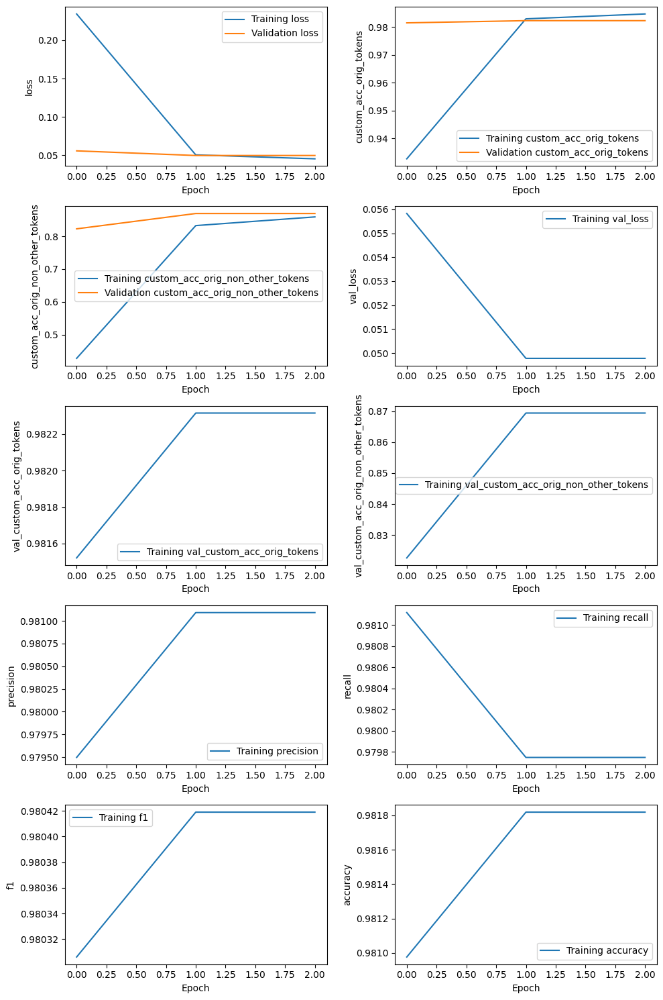

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r2_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.682,0.831,0.749,420,,
COATING_MATERIAL,0.621,0.799,0.699,359,,
COATING_METHOD,0.689,0.612,0.648,134,,
OVERALL,0.657,0.786,0.716,,0.975,0.795


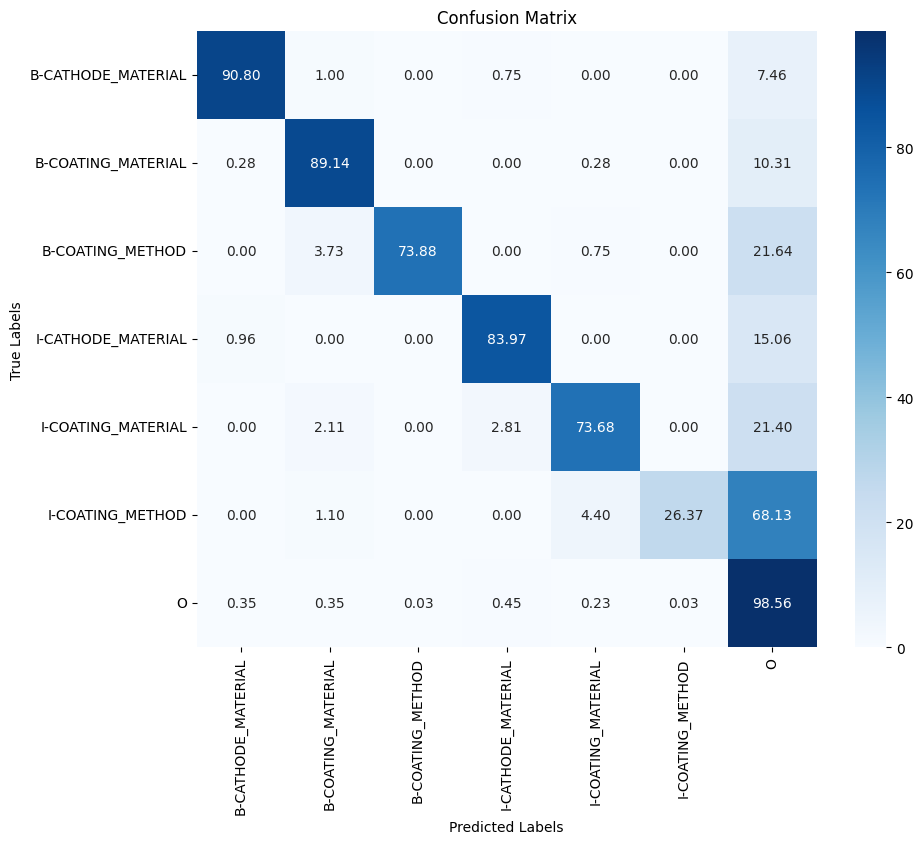

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 447ms/step - loss: 0.2140 - custom_acc_orig_tokens: 0.9374 - custom_acc_orig_non_other_tokens: 0.4498 - val_loss: 0.0539 - val_custom_acc_orig_tokens: 0.9822 - val_custom_acc_orig_non_other_tokens: 0.8114 - precision: 0.9794 - recall: 0.9825 - f1: 0.9809 - accuracy: 0.9816
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0485 - custom_acc_orig_tokens: 0.9843 - custom_acc_orig_non_other_tokens: 0.8370 - val_loss: 0.0499 - val_custom_acc_orig_tokens: 0.9835 - val_custom_acc_orig_non_other_tokens: 0.8592 - precision: 0.9823 - recall: 0.9812 - f1: 0.9817 - accuracy: 0.9831
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0435 - custom_acc_orig_tokens: 0.9863 - custom_acc_orig_non_other_tokens: 0.8674 - val_loss: 0.0499 - val_custom_acc_orig_tokens: 0.9835 - val_custom_acc_orig_non_other_tokens: 0.8592 - precision: 0.9823 - recall: 0.9812 - f1: 0.9817 - accuracy: 0.9831


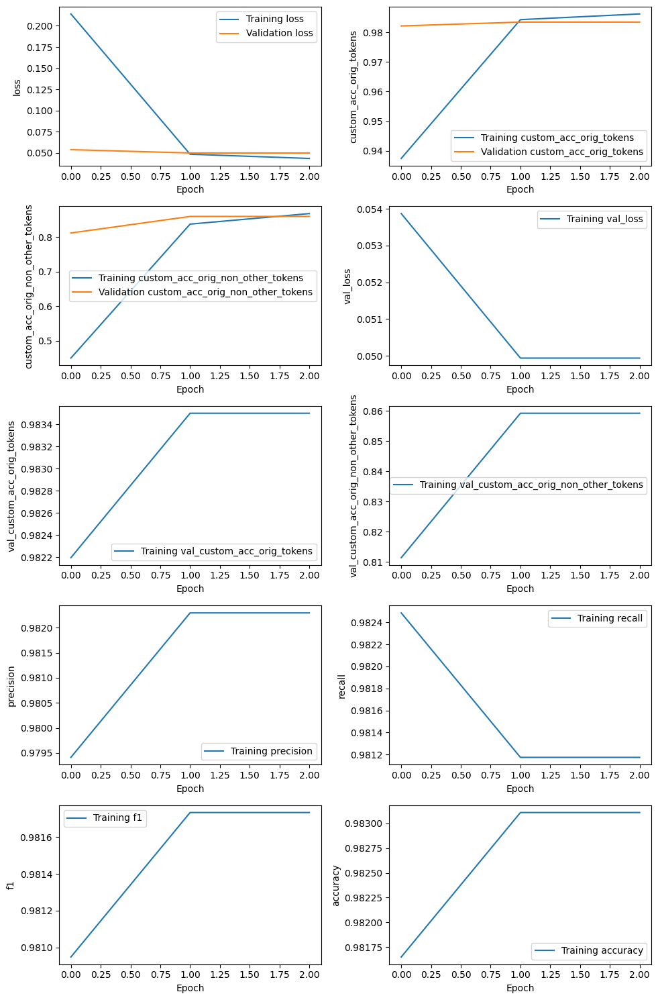

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 89ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_32_8e-05_r3_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.725,0.843,0.780,420,,
COATING_MATERIAL,0.631,0.799,0.705,359,,
COATING_METHOD,0.654,0.634,0.644,134,,
OVERALL,0.677,0.795,0.731,,0.977,0.810


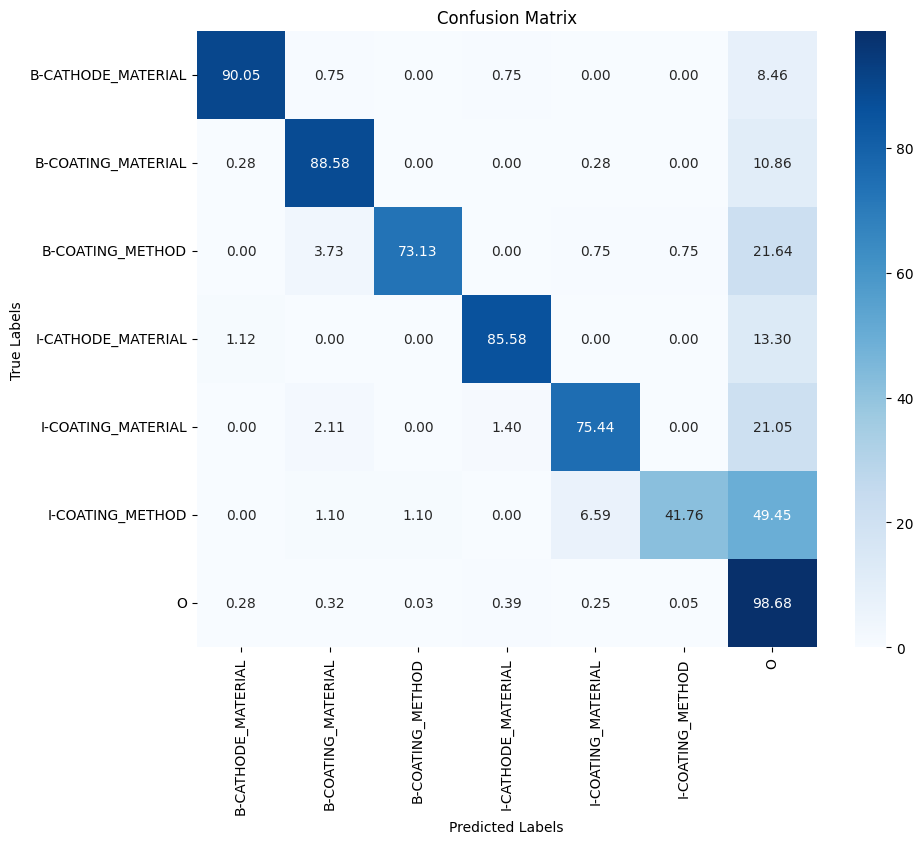

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 465ms/step - loss: 0.3152 - custom_acc_orig_tokens: 0.9125 - custom_acc_orig_non_other_tokens: 0.1057 - val_loss: 0.1541 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2404 - precision: 0.9470 - recall: 0.9594 - f1: 0.9532 - accuracy: 0.9556
Epoch 2/3
160/160 [==============================] - 42s 259ms/step - loss: 0.1651 - custom_acc_orig_tokens: 0.9526 - custom_acc_orig_non_other_tokens: 0.1833 - val_loss: 0.1541 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2404 - precision: 0.9470 - recall: 0.9594 - f1: 0.9532 - accuracy: 0.9556
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1647 - custom_acc_orig_tokens: 0.9529 - custom_acc_orig_non_other_tokens: 0.1867 - val_loss: 0.1541 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2404 - precision: 0.9470 - recall: 0.9594 - f1: 0.9532 - accuracy: 0.9556


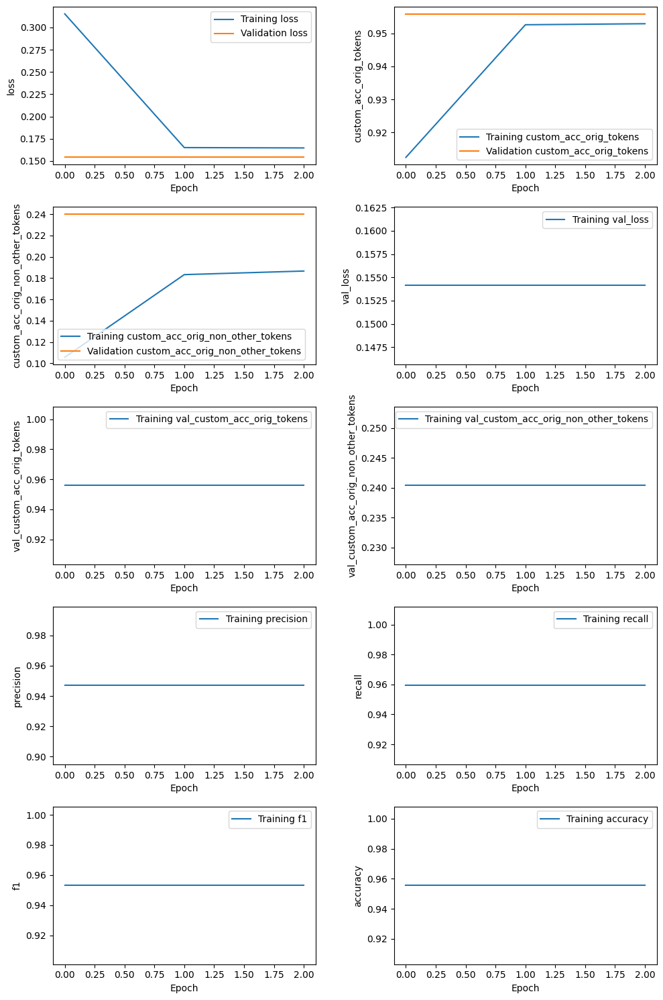

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.331,0.100,0.154,420,,
COATING_MATERIAL,0.407,0.123,0.188,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.366,0.094,0.150,,0.949,0.413


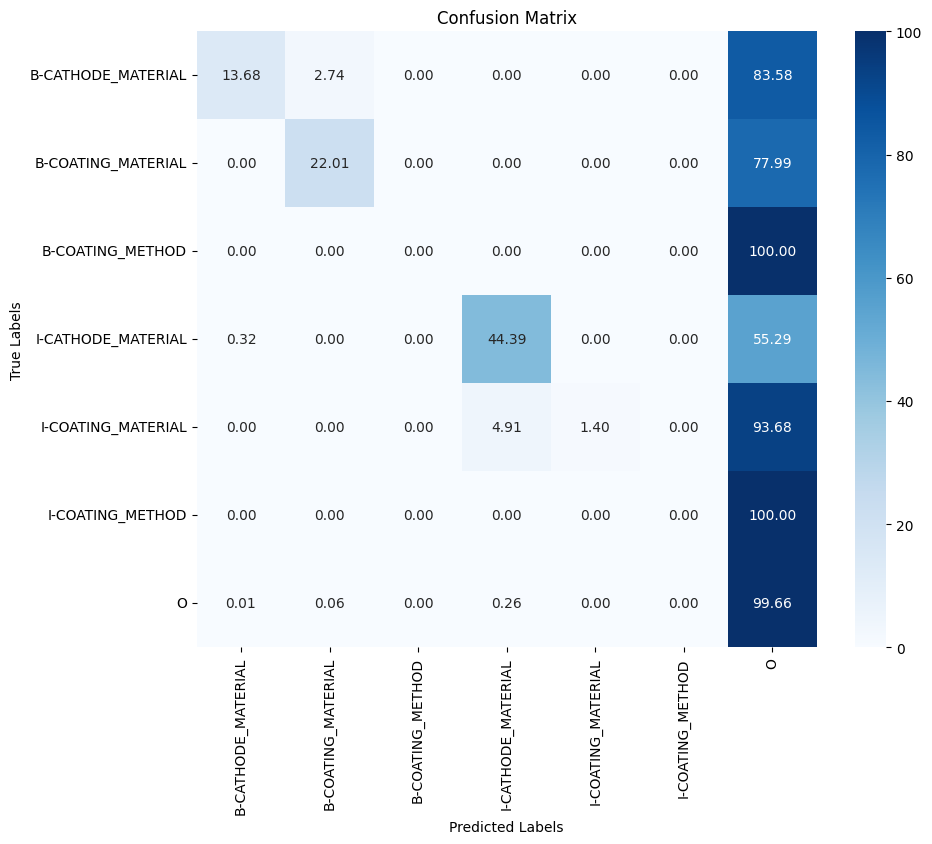

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 117s 447ms/step - loss: 0.3237 - custom_acc_orig_tokens: 0.9092 - custom_acc_orig_non_other_tokens: 0.1044 - val_loss: 0.1598 - val_custom_acc_orig_tokens: 0.9533 - val_custom_acc_orig_non_other_tokens: 0.1871 - precision: 0.9438 - recall: 0.9584 - f1: 0.9511 - accuracy: 0.9533
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.1672 - custom_acc_orig_tokens: 0.9514 - custom_acc_orig_non_other_tokens: 0.1578 - val_loss: 0.1598 - val_custom_acc_orig_tokens: 0.9533 - val_custom_acc_orig_non_other_tokens: 0.1871 - precision: 0.9438 - recall: 0.9584 - f1: 0.9511 - accuracy: 0.9533
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.1680 - custom_acc_orig_tokens: 0.9514 - custom_acc_orig_non_other_tokens: 0.1586 - val_loss: 0.1598 - val_custom_acc_orig_tokens: 0.9533 - val_custom_acc_orig_non_other_tokens: 0.1871 - precision: 0.9438 - recall: 0.9584 - f1: 0.9511 - accuracy: 0.9533


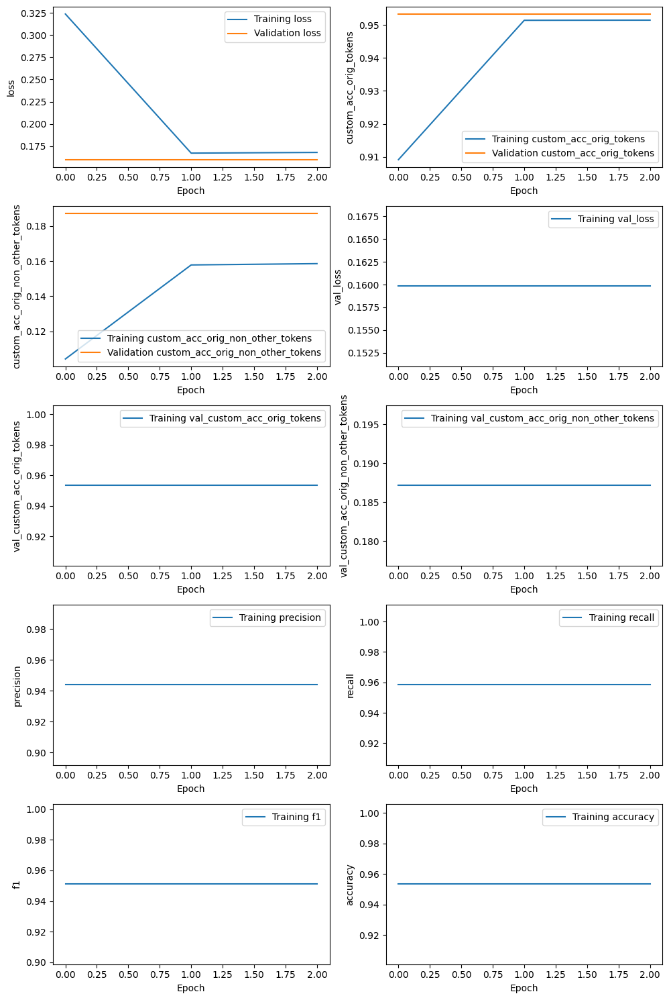

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.296,0.076,0.121,420,,
COATING_MATERIAL,0.442,0.053,0.095,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.338,0.056,0.096,,0.947,0.380


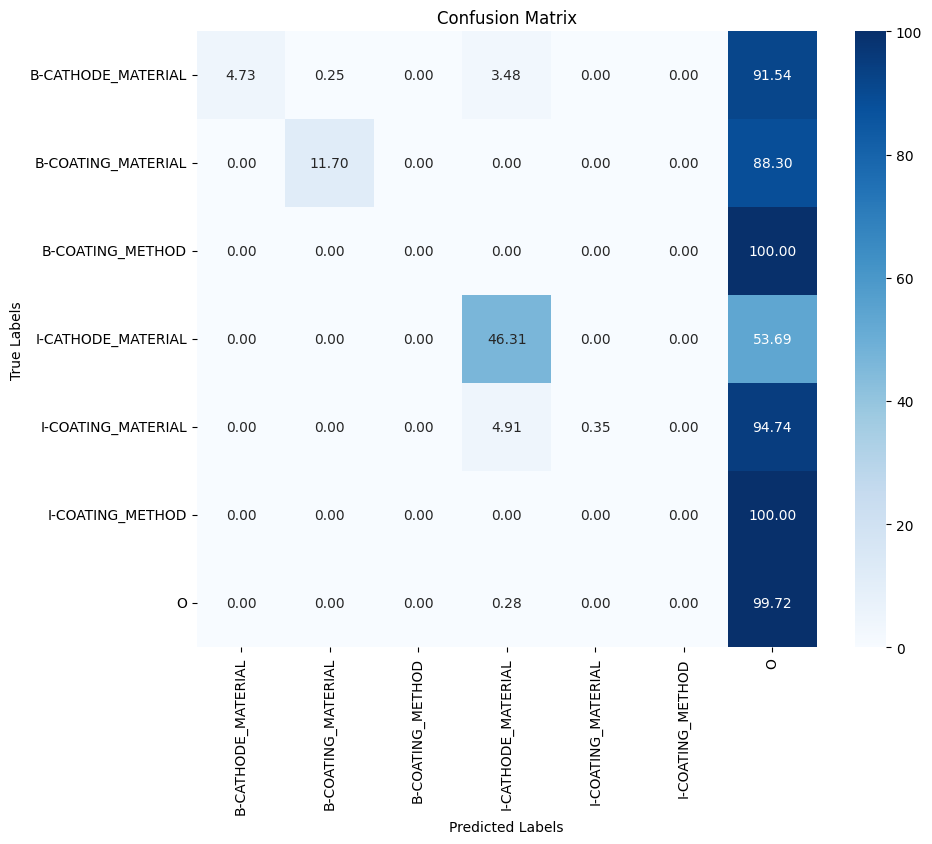

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 113s 447ms/step - loss: 0.3002 - custom_acc_orig_tokens: 0.9160 - custom_acc_orig_non_other_tokens: 0.1172 - val_loss: 0.1585 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2255 - precision: 0.9463 - recall: 0.9602 - f1: 0.9532 - accuracy: 0.9560
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1679 - custom_acc_orig_tokens: 0.9526 - custom_acc_orig_non_other_tokens: 0.1819 - val_loss: 0.1585 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2255 - precision: 0.9463 - recall: 0.9602 - f1: 0.9532 - accuracy: 0.9560
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1679 - custom_acc_orig_tokens: 0.9528 - custom_acc_orig_non_other_tokens: 0.1827 - val_loss: 0.1585 - val_custom_acc_orig_tokens: 0.9559 - val_custom_acc_orig_non_other_tokens: 0.2255 - precision: 0.9463 - recall: 0.9602 - f1: 0.9532 - accuracy: 0.9560


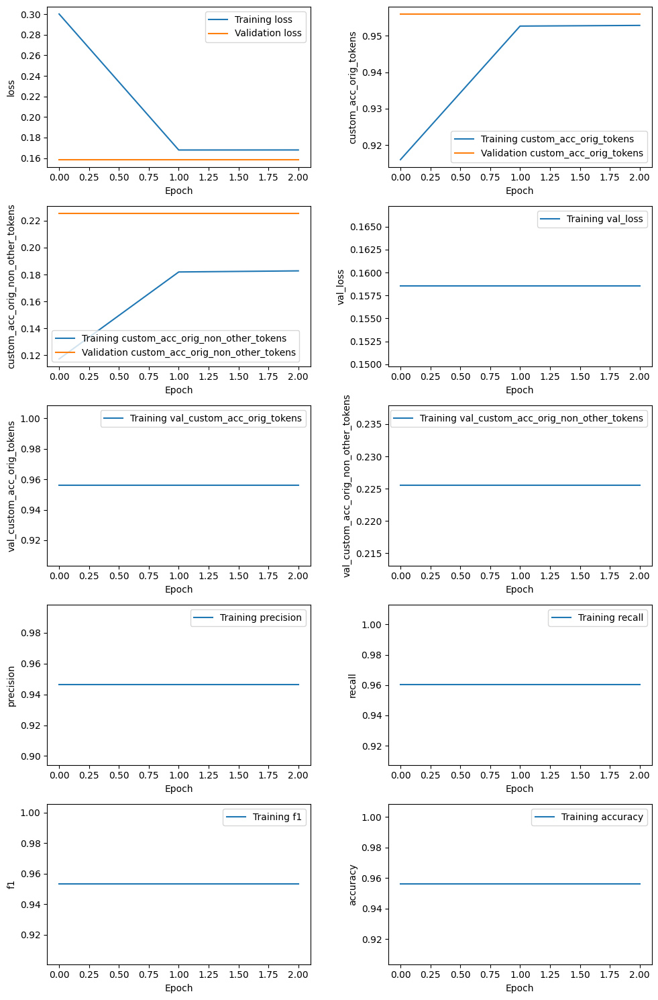

160/160 [==============================] - 23s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_2e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.425,0.129,0.197,420,,
COATING_MATERIAL,0.434,0.064,0.112,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.428,0.084,0.141,,0.948,0.403


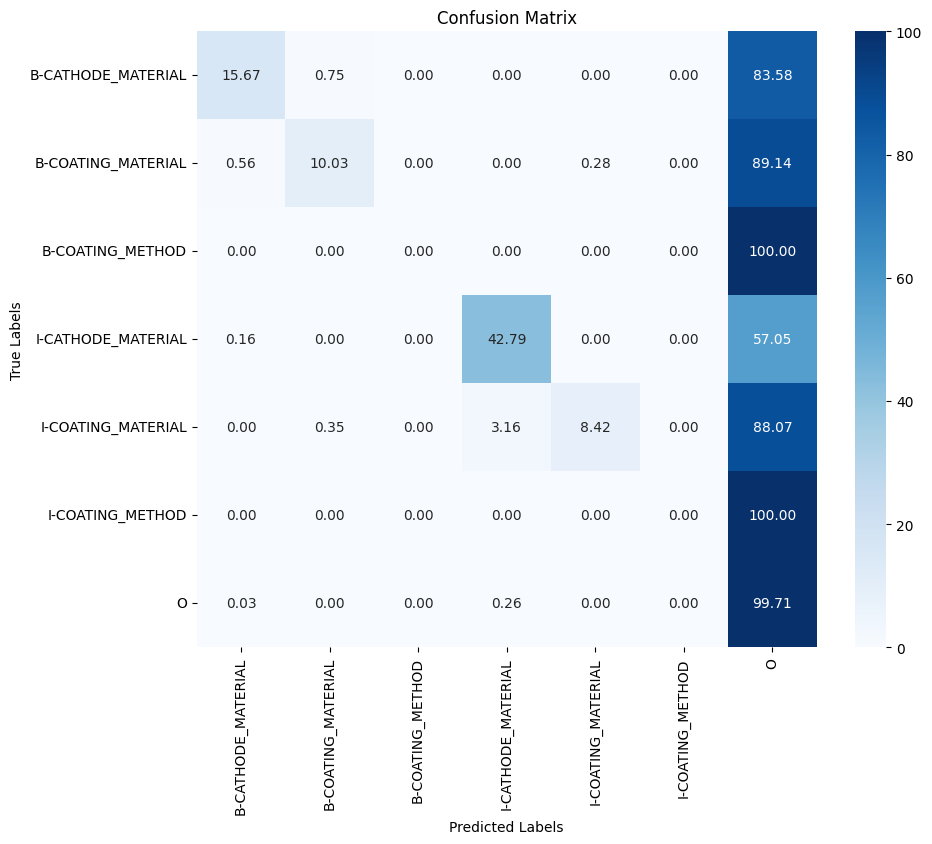

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 444ms/step - loss: 0.2254 - custom_acc_orig_tokens: 0.9358 - custom_acc_orig_non_other_tokens: 0.3861 - val_loss: 0.0891 - val_custom_acc_orig_tokens: 0.9728 - val_custom_acc_orig_non_other_tokens: 0.6707 - precision: 0.9689 - recall: 0.9707 - f1: 0.9698 - accuracy: 0.9721
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0951 - custom_acc_orig_tokens: 0.9710 - custom_acc_orig_non_other_tokens: 0.6091 - val_loss: 0.0891 - val_custom_acc_orig_tokens: 0.9728 - val_custom_acc_orig_non_other_tokens: 0.6707 - precision: 0.9689 - recall: 0.9707 - f1: 0.9698 - accuracy: 0.9721
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.0948 - custom_acc_orig_tokens: 0.9711 - custom_acc_orig_non_other_tokens: 0.6090 - val_loss: 0.0891 - val_custom_acc_orig_tokens: 0.9728 - val_custom_acc_orig_non_other_tokens: 0.6707 - precision: 0.9689 - recall: 0.9707 - f1: 0.9698 - accuracy: 0.9721


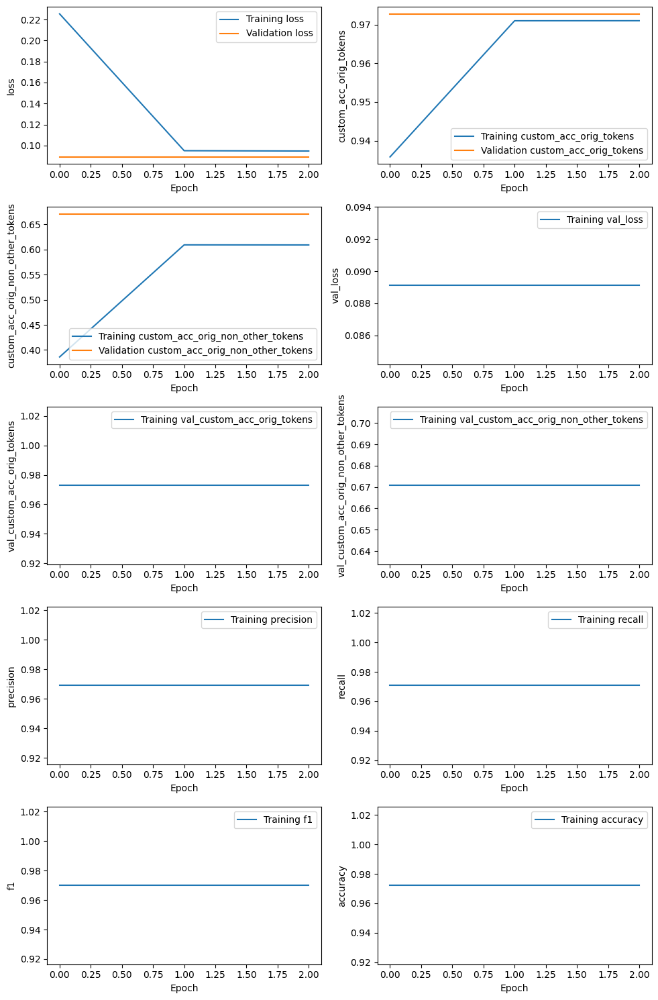

160/160 [==============================] - 26s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r1_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.641,0.705,0.671,420,,
COATING_MATERIAL,0.585,0.663,0.621,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.614,0.585,0.599,,0.966,0.694


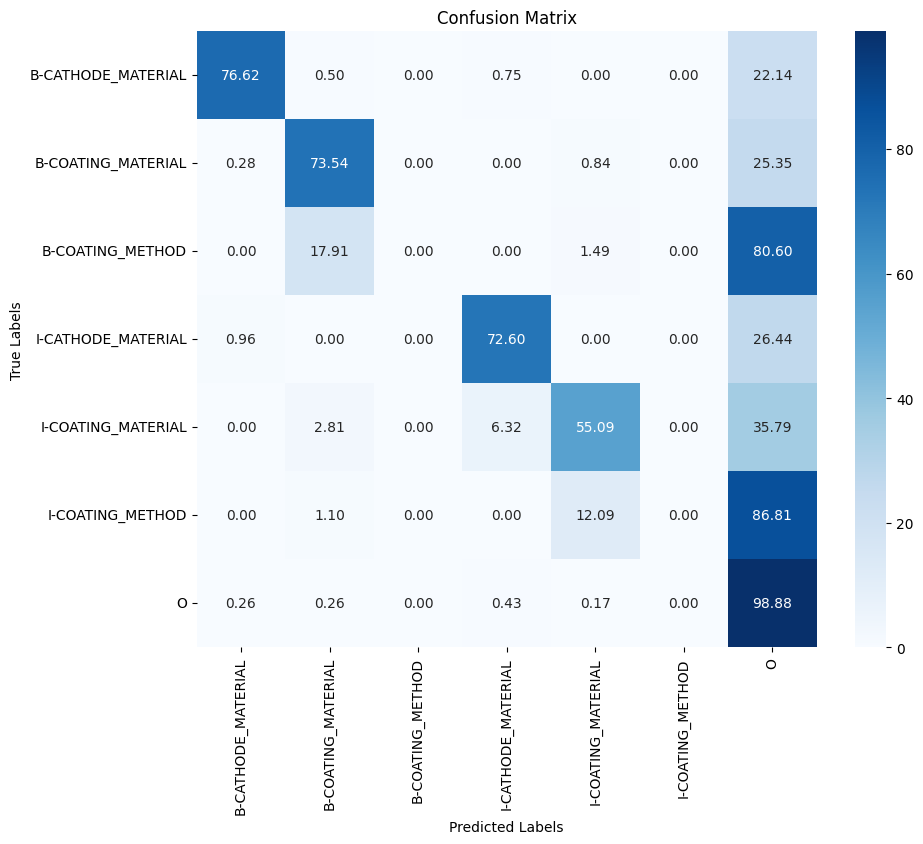

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 112s 438ms/step - loss: 0.2493 - custom_acc_orig_tokens: 0.9304 - custom_acc_orig_non_other_tokens: 0.3236 - val_loss: 0.1037 - val_custom_acc_orig_tokens: 0.9717 - val_custom_acc_orig_non_other_tokens: 0.6594 - precision: 0.9671 - recall: 0.9698 - f1: 0.9684 - accuracy: 0.9709
Epoch 2/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1092 - custom_acc_orig_tokens: 0.9691 - custom_acc_orig_non_other_tokens: 0.5686 - val_loss: 0.1037 - val_custom_acc_orig_tokens: 0.9717 - val_custom_acc_orig_non_other_tokens: 0.6594 - precision: 0.9671 - recall: 0.9698 - f1: 0.9684 - accuracy: 0.9709
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1099 - custom_acc_orig_tokens: 0.9688 - custom_acc_orig_non_other_tokens: 0.5655 - val_loss: 0.1037 - val_custom_acc_orig_tokens: 0.9717 - val_custom_acc_orig_non_other_tokens: 0.6594 - precision: 0.9671 - recall: 0.9698 - f1: 0.9684 - accuracy: 0.9709


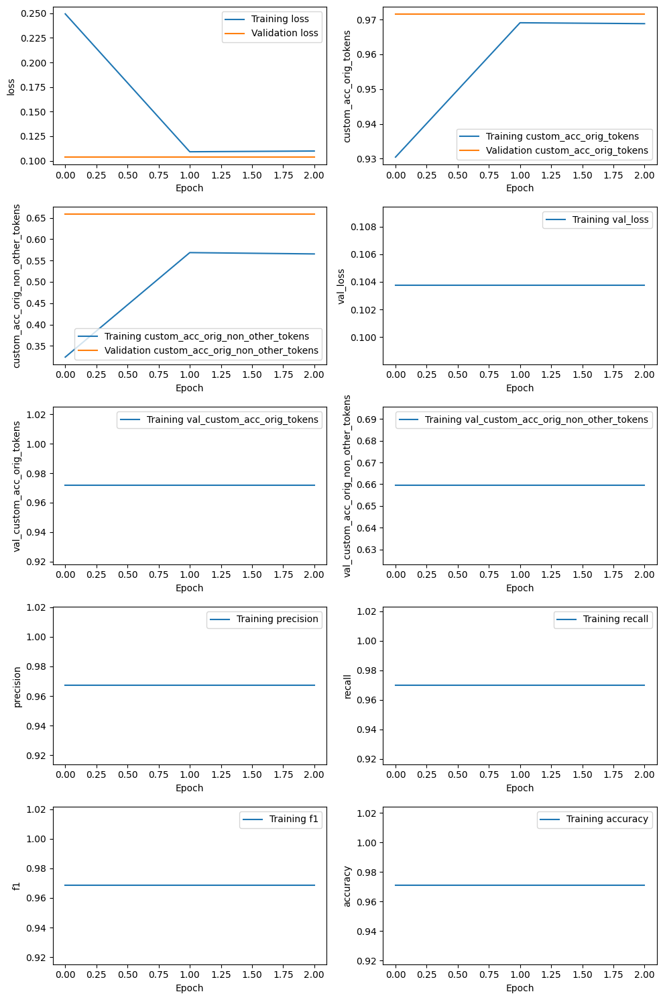

160/160 [==============================] - 23s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.624,0.683,0.652,420,,
COATING_MATERIAL,0.591,0.652,0.620,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.609,0.571,0.589,,0.965,0.685


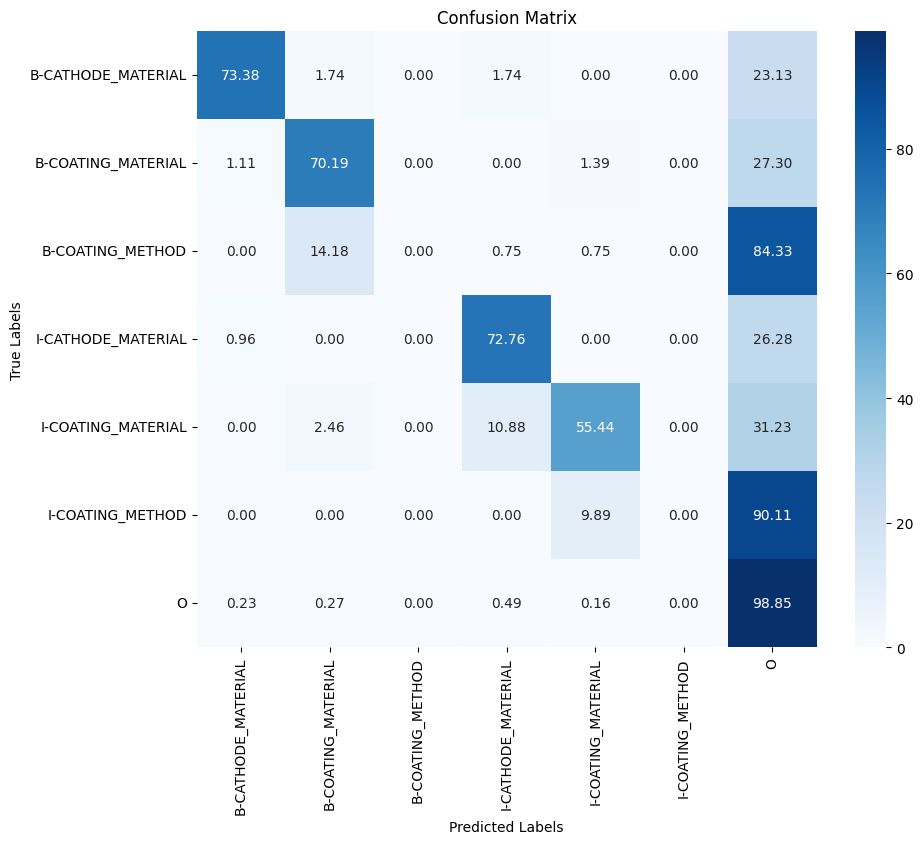

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-COATING_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relative

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 115s 446ms/step - loss: 0.2335 - custom_acc_orig_tokens: 0.9337 - custom_acc_orig_non_other_tokens: 0.3109 - val_loss: 0.1068 - val_custom_acc_orig_tokens: 0.9691 - val_custom_acc_orig_non_other_tokens: 0.5692 - precision: 0.9631 - recall: 0.9675 - f1: 0.9653 - accuracy: 0.9683
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.1133 - custom_acc_orig_tokens: 0.9677 - custom_acc_orig_non_other_tokens: 0.5158 - val_loss: 0.1068 - val_custom_acc_orig_tokens: 0.9691 - val_custom_acc_orig_non_other_tokens: 0.5692 - precision: 0.9631 - recall: 0.9675 - f1: 0.9653 - accuracy: 0.9683
Epoch 3/3
160/160 [==============================] - 42s 260ms/step - loss: 0.1131 - custom_acc_orig_tokens: 0.9671 - custom_acc_orig_non_other_tokens: 0.5064 - val_loss: 0.1068 - val_custom_acc_orig_tokens: 0.9691 - val_custom_acc_orig_non_other_tokens: 0.5692 - precision: 0.9631 - recall: 0.9675 - f1: 0.9653 - accuracy: 0.9683


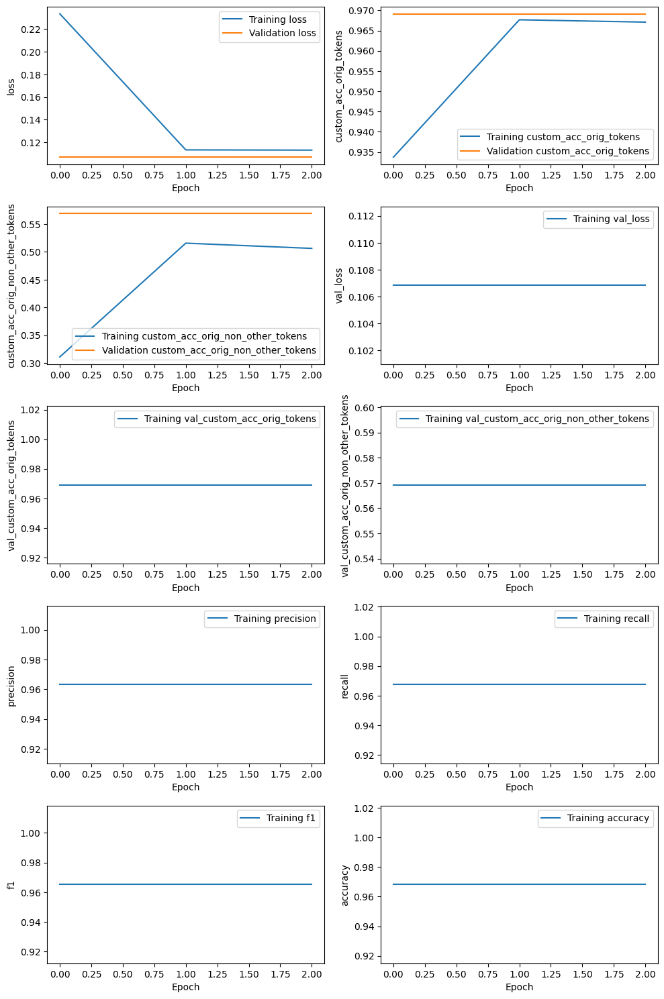

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_5e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.627,0.605,0.616,420,,
COATING_MATERIAL,0.568,0.579,0.574,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.599,0.506,0.549,,0.963,0.652


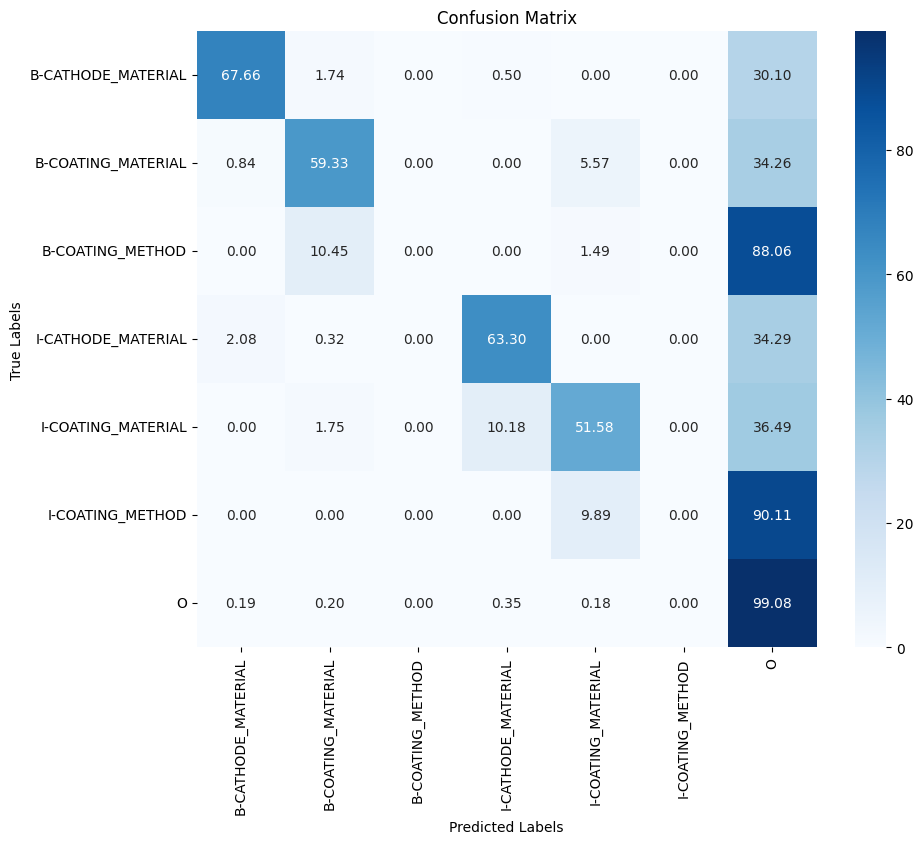

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 466ms/step - loss: 0.1942 - custom_acc_orig_tokens: 0.9424 - custom_acc_orig_non_other_tokens: 0.4652 - val_loss: 0.0737 - val_custom_acc_orig_tokens: 0.9753 - val_custom_acc_orig_non_other_tokens: 0.7468 - precision: 0.9722 - recall: 0.9727 - f1: 0.9725 - accuracy: 0.9746
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0755 - custom_acc_orig_tokens: 0.9747 - custom_acc_orig_non_other_tokens: 0.7073 - val_loss: 0.0737 - val_custom_acc_orig_tokens: 0.9753 - val_custom_acc_orig_non_other_tokens: 0.7468 - precision: 0.9722 - recall: 0.9727 - f1: 0.9725 - accuracy: 0.9746
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0755 - custom_acc_orig_tokens: 0.9749 - custom_acc_orig_non_other_tokens: 0.7081 - val_loss: 0.0737 - val_custom_acc_orig_tokens: 0.9753 - val_custom_acc_orig_non_other_tokens: 0.7468 - precision: 0.9722 - recall: 0.9727 - f1: 0.9725 - accuracy: 0.9746


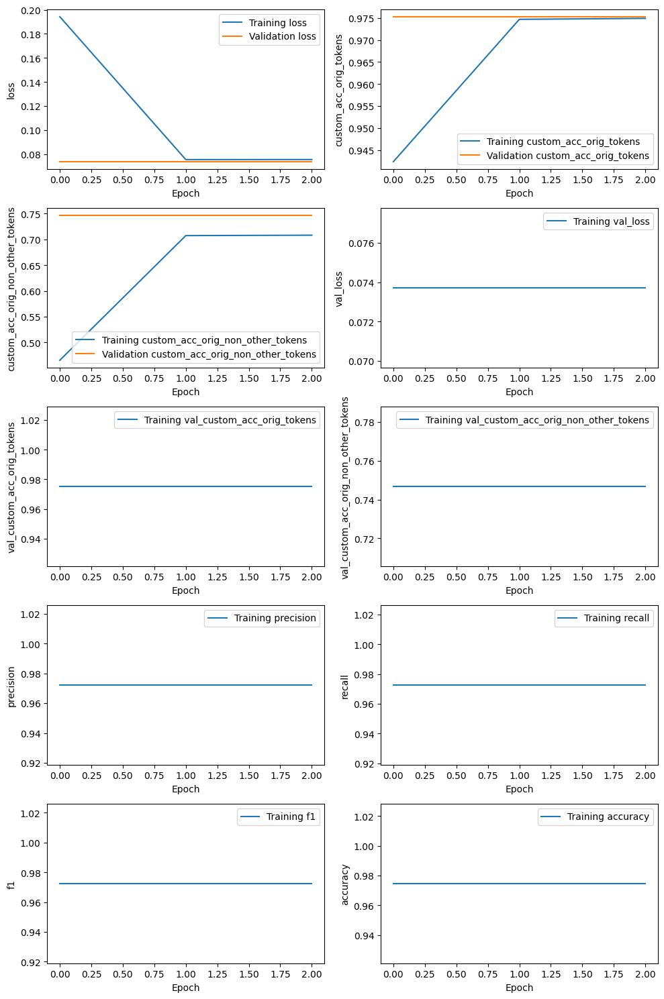

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r1_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r1_val_predictions.json in the repository.
47/47 [==============================] - 4s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r1_eval_predictions.json in the repository.

Fin

,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.626,0.757,0.685,420,,
COATING_MATERIAL,0.586,0.724,0.648,359,,
COATING_METHOD,0.786,0.082,0.149,134,,
OVERALL,0.610,0.645,0.627,,0.969,0.731


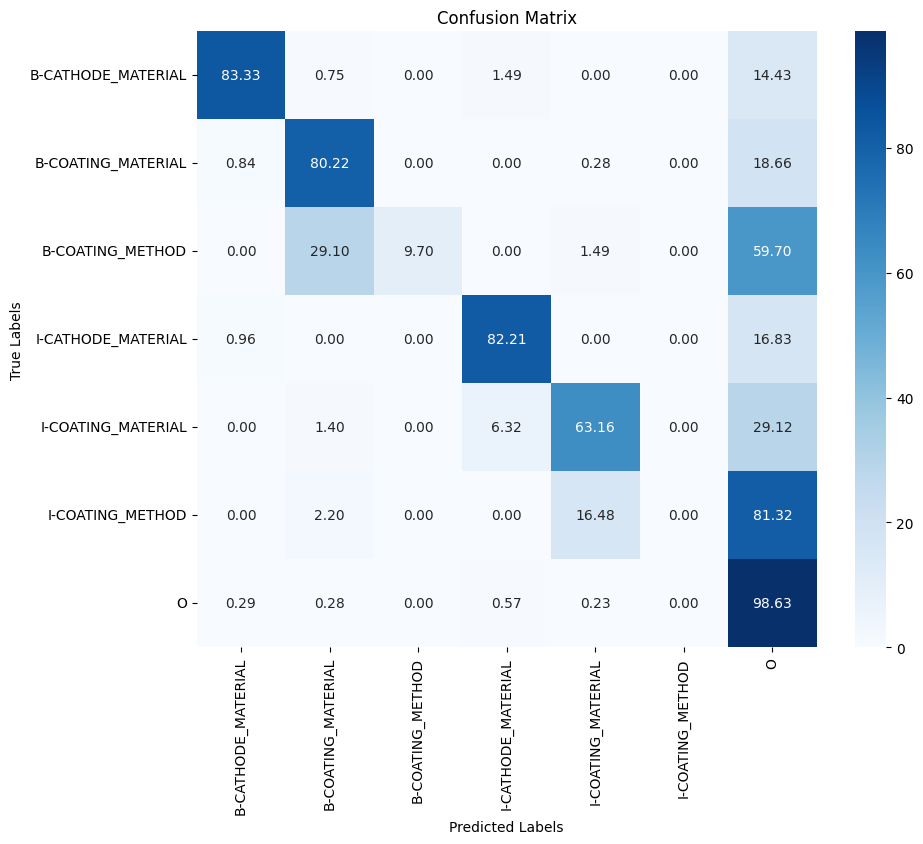

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 116s 447ms/step - loss: 0.2181 - custom_acc_orig_tokens: 0.9381 - custom_acc_orig_non_other_tokens: 0.4116 - val_loss: 0.0850 - val_custom_acc_orig_tokens: 0.9738 - val_custom_acc_orig_non_other_tokens: 0.7213 - precision: 0.9709 - recall: 0.9712 - f1: 0.9710 - accuracy: 0.9731
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0881 - custom_acc_orig_tokens: 0.9727 - custom_acc_orig_non_other_tokens: 0.6669 - val_loss: 0.0850 - val_custom_acc_orig_tokens: 0.9738 - val_custom_acc_orig_non_other_tokens: 0.7213 - precision: 0.9709 - recall: 0.9712 - f1: 0.9710 - accuracy: 0.9731
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0885 - custom_acc_orig_tokens: 0.9725 - custom_acc_orig_non_other_tokens: 0.6664 - val_loss: 0.0850 - val_custom_acc_orig_tokens: 0.9738 - val_custom_acc_orig_non_other_tokens: 0.7213 - precision: 0.9709 - recall: 0.9712 - f1: 0.9710 - accuracy: 0.9731


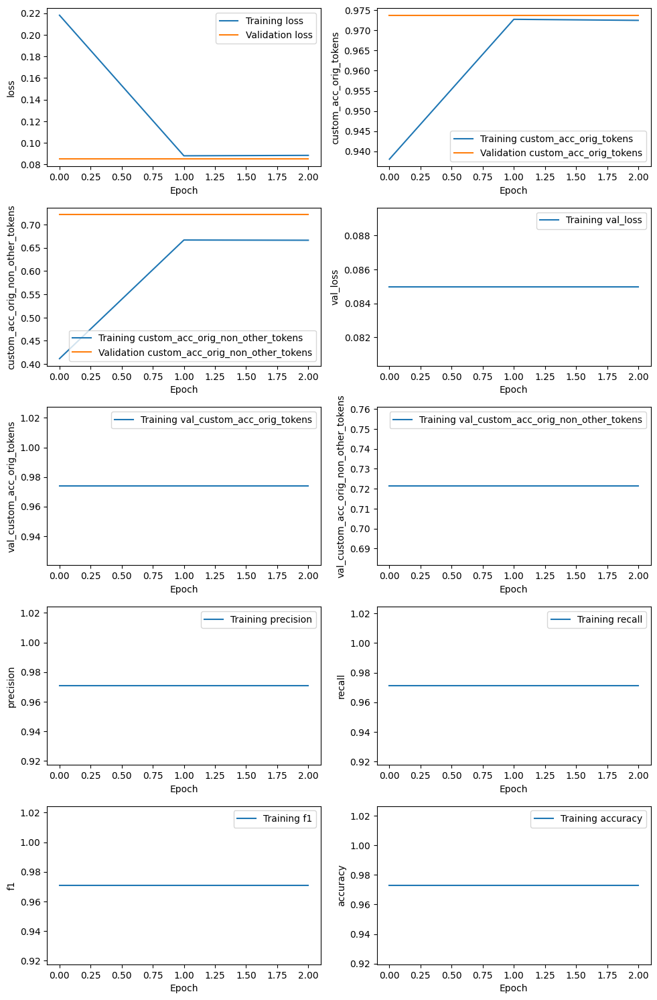

160/160 [==============================] - 26s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r2_train_predictions.json in the repository.
29/29 [==============================] - 3s 86ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r2_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r2_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.598,0.700,0.645,420,,
COATING_MATERIAL,0.553,0.738,0.632,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.576,0.612,0.593,,0.966,0.706


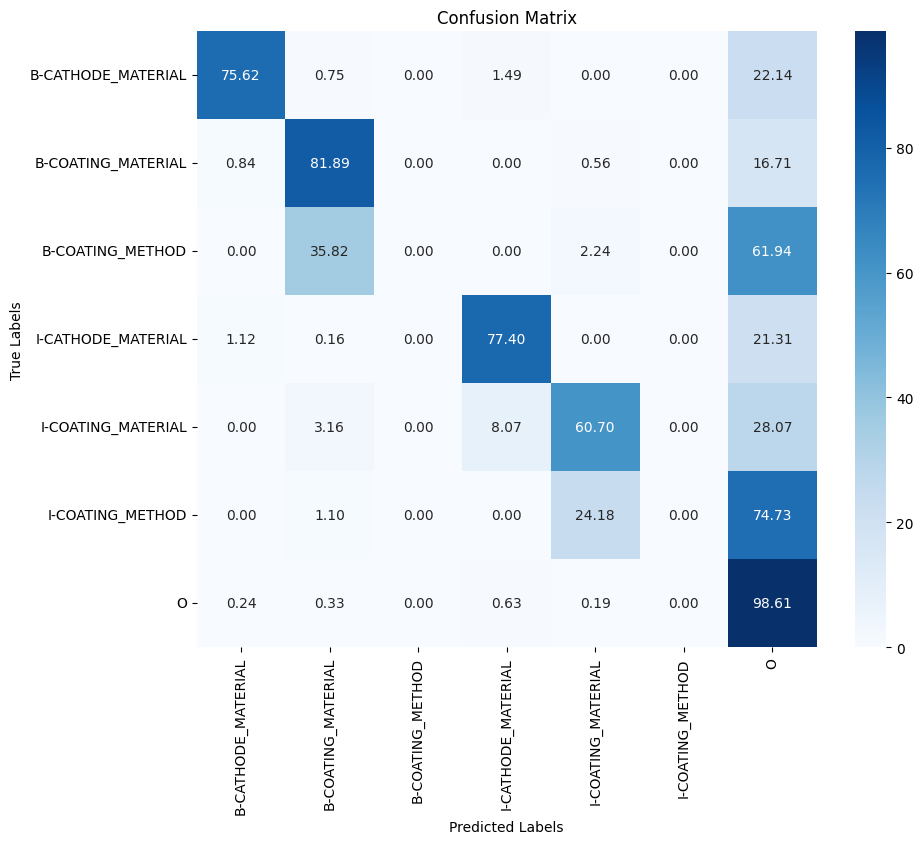

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.LayerNorm.weight', 'cls.seq_relationship.weight', 'cls.predictions.decoder.bias', 'cls.predictions.transform.dense.bias', 'cls.predictions.transform.dense.weight', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias', 'cls.predictions.transform.LayerNorm.bias']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_filektxy4ntu.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


160/160 [==============================] - 114s 442ms/step - loss: 0.2118 - custom_acc_orig_tokens: 0.9407 - custom_acc_orig_non_other_tokens: 0.3765 - val_loss: 0.0906 - val_custom_acc_orig_tokens: 0.9731 - val_custom_acc_orig_non_other_tokens: 0.6383 - precision: 0.9688 - recall: 0.9713 - f1: 0.9701 - accuracy: 0.9724
Epoch 2/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0966 - custom_acc_orig_tokens: 0.9716 - custom_acc_orig_non_other_tokens: 0.5833 - val_loss: 0.0906 - val_custom_acc_orig_tokens: 0.9731 - val_custom_acc_orig_non_other_tokens: 0.6383 - precision: 0.9688 - recall: 0.9713 - f1: 0.9701 - accuracy: 0.9724
Epoch 3/3
160/160 [==============================] - 42s 261ms/step - loss: 0.0964 - custom_acc_orig_tokens: 0.9712 - custom_acc_orig_non_other_tokens: 0.5750 - val_loss: 0.0906 - val_custom_acc_orig_tokens: 0.9731 - val_custom_acc_orig_non_other_tokens: 0.6383 - precision: 0.9688 - recall: 0.9713 - f1: 0.9701 - accuracy: 0.9724


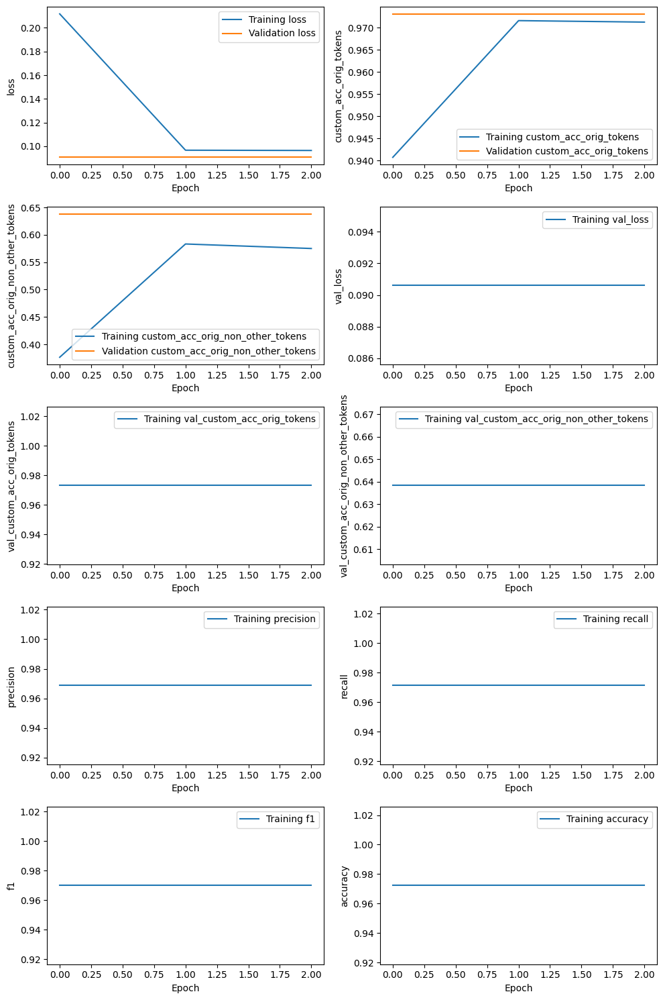

160/160 [==============================] - 24s 87ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r3_train_predictions.json in the repository.
29/29 [==============================] - 3s 85ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r3_val_predictions.json in the repository.
47/47 [==============================] - 4s 88ms/step
File not found: 404 {"message": "Not Found", "documentation_url": "https://docs.github.com/rest/repos/contents#get-repository-content", "status": "404"}. Creating a new one.
Created data/interim/C_scibert_battery_all_concat_64_8e-05_r3_eval_predictions.json in the repository.


/usr/local/lib/python3.10/dist-packages/seqeval/metrics/v1.py:57: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Final evaluation metrics for train set

Final evaluation metrics for validation set

Final evaluation metrics for evaluation set


,Precision,Recall,F1,Support,Accuracy,MCC
Label,,,,,,
CATHODE_MATERIAL,0.626,0.662,0.644,420,,
COATING_MATERIAL,0.558,0.593,0.575,359,,
COATING_METHOD,0.000,0.000,0.000,134,,
OVERALL,0.594,0.538,0.565,,0.966,0.684


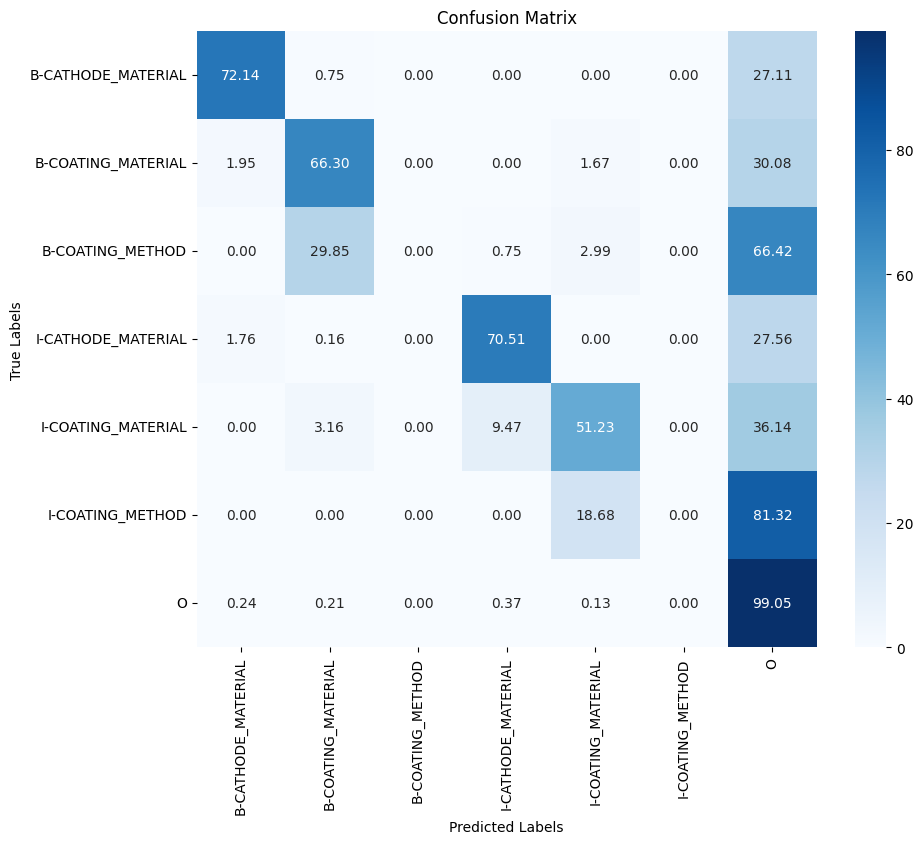

Displaying the first 5 mismatched passages:
Passage 1:
Tokens: ['However', ',', 'no', 'more', 'cycles', 'have', 'been', 'performed', 'in', 'contrast', 'with', 'Li', '/', 'LiFePO4', 'cell', 'with', 'the', 'same', 'solid', 'electrolyte', '.', 'In', 'turn', ',', 'Choi', 'et', 'al', '.', '[', '118', ']', 'investigated', 'hybrid', 'solid', 'electrolyte', 'based', 'on', 'PEO', '-', 'LiClO4', 'system', 'with', 'addition', 'of', '52', '.']
True Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'B-CATHODE_MATERIAL', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']
Predicted Labels: ['O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O', 'O']

Passage 2:
Tokens: ['The', 'relatively', 'low', 'cont

In [ ]:
# Battery dataset -- fine-tune appraoch w/ concatenation of last 4 hidden layers (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models1 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='C_',
    dataset='battery',
    train_strategy='all', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['concat'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:  8043s/27replicates = 5.0mins/replicate

### catalyst_fine-tune(4-layer)

In [ ]:
# Battery dataset -- fine-tune appraoch w/ concatenation of last 4 hidden layers (9 hyperparameter combinations)

start_time = timeit.default_timer()

scibert_models1 = run_models(
    checkpoint='allenai/scibert_scivocab_cased',
    name_prefix='C_',
    dataset='catalyst',
    train_strategy='all', # ['none', 'some', 'all']
    retrain_layers=list(range(12)),  # []
    feedforward_strategies=['concat'],  # ['last', 'concat']
    concat_layers=[8,9,10,11],
    batch_sizes=[16,32,64], # [16,32,64]
    init_lrs=[2e-5,5e-5,8e-5]) # [2e-5,5e-5,8e-5]


elapsed = timeit.default_timer() - start_time
print(f"\n\n{elapsed} seconds")
# A100:

Map:   0%|          | 0/8409 [00:00<?, ? examples/s]

Map:   0%|          | 0/1485 [00:00<?, ? examples/s]

Map:   0%|          | 0/2474 [00:00<?, ? examples/s]

/usr/local/lib/python3.10/dist-packages/datasets/arrow_dataset.py:410: FutureWarning: The output of `to_tf_dataset` will change when a passing single element list for `labels` or `columns` in the next datasets version. To return a tuple structure rather than dict, pass a single string.
Old behaviour: columns=['a'], labels=['labels'] -> (tf.Tensor, tf.Tensor)  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor)  
New behaviour: columns=['a'],labels=['labels'] -> ({'a': tf.Tensor}, {'labels': tf.Tensor})  
             : columns='a', labels='labels' -> (tf.Tensor, tf.Tensor) 
  warnings.warn(



                    		C_scibert_catalyst_all_concat_16_2e-05_r1


pytorch_model.bin:   0%|          | 0.00/442M [00:00<?, ?B/s]

Some weights of the PyTorch model were not used when initializing the TF 2.0 model TFBertModel: ['cls.predictions.transform.dense.bias', 'cls.predictions.transform.LayerNorm.bias', 'cls.seq_relationship.bias', 'cls.predictions.bias', 'cls.predictions.decoder.weight', 'cls.predictions.transform.dense.weight', 'cls.predictions.decoder.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.weight']
- This IS expected if you are initializing TFBertModel from a PyTorch model trained on another task or with another architecture (e.g. initializing a TFBertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing TFBertModel from a PyTorch model that you expect to be exactly identical (e.g. initializing a TFBertForSequenceClassification model from a BertForSequenceClassification model).
All the weights of TFBertModel were initialized from the PyTorch model.
If your task is similar to the task the model of the checkpoint

Epoch 1/3


/tmp/__autograph_generated_file214vg14s.py:63: UserWarning: Input dict contained keys ['id'] which did not match any model input. They will be ignored by the model.
  ag__.converted_call(ag__.ld(warnings).warn, (ag__.converted_call('Input dict contained keys {} which did not match any model input. They will be ignored by the model.'.format, ([ag__.ld(n) for n in ag__.converted_call(ag__.ld(tensors).keys, (), None, fscope) if ag__.ld(n) not in ag__.ld(ref_input_names)],), None, fscope),), dict(stacklevel=2), fscope)


 62/526 [==>...........................] - ETA: 1:44 - loss: 0.9046 - custom_acc_orig_tokens: 0.8687 - custom_acc_orig_non_other_tokens: 0.0085